In [104]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import datetime
import glob
import matplotlib.dates as mdates
import plotly.express as px 
import matplotlib
import matplotlib.gridspec as gridspec
import plotly.offline as pyo
from scipy import stats
#matplotlib.rcParams['font.family'] = "sans-serif"
import os
import requests

from tqdm import tqdm

import plotly.io as pio
pio.renderers.default = 'notebook'

%matplotlib inline

In [255]:
#Clean up timestamp column to just have year-month-day
def clean_timestamp_transpose(t):
    return t.split('T')[0]
def clean_timestamp_dune(time):
    return datetime.datetime.strptime(time.split()[0], '%Y-%m-%d')
def string_to_datetime(t):
    return datetime.datetime.strptime(t,'%Y-%m-%d')
def clean_raw_dune(df):
    df_copy = df.copy()
    #sort by date and time
    df_copy = df_copy.sort_values(by=['block_time'])

    #remove duplicate transactions
    df_copy = df_copy.drop_duplicates(subset=['tx_hash'], keep='first')

    #Remove time (H:M:S) from timestamp
    df_copy['block_time'] = df_copy['block_time'].map(clean_timestamp_dune)
    
    return df_copy

def agg_dfs(path):
    filenames = glob.glob(path+'/*.csv')

    dfs = []
    for f in filenames:
        dfs.append(pd.read_csv(f))

    df = pd.concat(dfs,ignore_index=True)
    
    return df

def addlabels(x,y):
    for i in range(len(x)):
        plt.text(i, y[i], y[i], ha = 'center')


In [86]:
#test dune api/

In [91]:
import dotenv
import os
import pandas as pd

from dune_client.types import QueryParameter
from dune_client.client import DuneClient
from dune_client.query import Query

query = Query(
    name="Chain user activity past month",
    query_id=2986002,
    params=[
        QueryParameter.text_type(name="TextField", value="Word"),
        QueryParameter.number_type(name="NumberField", value=3.1415926535),
        QueryParameter.date_type(name="DateField", value="2022-05-04 00:00:00"),
        QueryParameter.enum_type(name="ListField", value="Option 1"),
    ],
)
print("Results available at", query.url())

dotenv.load_dotenv()
dune = DuneClient(os.environ["iHBaf43wKvraQGyzF1ruDsSqRxq6dfqm"])
pd = dune.refresh_into_dataframe(query)


ImportError: cannot import name 'Query' from 'dune_client.query' (/Users/cyrusleung/anaconda3/lib/python3.10/site-packages/dune_client/query.py)

In [88]:
response = requests.get('https://api.dune.com/api/v1/query/2986002/results/csv?api_key=iHBaf43wKvraQGyzF1ruDsSqRxq6dfqm')


In [89]:
response

<Response [402]>

# Last month (8/2023)

In [5]:
def plot_contractsdistribution(protocol_df, title):
    print(protocol_df['contract_name'].value_counts())
    print(protocol_df['event_name'].value_counts())
    
    #Contract name
    plt.figure(figsize=(50,30))
    cross_tab_prop = pd.crosstab(index=protocol_df['block_time'],
                                 columns=protocol_df['contract_name'],
                                 normalize="index")

    cross_tab_prop.plot(kind='bar', 
                        stacked=True, 
                        colormap='tab10',
                        #legend=None,
                        figsize=(15, 10))

    plt.legend(loc="center left", ncol=1,bbox_to_anchor=(1, 0.5))
    plt.xlabel("Date")
    year_month = protocol_df['block_time'].dt.to_period('M').unique().map(lambda x: datetime.datetime.strptime(str(x),'%Y-%m'))
    year_month = [ts.to_pydatetime().strftime('%Y-%m') for ts in year_month]
    dates = list(protocol_df['block_time'].unique())
    plt.xticks(np.linspace(0,len(dates),len(year_month)), year_month,rotation=40)
    plt.ylabel("Contracts (by proportion)")
    plt.title(f"{title}: Distribution of Contracts Over Time")
    
    #Event name
    plt.figure(figsize=(50,30))
    cross_tab_prop = pd.crosstab(index=protocol_df['block_time'],
                                 columns=protocol_df['event_name'],
                                 normalize="index")

    cross_tab_prop.plot(kind='bar', 
                        stacked=True, 
                        colormap='tab10',
                        #legend=None,
                        figsize=(15, 10))

    plt.legend(loc="center left", ncol=1,bbox_to_anchor=(1, 0.5))
    plt.xlabel("Date")
    plt.xticks(np.linspace(0,len(dates),len(year_month)), year_month,rotation=40)
    plt.ylabel("Contracts (by proportion)")
    plt.ylabel("Events (by proportion)")
    plt.title(f"{title}: Distribution of Events Over Time")

In [6]:
def plot_protocolmarketshare(contracts_df, chain_name, topn):
    
    norm = [float(i)/sum(contracts_df['namespace'].value_counts()) for i in contracts_df['namespace'].value_counts()[:topn]]
    norm = list(map(lambda x: round(x*100,1),norm))
    norm_dict = {k: v for k,v in list(zip(contracts_df['namespace'].value_counts()[:topn].index,norm))}

    plt.figure(figsize=(15,10))
    plt.bar(norm_dict.keys(),norm_dict.values(),label=norm_dict.values())
    plt.title(f'{chain_name}: Protocols Transaction Share')
    plt.xticks(rotation=90)
    plt.xlabel('Protocol')
    plt.ylabel('Txs Share (%)')
    plt.bar_label(plt.bar(norm_dict.keys(),norm_dict.values(),label=norm_dict.values()))
    print(contracts_df['namespace'].value_counts()[:topn].to_string())
    
    
    norm = [float(i)/sum(contracts_df['contract_name'].value_counts()) for i in contracts_df['contract_name'].value_counts()[:topn]]
    norm = list(map(lambda x: round(x*100,1),norm))
    norm_dict = {k: v for k,v in list(zip(contracts_df['contract_name'].value_counts()[:topn].index,norm))}

    plt.figure(figsize=(15,10))
    plt.bar(norm_dict.keys(),norm_dict.values(),label=norm_dict.values())
    plt.title(f'{chain_name}: Contracts Transaction Share')
    plt.xticks(rotation=90)
    plt.xlabel('Contract')
    plt.ylabel('Txs Share (%)')
    plt.bar_label(plt.bar(norm_dict.keys(),norm_dict.values(),label=norm_dict.values()))
    print(contracts_df['contract_name'].value_counts()[:topn].to_string())
    
    norm = [float(i)/sum(contracts_df['event_name'].value_counts()) for i in contracts_df['event_name'].value_counts()[:topn]]
    norm = list(map(lambda x: round(x*100,1),norm))
    norm_dict = {k: v for k,v in list(zip(contracts_df['event_name'].value_counts()[:topn].index,norm))}

    plt.figure(figsize=(15,10))
    plt.bar(norm_dict.keys(),norm_dict.values(),label=norm_dict.values())
    plt.title(f'{chain_name}: Events Transaction Share')
    plt.xticks(rotation=90)
    plt.xlabel('Event')
    plt.ylabel('Txs Share (%)')
    plt.bar_label(plt.bar(norm_dict.keys(),norm_dict.values(),label=norm_dict.values()))
    print(contracts_df['event_name'].value_counts()[:topn].to_string())
    
def most_popular_contracts(contracts_df, topn):

    temp = contracts_df['contract_name'].value_counts()[:topn].reset_index()['contract_name']
    for i in range(len(temp)):
        print(temp.iloc[i])
    return temp

def most_popular_events(contracts_df, topn):

    temp = contracts_df['event_name'].value_counts()[:topn].reset_index()['event_name']
    for i in range(len(temp)):
        print(temp.iloc[i])
    return temp
    

## Arbitrum

In [5]:
path = 'Chains Data/arbitrum txs/2023-8'

In [6]:
aug_arb = pd.read_csv(path+'/aug_arb.csv')

In [7]:
aug_arb

,Unnamed: 0,block_time,namespace,contract_name,contract_address,tx_hash,event_name,from,to
0,3877081,2023-08-23,circle,ArbFiatToken,0xff970a61a04b1ca14834a43f5de4533ebddb5cc8,0x449806e2e3cf9bf52c4ab27a881f6fe24c5b478a9f75...,Transfer,0x84aa3770eaa88ea6c8a53b6c050e60d6a16972a3,0x2f43c6475f1ecbd051ce486a9f3ccc4b03f3d713
1,3877104,2023-08-23,erc20,NaN,0x912ce59144191c1204e64559fe8253a0e49e6548,0x49d0c3baf13694fc9c16aa8bd2af5aaa65105490d4a6...,Transfer,0xc865eb005feda68ad94a8f357d3c01fa129e203c,0xb0e3366e50ecf25cea41f9796786109882df7c51
2,3877106,2023-08-23,circle,ArbFiatToken,0xff970a61a04b1ca14834a43f5de4533ebddb5cc8,0xd5eee93fb32469b512428404c68f95feaeb17aa4eef3...,Approval,0x43e812520c0a10d776a8bc4c020a695be2256e51,0xf73ab2d782bf6ba97ac4405d2cd4f1135da8dbd9
3,3877113,2023-08-23,erc20,NaN,0xaf1b86e67e554cf36e3e8f080ccca2d995f6919d,0x3a26ea5969b02b9d0934da39148f6fd27d1b83d21203...,Transfer,0x9416d64b759f4618908e0bf8642744ab04fac00b,0xaf1b86e67e554cf36e3e8f080ccca2d995f6919d
4,3877115,2023-08-23,chainlink,AccessControlledOffchainAggregator,0x3607e46698d218b3a5cae44bf381475c0a5e2ca7,0xee6267cac58896d3eaa1ca268ab0927dc361bfd1ddaf...,RoundRequested,0xdbfb137861cbfd05e81fd295cf273476487dee89,0x3607e46698d218b3a5cae44bf381475c0a5e2ca7
...,...,...,...,...,...,...,...,...,...
3349319,24820323,2023-08-30,circle,ArbFiatToken,0xff970a61a04b1ca14834a43f5de4533ebddb5cc8,0x1a56e717b4d0ce59e903d60aaa2120588b5240281504...,Transfer,0x41d3d33156ae7c62c094aae2995003ae63f587b3,0xff970a61a04b1ca14834a43f5de4533ebddb5cc8
3349320,24820347,2023-08-30,chronos,BribesV2,0x002f80f61a77ec8e85785c85ccb3be9325947ed5,0xc87790866e3316ed73bcbe53c7652dfc5e2bd6bd970e...,Staked,0xfbf8a70f68d7846fb5ec7ffd3a457453c104d459,0xcc5382fe1ecadbf18629c87b9c89a27b438889d4
3349321,24820353,2023-08-30,chronos,BribesV2,0x1582c47cf5a3b36d47411afd61acf9b741411554,0x2ea7bd99e40754ceeb924e070e51412505afa0b674cc...,Withdrawn,0x8fda1ead2709923c058217b441ef5a5bf09f4022,0xcc5382fe1ecadbf18629c87b9c89a27b438889d4
3349322,24820346,2023-08-30,socket,GasMovr,0xc0e02aa55d10e38855e13b64a8e1387a04681a00,0x1205e8fe188b7d9e813371b0202ae6b4cba7ff08df02...,Deposit,0xba6391c900fc3c51ec520917da0052022f5e5811,0xc0e02aa55d10e38855e13b64a8e1387a04681a00


In [8]:
aug_arb['block_time'] = aug_arb['block_time'].map(lambda x: datetime.datetime.strptime(x,'%Y-%m-%d'))

In [9]:
aug_arb['block_time'].iloc[0]

Timestamp('2023-08-23 00:00:00')

contract_name
UltraLightNodeV2     403037
ArbFiatToken         199034
ArbitrumExtension    174755
Pool                 152224
EntryPoint_v0_6      142732
                      ...  
BunniHub_Arbitrum         1
lFRAX_V2                  1
ETHRewards                1
pToken                    1
tLINK                     1
Name: count, Length: 1344, dtype: int64
event_name
Transfer                  1454685
Approval                   598844
HashReceived               224708
Swap                       112451
Packet                      62529
                           ...   
ReserveFunded                   1
DiamondCreated                  1
TokenAdded                      1
SetChainToClaimRewards          1
RoundPoolCreated                1
Name: count, Length: 1468, dtype: int64


<Figure size 5000x3000 with 0 Axes>

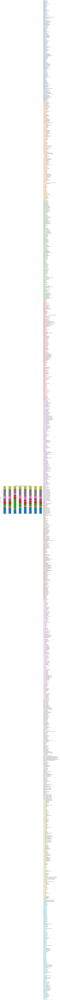

<Figure size 5000x3000 with 0 Axes>

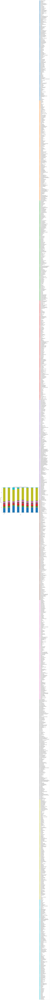

In [10]:
plot_contractsdistribution(aug_arb,'Arbitrum (Aug 2023)')

namespace
erc20                   1062782
layerzero                405638
stargate                 239717
circle                   199610
tether                   174755
erc721                   157327
erc4337                  142732
weth                     140582
arbitrum                  83604
uniswap_v3                72238
socket                    50373
usdctoken                 48282
gains_network             48231
erc1155                   26168
gmx                       24372
bgt                       24354
radiant_capital           19441
level_finance             13181
hmx                       12699
treasure_bridgeworld      12692
chainlink                 12135
sushi                     11674
angle                     11501
camelot                   11229
lighter                   10623
gmx_v2                    10009
justbet                    9400
woofi                      9156
maker                      8604
holograph_operator         8525
bluefin                    836

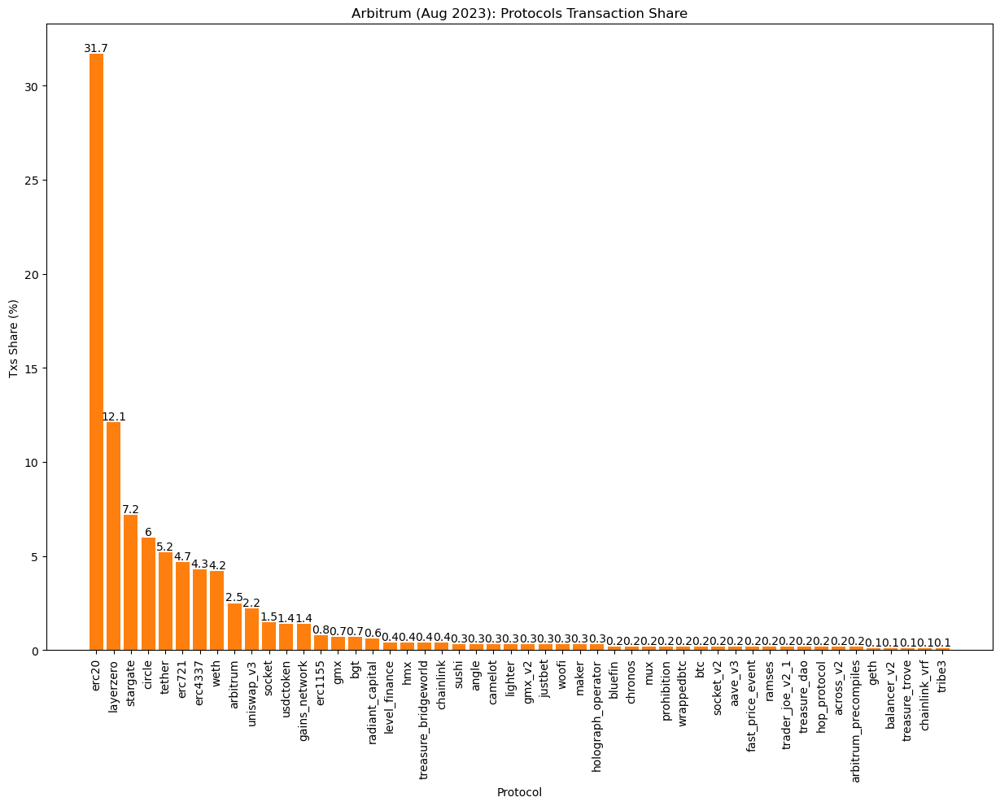

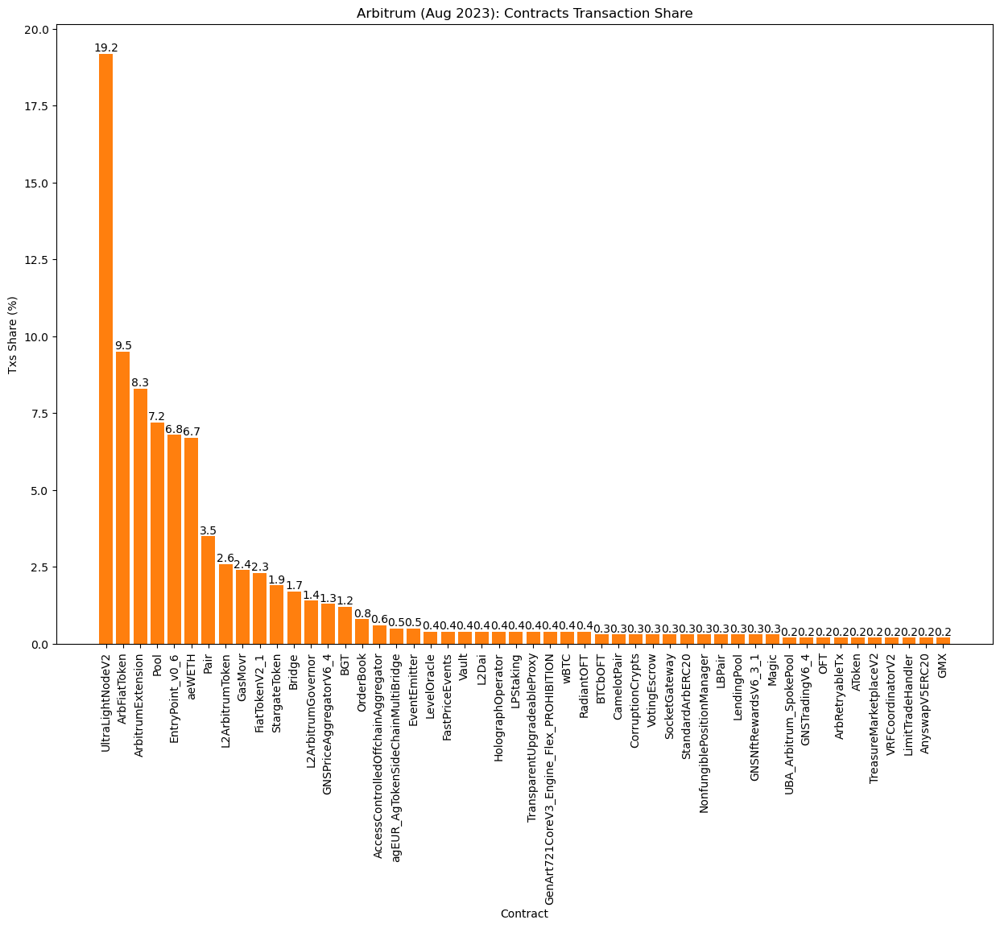

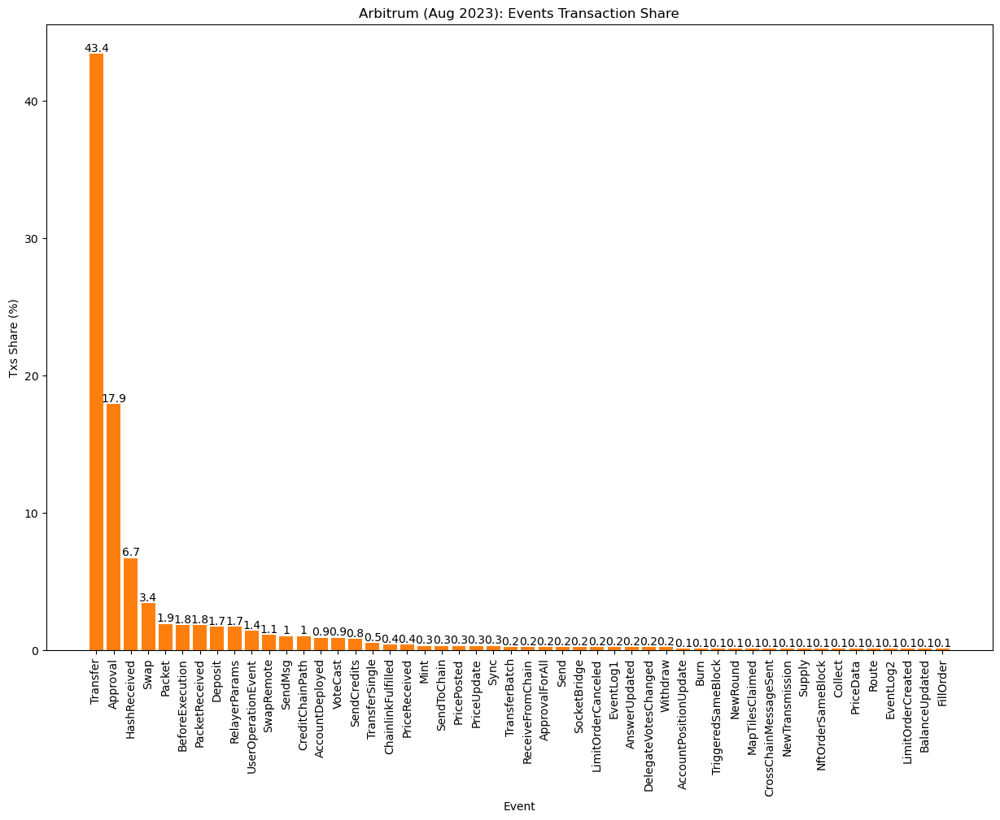

In [26]:
plot_protocolmarketshare(aug_arb,'Arbitrum (Aug 2023)',50)

namespace
erc20         1062782
layerzero      405638
stargate       239717
circle         199610
tether         174755
erc721         157327
erc4337        142732
weth           140582
arbitrum        83604
uniswap_v3      72238
contract_name
UltraLightNodeV2     403037
ArbFiatToken         199034
ArbitrumExtension    174755
Pool                 152224
EntryPoint_v0_6      142732
aeWETH               140582
Pair                  73216
L2ArbitrumToken       54022
GasMovr               50342
FiatTokenV2_1         48282
event_name
Transfer              1454685
Approval               598844
HashReceived           224708
Swap                   112451
Packet                  62529
BeforeExecution         60890
PacketReceived          59466
Deposit                 57809
RelayerParams           56320
UserOperationEvent      48450


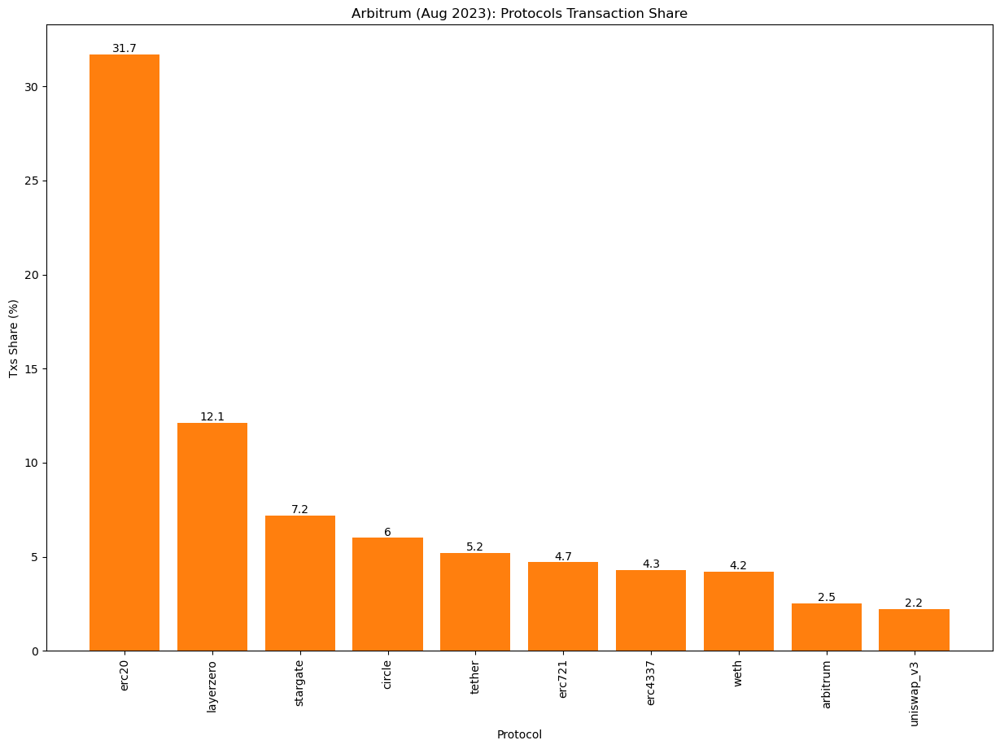

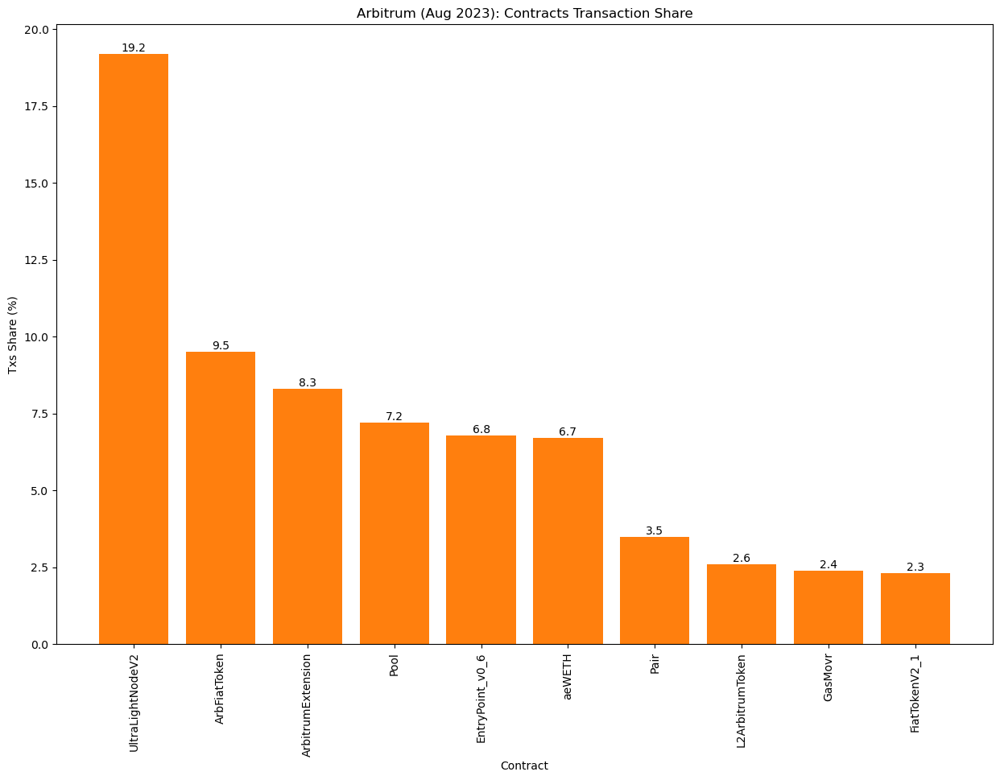

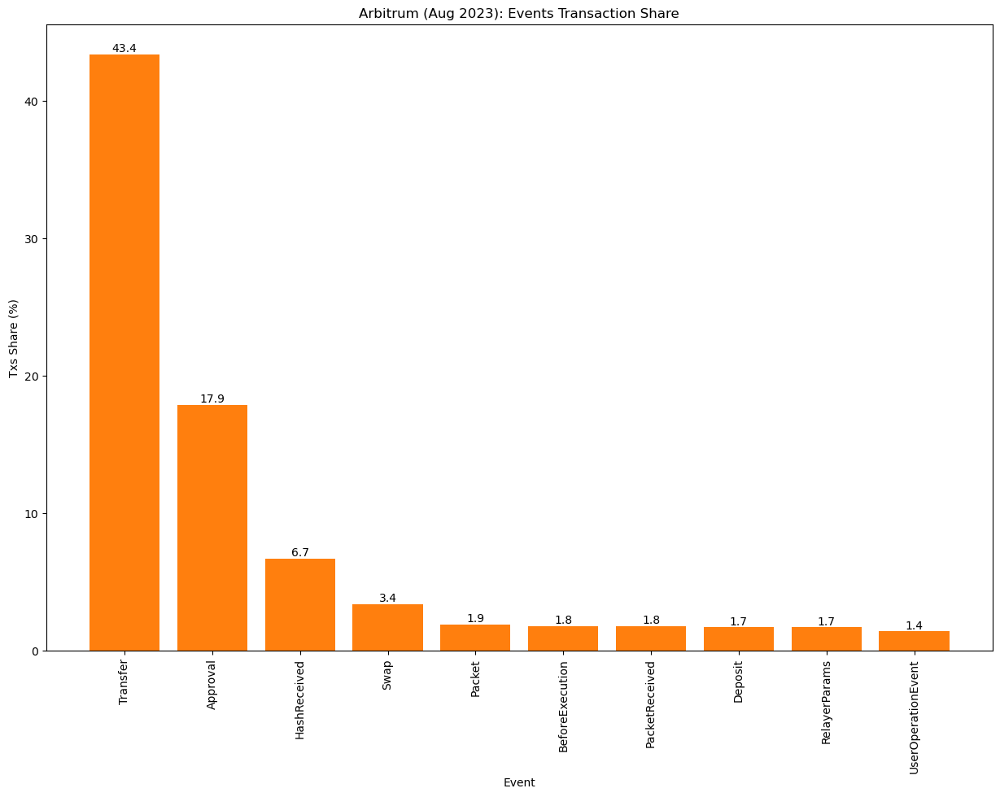

In [25]:
plot_protocolmarketshare(aug_arb,'Arbitrum (Aug 2023)',10)

In [121]:
most_pop_contracts_arb = most_popular_contracts(aug_arb,100)

UltraLightNodeV2
ArbFiatToken
ArbitrumExtension
Pool
EntryPoint_v0_6
aeWETH
Pair
L2ArbitrumToken
GasMovr
FiatTokenV2_1
StargateToken
Bridge
L2ArbitrumGovernor
GNSPriceAggregatorV6_4
BGT
OrderBook
AccessControlledOffchainAggregator
agEUR_AgTokenSideChainMultiBridge
EventEmitter
LevelOracle
FastPriceEvents
Vault
L2Dai
HolographOperator
LPStaking
TransparentUpgradeableProxy
GenArt721CoreV3_Engine_Flex_PROHIBITION
wBTC
RadiantOFT
BTCbOFT
CamelotPair
CorruptionCrypts
VotingEscrow
SocketGateway
StandardArbERC20
NonfungiblePositionManager
LBPair
LendingPool
GNSNftRewardsV6_3_1
Magic
UBA_Arbitrum_SpokePool
GNSTradingV6_4
OFT
ArbRetryableTx
AToken
TreasureMarketplaceV2
VRFCoordinatorV2
LimitTradeHandler
AnyswapV5ERC20
GMX
Permit2
FastPriceFeed
GnosisSafeL2_v1_3_0
WooCrossChainRouterV2
RouteProcessor3
PositionVault
GainsNetworkToken
RandomizerRouter
TradeHelper
ChefIncentivesController_V2
WooPPV2
ElasticPoolV2
CoreV2
LiquidityPoolHop1
L2Pool
LiquidityProviders
HopBridgeToken
MAWToken
wstETH
Posi

In [80]:
most_pop_events_arb = most_popular_events(aug_arb,50)

Transfer
Approval
HashReceived
Swap
Packet
BeforeExecution
PacketReceived
Deposit
RelayerParams
UserOperationEvent
SwapRemote
SendMsg
CreditChainPath
AccountDeployed
VoteCast
SendCredits
TransferSingle
ChainlinkFulfilled
PriceReceived
Mint
SendToChain
PricePosted
PriceUpdate
Sync
TransferBatch
ReceiveFromChain
ApprovalForAll
Send
SocketBridge
LimitOrderCanceled
EventLog1
AnswerUpdated
DelegateVotesChanged
Withdraw
AccountPositionUpdate
Burn
TriggeredSameBlock
NewRound
MapTilesClaimed
CrossChainMessageSent
NewTransmission
Supply
NftOrderSameBlock
Collect
PriceData
Route
EventLog2
LimitOrderCreated
BalanceUpdated
FillOrder


In [81]:
for event in most_pop_events_arb:
    print(event, aug_arb[aug_arb['event_name']==event]['namespace'].value_counts().index)

Transfer Index(['erc20', 'erc721', 'tether', 'weth', 'circle', 'arbitrum', 'usdctoken',
       'stargate', 'bgt', 'radiant_capital',
       ...
       'wudiu', 'pslvr', 'uniperp', 'orange_finance', 'uniwswap', 'credacore',
       'kommunitas', 'fluidfi', 'loopringcoinv2', 'naidwater'],
      dtype='object', name='namespace', length=418)
Approval Index(['erc20', 'circle', 'tether', 'weth', 'usdctoken', 'stargate',
       'arbitrum', 'angle', 'erc721', 'bgt',
       ...
       'grins', 'bath', 'rodeofinance', 'celer', 'gold', 'xpad', 'aiibb',
       'pickle', 'mumu', 'u_e_token'],
      dtype='object', name='namespace', length=384)
HashReceived Index(['layerzero'], dtype='object', name='namespace')
Swap Index(['uniswap_v3', 'stargate', 'trader_joe_v2_1', 'sushi', 'camelot',
       'kyber', 'balancer_v2', 'chronos', 'ramses', 'dune_v2_web3',
       'pancakeswap_v3', 'trader_joe', 'sushiswap_v3_pool', 'gmx', 'arbswap',
       'lighter', 'algebrapool', 'wombat', 'level_finance', 'shellproto

Burn Index(['uniswap_v3', 'stargate', 'aave_v3', 'ramses', 'radiant_capital',
       'kyber', 'usdctoken', 'camelot', 'chronos', 'sushi', 'pancakeswap_v3',
       'vested_winr', 'winr_protocol', 'algebrapool', 'livepeer', 'pendle',
       'savvy', 'arx', 'pancakeswap_v2', 'arbswap', 'sushiswap_v3_pool',
       'rodeofinance', 'zyberswap', 'solidlizard', 'crescentswap',
       'treasure_magicswap', 'cvi'],
      dtype='object', name='namespace')
TriggeredSameBlock Index(['gains_network', 'mtrader'], dtype='object', name='namespace')
NewRound Index(['chainlink', 'tribe3'], dtype='object', name='namespace')
MapTilesClaimed Index(['treasure_bridgeworld'], dtype='object', name='namespace')
CrossChainMessageSent Index(['holograph_operator'], dtype='object', name='namespace')
NewTransmission Index(['chainlink'], dtype='object', name='namespace')
Supply Index(['stargate', 'aave_v3', 'chronos', 'ramses', 'mux', 'arb_paraspace',
       'compound_v3', 'dopex', 'auragi', '3xcalibur', 'l2dao', 'spe

In [100]:
aug_arb[aug_arb['contract_name']=='LPStaking']['namespace'].value_counts().index

Index(['stargate'], dtype='object', name='namespace')

In [119]:
aug_op[aug_op['contract_name']=='OVMFiatToken']['namespace'].value_counts().index

Index(['circle'], dtype='object', name='namespace')

In [81]:
aug_arb[aug_arb['contract_name'].isin(most_pop_contracts_arb)]

,Unnamed: 0,block_time,namespace,contract_name,contract_address,tx_hash,event_name,from,to
0,3877081,2023-08-23,circle,ArbFiatToken,0xff970a61a04b1ca14834a43f5de4533ebddb5cc8,0x449806e2e3cf9bf52c4ab27a881f6fe24c5b478a9f75...,Transfer,0x84aa3770eaa88ea6c8a53b6c050e60d6a16972a3,0x2f43c6475f1ecbd051ce486a9f3ccc4b03f3d713
2,3877106,2023-08-23,circle,ArbFiatToken,0xff970a61a04b1ca14834a43f5de4533ebddb5cc8,0xd5eee93fb32469b512428404c68f95feaeb17aa4eef3...,Approval,0x43e812520c0a10d776a8bc4c020a695be2256e51,0xf73ab2d782bf6ba97ac4405d2cd4f1135da8dbd9
4,3877115,2023-08-23,chainlink,AccessControlledOffchainAggregator,0x3607e46698d218b3a5cae44bf381475c0a5e2ca7,0xee6267cac58896d3eaa1ca268ab0927dc361bfd1ddaf...,RoundRequested,0xdbfb137861cbfd05e81fd295cf273476487dee89,0x3607e46698d218b3a5cae44bf381475c0a5e2ca7
5,3877082,2023-08-23,weth,aeWETH,0x82af49447d8a07e3bd95bd0d56f35241523fbab1,0xe92e882e2ce462366a5bd1ffa7c3216c879b2a5fad55...,Transfer,0x25c989cfcf85bc4e350e6319c8ae97e89a1c249d,0x82af49447d8a07e3bd95bd0d56f35241523fbab1
8,3877198,2023-08-23,uniswap_v3,Pair,0xe754841b77c874135caca3386676e886459c2d61,0xbba3e69abacb753b01d28d0fa4726aed025930c4d8e4...,Burn,0xdbe936e556048a23c670ae9e3d8e52b2daac558e,0x2584674d1180ed28c247905ca023814373d674ac
...,...,...,...,...,...,...,...,...,...
3349315,24820310,2023-08-30,circle,ArbFiatToken,0xff970a61a04b1ca14834a43f5de4533ebddb5cc8,0x5d0bfdaede64ff84ea82d32d481a26e57db2403684e9...,Transfer,0xd946df904f09a0673eb4ea7529c19fe140040cbf,0x53bf833a5d6c4dda888f69c22c88c9f356a41614
3349318,24820328,2023-08-30,stargate,Pool,0x915a55e36a01285a14f05de6e81ed9ce89772f8e,0x4fe74fa42715663de809de8d4c37945bccff61a1cf61...,SwapRemote,0xe93685f3bba03016f02bd1828badd6195988d950,0x177d36dbe2271a4ddb2ad8304d82628eb921d790
3349319,24820323,2023-08-30,circle,ArbFiatToken,0xff970a61a04b1ca14834a43f5de4533ebddb5cc8,0x1a56e717b4d0ce59e903d60aaa2120588b5240281504...,Transfer,0x41d3d33156ae7c62c094aae2995003ae63f587b3,0xff970a61a04b1ca14834a43f5de4533ebddb5cc8
3349322,24820346,2023-08-30,socket,GasMovr,0xc0e02aa55d10e38855e13b64a8e1387a04681a00,0x1205e8fe188b7d9e813371b0202ae6b4cba7ff08df02...,Deposit,0xba6391c900fc3c51ec520917da0052022f5e5811,0xc0e02aa55d10e38855e13b64a8e1387a04681a00


## Optimism

In [14]:
path = 'Chains Data/optimism/2023-8'
aug_op = agg_dfs(path)

In [15]:
aug_op = clean_raw_dune(aug_op)

In [16]:
aug_op

,block_time,namespace,contract_name,contract_address,tx_hash,event_name,from,to
3672303,2023-08-25,erc20,NaN,0x7f5c764cbc14f9669b88837ca1490cca17c31607,0xf0ad669512a22696cc9384d413ac32998fadc635ea6e...,Transfer,0x7edc26c27a6180618a00ce11e5cfb8e85720b6ae,0xb67c152e69217b5acb85a2e19df13423351b0e27
3672305,2023-08-25,erc20,NaN,0x296f55f8fb28e498b858d0bcda06d955b2cb3f97,0xb6c69655c602c986e03f4b5a43feafadf15d5d2405aa...,Approval,0x05ab08384af7c64ea65c05f8ccb04eacdae6a0b6,0x296f55f8fb28e498b858d0bcda06d955b2cb3f97
3672304,2023-08-25,layerzero,UltraLightNodeV2,0x4d73adb72bc3dd368966edd0f0b2148401a178e2,0x25913f35dc40f9eabece05bccd0cbba4f1b7093045ac...,HashReceived,0xb8ff877ed78ba520ece21b1de7843a8a57ca47cb,0xa0cc33dd6f4819d473226257792afe230ec3c67f
3672302,2023-08-25,layerzero,UltraLightNodeV2,0x4d73adb72bc3dd368966edd0f0b2148401a178e2,0x097deeb0b7632aac14cd6b71de2be198d2a80ff7bc66...,RelayerParams,0x365063379cfac6aefbc69c96f1a85f8f0e54ace4,0x296f55f8fb28e498b858d0bcda06d955b2cb3f97
3672301,2023-08-25,erc20,NaN,0x4200000000000000000000000000000000000006,0x9ab55d195186c2608244c6f2e7640c9f65dff83a3c48...,Approval,0x10a3620f880ebc8c9f1a139521900cc70e8667a5,0x4200000000000000000000000000000000000006
...,...,...,...,...,...,...,...,...
12617041,2023-08-31,erc20,NaN,0x0c5b4c92c948691eebf185c17eeb9c230dc019e9,0xbebfa51b4ecbcf1544965b4752f383af7b31bbd951fb...,Transfer,0x1fc310f45b5b22a8e95a8f0e1fcff9d3c825edc6,0x849c283375a156a6632e8ee928308fcb61306b7b
12617050,2023-08-31,erc20,NaN,0x20279b6d57ba6d3ef852f34800e43e39d46d6487,0xd02d36043c62451a05ceb1beb94ed7dc65689962bdb3...,Transfer,0xde99c38826c3659bc4d3baeffc9c0e1887f16634,0x20279b6d57ba6d3ef852f34800e43e39d46d6487
12617048,2023-08-31,erc20,NaN,0x1db2466d9f5e10d7090e7152b68d62703a2245f0,0x237ebf327ed369c291ee377386631ea63f7d0eae0db2...,Approval,0x717f4308208827bc51982df8f8fb28e49cd6d540,0x1db2466d9f5e10d7090e7152b68d62703a2245f0
12617024,2023-08-31,erc721,NaN,0x2c4bd4e25d83285f417e26a44069f41d1a8ad0e7,0x4e6779994fb583c0f03ae46441a945d1b567858600d8...,Transfer,0x76f8137a2462f3b9cee31fd2d421ae0210180bc1,0x2c4bd4e25d83285f417e26a44069f41d1a8ad0e7


In [122]:
most_popular_contracts(aug_op,100)

UltraLightNodeV2
OVMFiatToken
Pool
OptimismMintableERC20
WETH9
GovernanceToken
Pair
USDT
SpaceStation
StargateEthVault
GasMovr
StarNFTV4
QuadraticFundingVotingStrategyImplementation
AccessControlledOffchainAggregator
Bridge
GnosisSafeProxyFactory_v1_3_0
ClearingHouse
RecurringGrantDrop
AccountBalance
Velo
GnosisSafeL2_v1_3_0
ProxyPerpsV2
HolographOperator
sUSD
EntryPoint_v0_6
StargateToken
OmnichainAdventures
L2Dai
CyberToken
Exchange
QuestFactory
Gauge
MerklyBridge
WritingEditions
VotingReward
Observability
SocketGateway
WBTC
PythUpgradable
agEUR_AgTokenSideChainMultiBridge
FastPriceFeed
EAS
LiquidityPool
VotingEscrow
TarotOFT
BaseToken
Permit2
Voter
GamesOddsObtainer
yVault
Vault
RubiconMarket
OFT
LiFiDiamond_v2
SNX
ExchangeProxy
NonfungiblePositionManager
SoundEditionV1_2
WooCrossChainRouterV2
AnyswapV6ERC20
ImportableRewardEscrowV2
L2StandardERC20
EXTRA
WooPPV2
TokenERC1155
FeePool
LPStakingTime
FastPriceEvents
OrderBook
ERC1155LazyPayableClaim
Sonne
Seaport
PositionManager
L2_Opti

0          UltraLightNodeV2
1              OVMFiatToken
2                      Pool
3     OptimismMintableERC20
4                     WETH9
              ...          
95             SynapseERC20
96         L2StandardBridge
97                AuraToken
98                 MetaSwap
99                 OpThales
Name: contract_name, Length: 100, dtype: object

In [82]:
most_pop_events_op = most_popular_events(aug_op,50)

Transfer
Approval
HashReceived
Swap
Packet
RelayerParams
Deposit
PacketReceived
EventClaim
CreditChainPath
SwapRemote
Voted
SendMsg
ProxyCreation
GrantClaimed
PnlRealized
SendCredits
TransferNative
Withdrawal
TransferSingle
SafeReceived
SendToChain
Sync
FundingUpdated
CrossChainMessageSent
PositionChanged
DelegateVotesChanged
Send
AnswerUpdated
Fees
NewTransmission
FundingPaymentSettled
NewRound
Withdraw
UserOperationEvent
ClaimRewards
SocketBridge
BeforeExecution
EventClaimCapped
Mint
Quest1155Claimed
PriceData
FundingRecomputed
Attested
PositionModified
ApprovalForAll
QuestClaimed
WritingEditionPurchased
PriceFeedUpdate
DelayedOrderSubmitted


In [85]:
for event in most_pop_events_op:
    print(event, str(aug_op[aug_op['event_name']==event]['namespace'].value_counts().index))

Transfer Index(['erc20', 'erc721', 'circle', 'worldcoin', 'op', 'weth', 'usdt', 'star',
       'velodrome_v2', 'stargate',
       ...
       'aloe_ii', 'hotspot', 'jarvisrewardtoken', 'quix', 'solimax', 'geyser',
       'casbolat', 'optimistic_bunnies', 'pepe', 'royalcrows'],
      dtype='object', name='namespace', length=156)
Approval Index(['erc20', 'circle', 'worldcoin', 'op', 'velodrome_v2', 'usdt',
       'stargate', 'weth', 'maker', 'angle',
       ...
       'optimarket', 'kokomo', 'nftearth', 'cartesi', 'static',
       'saddle_finance', 'optimism_rooby', 'fire', 'defiedge', 'q0'],
      dtype='object', name='namespace', length=126)
HashReceived Index(['layerzero'], dtype='object', name='namespace')
Swap Index(['uniswap_v3', 'stargate', 'velodrome_v2', 'velodrome', 'kyber', 'sushi',
       'dune_v2_web3', 'balancer_v2', 'mummy_finance', 'zipswap',
       'allchain_bridge', 'opx_finance', 'polynomial_protocol', 'openxswap'],
      dtype='object', name='namespace')
Packet Index([

namespace
erc20                        514065
layerzero                    275764
erc721                       240921
circle                       154331
stargate                     142445
worldcoin                     98309
velodrome_v2                  62767
weth                          54696
op                            47007
perp_v2                       42519
uniswap_v3                    40688
gnosis_safe                   31489
usdt                          31304
project_galaxy                29753
socket                        22803
star                          20166
gitcoin                       19958
chainlink                     19650
synthetix                     18677
synthetix_futuresmarket       13189
erc1155                       11835
holograph_operator            11519
erc4337                       10745
mirror                         9989
omni                           9662
maker                          9513
cybertoken                     9185
rabbithole        

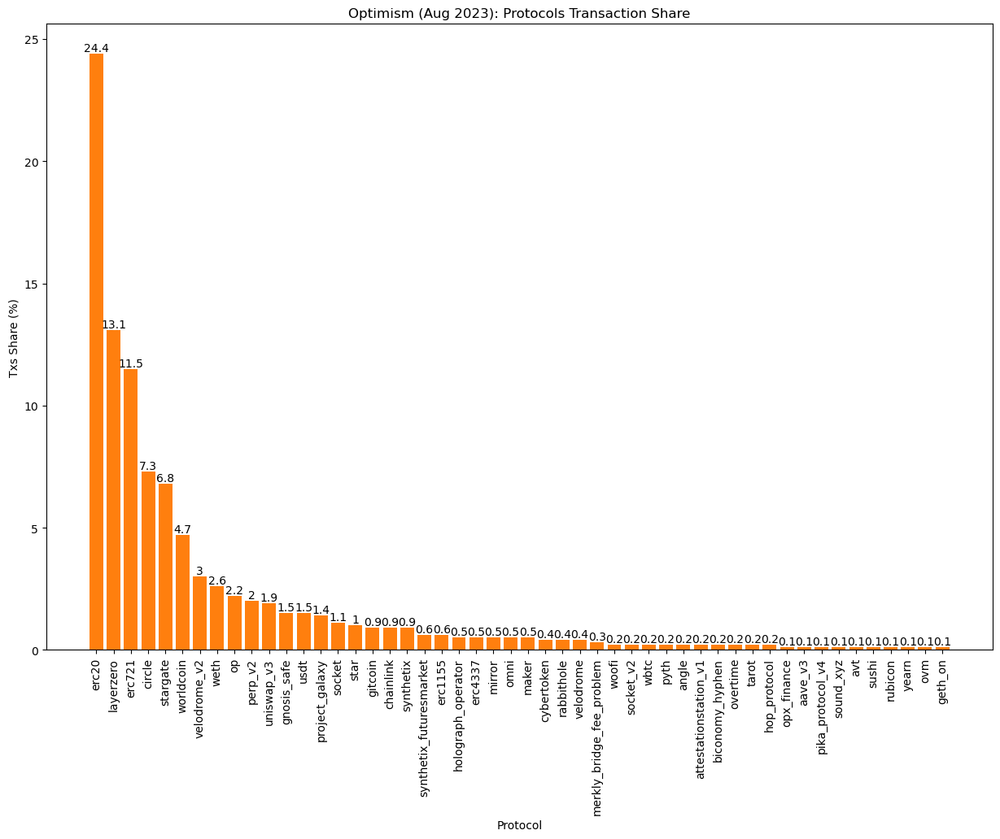

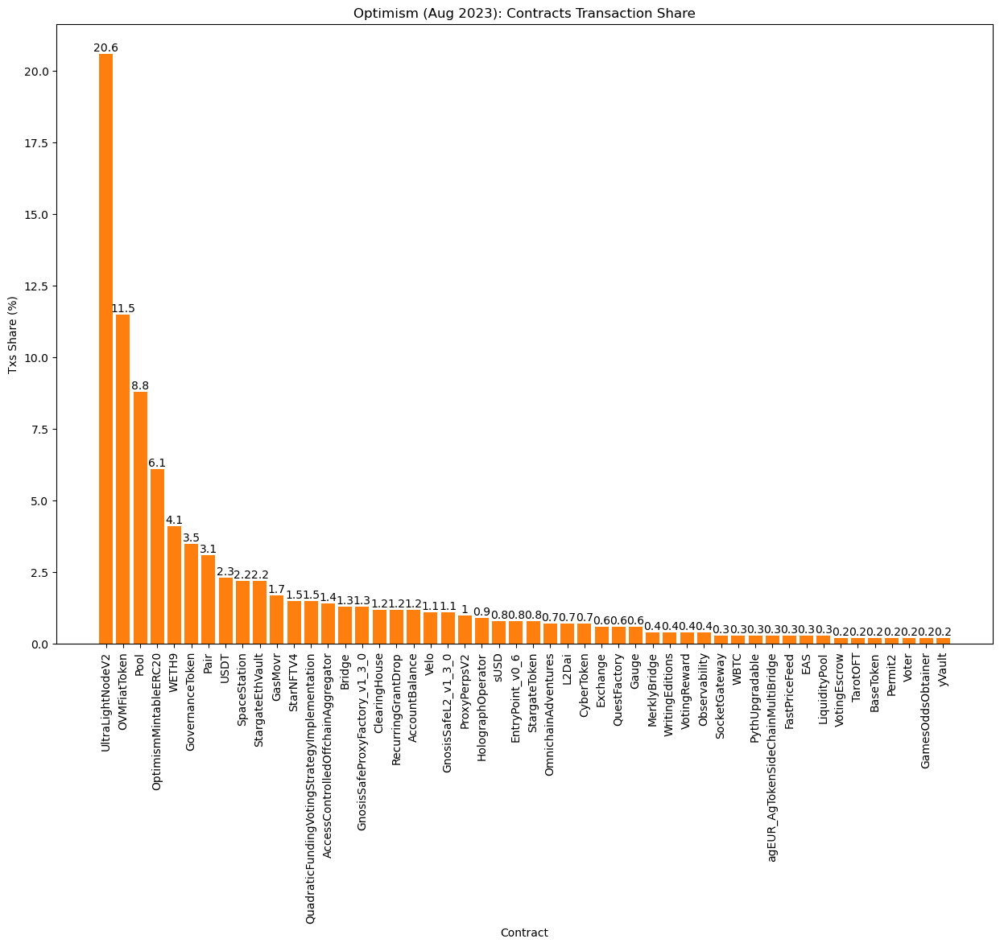

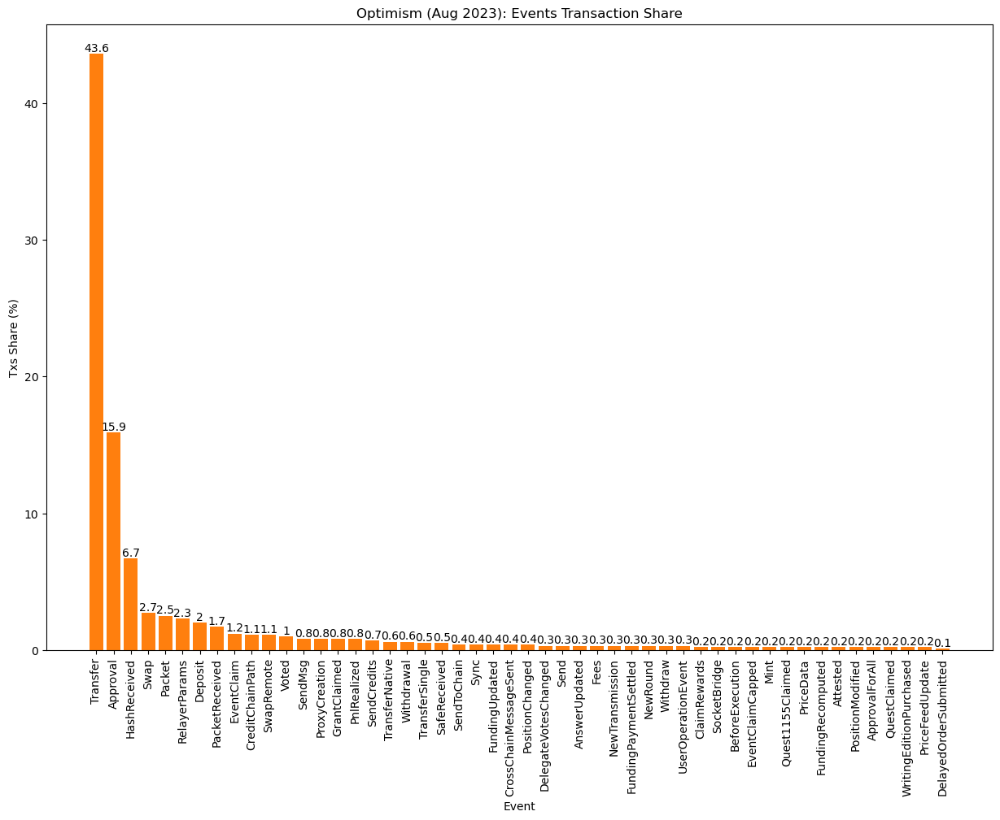

In [27]:
plot_protocolmarketshare(aug_op,'Optimism (Aug 2023)',50)

namespace
erc20           514065
layerzero       275764
erc721          240921
circle          154331
stargate        142445
worldcoin        98309
velodrome_v2     62767
weth             54696
op               47007
perp_v2          42519
contract_name
UltraLightNodeV2         275759
OVMFiatToken             154331
Pool                     117080
OptimismMintableERC20     82189
WETH9                     54696
GovernanceToken           47007
Pair                      41650
USDT                      31304
SpaceStation              29753
StargateEthVault          28884
event_name
Transfer           916832
Approval           334044
HashReceived       141429
Swap                57005
Packet              51601
RelayerParams       47369
Deposit             41579
PacketReceived      35345
EventClaim          25269
CreditChainPath     23864


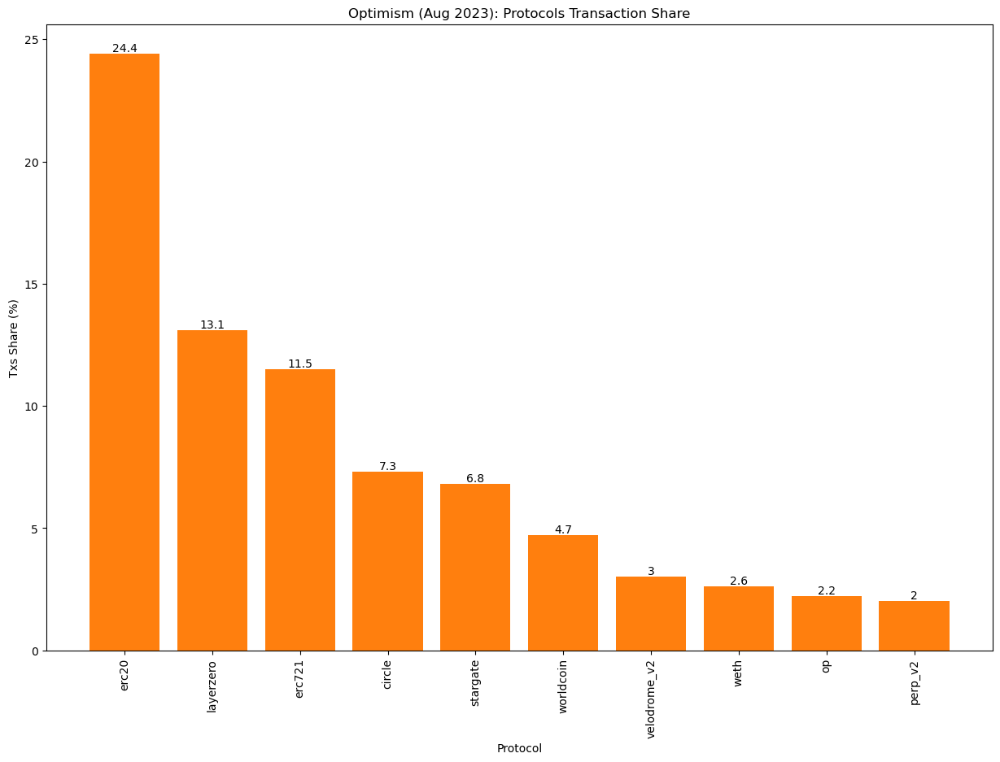

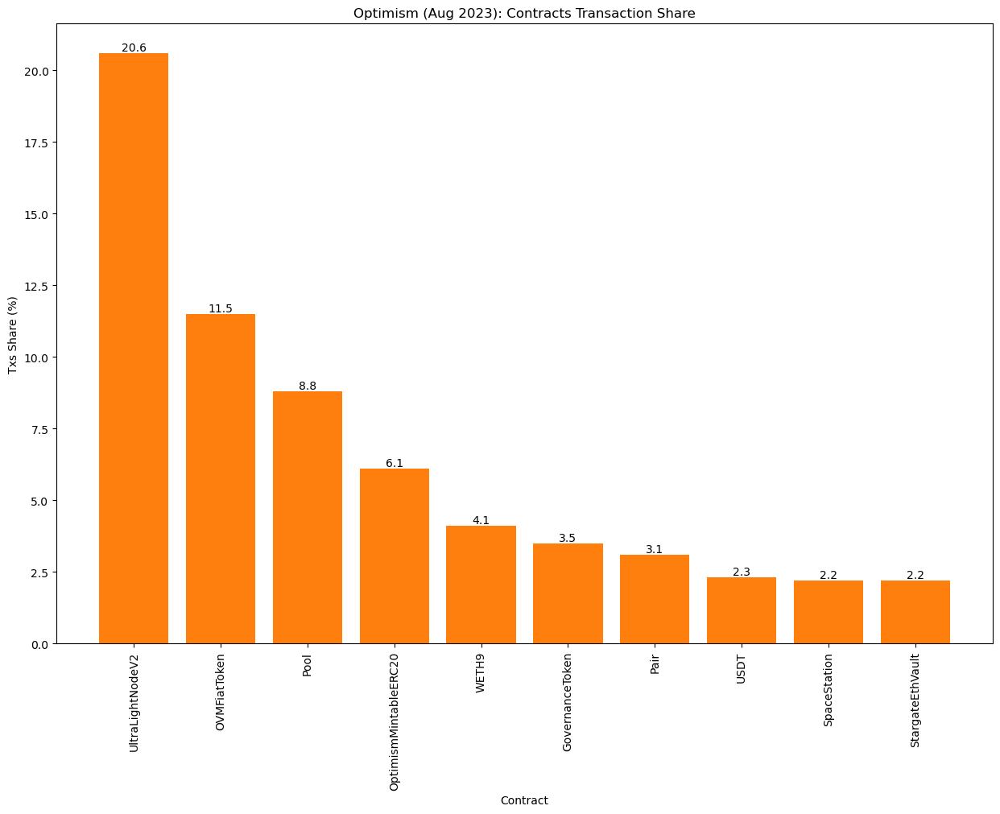

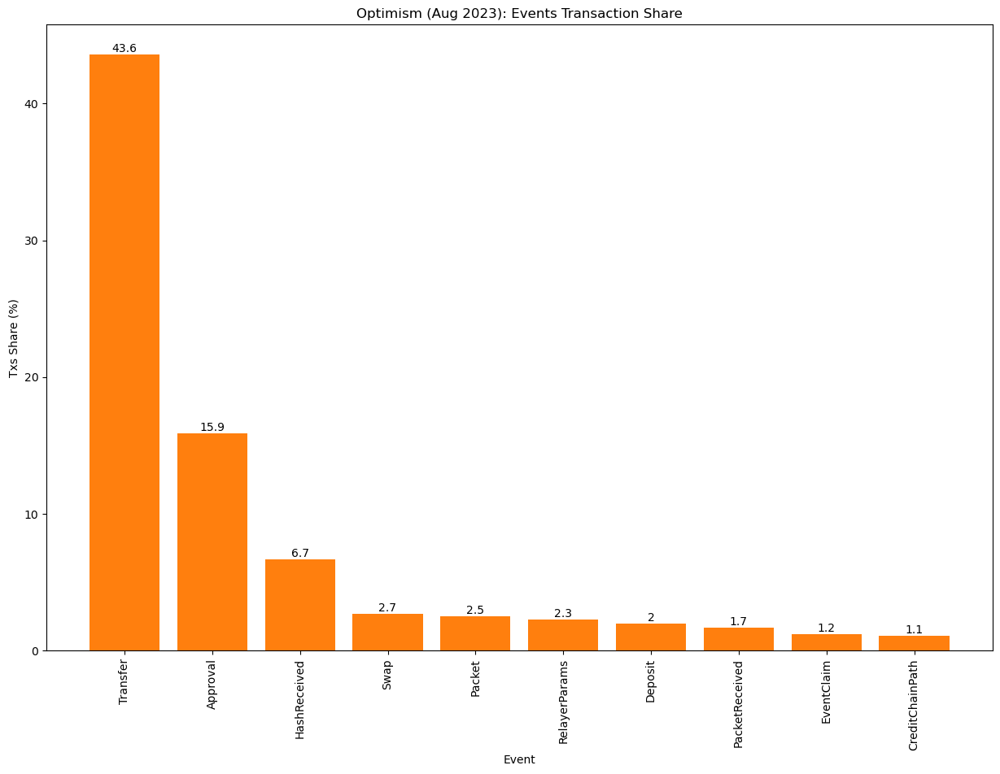

In [28]:
plot_protocolmarketshare(aug_op,'Optimism (Aug 2023)',10)

In [18]:
#What are smart contracts that devs on both Arb and Op are working on?
aug_arb_contracts = list(aug_arb['contract_name'].value_counts()[:50].index)
aug_op_contracts = list(aug_op['contract_name'].value_counts()[:50].index)
aug_contracts_arb_op = set(aug_arb_contracts).intersection(set(aug_op_contracts))

In [31]:
#What are smart contracts that devs on both Arb and Op are working on?
aug_arb_protocols = list(aug_arb['namespace'].value_counts()[:10].index)
aug_op_protocols = list(aug_op['namespace'].value_counts()[:10].index)
aug_protocols_arb_op_t10 = set(aug_arb_protocols).intersection(set(aug_op_protocols))

In [33]:
set(aug_arb_protocols) ^ set(aug_op_protocols)

{'arbitrum',
 'erc4337',
 'op',
 'perp_v2',
 'tether',
 'uniswap_v3',
 'velodrome_v2',
 'worldcoin'}

In [32]:
aug_protocols_arb_op_t10

{'circle', 'erc20', 'erc721', 'layerzero', 'stargate', 'weth'}

In [19]:
aug_contracts_arb_op

{'AccessControlledOffchainAggregator',
 'Bridge',
 'EntryPoint_v0_6',
 'GasMovr',
 'HolographOperator',
 'L2Dai',
 'Pair',
 'Pool',
 'SocketGateway',
 'StargateToken',
 'UltraLightNodeV2',
 'VotingEscrow',
 'agEUR_AgTokenSideChainMultiBridge'}

In [20]:
aug_arb_contracts_valuecount = pd.DataFrame({'contract_name':list(aug_arb['contract_name'].value_counts()[:50].index),
                                            'count':list(aug_arb['contract_name'].value_counts()[:50])})
aug_op_contracts_valuecount = pd.DataFrame({'contract_name':list(aug_op['contract_name'].value_counts()[:50].index),
                                            'count':list(aug_op['contract_name'].value_counts()[:50])})

In [21]:
aug_arb_contracts_valuecount

,contract_name,count
0,UltraLightNodeV2,403037
1,ArbFiatToken,199034
2,ArbitrumExtension,174755
3,Pool,152224
4,EntryPoint_v0_6,142732
5,aeWETH,140582
6,Pair,73216
7,L2ArbitrumToken,54022
8,GasMovr,50342
9,FiatTokenV2_1,48282


In [22]:
aug_arb_contracts_valuecount[aug_arb_contracts_valuecount['contract_name'].isin(aug_contracts_arb_op)]

,contract_name,count
0,UltraLightNodeV2,403037
3,Pool,152224
4,EntryPoint_v0_6,142732
6,Pair,73216
8,GasMovr,50342
10,StargateToken,40188
11,Bridge,35620
16,AccessControlledOffchainAggregator,12135
17,agEUR_AgTokenSideChainMultiBridge,11501
22,L2Dai,8562


In [60]:
aug_op_contracts_valuecount[aug_op_contracts_valuecount['contract_name'].isin(aug_contracts_arb_op)]

,contract_name,count
0,UltraLightNodeV2,275759
2,Pool,117080
6,Pair,41650
10,GasMovr,22751
13,AccessControlledOffchainAggregator,18807
14,Bridge,17801
22,HolographOperator,11519
24,EntryPoint_v0_6,10745
25,StargateToken,10269
27,L2Dai,9505


## Polygon
Launch date: 5/31/2020

In [3]:
#Combine data from 5/30 to 9/8, a roughly 100 day period
#Polygon mainnet launched 5/31
'''temps = ['Chains Data/polygon txs/polygon_0530-0731.csv',
         'Chains Data/polygon txs/polygon_0730-0813.csv',
         'Chains Data/polygon txs/polygon_0813-0817.csv',
         'Chains Data/polygon txs/polygon_0820-0829.csv',
         'Chains Data/polygon txs/polygon_0828-0903.csv',
         'Chains Data/polygon txs/polygon_0905-0908.csv'
        ]'''
temp1 = pd.read_csv('Chains Data/polygon txs/polygon_0530-0731.csv')
temp2 = pd.read_csv('Chains Data/polygon txs/polygon_0730-0813.csv')
temp3 = pd.read_csv('Chains Data/polygon txs/polygon_0813-0817.csv')
temp4 = pd.read_csv('Chains Data/polygon txs/polygon_0816-0821.csv')
temp5 = pd.read_csv('Chains Data/polygon txs/polygon_0820-0829.csv')
temp6 = pd.read_csv('Chains Data/polygon txs/polygon_0828-0903.csv')
temp7 = pd.read_csv('Chains Data/polygon txs/polygon_0905-0908.csv')



poly = pd.concat([temp1,temp2,temp3,temp4,temp5,temp6,temp7],ignore_index=True)

poly['timestamp'] = poly['timestamp'].map(clean_timestamp_transpose)

poly['timestamp'] = pd.to_datetime(poly['timestamp'], format="%Y-%m-%d")

def month_day(t):
    return f"{t.month}-{t.day}"

poly['date'] = poly['timestamp'].map(month_day)

poly = poly.drop_duplicates(subset=['transaction_hash'], keep='first')

poly.sort_values(by='timestamp', inplace = True)

In [4]:
poly

,transaction_hash,timestamp,block_number,base_fee_per_gas,max_priority_fee_per_gas,max_fee_per_gas,gas_limit,gas_used,gas_price,transaction_fee,...,position,type,from_address,to_address,value,contract_address,internal_transaction_count,log_count,__confirmed,date
0,0xf6c3feac09aa84558510f74af0c9bf7fd51ff15f902f...,2020-05-30,447,0,0,0,21000,21000,1000000000,21000000000000,...,0,0,0x5973918275C01F50555d44e92c9d9b353CaDAD54,0xc3F60BC338E0Af8f46F52650C813FBD3C071E165,21,NaN,0,2,True,5-30
15,0x6176fa7a015a84b19e3fe1447975d07c3f5d37e65fbd...,2020-05-30,2809,0,0,0,81699,40850,1000000000,40850000000000,...,0,0,0xA2D9846c352cA61dCb20D6AaD40Cec1d1b228a78,0xa35363CFf92980F8268299D0132D5f45834A9527,0,NaN,0,3,True,5-30
14,0x4ff99e4b76efbb7716cc5e2aa019d7f5498198ecb602...,2020-05-30,2764,0,0,0,38064,38064,1000000000,38064000000000,...,0,0,0xA2D9846c352cA61dCb20D6AaD40Cec1d1b228a78,0x5E1DDF2e5a0eCDD923692d4b4429d8603825A8C6,0,NaN,0,3,True,5-30
13,0x9cb4955dd2cccc44fb564bf37d508261b79376372a7e...,2020-05-30,2751,0,0,0,31027,31027,1000000000,31027000000000,...,0,0,0xA2D9846c352cA61dCb20D6AaD40Cec1d1b228a78,0x0000000000000000000000000000000000001010,1110000000000000000,NaN,0,3,True,5-30
11,0xef029df186fe80862876987b237d848734d534c1c857...,2020-05-30,2304,0,0,0,0,0,0,0,...,0,0,NaN,NaN,0,NaN,0,3,True,5-30
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99167,0xbb6281e2c2e9c10c05e977737a0b9a8988e72483de6b...,2020-09-08,4214244,0,0,0,10000000,109021,1000000000,109021000000000,...,0,0,0xa3EF643AC97d2F9687684507faC9263Ef664F797,0xCBDD8F8Fb5Bc31CA156C1A032cBA7B7d5ce709AC,0,NaN,5,3,True,9-8
99166,0xe011265ff937ef1974f7768461d7379c5f72c604cc3d...,2020-09-08,4214242,0,0,0,21000,21000,1000000000,21000000000000,...,0,0,0xa1Ee9c66944f14dF1015f79497A634685FAC848a,0x31164aFa6f5A9189dAbD6e7761695eEf50330992,1000000000000000000,NaN,0,2,True,9-8
99165,0x942d98d5710ac92f96f5809183eaa16c654d924e447d...,2020-09-08,4214237,0,0,0,18000000,711307,3000000000,2133921000000000,...,0,0,0xb78703c641b264cC20d5CD7949119fa433144077,0xCBDD8F8Fb5Bc31CA156C1A032cBA7B7d5ce709AC,0,NaN,61,12,True,9-8
99185,0xb93c23b33cce3c4eb3f14e551451a79e4f7ae00d2beb...,2020-09-08,4214307,0,0,0,18000000,711327,3000000000,2133981000000000,...,0,0,0xb78703c641b264cC20d5CD7949119fa433144077,0xCBDD8F8Fb5Bc31CA156C1A032cBA7B7d5ce709AC,0,NaN,61,12,True,9-8


In [4]:
txs = poly.groupby(poly['timestamp']).agg({'count'})

In [5]:
poly_txs = pd.read_csv('./Chains Data/polygon txs/polygon_txs.csv')

In [6]:
poly_txs['Date(UTC)'] = pd.to_datetime(poly_txs['Date(UTC)'],format="%m/%d/%Y")

In [8]:
poly_txs100 = poly_txs[poly_txs['Date(UTC)']<datetime.datetime(2020,9,8)]

In [9]:
poly_txs100.iloc[-1]

Date(UTC)        2020-09-07 00:00:00
UnixTimeStamp             1599436800
Value                           2178
Name: 99, dtype: object

Text(0.5, 1.0, 'Polygon transactions per day')

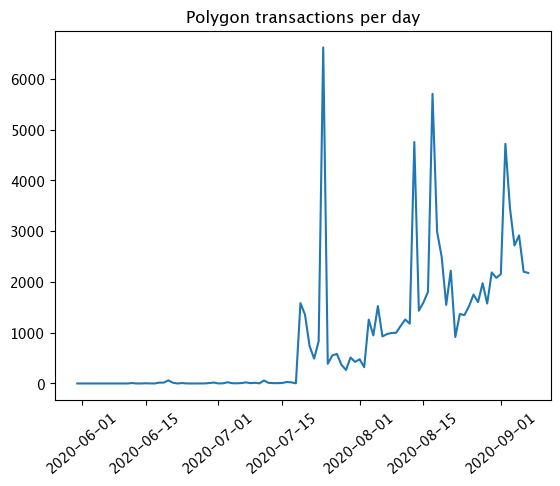

In [10]:
plt.figure(1)
plt.plot(poly_txs100['Date(UTC)'], poly_txs100['Value'])
plt.xticks(rotation=40)
plt.title('Polygon transactions per day')

## Arbitrum
Launch Date: 8/31/2021

In [8]:
path = 'Chains Data/arbitrum'
protocol_arb = agg_dfs(path)

In [9]:
protocol_arb = clean_raw_dune(protocol_arb)

In [10]:
protocol_arb

,block_time,namespace,contract_name,contract_address,tx_hash,event_name,from,to
8212486,2021-08-31,chainlink,AccessControlledOffchainAggregator,0x3607e46698d218b3a5cae44bf381475c0a5e2ca7,0xb78c05cc036ae8f19fc7a3bf69db3b8fd567cfa797c3...,NewRound,0xbd620be125abf8b569b9a3cc132aad0bcf1ff0e7,0x3607e46698d218b3a5cae44bf381475c0a5e2ca7
8212489,2021-08-31,chainlink,AccessControlledOffchainAggregator,0x3607e46698d218b3a5cae44bf381475c0a5e2ca7,0xfc78778aee6818a5ad60afe5a1502936e2af572f5dbb...,AnswerUpdated,0xd596389948247b582317a1efa76cd7741a134191,0x3607e46698d218b3a5cae44bf381475c0a5e2ca7
8212494,2021-08-31,arbitrum_precompiles,ArbRetryableTx,0x000000000000000000000000000000000000006e,0x51fbeae97f40aad4fe2dd8270544516b7da5b09ed12c...,TicketCreated,0x0000000000000000000000000000000000000000,0x000000000000000000000000000000000000006e
8212492,2021-08-31,arbitrum_precompiles,ArbRetryableTx,0x000000000000000000000000000000000000006e,0x8814843dd1cb0f0b0f1163112867e4a69aea23aa1d66...,Redeemed,0x0000000000000000000000000000000000000000,0x000000000000000000000000000000000000006e
8212493,2021-08-31,wrappedbtc,wBTC,0x2f2a2543b76a4166549f7aab2e75bef0aefc5b0f,0x360cb8fb3d75b9c438a0bd2d7e40992909fcc5b5be51...,Transfer,0x0000000000000000000000000000000000000000,0x09e9222e96e7b4ae2a407b98d48e330053351eee
...,...,...,...,...,...,...,...,...
19332508,2021-12-08,arbinyan,NyanRewards,0x32e5594f14de658b0d577d6560fa0d9c6f1aa724,0xc7929fbf717fa1774b5a5356cd44971f508da28983cf...,Staked,0xdadf6d6d69381bf2577b1d37916cbe87ee7aa104,0x7864ba11676b8cc286a7367b3cfd504968920b3a
19232808,2021-12-08,treasure_smolverse,SmolCars,0xb16966dad2b5a5282b99846b23dcdf8c47b6132c,0x033d9592fad20290abedb9c61d8332d91ffce77bc09d...,ApprovalForAll,0x9f29097fd491fb9aefc02a6f490f5a7e89b6c5d2,0xb16966dad2b5a5282b99846b23dcdf8c47b6132c
19399759,2021-12-08,erc20,NaN,0x539bde0d7dbd336b79148aa742883198bbf60342,0x79f6f55b2ceda23465d34887e38a5e615c108249a58d...,Transfer,0xc79c88386c95130bf7c20a184cb8281ed639fab4,0xdf19f1216aa406df8bc585246bee7d96933f285f
19264568,2021-12-08,chainlink,AccessControlledOffchainAggregator,0x3607e46698d218b3a5cae44bf381475c0a5e2ca7,0x68321d4885d7de9f77e83b2ed754947569058bcbf53a...,NewTransmission,0x51c5c8e2267582562f6cf08cf641a1a174946a50,0x3607e46698d218b3a5cae44bf381475c0a5e2ca7


In [7]:
arb = pd.read_csv('Chains Data/arbitrum txs/arbitrum_txs.csv')

In [8]:
arb['Date(UTC)'] = pd.to_datetime(arb['Date(UTC)'], format="%m/%d/%Y").dt.strftime('%Y-%m-%d')

In [9]:
arb['Date(UTC)'] = pd.to_datetime(arb['Date(UTC)'], format='%Y-%m-%d')

In [10]:
#arb_final = arb[arb['Date(UTC)'] < datetime.datetime.strptime('2021-08-20', '%Y-%m-%d')+datetime.timedelta(days=100)]
arb_final = arb[(arb['Date(UTC)'] < datetime.datetime(2021,12,10)) & (arb['Date(UTC)'] > datetime.datetime(2021,8,30))]

In [11]:
arb_final

,Date(UTC),UnixTimeStamp,Value
94,2021-08-31,1630368000,2309
95,2021-09-01,1630454400,26326
96,2021-09-02,1630540800,10205
97,2021-09-03,1630627200,9445
98,2021-09-04,1630713600,9721
...,...,...,...
190,2021-12-05,1638662400,28492
191,2021-12-06,1638748800,30668
192,2021-12-07,1638835200,26940
193,2021-12-08,1638921600,35566


In [9]:
#arb_final = arb_final[arb_final['Date(UTC)'] > datetime.datetime.strptime('2021-08-30', '%Y-%m-%d')]

In [86]:
arb_protocol = pd.read_csv('Chains Data/arbitrum txs/protocols/all_protocols.csv')

/var/folders/g7/mcmk35wn7ls9x6nxdg8_xhlh0000gn/T/ipykernel_53247/3006774532.py:1: DtypeWarning:

Columns (4,5) have mixed types. Specify dtype option on import or set low_memory=False.



In [87]:
arb_protocol.columns

Index(['block_time', 'hash', 'to', 'namespace', 'from', 'name'], dtype='object')

In [91]:
arb_protocol['block_time'] = arb_protocol['block_time'].map(lambda x: datetime.datetime.strptime(x, '%Y-%m-%d'))

In [92]:
arb_protocol['block_time'].iloc[0]

Timestamp('2021-08-30 00:00:00')

In [89]:
arb_protocol_final = arb_protocol['protocol_name'].value_counts()

KeyError: 'protocol_name'

In [18]:
'''path = 'Chains Data/arbitrum txs/arb_txs_full'
filenames = glob.glob(path + "/*.csv")

dfs = []
for filename in filenames:
    dfs.append(pd.read_csv(filename))

# Concatenate all data into one DataFrame
all_arb = pd.concat(dfs, ignore_index=True)

#sort by date and time
all_arb = all_arb.sort_values(by=['timestamp'])

#remove duplicate transactions
all_arb = all_arb.drop_duplicates(subset=['transaction_hash'], keep='first')

#Remove time (H:M:S) from timestamp
all_arb['timestamp'] = all_arb['timestamp'].map(clean_timestamp_transpose)'''

'path = \'Chains Data/arbitrum txs/arb_txs_full\'\nfilenames = glob.glob(path + "/*.csv")\n\ndfs = []\nfor filename in filenames:\n    dfs.append(pd.read_csv(filename))\n\n# Concatenate all data into one DataFrame\nall_arb = pd.concat(dfs, ignore_index=True)\n\n#sort by date and time\nall_arb = all_arb.sort_values(by=[\'timestamp\'])\n\n#remove duplicate transactions\nall_arb = all_arb.drop_duplicates(subset=[\'transaction_hash\'], keep=\'first\')\n\n#Remove time (H:M:S) from timestamp\nall_arb[\'timestamp\'] = all_arb[\'timestamp\'].map(clean_timestamp_transpose)'

In [161]:
all_arb = pd.read_csv('Chains Data/arbitrum txs/all_arb.csv').drop('Unnamed: 0',axis=1)

In [162]:
all_arb

,block_number,timestamp,transaction_hash,gas_limit,gas_used,gas_price,transaction_fee,nonce,position,type,from_address,to_address,value,contract_address,input,output,internal_transaction_count,log_count,__confirmed
0,221024,2021-08-20,0x81dee00757a6c6495ea3f968bbddf18160f6385f156a...,7000000,1715949,445131603,763823129036247,782,0,120,0xA82d4EdB72dD3D167D00058F2404658F4E9A010A,0x3c6AbdA21358c15601A3175D8dd66D0c572cc904,0,NaN,NaN,NaN,0,3,True
1,221025,2021-08-20,0x375ca9add7928017366d214378bbc3e411ca6ee00d78...,7000000,1698002,445131603,755834352157206,783,0,120,0xA82d4EdB72dD3D167D00058F2404658F4E9A010A,0x9b8DdcF800a7BfCdEbaD6D65514dE59160a2C9CC,0,NaN,NaN,NaN,0,3,True
2,221028,2021-08-20,0x3beefa18d5e74e87bc2f1f785419d636cbb1940291c1...,7000000,1739435,445131603,774277489864305,793,0,120,0x5616CAABa92cdf656E7d1bA36Fe1bd878E51c174,0x3607e46698d218B3a5Cae44bF381475C0a5e2ca7,0,NaN,NaN,NaN,0,3,True
3,221026,2021-08-20,0xd263b248b64f8830879dc3e94d96f05b823d4095902c...,1200000,712171,445131603,317009818840113,2566,0,120,0xdA26bd4f89Dff5dFa0A84f0f0ccFc3c73BD0B7D7,0x57469550b9A42d2fd964E67A9DD1DE3d9169b291,0,NaN,NaN,NaN,0,1,True
4,221027,2021-08-20,0xe37c19ae6f7ab340420cd19993fd433ac016953b0c03...,7000000,1733898,445131603,771812796178494,784,0,120,0xA82d4EdB72dD3D167D00058F2404658F4E9A010A,0x3c6AbdA21358c15601A3175D8dd66D0c572cc904,0,NaN,NaN,NaN,0,3,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3722779,3688407,2021-12-08,0x5ef1344a4a22b89e12748c8b670b609f97ffbb1828d9...,3366584,3033134,810074187,2457063559112058,108,0,120,0x4A6c660B1EA3F599C785715CBA79d0aDfCC75521,0x74e87FBA6C4bCd17fe5f14D73f590eD3C13E821B,0,NaN,NaN,NaN,0,1,True
3722780,3688402,2021-12-08,0x89b489e8610b22f0c9fae8840be1b0e5624fe7bea783...,1540886,1376001,810074187,1114662891386187,5,0,120,0x62851211A16fe53D2a609eC6303168bF386055A8,0x2E3b85F85628301a0Bce300Dee3A6B04195A15Ee,0,NaN,NaN,NaN,0,1,True
3722781,3688406,2021-12-08,0x27ff6c56b9d1f428cf9f74e9cbb9adc441bdcb27ef0f...,2070112,1344834,810074187,1089415309199958,319,0,120,0xBAe1169E1DfEaD21EbAadd4576680274f018C368,0x1b02dA8Cb0d097eB8D57A175b88c7D8b47997506,0,NaN,NaN,NaN,0,9,True
3722782,3688416,2021-12-08,0x194c16b21c47cb7b1c7bdbf596121bf554f7f3f3cdea...,4736680,1502285,810074187,1216962300017295,617,0,120,0xF98F2cf2668e8553bB6C619593D30543b499dDDa,0x11C7f9E47E7601A2BAeC9798e768C4a908d7CAfa,0,NaN,NaN,NaN,0,11,True


In [163]:
arb_protocol

,block_time,hash,to,namespace,from,name
0,2021-08-30,0xcb3797a9102e94221389427ff13984b97d25e79ada26...,0xf1e578bb8c28fc118689ad01c63db6e50c4598c1,NaN,NaN,NaN
1,2021-08-30,0xb1bb82eb636d806a5ce72eb66e3fe931b92cae6c85fe...,0x3c6abda21358c15601a3175d8dd66d0c572cc904,NaN,NaN,NaN
2,2021-08-30,0x54d1506106d01d6b87e7959c4a78a993d1679a2905c3...,0x3c6abda21358c15601a3175d8dd66d0c572cc904,NaN,NaN,NaN
3,2021-08-30,0x8173db9f0bf93d4e83af8df3d7928b9924e83a31b363...,0x9b8ddcf800a7bfcdebad6d65514de59160a2c9cc,NaN,NaN,NaN
4,2021-08-30,0x37276f4c47292c9acc0d4a83bd5d914b0389a29e1434...,0x660e7af290f540205a84dccc1f40d0269fc936f5,NaN,NaN,NaN
...,...,...,...,...,...,...
3698600,2021-12-08,0x5f2d1206c9d83f6f929d58ac4460c9e86a918d9e0821...,0xc6d714170fe766691670f12c2b45c1f34405aab6,NaN,NaN,NaN
3698601,2021-12-08,0xe7cfd6c3ada906a829155248ccec3b95ce216f10eeae...,0xc6d714170fe766691670f12c2b45c1f34405aab6,NaN,NaN,NaN
3698602,2021-12-08,0xe345d90b5db60c874ff0be2a9cb49c3622f718c35520...,0xc6d714170fe766691670f12c2b45c1f34405aab6,NaN,NaN,NaN
3698603,2021-12-08,0x1c74952f0c0730395e3254f66ef5d1859728319cdd31...,0x6c2c06790b3e3e3c38e12ee22f8183b37a13ee55,dopex_protocol,NaN,NaN


# zkSync era
Launch date: Mar 24, 2023

In [12]:
'''path = 'Chains Data/zksync/zksync_era'
filenames = glob.glob(path + "/*.csv")

dfs = []
for filename in filenames:
    dfs.append(pd.read_csv(filename))

# Concatenate all data into one DataFrame
all_zksync = pd.concat(dfs, ignore_index=True)

def clean_timestamp_dune(time):
    return datetime.datetime.strptime(time.split()[0], '%Y-%m-%d')

#sort by date and time
all_zksync = all_zksync.sort_values(by=['block_time'])

#remove duplicate transactions
all_zksync = all_zksync.drop_duplicates(subset=['hash'], keep='first')

#Remove time (H:M:S) from timestamp
all_zksync['block_time'] = all_zksync['block_time'].map(clean_timestamp_dune)

all_zksync.to_csv(path+'all_zksync.csv',index=False)'''

'path = \'Chains Data/zksync/zksync_era\'\nfilenames = glob.glob(path + "/*.csv")\n\ndfs = []\nfor filename in filenames:\n    dfs.append(pd.read_csv(filename))\n\n# Concatenate all data into one DataFrame\nall_zksync = pd.concat(dfs, ignore_index=True)\n\ndef clean_timestamp_dune(time):\n    return datetime.datetime.strptime(time.split()[0], \'%Y-%m-%d\')\n\n#sort by date and time\nall_zksync = all_zksync.sort_values(by=[\'block_time\'])\n\n#remove duplicate transactions\nall_zksync = all_zksync.drop_duplicates(subset=[\'hash\'], keep=\'first\')\n\n#Remove time (H:M:S) from timestamp\nall_zksync[\'block_time\'] = all_zksync[\'block_time\'].map(clean_timestamp_dune)\n\nall_zksync.to_csv(path+\'all_zksync.csv\',index=False)'

In [13]:
path = 'Chains Data/zksync/zksync_era'
all_zksync = pd.read_csv(path+'all_zksync.csv')

In [14]:
all_zksync['block_time'] = all_zksync['block_time'].map(clean_timestamp_dune)

In [15]:
all_zksync = all_zksync[all_zksync['block_time']<datetime.datetime(2023,7,3)]

In [16]:
all_zksync

,block_time,block_number,value,gas_limit,gas_price,gas_used,max_fee_per_gas,max_priority_fee_per_gas,priority_fee_per_gas,nonce,index,success,from,to,block_hash,data,hash,type,access_list
0,2023-03-23,16887373.0,10000000000000000000,600000.0,1.192301e+10,141773,1.588798e+10,1.000000e+08,1.000000e+08,0,106,True,0x69d05024c0346ce4f41c4e6e21bfd726d4eeab98,0x32400084c286cf3e17e7b677ea9583e60a000324,0xb940469b0a1df6e5fe5dd72ee363bb055beb3e9bd142...,0xeb672419000000000000000000000000e4edb277e41d...,0xcd315f9186d358868eee139443c1475c915d3f8e62b7...,DynamicFee,NaN
1,2023-03-23,16887395.0,9991847505440200000,600000.0,1.352542e+10,141809,1.352542e+10,1.352542e+10,2.409175e+08,0,92,True,0x259843556e87308033ab5cb333eb46179c84b605,0x32400084c286cf3e17e7b677ea9583e60a000324,0xbc3e46c2982034d232d932015da778b321d6d840da0a...,0xeb67241900000000000000000000000080c67432656d...,0xb30c57c34bb1bac0863ede89346b47a4302d085997c9...,DynamicFee,NaN
2,2023-03-23,16887401.0,9991992510090400000,600000.0,1.311430e+10,141797,1.311430e+10,1.311430e+10,2.595720e+08,0,77,True,0x9289596133fc88d745df0f93c0fbd5a36a1e1efd,0x32400084c286cf3e17e7b677ea9583e60a000324,0xa9fbc00190713017a2f12750a78c6a4cfad62fcbee37...,0xeb67241900000000000000000000000080c67432656d...,0x6fb5887afd971d85e1e946d7509e278111aed3e18e0b...,DynamicFee,NaN
3,2023-03-23,16887414.0,9990488023753000000,600000.0,1.585329e+10,141797,1.585329e+10,1.585329e+10,4.177844e+08,0,53,True,0xa2a76699d8bf369083b4d389c30c041972972c0b,0x32400084c286cf3e17e7b677ea9583e60a000324,0x389b64b7a9faf22b78ff79bb2e0007e31ed05d8a72ba...,0xeb672419000000000000000000000000e4edb277e41d...,0x550a5a3c74ae8bbf40bdb7dccd6a93e894ef177341da...,DynamicFee,NaN
4,2023-03-23,16887416.0,9987825617169879380,600000.0,1.485833e+10,141797,1.485833e+10,1.485833e+10,5.571622e+08,0,35,True,0x5248b4da2f11bdcea6cde6e1e22afea857094cdf,0x32400084c286cf3e17e7b677ea9583e60a000324,0xf973ceb363a24f24fdf0af917a5f7d932675a6b8f2dc...,0xeb672419000000000000000000000000e4edb277e41d...,0xa6c129c5d88be0cccd14645b2f4bd6eecc07dbf75a0a...,DynamicFee,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
590955,2023-07-02,17607707.0,199291872000000000,149181.0,1.416463e+10,118078,NaN,NaN,NaN,1,121,True,0x84a8fcb2bdb4b8501c9ab82a4731854f5641c9a3,0x32400084c286cf3e17e7b677ea9583e60a000324,0x278307776bf49f8627d2a8757473613e508dd8cf7f40...,0xeb67241900000000000000000000000084a8fcb2bdb4...,0x88e8b4b655527e16cc940c39e94bc9cd401470984cc1...,Legacy,NaN
590956,2023-07-02,17607707.0,23892757516214980,149210.0,1.528785e+10,118078,2.170929e+10,1.500000e+09,1.500000e+09,0,25,True,0x0c26110a7ea35928075085a20e2caa76ad223ade,0x32400084c286cf3e17e7b677ea9583e60a000324,0x278307776bf49f8627d2a8757473613e508dd8cf7f40...,0xeb6724190000000000000000000000000c26110a7ea3...,0x2817ee30413b5052338ab33da14ccc33d75c4f4d28c9...,DynamicFee,NaN
590957,2023-07-02,17607708.0,288826110500000000,149210.0,1.533569e+10,118066,2.267759e+10,1.500000e+09,1.500000e+09,3,41,True,0x2e624f03ac2fa501017a05d553d8b9f8f88a825e,0x32400084c286cf3e17e7b677ea9583e60a000324,0xfcfcf4411ec6267ccfa6944fe068e8e143c0f1901c46...,0xeb6724190000000000000000000000002e624f03ac2f...,0x733cb38ae6974713a5f59d6e9d26d65ddab73705ee52...,DynamicFee,NaN
590958,2023-07-02,17607708.0,313684065268081050,149210.0,1.533569e+10,118090,2.262891e+10,1.500000e+09,1.500000e+09,3,39,True,0x801e849df107ff09acc086911e52ab3586b3b624,0x32400084c286cf3e17e7b677ea9583e60a000324,0xfcfcf4411ec6267ccfa6944fe068e8e143c0f1901c46...,0xeb672419000000000000000000000000801e849df107...,0xc8bffe0a392a0caa0de22b6d4c25395d4fc44adefe3a...,DynamicFee,NaN


In [17]:
all_zksync['block_time'].iloc[0]

Timestamp('2023-03-23 00:00:00')

In [18]:
contracts_zksync = pd.read_csv(path+'/contracts.csv')

In [19]:
contracts_zksync['block_time'] = contracts_zksync['block_date']
contracts_zksync = contracts_zksync.drop('block_date',axis=1)
contracts_zksync['block_time'] = contracts_zksync['block_time'].map(clean_timestamp_dune)
contracts_zksync = contracts_zksync[contracts_zksync['block_time']<datetime.datetime(2023,7,3)]
contracts_zksync.sort_values(by='block_time',ascending=True,inplace=True)
contracts_zksync = contracts_zksync.drop_duplicates(subset=['hash'], keep='first')

In [20]:
contracts_zksync

,block_time,block_number,namespace,contract_name,contract_address,tx_hash,index,signature,event_name,block_time.1,...,nonce,index.1,success,from,to,block_hash,data,hash,type,access_list
713,2023-03-23,16892516.0,zksync,MailboxFacet,0x32400084c286cf3e17e7b677ea9583e60a000324,0xfee977b97ded99c4009e10b54d72fc06235a1b6d24bc...,66,0x4531cd5795773d7101c17bdeb9f5ab7f47d705601750...,NewPriorityRequest,2023-03-23 20:08:47.000 UTC,...,24,66,True,0x043da37f21c4c83b97b546724c75600c2d0c9e16,0x32400084c286cf3e17e7b677ea9583e60a000324,0xe3b6295c23ce5f3e80ea08ca485a7cd3fa672bb33fa1...,0xeb672419000000000000000000000000043da37f21c4...,0xfee977b97ded99c4009e10b54d72fc06235a1b6d24bc...,DynamicFee,NaN
738,2023-03-23,16890636.0,zksync,MailboxFacet,0x32400084c286cf3e17e7b677ea9583e60a000324,0x24a413f9760690fb91103695b173050c380c2a03f95e...,131,0x4531cd5795773d7101c17bdeb9f5ab7f47d705601750...,NewPriorityRequest,2023-03-23 13:48:59.000 UTC,...,1396,131,True,0xfa9da51631268a30ec3ddd1ccbf46c65fad99251,0x32400084c286cf3e17e7b677ea9583e60a000324,0xce9fb2c3e237cc0560d937cb81d402ffa81a051bf399...,0xeb672419000000000000000000000000fa9da5163126...,0x24a413f9760690fb91103695b173050c380c2a03f95e...,DynamicFee,NaN
731,2023-03-23,16889181.0,zksync,MailboxFacet,0x32400084c286cf3e17e7b677ea9583e60a000324,0x538014c05ce4a012569fc1d4dccb1e31b887af92b7c5...,49,0x4531cd5795773d7101c17bdeb9f5ab7f47d705601750...,NewPriorityRequest,2023-03-23 08:53:47.000 UTC,...,1394,49,True,0xfa9da51631268a30ec3ddd1ccbf46c65fad99251,0x32400084c286cf3e17e7b677ea9583e60a000324,0xbf354468cfed97fb662f4d96cbd22ef59a453247ef74...,0xeb672419000000000000000000000000fa9da5163126...,0x538014c05ce4a012569fc1d4dccb1e31b887af92b7c5...,DynamicFee,NaN
727,2023-03-23,16892968.0,zksync,MailboxFacet,0x32400084c286cf3e17e7b677ea9583e60a000324,0x867f025e557ea5306eda4fba4e792287bc21a3d2c633...,33,0x4531cd5795773d7101c17bdeb9f5ab7f47d705601750...,NewPriorityRequest,2023-03-23 21:40:23.000 UTC,...,2,33,True,0xcca8009f5e09f8c5db63cb0031052f9cb635af62,0x32400084c286cf3e17e7b677ea9583e60a000324,0xd8256c7c55abdc1a952f6090c6d9155c3f35fa5f8208...,0xeb672419000000000000000000000000cca8009f5e09...,0x867f025e557ea5306eda4fba4e792287bc21a3d2c633...,DynamicFee,NaN
725,2023-03-23,16892966.0,zksync,MailboxFacet,0x32400084c286cf3e17e7b677ea9583e60a000324,0xb413e8e9867dcd97ed23162e4bfc66bcaf7cfe01f541...,49,0x4531cd5795773d7101c17bdeb9f5ab7f47d705601750...,NewPriorityRequest,2023-03-23 21:39:59.000 UTC,...,675,49,True,0xc13b65f7c53cd6db2ea205a4b574b4a0858720a6,0x32400084c286cf3e17e7b677ea9583e60a000324,0xef376082d87a5f06e8945a951d9add102cd3c633ccba...,0xeb672419000000000000000000000000c13b65f7c53c...,0xb413e8e9867dcd97ed23162e4bfc66bcaf7cfe01f541...,DynamicFee,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
94831,2023-07-01,17601879.0,zksync,MailboxFacet,0x32400084c286cf3e17e7b677ea9583e60a000324,0x123b9c88f944e9669636a0cc1634b6b09428140bde04...,25,0x4531cd5795773d7101c17bdeb9f5ab7f47d705601750...,NewPriorityRequest,2023-07-01 21:29:59.000 UTC,...,0,25,True,0x1dce56ab1009b3814735dbf79486be2213014ab8,0x32400084c286cf3e17e7b677ea9583e60a000324,0x7dadf737b5be2a556bb188e13b7db8af14f98d2dbaf7...,0xeb6724190000000000000000000000001dce56ab1009...,0x123b9c88f944e9669636a0cc1634b6b09428140bde04...,DynamicFee,NaN
94829,2023-07-01,17601877.0,zksync,MailboxFacet,0x32400084c286cf3e17e7b677ea9583e60a000324,0xf63626204a419c84974300794c063a703515523283ad...,125,0x4531cd5795773d7101c17bdeb9f5ab7f47d705601750...,NewPriorityRequest,2023-07-01 21:29:35.000 UTC,...,0,125,True,0xff913536a45b1ef2ffb9523d820a2a634396b420,0x32400084c286cf3e17e7b677ea9583e60a000324,0xf997821807e51b1dee1414118c1918c59af35fcde7c2...,0xeb672419000000000000000000000000ff913536a45b...,0xf63626204a419c84974300794c063a703515523283ad...,DynamicFee,NaN
94827,2023-07-01,17601877.0,zksync,MailboxFacet,0x32400084c286cf3e17e7b677ea9583e60a000324,0xe6bf71b260adeb969cc29543a04f3c416b207089f290...,116,0x4531cd5795773d7101c17bdeb9f5ab7f47

In [21]:
contracts_zksync['block_time'].iloc[0]

Timestamp('2023-03-23 00:00:00')

# Optimism

Launch date: 2021-12-16

In [22]:
'''path = 'Chains Data/optimism/'
filenames = glob.glob(path + "/*.csv")

dfs = []
for filename in filenames:
    dfs.append(pd.read_csv(filename))

# Concatenate all data into one DataFrame
all_op = pd.concat(dfs, ignore_index=True)

#sort by date and time
all_op = all_op.sort_values(by=['block_time'])

#remove duplicate transactions
all_op = all_op.drop_duplicates(subset=['hash'], keep='first')

#Remove time (H:M:S) from timestamp
all_op['block_time'] = all_op['block_time'].map(clean_timestamp_dune)

#all_op.to_csv(path+'all_op.csv',index=False)'''

'path = \'Chains Data/optimism/\'\nfilenames = glob.glob(path + "/*.csv")\n\ndfs = []\nfor filename in filenames:\n    dfs.append(pd.read_csv(filename))\n\n# Concatenate all data into one DataFrame\nall_op = pd.concat(dfs, ignore_index=True)\n\n#sort by date and time\nall_op = all_op.sort_values(by=[\'block_time\'])\n\n#remove duplicate transactions\nall_op = all_op.drop_duplicates(subset=[\'hash\'], keep=\'first\')\n\n#Remove time (H:M:S) from timestamp\nall_op[\'block_time\'] = all_op[\'block_time\'].map(clean_timestamp_dune)\n\n#all_op.to_csv(path+\'all_op.csv\',index=False)'

In [11]:
path = 'Chains Data/optimism/'
all_op = pd.read_csv(path+'all_op.csv')
all_op['block_time'] = all_op['block_time'].map(clean_timestamp_dune)

In [12]:
all_op

,block_time,block_number,value,gas_limit,gas_price,gas_used,max_fee_per_gas,max_priority_fee_per_gas,priority_fee_per_gas,nonce,...,hash,type,access_list,l1_gas_used,l1_gas_price,l1_fee,l1_fee_scalar,l1_block_number,l1_timestamp,l1_tx_origin
0,2021-12-16,1232431.0,0,500000.0,1000000,162780.0,NaN,NaN,NaN,241326,...,0x101ed882faaac2a24d2c76c0904fdaa7b1ae86d4213c...,Legacy,NaN,4862,7.200605e+10,5.251401e+14,1.5,13812877.0,1.639613e+09,NaN
1,2021-12-16,1232429.0,0,500000.0,1000000,158517.0,NaN,NaN,NaN,300047,...,0x5c640203f529f664791dc52af0f1b942c547c5700e41...,Legacy,NaN,4862,8.105072e+10,5.911029e+14,1.5,13812877.0,1.639613e+09,NaN
2,2021-12-16,1232432.0,0,1435832.0,1000000,1434008.0,NaN,NaN,NaN,34,...,0xa8e98b71204a9bcc9367fd4225c3b72086c95c7f0517...,Legacy,NaN,4942,7.200605e+10,5.337808e+14,1.5,13812877.0,1.639613e+09,NaN
3,2021-12-16,1232433.0,0,500000.0,1000000,108134.0,NaN,NaN,NaN,346953,...,0x9d8007c546b23137a223a47c78917cf650c7da611158...,Legacy,NaN,4862,7.200605e+10,5.251401e+14,1.5,13812877.0,1.639613e+09,NaN
4,2021-12-16,1232430.0,0,29748.0,0,29748.0,NaN,NaN,NaN,58798,...,0x452062af5d7b8b6656a1726cfefaad16014721fdfd59...,Legacy,NaN,4386,8.105072e+10,5.332327e+14,1.5,13812877.0,1.639613e+09,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4168870,2022-04-06,5386150.0,0,10000000.0,1000000,804894.0,NaN,NaN,NaN,46816,...,0x0709136a5a5cb29336adc6e22bc24aa04bdf012581e0...,Legacy,NaN,5380,6.651975e+10,3.578763e+14,1.0,14529684.0,1.649213e+09,NaN
4168871,2022-04-06,5386152.0,1376000000000000000,21000.0,1000000,21000.0,NaN,NaN,NaN,7,...,0x911ab2ecb1a96279ea16d96fa8b4724a954b1805270e...,Legacy,NaN,3804,6.651975e+10,2.530411e+14,1.0,14529684.0,1.649213e+09,NaN
4168872,2022-04-06,5386147.0,354600000000009002,21000.0,1000000,21000.0,NaN,NaN,NaN,9,...,0x10dfade9df3dbdbb6feb572914eb1e0bc620fa9323b4...,Legacy,NaN,3828,6.651975e+10,2.546376e+14,1.0,14529684.0,1.649213e+09,NaN
4168873,2022-04-06,5386148.0,0,485997.0,1000000,330456.0,NaN,NaN,NaN,265,...,0xdb053e6ee66ad758f659e0f53846048e64baf1e49858...,Legacy,NaN,5524,6.651975e+10,3.674551e+14,1.0,14529684.0,1.649213e+09,NaN


In [13]:
all_op.columns

Index(['block_time', 'block_number', 'value', 'gas_limit', 'gas_price',
       'gas_used', 'max_fee_per_gas', 'max_priority_fee_per_gas',
       'priority_fee_per_gas', 'nonce', 'index', 'success', 'from', 'to',
       'block_hash', 'data', 'hash', 'type', 'access_list', 'l1_gas_used',
       'l1_gas_price', 'l1_fee', 'l1_fee_scalar', 'l1_block_number',
       'l1_timestamp', 'l1_tx_origin'],
      dtype='object')

In [14]:
all_op['block_time'].iloc[0]

Timestamp('2021-12-16 00:00:00')

In [15]:
#contracts
path = 'Chains Data/optimism/contracts'
contracts_op = pd.read_csv(path+'contracts_op.csv')
'''filenames = glob.glob(path + "/*.csv")

dfs = []
for filename in filenames:
    dfs.append(pd.read_csv(filename))

# Concatenate all data into one DataFrame
contracts_op = pd.concat(dfs, ignore_index=True)

contracts_op['block_time'] = contracts_op['block_date']
contracts_op = contracts_op.drop('block_date',axis=1)
contracts_op['block_time'] = contracts_op['block_time'].map(lambda x: datetime.datetime.strptime(x, '%Y-%m-%d'))

#sort by date and time
contracts_op = contracts_op.sort_values(by=['block_time'])

#remove duplicate transactions
contracts_op = contracts_op.drop_duplicates(subset=['tx_hash'], keep='first')

#contracts_op.to_csv(path+'contracts_op.csv',index=False)'''

'filenames = glob.glob(path + "/*.csv")\n\ndfs = []\nfor filename in filenames:\n    dfs.append(pd.read_csv(filename))\n\n# Concatenate all data into one DataFrame\ncontracts_op = pd.concat(dfs, ignore_index=True)\n\ncontracts_op[\'block_time\'] = contracts_op[\'block_date\']\ncontracts_op = contracts_op.drop(\'block_date\',axis=1)\ncontracts_op[\'block_time\'] = contracts_op[\'block_time\'].map(lambda x: datetime.datetime.strptime(x, \'%Y-%m-%d\'))\n\n#sort by date and time\ncontracts_op = contracts_op.sort_values(by=[\'block_time\'])\n\n#remove duplicate transactions\ncontracts_op = contracts_op.drop_duplicates(subset=[\'tx_hash\'], keep=\'first\')\n\n#contracts_op.to_csv(path+\'contracts_op.csv\',index=False)'

In [16]:
contracts_op

,block_time,block_number,namespace,contract_name,contract_address,tx_hash,index,signature,event_name
0,2021-12-15,1193744.0,synthetix,sUSD,0x8c6f28f2f1a3c87f0f938b96d27520d9751ec8d9,0x3351d57be425f1d8bb04f9cf0d6cb018ec6ebec67213...,4,0xddf252ad1be2c89b69c2b068fc378daa952ba7f163c4...,Transfer
1,2021-12-15,1209688.0,erc20,NaN,0x68f180fcce6836688e9084f035309e29bf0a2095,0x46008c84c92cae49e4c97854563be2dd216ddc99df75...,0,0xddf252ad1be2c89b69c2b068fc378daa952ba7f163c4...,Transfer
2,2021-12-15,1209655.0,erc20,NaN,0x94b008aa00579c1307b0ef2c499ad98a8ce58e58,0xc4a3ac15c16291cc82c3ac5f83372a40205868d5863d...,3,0x8c5be1e5ebec7d5bd14f71427d1e84f3dd0314c0f7b2...,Approval
3,2021-12-15,1209656.0,erc20,NaN,0x7f5c764cbc14f9669b88837ca1490cca17c31607,0x66a9e69e95497be59843853a5bf8e3256969d4d77ac4...,8,0xddf252ad1be2c89b69c2b068fc378daa952ba7f163c4...,Transfer
4,2021-12-15,1209643.0,erc20,NaN,0x4200000000000000000000000000000000000006,0x809cc0db2632096c2e4edf6a9722be3ee807daeb22ff...,0,0xddf252ad1be2c89b69c2b068fc378daa952ba7f163c4...,Transfer
...,...,...,...,...,...,...,...,...,...
2542109,2022-04-03,5268164.0,perp_v2,Exchange,0xbd7a3b7dbeb096f0b832cf467b94b091f30c34ec,0xafc424c12d54645372c62709b7d846fadad9f3e87d7e...,0,0x54e4482fe1d38392effe5d53f0e9e72f60221a75a10c...,FundingUpdated
2542110,2022-04-03,5268163.0,perp_v2,ClearingHouse,0x82ac2ce43e33683c58be4cdc40975e73aa50f459,0x4bee587e6599dbbdb6a1a950d5f8eb875dbc734b25c7...,6,0x968bc4f738eae0486dc6736c4b427dbafa4acfdf6eaf...,PositionChanged
2542111,2022-04-03,5268155.0,connext,TransactionManager,0x31efc4aeaa7c39e54a33fdc3c46ee2bd70ae0a09,0x75be7410ac016a5fb8550020e9339ab92357b8dc9288...,0,0x88fbf1dbc326c404155bad4643bd0ddadd23f0636929...,TransactionPrepared
2542112,2022-04-03,5268160.0,erc20,NaN,0x8c6f28f2f1a3c87f0f938b96d27520d9751ec8d9,0x8afc557976c3541fa67a0711af9d03d08b26b1f241d2...,0,0x8c5be1e5ebec7d5bd14f71427d1e84f3dd0314c0f7b2...,Approval


In [17]:
contracts_op['block_time'] = contracts_op['block_time'].map(clean_timestamp_dune)
contracts_op.iloc[0]['block_time']

Timestamp('2021-12-15 00:00:00')

In [18]:
contracts_op['namespace'].value_counts()[:20]

namespace
perp_v2          801975
erc20            542774
uniswap_v3       240125
ovm              186007
chainlink        177499
weth             105959
circle            97917
synthetix         89648
hop_protocol      27963
maker             26937
band_protocol     26040
lyra_v1           25062
usdt              24994
erc721            19033
connext           17413
rubicon           13708
vsand              9517
pika_perp_v2       8397
lyra               8328
zipswap            8258
Name: count, dtype: int64

# Acquisition: how many users does each protocol bring?

In [32]:
def first_time_users_protocol(protocol_df):
    first_times = protocol_df.drop_duplicates(subset=['from']) #get all users' first time (row)
    first_time_users_per_protocol = first_times['namespace'].value_counts().reset_index()
    
    first_time_users_per_protocol_pct = round(first_times['namespace'].value_counts()/sum(first_times['namespace'].value_counts())*100,1)
    first_time_users_per_protocol_pct = first_time_users_per_protocol_pct.reset_index()

    return first_time_users_per_protocol, first_time_users_per_protocol_pct

def plot_first_time_users_protocol(df, df_pct, topn, chain_name):
    #Plot not pct
    fig, ax = plt.subplots()

    ax.barh(df.iloc[:topn]['namespace'], df.iloc[:topn]['count'], align='center')
    ax.invert_yaxis()  # labels read top-to-bottom
    ax.set_xlabel(f'Number of new users each protocol brought to {chain_name}')
    ax.set_ylabel('Protocol')
    ax.set_title(f'Number of new users each protocol brought to {chain_name} (Top {topn})');
    ax.grid(axis='x')
    
    #Plot pct
    fig, ax = plt.subplots()

    ax.barh(df_pct.iloc[:topn]['namespace'], df_pct.iloc[:topn]['count'], align='center')
    ax.invert_yaxis()  # labels read top-to-bottom
    ax.set_xlabel(f'Percent of total new users each protocol brought to {chain_name} (%)')
    ax.set_ylabel('Protocol')
    ax.set_title(f'Percent of total new users each protocol brought to {chain_name} (Top {topn})')
    ax.bar_label(ax.barh(df_pct.iloc[:topn]['namespace'], df_pct.iloc[:topn]['count'],align='center'));
    ax.grid(axis='x')
    ax.set_xlim(0,40)
    


## Arbitrum

In [20]:
first_time_users_per_protocol_arb, first_time_users_per_protocol_pct_arb = first_time_users_protocol(protocol_arb)


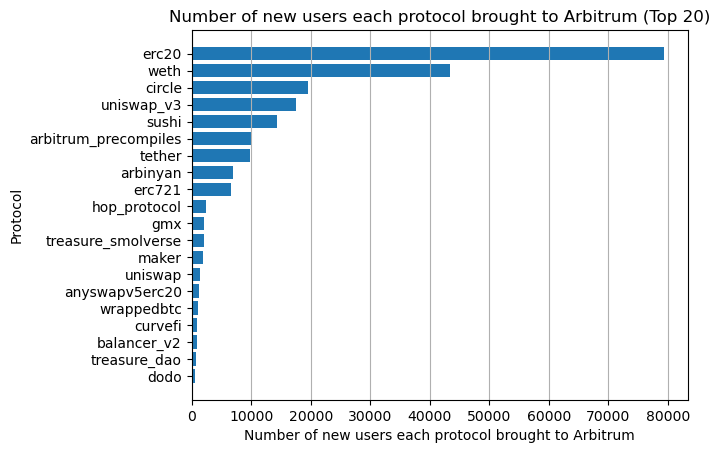

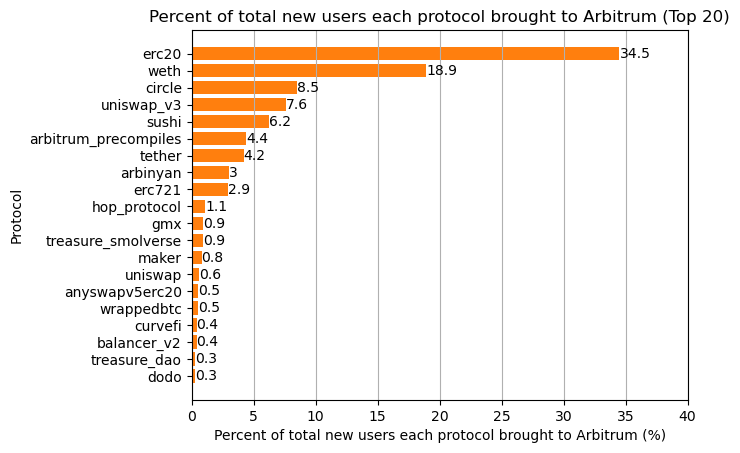

In [33]:
plot_first_time_users_protocol(first_time_users_per_protocol_arb, first_time_users_per_protocol_pct_arb, topn=20, chain_name='Arbitrum')


In [22]:
'''sns.set_theme(style="whitegrid")

# Initialize the matplotlib figure
f, ax = plt.subplots()

# Plot the total crashes
sns.set_color_codes("bright")
sns.barplot(x="count", y="namespace", data=first_time_users_per_protocol_pct_arb.iloc[:20],
            label="count", color="b")

# Add informative axis label
ax.set(xlim=(0, 100), ylabel="Protocol",
       xlabel="Percent of total new users each protocol brought to Arbitrum (Top 20)")
sns.despine(left=True, bottom=True)'''

'sns.set_theme(style="whitegrid")\n\n# Initialize the matplotlib figure\nf, ax = plt.subplots()\n\n# Plot the total crashes\nsns.set_color_codes("bright")\nsns.barplot(x="count", y="namespace", data=first_time_users_per_protocol_pct_arb.iloc[:20],\n            label="count", color="b")\n\n# Add informative axis label\nax.set(xlim=(0, 100), ylabel="Protocol",\n       xlabel="Percent of total new users each protocol brought to Arbitrum (Top 20)")\nsns.despine(left=True, bottom=True)'

## Optimism

In [23]:

protocols_op = pd.merge(contracts_op.rename(columns={'tx_hash':'hash'}), all_op[['hash','from','to']], on='hash')


In [24]:
protocols_op

,block_time,block_number,namespace,contract_name,contract_address,hash,index,signature,event_name,from,to
0,2021-12-16,1233309.0,erc20,NaN,0x7f5c764cbc14f9669b88837ca1490cca17c31607,0xe826311264e3a81bd684c24c34bf203666e539ae3002...,11,0xddf252ad1be2c89b69c2b068fc378daa952ba7f163c4...,Transfer,0xa6a688f107851131f0e1dce493ebbebfaf99203e,0xa81d244a1814468c734e5b4101f7b9c0c577a8fc
1,2021-12-16,1233348.0,erc20,NaN,0x4200000000000000000000000000000000000006,0x746bae267821f219d7cb6bb1f9c4717519aafd25e629...,3,0xddf252ad1be2c89b69c2b068fc378daa952ba7f163c4...,Transfer,0x22851c0ab295397ac5d41af8899debf69c641680,0xc36442b4a4522e871399cd717abdd847ab11fe88
2,2021-12-16,1233335.0,erc20,NaN,0x25d8039bb044dc227f741a9e381ca4ceae2e6ae8,0x07e110f714869029af3382177ab7f629451e03cec8d7...,5,0xddf252ad1be2c89b69c2b068fc378daa952ba7f163c4...,Transfer,0x682cd12ba2d561173e6d1c86ecd7c01be2a7e0e5,0x2ad09850b0ca4c7c1b33f5acd6cbabcab5d6e796
3,2021-12-16,1233349.0,connext,TransactionManager,0x31efc4aeaa7c39e54a33fdc3c46ee2bd70ae0a09,0x06403b12975a202c409977491e5f39b330abe6a30d84...,0,0x88fbf1dbc326c404155bad4643bd0ddadd23f0636929...,TransactionPrepared,0x29a519e21d6a97cdb82270b69c98bac6426cdcf9,0x31efc4aeaa7c39e54a33fdc3c46ee2bd70ae0a09
4,2021-12-16,1233259.0,optimistic_bunnies,OptimisticBunnies,0x52782699900df91b58ecd618e77847c5774dcd2e,0x0cd73e387756724a1ccafffb8c78667d097a8f381f09...,0,0xddf252ad1be2c89b69c2b068fc378daa952ba7f163c4...,Transfer,0x4294d6166b7937cdb4d561399fe0ef061d46e9d7,0x52782699900df91b58ecd618e77847c5774dcd2e
...,...,...,...,...,...,...,...,...,...,...,...
2526640,2022-04-03,5268164.0,perp_v2,Exchange,0xbd7a3b7dbeb096f0b832cf467b94b091f30c34ec,0xafc424c12d54645372c62709b7d846fadad9f3e87d7e...,0,0x54e4482fe1d38392effe5d53f0e9e72f60221a75a10c...,FundingUpdated,0x7462da033c5cceb21691d2447af34f3e333e0b85,0x82ac2ce43e33683c58be4cdc40975e73aa50f459
2526641,2022-04-03,5268163.0,perp_v2,ClearingHouse,0x82ac2ce43e33683c58be4cdc40975e73aa50f459,0x4bee587e6599dbbdb6a1a950d5f8eb875dbc734b25c7...,6,0x968bc4f738eae0486dc6736c4b427dbafa4acfdf6eaf...,PositionChanged,0x94934851b2c6a066f9e5acb353bce4bc7fcdcdbd,0x82ac2ce43e33683c58be4cdc40975e73aa50f459
2526642,2022-04-03,5268155.0,connext,TransactionManager,0x31efc4aeaa7c39e54a33fdc3c46ee2bd70ae0a09,0x75be7410ac016a5fb8550020e9339ab92357b8dc9288...,0,0x88fbf1dbc326c404155bad4643bd0ddadd23f0636929...,TransactionPrepared,0x6c07a2ec9a393a274b9b6eb7425a615e86374c49,0x31efc4aeaa7c39e54a33fdc3c46ee2bd70ae0a09
2526643,2022-04-03,5268160.0,erc20,NaN,0x8c6f28f2f1a3c87f0f938b96d27520d9751ec8d9,0x8afc557976c3541fa67a0711af9d03d08b26b1f241d2...,0,0x8c5be1e5ebec7d5bd14f71427d1e84f3dd0314c0f7b2...,Approval,0x5c63c2923cbe110d302a084ebf1d4ed9a3d6cd04,0x8c6f28f2f1a3c87f0f938b96d27520d9751ec8d9


In [25]:
first_times = protocols_op.drop_duplicates(subset=['from']) #get all users' first time (row)

first_time_users_per_protocol = first_times['namespace'].value_counts().reset_index()

    

In [26]:
first_time_users_per_protocol.iloc[20]

namespace    optipunks
count              274
Name: 20, dtype: object

Text(0.5, 1.0, 'Number of new users each protocol brought to Optimism')

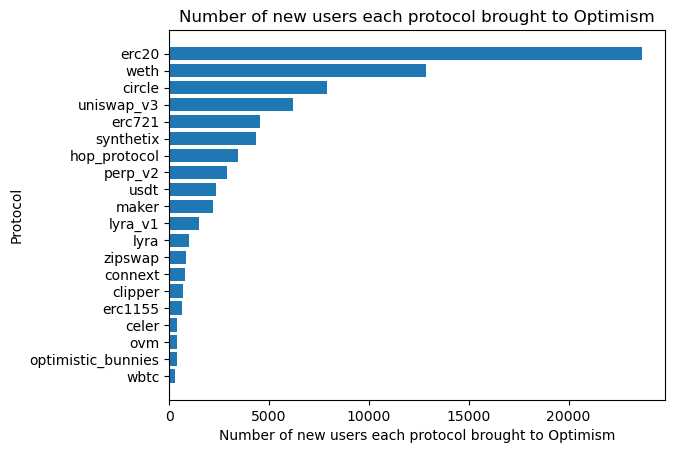

In [132]:
#Plot
fig, ax = plt.subplots()

# Example data
ax.barh(first_time_users_per_protocol.iloc[:20]['namespace'], first_time_users_per_protocol.iloc[:20]['count'], align='center')
#ax.set_yticks(first_time_users_per_protocol['count'], labels=first_time_users_per_protocol['namespace'])
ax.invert_yaxis()  # labels read top-to-bottom
ax.set_xlabel('Number of new users each protocol brought to Optimism')
ax.set_ylabel('Protocol')
ax.set_title('Number of new users each protocol brought to Optimism (Top 20)')

In [143]:
first_time_users_per_protocol_pct = round(first_times['namespace'].value_counts()/sum(first_times['namespace'].value_counts())*100,1)
first_time_users_per_protocol_pct = first_time_users_per_protocol_pct.reset_index()


In [144]:
first_time_users_per_protocol_pct

,namespace,count
0,erc20,29.1
1,weth,15.8
2,circle,9.7
3,uniswap_v3,7.6
4,erc721,5.6
...,...,...
97,l2standarderc20,0.0
98,gladiators,0.0
99,synapsefees,0.0
100,tofu_nft,0.0


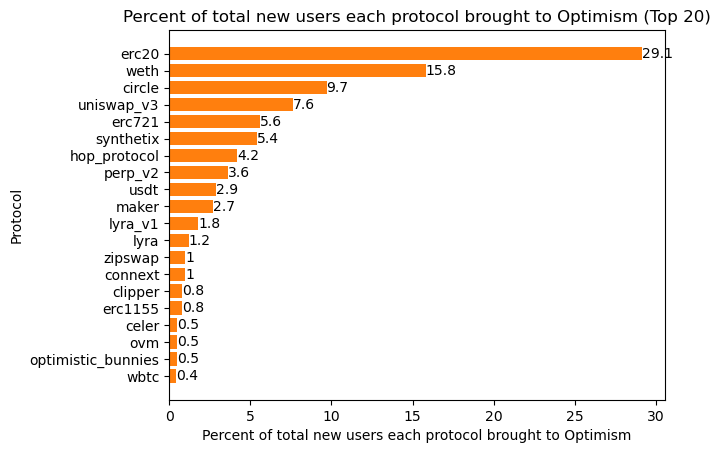

In [147]:
#Plot
fig, ax = plt.subplots()

# Example data
ax.barh(first_time_users_per_protocol_pct.iloc[:20]['namespace'], first_time_users_per_protocol_pct.iloc[:20]['count'], align='center')
#ax.set_yticks(first_time_users_per_protocol['count'], labels=first_time_users_per_protocol['namespace'])
ax.invert_yaxis()  # labels read top-to-bottom
ax.set_xlabel('Percent of total new users each protocol brought to Optimism')
ax.set_ylabel('Protocol')
ax.set_title('Percent of total new users each protocol brought to Optimism (Top 20)')
ax.bar_label(ax.barh(first_time_users_per_protocol_pct.iloc[:20]['namespace'], first_time_users_per_protocol_pct.iloc[:20]['count'], align='center'));


In [27]:
first_time_users_per_protocol_op, first_time_users_per_protocol_pct_op = first_time_users_protocol(protocols_op)


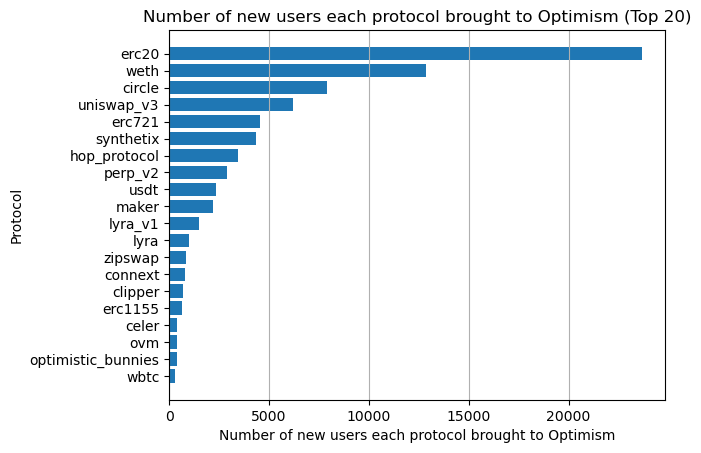

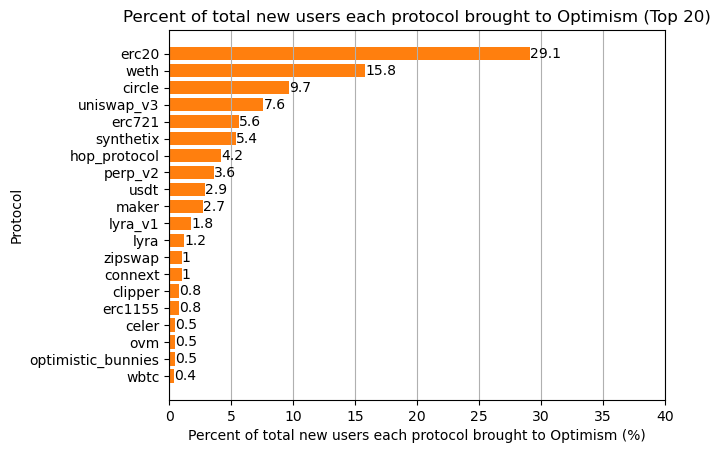

In [34]:
plot_first_time_users_protocol(first_time_users_per_protocol_op, first_time_users_per_protocol_pct_op,20,'Optimism')

# User Retention (average lifespan users)

In [284]:
def calculate_lifespan(user, df):
    if len(df[df['from']==user]) <= 1:
        return 0
    return (df[df['from']==user]['block_time'].iloc[-1] - df[df['from']==user]['block_time'].iloc[0]).days

def users_lifespan_per_protocol(protocol, users_by_protocol, protocols_df, sample_size=385):
    #Operation speed: 0.24 seconds per user
    if len(users_by_protocol[protocol]) < sample_size:
        return [calculate_lifespan(x, protocols_df) for x in users_by_protocol[protocol]]
    reduced_pop = np.random.choice(users_by_protocol[protocol], size=sample_size, replace=False)
    return [calculate_lifespan(x, protocols_df) for x in reduced_pop]
    '''
    n_users = len(users_by_protocol[protocol])
    if n_users <= 1000:
        return [calculate_lifespan(x, protocols_df) for x in users_by_protocol[protocol]]
    else:
        reduced_pop = np.random.choice(users_by_protocol[protocol], size=sample_size, replace=False)
        return [calculate_lifespan(x, protocols_df) for x in reduced_pop]'''
    
def avg_users_lifespan_by_protocol(protocols_df, topn=20):
    #Get a dataframe of all users' first times
    first_times = protocols_df.drop_duplicates(subset=['from']) #get all users' first time (row)
    
    #Dictionary. key: protocol, value: the users each protocol brought on
    users_by_protocol = {}

    for protocol in first_times['namespace'].unique():
        users_by_protocol[protocol] = list(first_times[['namespace','from']][first_times[['namespace','from']]['namespace']==protocol]['from'])

    #Get the lifespan of each user brought on by each protocol
    first_time_users_per_protocol, first_time_users_per_protocol_pct = first_time_users_protocol(protocols_df)
    users_lifespan_by_protocol = {}

    for protocol in tqdm(list(first_time_users_per_protocol['namespace'])[:20]):
        users_lifespan_by_protocol[protocol] = users_lifespan_per_protocol(protocol, 
                                                                          users_by_protocol,
                                                                         protocols_df)
    
    #Get mean, median, and standard deviations of the user lifespans
    mean_users_lifespan_by_protocol = {}
    median_users_lifespan_by_protocol = {}
    std_users_lifespan_by_protocol = {}

    for k, v in users_lifespan_by_protocol.items():
        mean_users_lifespan_by_protocol[k] = np.mean(v)

    for k, v in users_lifespan_by_protocol.items():
        median_users_lifespan_by_protocol[k] = np.median(v)

    for k, v in users_lifespan_by_protocol.items():
        std_users_lifespan_by_protocol[k] = np.std(v)

    #Turn these data into a df
    users_lifespan_by_protocol_df = pd.DataFrame({
    'Protocol':list(mean_users_lifespan_by_protocol.keys()),
    'Mean user lifespan':list(mean_users_lifespan_by_protocol.values()),
    'Median user lifespan':list(median_users_lifespan_by_protocol.values()),
    'Std user lifespan':list(std_users_lifespan_by_protocol.values())
    })

    return users_lifespan_by_protocol_df
    
def plot_users_lifespan_by_protocol(df, chain_name):
    temp = pd.melt(df, id_vars=['Protocol'],value_vars=['Mean user lifespan','Median user lifespan','Std user lifespan'])
    temp = temp.rename(columns={'variable':'User lifespan type'})
    
    plt.figure(figsize=(6,18))
    sns.set_theme(style="whitegrid", palette="bright")
    sns.catplot(x = 'value', y='Protocol', 
            hue = 'User lifespan type',data=temp, 
            kind='bar')
    plt.title(f'{chain_name}: Average user lifespan of users brought by each protocol')
    plt.xlabel('Number of days')
    
def plot_avg_users_lifespan_by_protocol(df, chain_name,ordered=False):
    if ordered:
        plt.figure()
        fig, ax = plt.subplots()
        
        df = df.sort_values(by=['Mean user lifespan'],ascending=False)
        df['Mean user lifespan'] = df['Mean user lifespan'].map(round)
        ax.barh(df['Protocol'], df['Mean user lifespan'], align='center')
        ax.invert_yaxis()  # labels read top-to-bottom
        ax.set_xlabel(f'Avg number of days')
        ax.set_ylabel('Protocol')
        ax.set_title(f'{chain_name}: Average user lifespan of users brought by each protocol (ordered)')
        ax.bar_label(ax.barh(df['Protocol'], df['Mean user lifespan'], align='center'));
        ax.grid(axis='y')
    
    else:
        plt.figure()
        fig, ax = plt.subplots()

        df['Mean user lifespan'] = df['Mean user lifespan'].map(round)
        ax.barh(df['Protocol'], df['Mean user lifespan'], align='center')
        ax.invert_yaxis()  # labels read top-to-bottom
        ax.set_xlabel(f'Avg number of days')
        ax.set_ylabel('Protocol')
        ax.set_title(f'{chain_name}: Average user lifespan of users brought by each protocol (ordered)')
        ax.bar_label(ax.barh(df['Protocol'], df['Mean user lifespan'], align='center'));
        ax.grid(axis='y')
        
        
        
def plot_avg_users_lifespan_by_protocol_sns(df, chain_name,ordered=False):
    if ordered:
        plt.figure()
        sns.set_theme(style="whitegrid",palette="deep")
        ax = sns.catplot(x = 'Mean user lifespan', y='Protocol', data=df.sort_values(by=['Mean user lifespan'],ascending=False), 
                kind='bar')
        plt.title(f'{chain_name}: Average user lifespan of users brought by each protocol (ordered)')
        plt.xlabel('Mean number of days')
        ax.bar_label(ax.containers[0], fmt='%.1f')
    else:
        plt.figure()
        sns.set_theme(style="whitegrid",palette="deep")
        ax = sns.catplot(x = 'Mean user lifespan', y='Protocol', data=df, 
                kind='bar')
        plt.title(f'{chain_name}: Average user lifespan of users brought by each protocol (ordered)')
        plt.xlabel('Mean number of days')
        ax.bar_label(ax.containers[0], fmt='%.1f')
    
def chain_user_freq_t10(protocol_df):
    vc = protocol_df['from'].value_counts(ascending=True)
    temp = {}
    for i in range(1,11):
        temp[i] = len(vc[vc==i])
    
    temp_df = pd.DataFrame({'N Time User':temp.keys(), 'Count':temp.values()})
    return temp_df

def chain_user_freq(protocol_df,topn):
    vc = protocol_df['from'].value_counts(ascending=True)
    temp = {}
    for i in range(1,topn+1):
        temp[i] = len(vc[vc==i])
    
    temp_df = pd.DataFrame({'N Time User':temp.keys(), 'Count':temp.values()})
    return temp_df

def chain_user_freq_pct(protocol_df,topn):
    vc = protocol_df['from'].value_counts(ascending=True)
    temp = {}
    for i in range(1,topn+1):
        temp[i] = round(len(vc[vc==i])/protocol_df['from'].nunique()*100, 1) #not div by this, div by the number of unique addresses
    
    temp_df = pd.DataFrame({'N Time User':temp.keys(), 'Percent of Total Users':temp.values()})
    return temp_df

def plot_chain_user_freq(pop_df,title):
    plt.figure(figsize=(50,30))
    pop_df.plot.bar(x='N Time User',y='Count',rot=360,title=title+': Number of one-time, two-time,... users')
    plt.xlabel(f'N-time Users (1-{len(pop_df)})')
    plt.ylabel('Count')
    plt.grid(False)
    
def plot_chain_user_freq_topn(protocol_df,topn,title):
    
    pop_df = chain_user_freq(protocol_df,topn)
    
    plt.figure(figsize=(50,30))
    pop_df.plot.bar(x='N Time User',y='Count',rot=360,title=title+': Number of one-time, two-time,... users')
    plt.xlabel(f'N-time Users (1-{len(pop_df)})')
    plt.ylabel('Count')
    plt.grid(False)
    
def plot_chain_user_freq_topn_pct(protocol_df,topn,title):
    
    pop_df = chain_user_freq_pct(protocol_df,topn)
    
    plt.figure(figsize=(60,30))
    pop_df.plot.bar(x='N Time User',y='Percent of Total Users',rot=360,title=title+': Number of one-time, two-time,... users',color='orange')
    plt.xlabel(f'N-time Users (1-{len(pop_df)})')
    plt.ylabel('Percent of total users who are one-time,... users (%)')
    addlabels(pop_df['N Time User'], pop_df['Percent of Total Users'])
    plt.grid(False)


In [276]:
protocols_arb['from'].nunique()

229938

In [214]:
'''plt.figure()
        sns.set_theme(style="whitegrid",palette="deep")
        ax = sns.catplot(x = 'Mean user lifespan', y='Protocol', data=df.sort_values(by=['Mean user lifespan'],ascending=False), 
                kind='bar')
        plt.title(f'{chain_name}: Average user lifespan of users brought by each protocol (ordered)')
        plt.xlabel('Mean number of days')
        for bars in ax.containers:
            ax.bar_label(bars, fmt='%.1f')'''


'plt.figure()\n        sns.set_theme(style="whitegrid",palette="deep")\n        ax = sns.catplot(x = \'Mean user lifespan\', y=\'Protocol\', data=df.sort_values(by=[\'Mean user lifespan\'],ascending=False), \n                kind=\'bar\')\n        plt.title(f\'{chain_name}: Average user lifespan of users brought by each protocol (ordered)\')\n        plt.xlabel(\'Mean number of days\')\n        for bars in ax.containers:\n            ax.bar_label(bars, fmt=\'%.1f\')'

In [166]:
users_by_protocol_op

{'erc20': ['0xa6a688f107851131f0e1dce493ebbebfaf99203e',
  '0x22851c0ab295397ac5d41af8899debf69c641680',
  '0x682cd12ba2d561173e6d1c86ecd7c01be2a7e0e5',
  '0x9c1e0c67aa30c063f341885b12cb81cc94613fc7',
  '0x9219216fa5977a5b7951c20fe21a0d288675cdb6',
  '0x89e608b835ab908320901a8a02c8e8f4787a364d',
  '0x73c77c0799ef75444872fd4bee4cf4c8770b3505',
  '0xf9e28f8b9aa7608b522a01a6e27fc6d46b922355',
  '0xd6b764b822aa482913992073598c4690527a3a83',
  '0x13b592251551b7c059f5dc0ee0c36e07968d2fd0',
  '0x42b128db6dd6c3fe90843c5e3d58061d8d9c6785',
  '0xd659e43c92d60ca7bc9eeaaa1db67f23d76bf4d8',
  '0xc6f4afde2a6ac65e77d15786cc4d8df02f2ec182',
  '0x305933e09871d4043b5036e09af794facb3f6170',
  '0xf41581b6cec6fb011c063f4ce6497571bb0781e3',
  '0x1880696379d89d6148eea2250ae5b2f0088e8574',
  '0x00b463741971a12047f467f94840a553793c94bc',
  '0x54d714f025ad966a31d5bae8bffafd390110f2d2',
  '0xb2e62800353979adbcc3226e5fe09f647bf80343',
  '0x0eb62fdc305b7840f82de6144a104f04ac745a69',
  '0xdb611d682cb1ad72fcbacd944a

In [171]:
first_time_users_per_protocol_arb.iloc[:20]

,namespace,count
0,erc20,79353
1,weth,43471
2,circle,19567
3,uniswap_v3,17549
4,sushi,14279
5,arbitrum_precompiles,10038
6,tether,9765
7,arbinyan,6928
8,erc721,6604
9,hop_protocol,2493


In [92]:
erc1155_lifespan = users_lifespan_per_protocol('erc1155',users_by_protocol_op,protocols_op)


In [61]:
calculate_lifespan(users_by_protocol_op['erc20'][0], protocols_op)

108

## Arbitrum

In [169]:
protocols_arb = protocol_arb

In [170]:
users_lifespan_by_protocol_df = avg_users_lifespan_by_protocol(protocols_arb)

100%|██████████████████████████████████████████| 20/20 [35:10<00:00, 105.50s/it]


In [172]:
users_lifespan_by_protocol_arb = users_lifespan_by_protocol_df

/Users/cyrusleung/anaconda3/lib/python3.10/site-packages/seaborn/axisgrid.py:118: UserWarning:

The figure layout has changed to tight



<Figure size 600x1800 with 0 Axes>

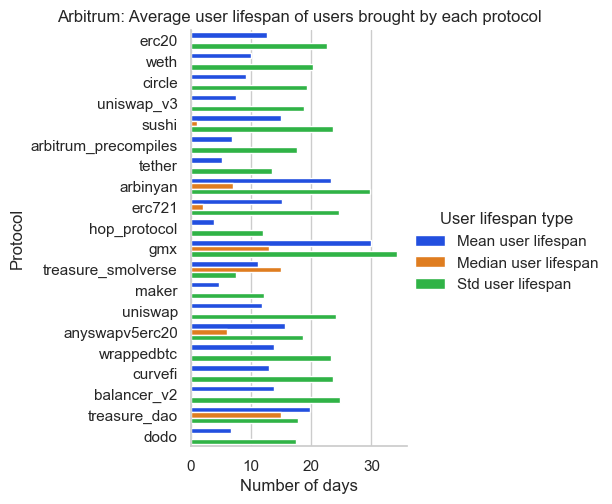

In [173]:
plot_users_lifespan_by_protocol(users_lifespan_by_protocol_arb, 'Arbitrum')

<Figure size 640x480 with 0 Axes>

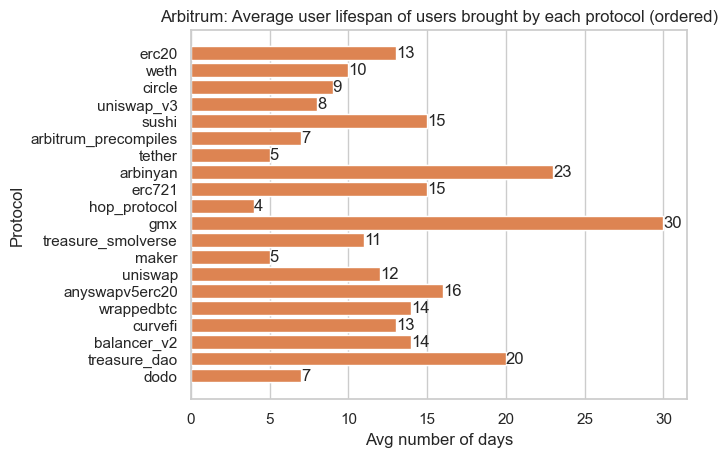

In [224]:
plot_avg_users_lifespan_by_protocol(users_lifespan_by_protocol_arb, 'Arbitrum')

<Figure size 640x480 with 0 Axes>

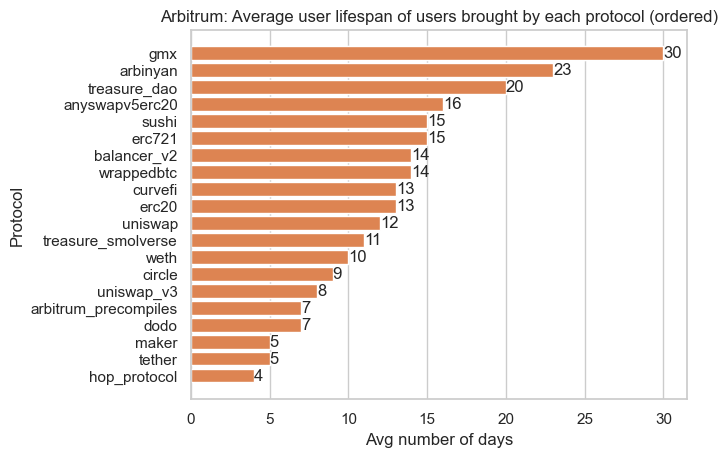

In [225]:
plot_avg_users_lifespan_by_protocol(users_lifespan_by_protocol_arb, 'Arbitrum',ordered=True)

/Users/cyrusleung/anaconda3/lib/python3.10/site-packages/seaborn/axisgrid.py:118: UserWarning:

The figure layout has changed to tight



AttributeError: 'FacetGrid' object has no attribute 'bar_label'

<Figure size 640x480 with 0 Axes>

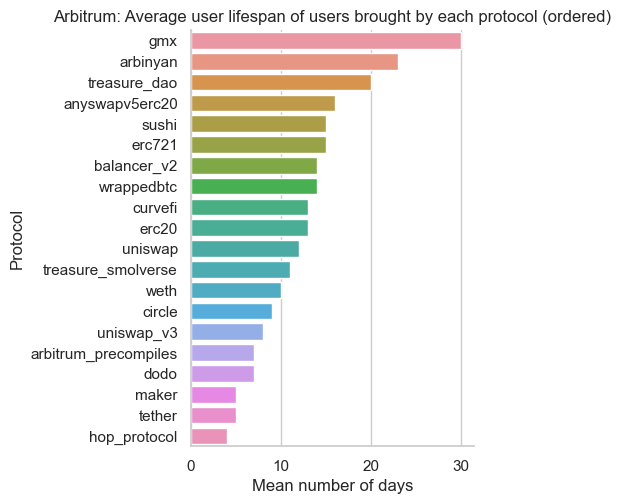

In [227]:
plot_avg_users_lifespan_by_protocol_sns(users_lifespan_by_protocol_arb, 'Arbitrum',ordered=True)

In [233]:
chain_user_freq_arb_100 = chain_user_freq(protocols_arb, 100)

In [234]:
chain_user_freq_arb_10 = chain_user_freq(protocols_arb, 10)

<Figure size 5000x3000 with 0 Axes>

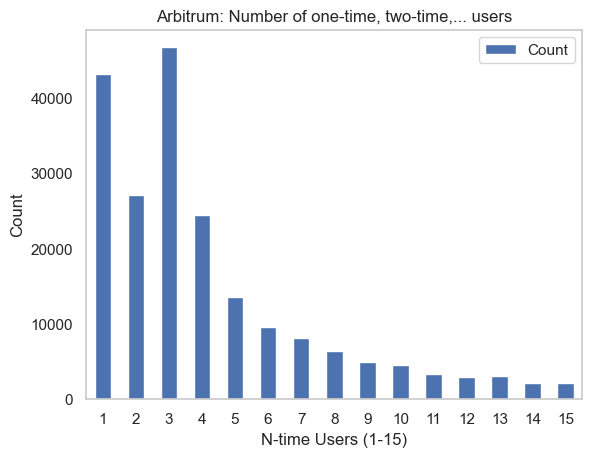

In [269]:
plot_chain_user_freq_topn(protocols_arb,15,'Arbitrum')

<Figure size 5000x3000 with 0 Axes>

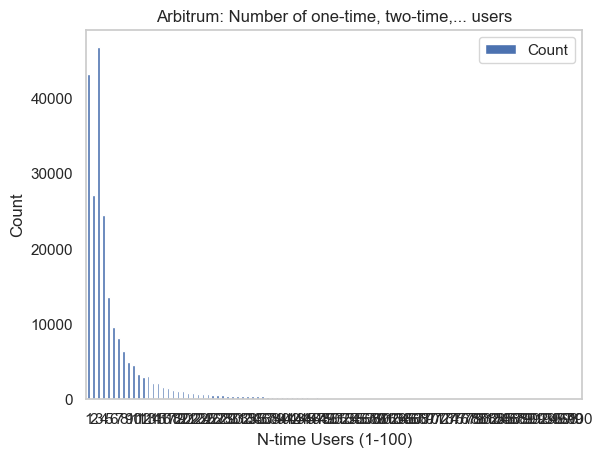

In [240]:
plot_chain_user_freq(chain_user_freq_arb_100,'Arbitrum')

<Figure size 6000x3000 with 0 Axes>

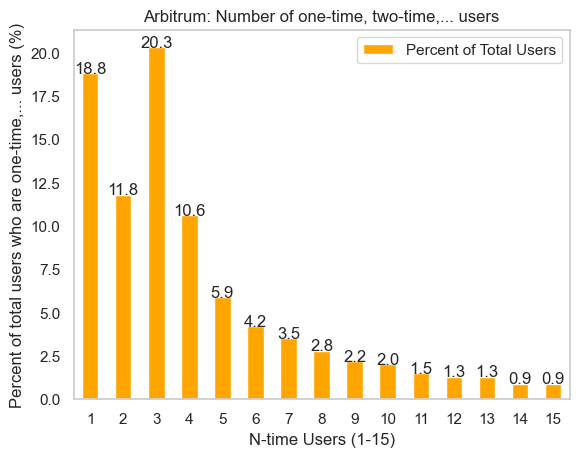

In [285]:
plot_chain_user_freq_topn_pct(protocols_arb,15,'Arbitrum')

## Optimism

In [35]:
first_times = protocols_op.drop_duplicates(subset=['from']) #get all users' first time (row)

In [37]:
first_times[['namespace','from']]

,namespace,from
0,erc20,0xa6a688f107851131f0e1dce493ebbebfaf99203e
1,erc20,0x22851c0ab295397ac5d41af8899debf69c641680
2,erc20,0x682cd12ba2d561173e6d1c86ecd7c01be2a7e0e5
3,connext,0x29a519e21d6a97cdb82270b69c98bac6426cdcf9
4,optimistic_bunnies,0x4294d6166b7937cdb4d561399fe0ef061d46e9d7
...,...,...
2525705,erc20,0x891c466a021e85530ad4bc4b29b52ba660e00d17
2525959,erc20,0x28e9da142923de327ad854a711af4f385a8c8722
2526163,hop_protocol,0xc3608e238949fa912d3e30a16e8e646a193cd9d6
2526526,circle,0x95e047cd32f9863c8d07202e2cbb8005a2f7ca9a


In [44]:
list(first_times[['namespace','from']][first_times[['namespace','from']]['namespace']=='erc20']['from'])


['0xa6a688f107851131f0e1dce493ebbebfaf99203e',
 '0x22851c0ab295397ac5d41af8899debf69c641680',
 '0x682cd12ba2d561173e6d1c86ecd7c01be2a7e0e5',
 '0x9c1e0c67aa30c063f341885b12cb81cc94613fc7',
 '0x9219216fa5977a5b7951c20fe21a0d288675cdb6',
 '0x89e608b835ab908320901a8a02c8e8f4787a364d',
 '0x73c77c0799ef75444872fd4bee4cf4c8770b3505',
 '0xf9e28f8b9aa7608b522a01a6e27fc6d46b922355',
 '0xd6b764b822aa482913992073598c4690527a3a83',
 '0x13b592251551b7c059f5dc0ee0c36e07968d2fd0',
 '0x42b128db6dd6c3fe90843c5e3d58061d8d9c6785',
 '0xd659e43c92d60ca7bc9eeaaa1db67f23d76bf4d8',
 '0xc6f4afde2a6ac65e77d15786cc4d8df02f2ec182',
 '0x305933e09871d4043b5036e09af794facb3f6170',
 '0xf41581b6cec6fb011c063f4ce6497571bb0781e3',
 '0x1880696379d89d6148eea2250ae5b2f0088e8574',
 '0x00b463741971a12047f467f94840a553793c94bc',
 '0x54d714f025ad966a31d5bae8bffafd390110f2d2',
 '0xb2e62800353979adbcc3226e5fe09f647bf80343',
 '0x0eb62fdc305b7840f82de6144a104f04ac745a69',
 '0xdb611d682cb1ad72fcbacd944a8a6e2606a6d158',
 '0x6f0ba4a2e

In [45]:
users_by_protocol_op = {}

for protocol in first_times['namespace'].unique():
    users_by_protocol_op[protocol] = list(first_times[['namespace','from']][first_times[['namespace','from']]['namespace']==protocol]['from'])


In [82]:
first_times[first_times['namespace']=='sablier_v1_1']

,block_time,block_number,namespace,contract_name,contract_address,hash,index,signature,event_name,from,to
2472027,2022-04-02,5221746.0,sablier_v1_1,Sablier,0x6c5927c0679e6d857e87367bb635decbcb20f31c,0x6883ea37a0e9f3024d66031d34ed9695d52c42e29553...,1,0x36c3ab437e6a424ed25dc4bfdeb62706aa06558660fa...,WithdrawFromStream,0x1d7c4a0189d38b021e7a4a53885192c11b945d76,0x6c5927c0679e6d857e87367bb635decbcb20f31c
2472248,2022-04-02,5221705.0,sablier_v1_1,Sablier,0x6c5927c0679e6d857e87367bb635decbcb20f31c,0x31dddf7c90369183616f851d759a0f5e233aa87eae9e...,1,0x36c3ab437e6a424ed25dc4bfdeb62706aa06558660fa...,WithdrawFromStream,0x303e6d19fbaf3a170bf573f89cef46139729390a,0x6c5927c0679e6d857e87367bb635decbcb20f31c
2472259,2022-04-02,5221734.0,sablier_v1_1,Sablier,0x6c5927c0679e6d857e87367bb635decbcb20f31c,0x5bc460eb61497a97a6ae3ba5e871fc3fce986be17324...,1,0x36c3ab437e6a424ed25dc4bfdeb62706aa06558660fa...,WithdrawFromStream,0x71fb7170d2634f09944948cc68725e9e0eb6ff0b,0x6c5927c0679e6d857e87367bb635decbcb20f31c
2472280,2022-04-02,5221674.0,sablier_v1_1,Sablier,0x6c5927c0679e6d857e87367bb635decbcb20f31c,0x357889e2532c7f36783000e18ab0e2df86ef555e93e9...,1,0x36c3ab437e6a424ed25dc4bfdeb62706aa06558660fa...,WithdrawFromStream,0xea2fed383738d070cf2209847a9935f2b899f697,0x6c5927c0679e6d857e87367bb635decbcb20f31c


In [63]:
len(users_by_protocol_op['erc20'])

23651

In [89]:
len(users_by_protocol_op['erc1155'])

627

In [90]:
users_by_protocol_op['erc1155']

['0x384d6a80c87d2f185faf095a137888e5e6156e80',
 '0x17684f441a6d537d67210c7ef3df8341faa1373f',
 '0x1cccc0b10e3f950b3e2744d860e3a8372c103f60',
 '0xc7b42f99c63126b22858f4eed636f805cfe82c91',
 '0xfcd942a3ef69858f8926aeb4a985f0ce4f2f2147',
 '0xa8f3103b293fd41e1a763fda3cf1d8f1fd1c715e',
 '0x0c6307c68a0eff409da8b01f61c86837f0cbcf40',
 '0xec3187204e60a5b0f3a11994dff548fa6737c601',
 '0x1a5245ea5210c3b57b7cfdf965990e63534a7b52',
 '0x6bc153364fce9d55ba2a531cef9aa48010ef8d25',
 '0x93d2c7683647062dd29b2ae4cc47facdb034a7b7',
 '0xa3c983daa3288f2b15bba878a97042dcbf61c698',
 '0xd52b8cbdf6d2158ab3c5367e56d7df85a279d111',
 '0xf0f844c4d63832da392af0420bb3feabfacf1eb2',
 '0x7e788c62c9ca849dce399e90f912beae14424616',
 '0x0bd9edba4059ff66efc18536abf4062e9263a4be',
 '0x53e17e794c576819b5e9c26be2c3d3ebd404a679',
 '0x485efc3c9ce74e870d4b3765049856435f3d08c6',
 '0x4a9a3815060c3bd08fb4d44c9e74513874771b0c',
 '0xbcecf3e57a8123163c56e0657a1027ce93343189',
 '0x91a88e2724f935584561a7fc4b31ed1845aa58f1',
 '0x84356ffca

In [88]:
list(users_by_protocol_op.keys())[:20]

['erc20',
 'connext',
 'optimistic_bunnies',
 'hop_protocol',
 'lyra_v1',
 'weth',
 'perp_v2',
 'ovm',
 'synthetix',
 'lyra',
 'maker',
 'circle',
 'uniswap_v3',
 'usdt',
 'paper',
 'rubicon',
 'wbtc',
 'synapse',
 'celer',
 'erc1155']

In [103]:
list(first_time_users_per_protocol_op['namespace'])[:20]

['erc20',
 'weth',
 'circle',
 'uniswap_v3',
 'erc721',
 'synthetix',
 'hop_protocol',
 'perp_v2',
 'usdt',
 'maker',
 'lyra_v1',
 'lyra',
 'zipswap',
 'connext',
 'clipper',
 'erc1155',
 'celer',
 'ovm',
 'optimistic_bunnies',
 'wbtc']

In [105]:
users_lifespan_by_protocol_op = {}

for protocol in tqdm(list(first_time_users_per_protocol_op['namespace'])[:20]):
    users_lifespan_by_protocol_op[protocol] = users_lifespan_per_protocol(protocol, 
                                                                          users_by_protocol_op,
                                                                         protocols_op)


 95%|████████████████████████████████████████▊  | 19/20 [25:14<01:19, 79.72s/it]


ValueError: Cannot take a larger sample than population when 'replace=False'

In [120]:
users_lifespan_by_protocol_op['wbtc'] = wbtc_lifespan

In [110]:
set(list(first_time_users_per_protocol_op['namespace'])[:20]) - set(list(users_lifespan_by_protocol_op.keys()))


{'wbtc'}

In [113]:
wbtc_lifespan = users_lifespan_per_protocol('wbtc',users_by_protocol_op,protocols_op)

In [118]:
protocols_op[protocols_op['from']=='0x1bc4c23691b5f68a6b408571b34aff15d519a67d']['block_time'].iloc[-1] - protocols_op[protocols_op['from']=='0x1bc4c23691b5f68a6b408571b34aff15d519a67d']['block_time'].iloc[0]


Timedelta('7 days 00:00:00')

In [114]:
wbtc_lifespan

[108,
 106,
 106,
 7,
 0,
 105,
 0,
 0,
 0,
 0,
 54,
 0,
 24,
 105,
 96,
 0,
 0,
 0,
 0,
 60,
 24,
 103,
 92,
 0,
 0,
 0,
 74,
 0,
 0,
 37,
 0,
 51,
 72,
 102,
 8,
 0,
 31,
 0,
 0,
 0,
 100,
 76,
 94,
 65,
 49,
 1,
 38,
 0,
 38,
 99,
 0,
 0,
 0,
 1,
 83,
 0,
 0,
 100,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 54,
 0,
 16,
 63,
 6,
 0,
 7,
 0,
 0,
 0,
 0,
 0,
 0,
 74,
 80,
 0,
 52,
 6,
 0,
 0,
 0,
 88,
 0,
 0,
 56,
 2,
 0,
 4,
 0,
 22,
 7,
 66,
 0,
 0,
 15,
 0,
 18,
 28,
 0,
 25,
 5,
 3,
 63,
 2,
 4,
 0,
 0,
 63,
 0,
 0,
 6,
 0,
 0,
 74,
 74,
 0,
 38,
 0,
 32,
 1,
 0,
 0,
 73,
 0,
 0,
 48,
 58,
 5,
 69,
 1,
 1,
 2,
 29,
 59,
 59,
 59,
 67,
 31,
 0,
 10,
 4,
 4,
 4,
 0,
 1,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 29,
 16,
 0,
 0,
 11,
 0,
 6,
 0,
 0,
 35,
 50,
 0,
 0,
 0,
 0,
 4,
 41,
 1,
 41,
 3,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 29,
 0,
 0,
 22,
 42,
 0,
 40,
 38,
 0,
 0,
 0,
 31,
 0,
 0,
 1,
 0,
 0,
 0,
 0,
 0,
 27,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 31,
 23,
 0,
 0,
 0,
 0,
 6,
 0,


In [125]:
np.median(wbtc_lifespan)

0.0

In [130]:
mean_users_lifespan_by_protocol_op = {}
median_users_lifespan_by_protocol_op = {}
std_users_lifespan_by_protocol_op = {}

for k, v in users_lifespan_by_protocol_op.items():
    mean_users_lifespan_by_protocol_op[k] = np.mean(v)
    
for k, v in users_lifespan_by_protocol_op.items():
    median_users_lifespan_by_protocol_op[k] = np.median(v)
    
for k, v in users_lifespan_by_protocol_op.items():
    std_users_lifespan_by_protocol_op[k] = np.std(v)



In [127]:
mean_users_lifespan_by_protocol_op

{'erc20': 17.083116883116883,
 'weth': 9.75844155844156,
 'circle': 10.675324675324676,
 'uniswap_v3': 14.877922077922078,
 'erc721': 6.488311688311688,
 'synthetix': 39.84415584415584,
 'hop_protocol': 8.348051948051948,
 'perp_v2': 19.03116883116883,
 'usdt': 10.584415584415584,
 'maker': 14.615584415584415,
 'lyra_v1': 37.07012987012987,
 'lyra': 34.22077922077922,
 'zipswap': 20.857142857142858,
 'connext': 7.605194805194805,
 'clipper': 9.01038961038961,
 'erc1155': 20.703896103896103,
 'celer': 14.64935064935065,
 'ovm': 8.52987012987013,
 'optimistic_bunnies': 16.415584415584416,
 'wbtc': 14.813793103448276}

In [128]:
median_users_lifespan_by_protocol_op

{'erc20': 0.0,
 'weth': 0.0,
 'circle': 0.0,
 'uniswap_v3': 0.0,
 'erc721': 0.0,
 'synthetix': 16.0,
 'hop_protocol': 0.0,
 'perp_v2': 1.0,
 'usdt': 0.0,
 'maker': 0.0,
 'lyra_v1': 25.0,
 'lyra': 20.0,
 'zipswap': 11.0,
 'connext': 0.0,
 'clipper': 0.0,
 'erc1155': 0.0,
 'celer': 0.0,
 'ovm': 0.0,
 'optimistic_bunnies': 0.0,
 'wbtc': 0.0}

In [131]:
std_users_lifespan_by_protocol_op

{'erc20': 29.41133893275699,
 'weth': 21.934171588768645,
 'circle': 22.41140801712758,
 'uniswap_v3': 27.622655031819715,
 'erc721': 17.865165801012193,
 'synthetix': 43.77731872416368,
 'hop_protocol': 21.893328227576966,
 'perp_v2': 29.111591210198007,
 'usdt': 23.541149741505084,
 'maker': 27.302114779110155,
 'lyra_v1': 35.075692048916245,
 'lyra': 37.265500000696434,
 'zipswap': 23.760992964140396,
 'connext': 20.22971901573419,
 'clipper': 14.844471483162934,
 'erc1155': 31.551164144074757,
 'celer': 28.460209741661828,
 'ovm': 22.004480446568,
 'optimistic_bunnies': 29.826664027278017,
 'wbtc': 27.985584024611192}

In [133]:
users_lifespan_by_protocol_op_df = pd.DataFrame({
    'Protocol':list(mean_users_lifespan_by_protocol_op.keys()),
    'Mean user lifespan':list(mean_users_lifespan_by_protocol_op.values()),
    'Median user lifespan':list(median_users_lifespan_by_protocol_op.values()),
    'Std user lifespan':list(std_users_lifespan_by_protocol_op.values())
})

In [134]:
users_lifespan_by_protocol_op_df

,Protocol,Mean user lifespan,Median user lifespan,Std user lifespan
0,erc20,17.083117,0.0,29.411339
1,weth,9.758442,0.0,21.934172
2,circle,10.675325,0.0,22.411408
3,uniswap_v3,14.877922,0.0,27.622655
4,erc721,6.488312,0.0,17.865166
5,synthetix,39.844156,16.0,43.777319
6,hop_protocol,8.348052,0.0,21.893328
7,perp_v2,19.031169,1.0,29.111591
8,usdt,10.584416,0.0,23.541150
9,maker,14.615584,0.0,27.302115


In [137]:
temp_df = pd.melt(users_lifespan_by_protocol_op_df, id_vars=['Protocol'],value_vars=['Mean user lifespan','Median user lifespan','Std user lifespan'])

In [140]:
temp_df = temp_df.rename(columns={'variable':'User lifespan type'})

In [141]:
temp_df

,Protocol,User lifespan type,value
0,erc20,Mean user lifespan,17.083117
1,weth,Mean user lifespan,9.758442
2,circle,Mean user lifespan,10.675325
3,uniswap_v3,Mean user lifespan,14.877922
4,erc721,Mean user lifespan,6.488312
5,synthetix,Mean user lifespan,39.844156
6,hop_protocol,Mean user lifespan,8.348052
7,perp_v2,Mean user lifespan,19.031169
8,usdt,Mean user lifespan,10.584416
9,maker,Mean user lifespan,14.615584


/Users/cyrusleung/anaconda3/lib/python3.10/site-packages/seaborn/axisgrid.py:118: UserWarning:

The figure layout has changed to tight



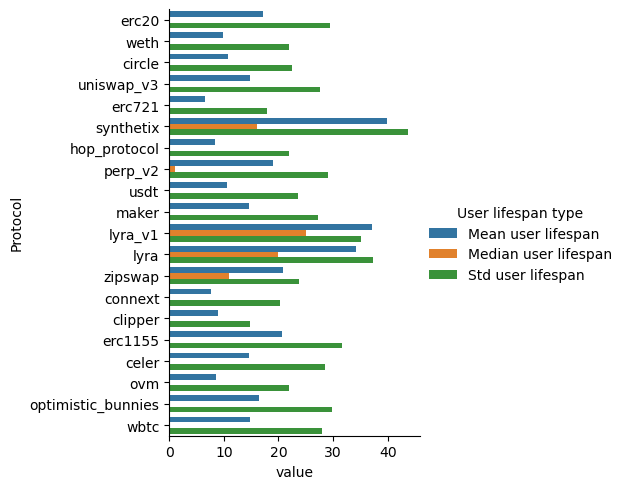

In [142]:
sns.catplot(x = 'value', y='Protocol', 
            hue = 'User lifespan type',data=temp_df, 
            kind='bar')

/Users/cyrusleung/anaconda3/lib/python3.10/site-packages/seaborn/axisgrid.py:118: UserWarning:

The figure layout has changed to tight



<Figure size 600x1800 with 0 Axes>

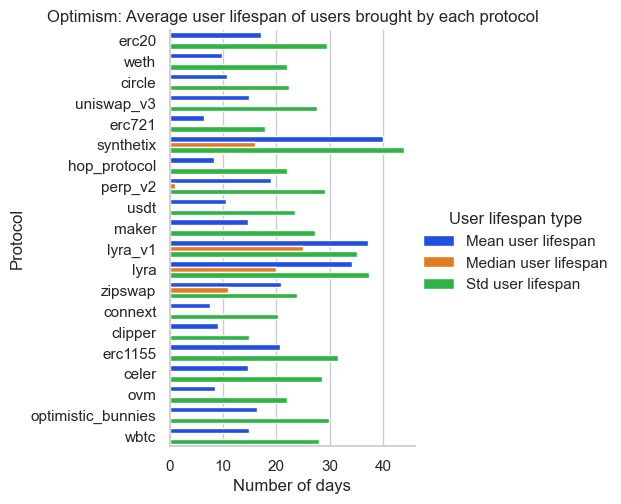

In [157]:
plot_users_lifespan_by_protocol(users_lifespan_by_protocol_op_df, 'Optimism')

<Figure size 640x480 with 0 Axes>

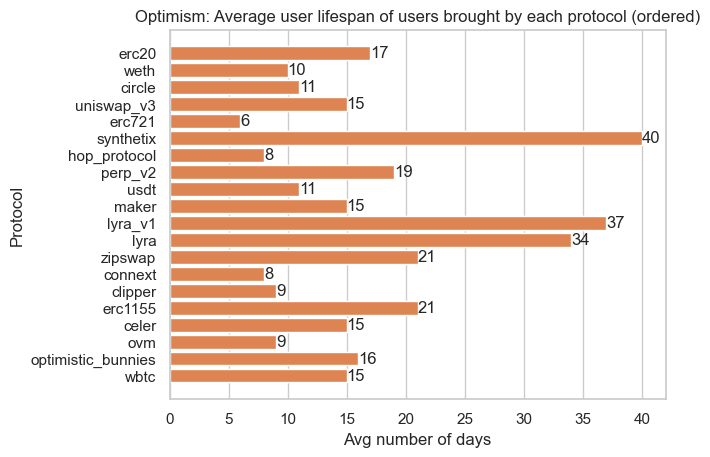

In [228]:
plot_avg_users_lifespan_by_protocol(users_lifespan_by_protocol_op_df, 'Optimism')

<Figure size 640x480 with 0 Axes>

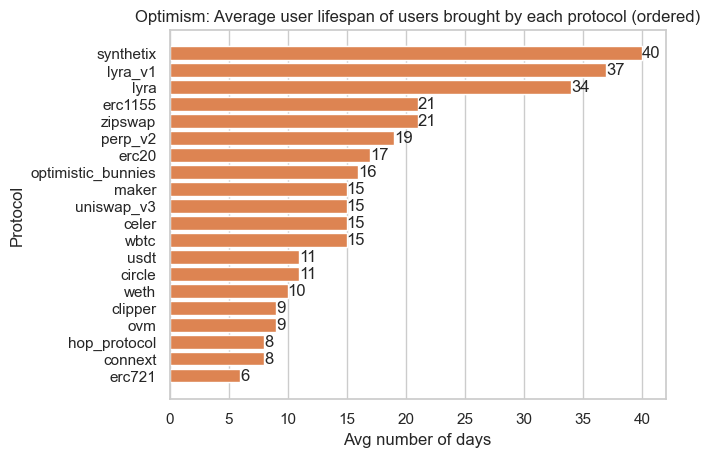

In [229]:
plot_avg_users_lifespan_by_protocol(users_lifespan_by_protocol_op_df, 'Optimism',ordered=True)

/Users/cyrusleung/anaconda3/lib/python3.10/site-packages/seaborn/axisgrid.py:118: UserWarning:

The figure layout has changed to tight



<Figure size 640x480 with 0 Axes>

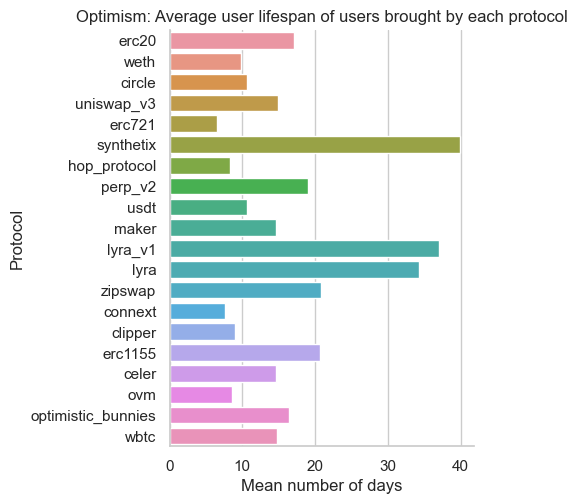

In [164]:
plot_avg_users_lifespan_by_protocol_sns(users_lifespan_by_protocol_op_df, 'Optimism')

/Users/cyrusleung/anaconda3/lib/python3.10/site-packages/seaborn/axisgrid.py:118: UserWarning:

The figure layout has changed to tight



<Figure size 640x480 with 0 Axes>

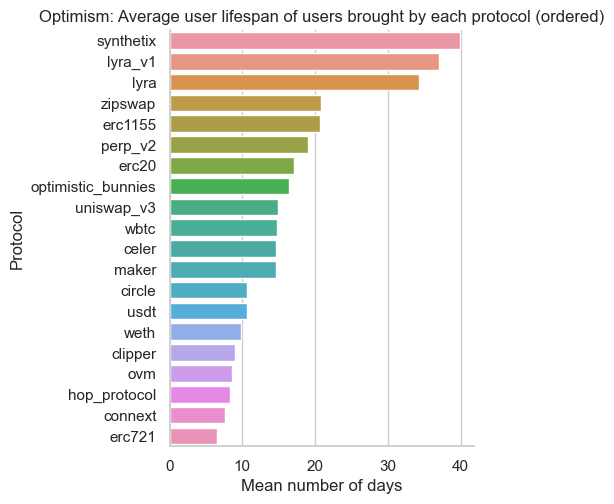

In [186]:
plot_avg_users_lifespan_by_protocol(users_lifespan_by_protocol_op_df, 'Optimism',ordered=True)

<Figure size 6000x3000 with 0 Axes>

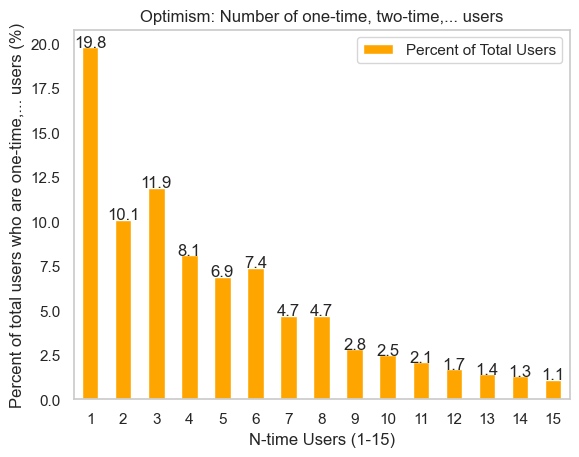

In [286]:
plot_chain_user_freq_topn_pct(protocols_op,15,'Optimism')

# Chain User Retention

In [36]:
def userretention_mom(protocol_df,app='Dune'):
    '''
    Func: For an interval of every month, calculate the percentage of users that returned
    '''
    userretention_df = pd.DataFrame(columns=['Month','User Retention (%)'])
    
    if app=='Dune':
        year_month = protocol_df['block_time'].dt.to_period('M').unique().map(lambda x: datetime.datetime.strptime(str(x),'%Y-%m'))
        year_month = [ts.to_pydatetime() for ts in year_month]
        df_copy = protocol_df.copy()
        df_copy['Year'] = df_copy['block_time'].dt.year
        df_copy['Month'] = df_copy['block_time'].dt.month

        add = {} #addresses

        for ym in year_month:
            add[ym] = list(df_copy[(df_copy['Year']==ym.year) & (df_copy['Month']==ym.month)]['from'].unique())

        pct = {}
        dts = list(add.keys())
        vals = list(add.values())

        for i in range(1,len(add)):
            pct[dts[i].strftime('%Y-%m')] = round((len(set(vals[i-1]) & set(vals[i]))/len(vals[i-1]))*100,0)

        userretention_df['Month'] = list(pct.keys())
        userretention_df['User Retention (%)'] = list(pct.values())

        return userretention_df
    
    elif app=='Transpose':
        year_month = protocol_df['timestamp'].dt.to_period('M').unique().map(lambda x: datetime.datetime.strptime(str(x),'%Y-%m'))
        year_month = [ts.to_pydatetime() for ts in year_month]
        df_copy = protocol_df.copy()
        df_copy['Year'] = df_copy['timestamp'].dt.year
        df_copy['Month'] = df_copy['timestamp'].dt.month

        add = {} #addresses

        for ym in year_month:
            add[ym] = list(df_copy[(df_copy['Year']==ym.year) & (df_copy['Month']==ym.month)]['from_address'].unique())

        pct = {}
        dts = list(add.keys())
        vals = list(add.values())

        for i in range(1,len(add)):
            pct[dts[i].strftime('%Y-%m')] = round((len(set(vals[i-1]) & set(vals[i]))/len(vals[i-1]))*100,0)

        userretention_df['Month'] = list(pct.keys())
        userretention_df['User Retention (%)'] = list(pct.values())

        return userretention_df
        

def plot_userretention(ur_df,title,calendar_dts=True):
    
    plt.figure()
    if calendar_dts:
        plt.bar(ur_df['Month'],ur_df['User Retention (%)'])
        plt.xticks(rotation=40)
    else:
        ur_df_copy = ur_df.copy()
        ur_df_copy['Month'] = [str(i) for i in range(1,len(ur_df_copy)+1)]
        plt.bar(ur_df_copy['Month'],ur_df['User Retention (%)'])
    plt.xlabel('Month')
    plt.ylabel('User Retention MoM (%)')
    plt.title(f'{title}: User Retention MoM (%)')
    
    plt.figure()
    if calendar_dts:
        plt.plot(ur_df['Month'],ur_df['User Retention (%)'])
        plt.xticks(rotation=40)
    else:
        ur_df_copy = ur_df.copy()
        ur_df_copy['Month'] = [str(i) for i in range(1,len(ur_df_copy)+1)]
        plt.plot(ur_df_copy['Month'],ur_df_copy['User Retention (%)'])
    plt.xlabel('Month')
    plt.ylabel('User Retention MoM (%)')
    plt.title(f'{title}: User Retention MoM (%)')
    

## Polygon

In [31]:
poly

,transaction_hash,timestamp,block_number,base_fee_per_gas,max_priority_fee_per_gas,max_fee_per_gas,gas_limit,gas_used,gas_price,transaction_fee,...,position,type,from_address,to_address,value,contract_address,internal_transaction_count,log_count,__confirmed,date
0,0xf6c3feac09aa84558510f74af0c9bf7fd51ff15f902f...,2020-05-30,447,0,0,0,21000,21000,1000000000,21000000000000,...,0,0,0x5973918275C01F50555d44e92c9d9b353CaDAD54,0xc3F60BC338E0Af8f46F52650C813FBD3C071E165,21,NaN,0,2,True,5-30
15,0x6176fa7a015a84b19e3fe1447975d07c3f5d37e65fbd...,2020-05-30,2809,0,0,0,81699,40850,1000000000,40850000000000,...,0,0,0xA2D9846c352cA61dCb20D6AaD40Cec1d1b228a78,0xa35363CFf92980F8268299D0132D5f45834A9527,0,NaN,0,3,True,5-30
14,0x4ff99e4b76efbb7716cc5e2aa019d7f5498198ecb602...,2020-05-30,2764,0,0,0,38064,38064,1000000000,38064000000000,...,0,0,0xA2D9846c352cA61dCb20D6AaD40Cec1d1b228a78,0x5E1DDF2e5a0eCDD923692d4b4429d8603825A8C6,0,NaN,0,3,True,5-30
13,0x9cb4955dd2cccc44fb564bf37d508261b79376372a7e...,2020-05-30,2751,0,0,0,31027,31027,1000000000,31027000000000,...,0,0,0xA2D9846c352cA61dCb20D6AaD40Cec1d1b228a78,0x0000000000000000000000000000000000001010,1110000000000000000,NaN,0,3,True,5-30
11,0xef029df186fe80862876987b237d848734d534c1c857...,2020-05-30,2304,0,0,0,0,0,0,0,...,0,0,NaN,NaN,0,NaN,0,3,True,5-30
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99167,0xbb6281e2c2e9c10c05e977737a0b9a8988e72483de6b...,2020-09-08,4214244,0,0,0,10000000,109021,1000000000,109021000000000,...,0,0,0xa3EF643AC97d2F9687684507faC9263Ef664F797,0xCBDD8F8Fb5Bc31CA156C1A032cBA7B7d5ce709AC,0,NaN,5,3,True,9-8
99166,0xe011265ff937ef1974f7768461d7379c5f72c604cc3d...,2020-09-08,4214242,0,0,0,21000,21000,1000000000,21000000000000,...,0,0,0xa1Ee9c66944f14dF1015f79497A634685FAC848a,0x31164aFa6f5A9189dAbD6e7761695eEf50330992,1000000000000000000,NaN,0,2,True,9-8
99165,0x942d98d5710ac92f96f5809183eaa16c654d924e447d...,2020-09-08,4214237,0,0,0,18000000,711307,3000000000,2133921000000000,...,0,0,0xb78703c641b264cC20d5CD7949119fa433144077,0xCBDD8F8Fb5Bc31CA156C1A032cBA7B7d5ce709AC,0,NaN,61,12,True,9-8
99185,0xb93c23b33cce3c4eb3f14e551451a79e4f7ae00d2beb...,2020-09-08,4214307,0,0,0,18000000,711327,3000000000,2133981000000000,...,0,0,0xb78703c641b264cC20d5CD7949119fa433144077,0xCBDD8F8Fb5Bc31CA156C1A032cBA7B7d5ce709AC,0,NaN,61,12,True,9-8


In [51]:
userretention_poly = userretention_mom(poly,app='Transpose')

In [52]:
userretention_poly

,Month,User Retention (%)
0,2020-06,67.0
1,2020-07,38.0
2,2020-08,57.0
3,2020-09,23.0


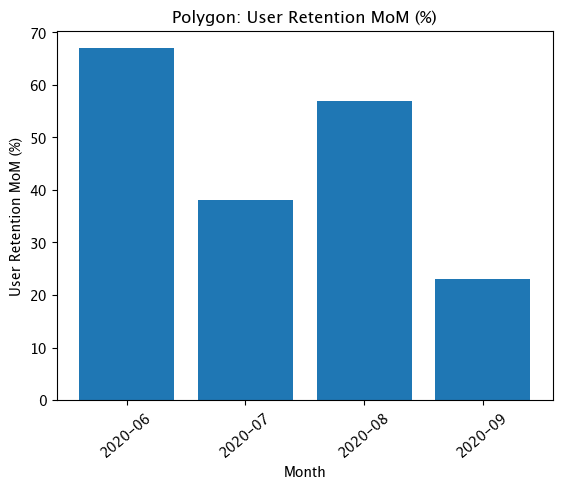

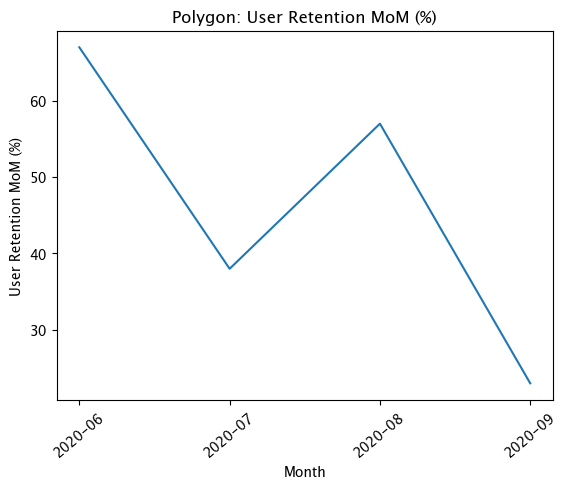

In [54]:
plot_userretention(userretention_poly,'Polygon')

## Arbitrum

In [33]:
all_arb

,block_number,timestamp,transaction_hash,gas_limit,gas_used,gas_price,transaction_fee,nonce,position,type,from_address,to_address,value,contract_address,input,output,internal_transaction_count,log_count,__confirmed
0,221024,2021-08-20,0x81dee00757a6c6495ea3f968bbddf18160f6385f156a...,7000000,1715949,445131603,763823129036247,782,0,120,0xA82d4EdB72dD3D167D00058F2404658F4E9A010A,0x3c6AbdA21358c15601A3175D8dd66D0c572cc904,0,NaN,NaN,NaN,0,3,True
1,221025,2021-08-20,0x375ca9add7928017366d214378bbc3e411ca6ee00d78...,7000000,1698002,445131603,755834352157206,783,0,120,0xA82d4EdB72dD3D167D00058F2404658F4E9A010A,0x9b8DdcF800a7BfCdEbaD6D65514dE59160a2C9CC,0,NaN,NaN,NaN,0,3,True
2,221028,2021-08-20,0x3beefa18d5e74e87bc2f1f785419d636cbb1940291c1...,7000000,1739435,445131603,774277489864305,793,0,120,0x5616CAABa92cdf656E7d1bA36Fe1bd878E51c174,0x3607e46698d218B3a5Cae44bF381475C0a5e2ca7,0,NaN,NaN,NaN,0,3,True
3,221026,2021-08-20,0xd263b248b64f8830879dc3e94d96f05b823d4095902c...,1200000,712171,445131603,317009818840113,2566,0,120,0xdA26bd4f89Dff5dFa0A84f0f0ccFc3c73BD0B7D7,0x57469550b9A42d2fd964E67A9DD1DE3d9169b291,0,NaN,NaN,NaN,0,1,True
4,221027,2021-08-20,0xe37c19ae6f7ab340420cd19993fd433ac016953b0c03...,7000000,1733898,445131603,771812796178494,784,0,120,0xA82d4EdB72dD3D167D00058F2404658F4E9A010A,0x3c6AbdA21358c15601A3175D8dd66D0c572cc904,0,NaN,NaN,NaN,0,3,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3722779,3688407,2021-12-08,0x5ef1344a4a22b89e12748c8b670b609f97ffbb1828d9...,3366584,3033134,810074187,2457063559112058,108,0,120,0x4A6c660B1EA3F599C785715CBA79d0aDfCC75521,0x74e87FBA6C4bCd17fe5f14D73f590eD3C13E821B,0,NaN,NaN,NaN,0,1,True
3722780,3688402,2021-12-08,0x89b489e8610b22f0c9fae8840be1b0e5624fe7bea783...,1540886,1376001,810074187,1114662891386187,5,0,120,0x62851211A16fe53D2a609eC6303168bF386055A8,0x2E3b85F85628301a0Bce300Dee3A6B04195A15Ee,0,NaN,NaN,NaN,0,1,True
3722781,3688406,2021-12-08,0x27ff6c56b9d1f428cf9f74e9cbb9adc441bdcb27ef0f...,2070112,1344834,810074187,1089415309199958,319,0,120,0xBAe1169E1DfEaD21EbAadd4576680274f018C368,0x1b02dA8Cb0d097eB8D57A175b88c7D8b47997506,0,NaN,NaN,NaN,0,9,True
3722782,3688416,2021-12-08,0x194c16b21c47cb7b1c7bdbf596121bf554f7f3f3cdea...,4736680,1502285,810074187,1216962300017295,617,0,120,0xF98F2cf2668e8553bB6C619593D30543b499dDDa,0x11C7f9E47E7601A2BAeC9798e768C4a908d7CAfa,0,NaN,NaN,NaN,0,11,True


In [61]:
all_arb['timestamp'] = all_arb['timestamp'].map(string_to_datetime)

In [62]:
all_arb['timestamp'].iloc[0]

Timestamp('2021-08-20 00:00:00')

In [63]:
userretention_arb = userretention_mom(all_arb,app='Transpose')

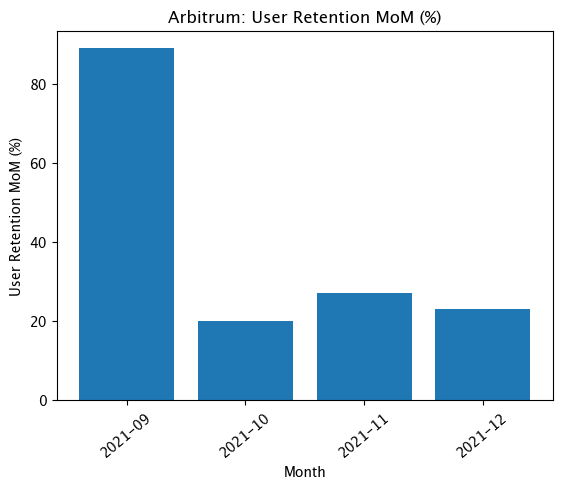

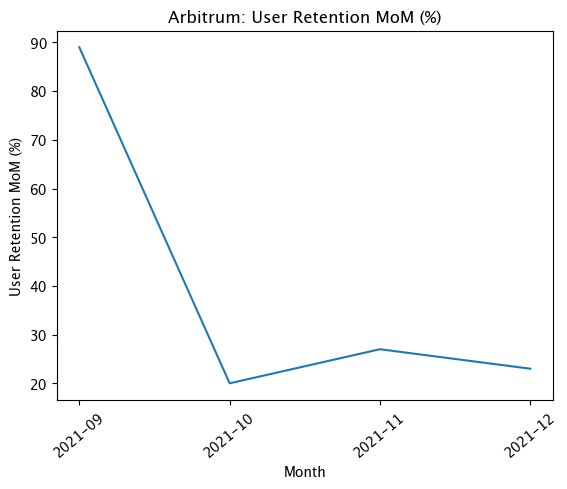

In [64]:
plot_userretention(userretention_arb,title='Arbitrum')

## zkSync

In [65]:
userretention_zksync = userretention_mom(all_zksync)

In [67]:
userretention_zksync

,Month,User Retention (%)
0,2023-04,10.0
1,2023-05,1.0
2,2023-06,2.0
3,2023-07,0.0


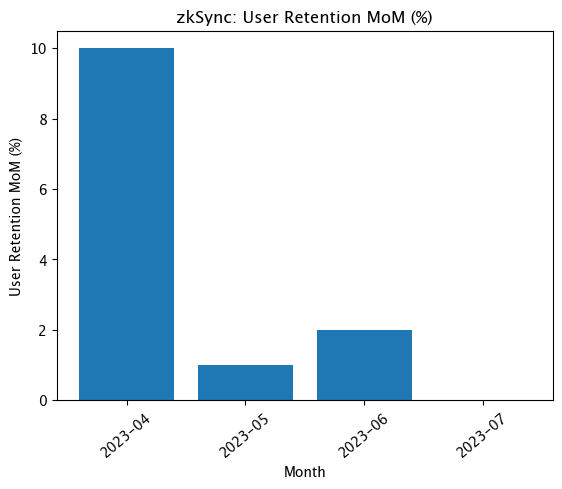

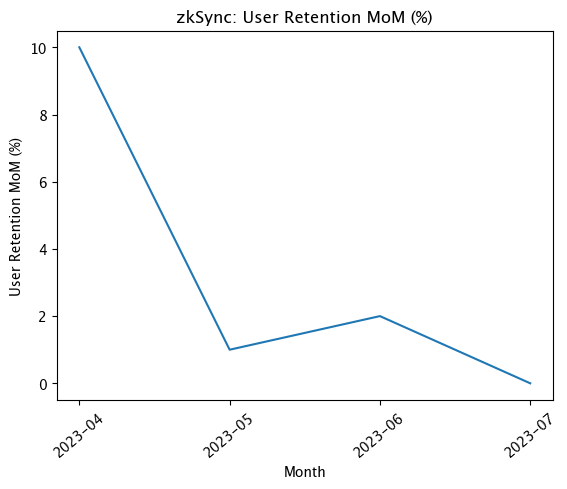

In [66]:
plot_userretention(userretention_zksync,title='zkSync')

In [76]:
all_zksync[all_zksync['block_time'].dt.month == 7]['from'].tolist() in all_zksync[all_zksync['block_time'].dt.month == 6]['from'].tolist()

False

In [84]:
all_zksync[all_zksync['block_time'].dt.month == 7]['from']

580709    0xd7e6629e7480581b386e28fdd3534c750c5506b5
580710    0xab1bc89c3b09c796d40326963ecc4c58ffa47215
580711    0xb66993c2023e2e76cd92d0dae865776fc9a023df
580712    0x685b68fea7ec4f617a271d484bc8847b5c68bde7
580713    0x4a2b3e8870190b95f0f37a1faff02d87c4c7298e
                             ...                    
590955    0x84a8fcb2bdb4b8501c9ab82a4731854f5641c9a3
590956    0x0c26110a7ea35928075085a20e2caa76ad223ade
590957    0x2e624f03ac2fa501017a05d553d8b9f8f88a825e
590958    0x801e849df107ff09acc086911e52ab3586b3b624
590959    0xeda4f174c8c7b56fe50fbdfd1c7bbadcd2bff944
Name: from, Length: 10251, dtype: object

In [85]:
all_zksync[all_zksync['block_time'].dt.month == 6]['from']

488977    0x11b60900c25639c70ed3aeec6325ad4029b496cc
488978    0x5b18532f283483d6ed6020cc07e9b8931f028c80
488979    0xdeb549d053c44e0dc8e7cdfc179200dd5c716aea
488980    0xfd40cf7f332532139f9f8c16d6df9d501ebfc8d7
488981    0x8ac9f75fe151958a6940a5c9fcf1684e442b0b25
                             ...                    
580704    0xc6dc62ff97f17fb66a9755f439aa62b53ddcddf3
580705    0x976c136d4027144d83856086b351a44d5f0c880d
580706    0x01204a5de0bb9d8dd8c6ff3fe8b8d17032e20e2b
580707    0x9e27732f31bfc774ac71d95f9572d6e33562a729
580708    0x987e919099076da4989f1e2e2b8eb3e54dbf7ac5
Name: from, Length: 91732, dtype: object

## Optimism

In [79]:
userretention_op = userretention_mom(all_op)

In [80]:
userretention_op

,Month,User Retention (%)
0,2022-01,32.0
1,2022-02,35.0
2,2022-03,39.0
3,2022-04,14.0


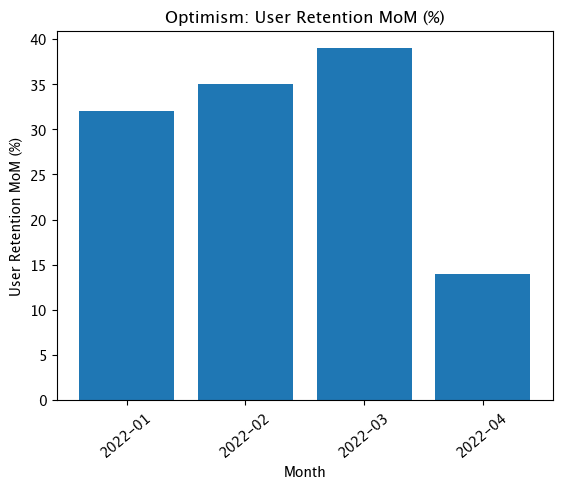

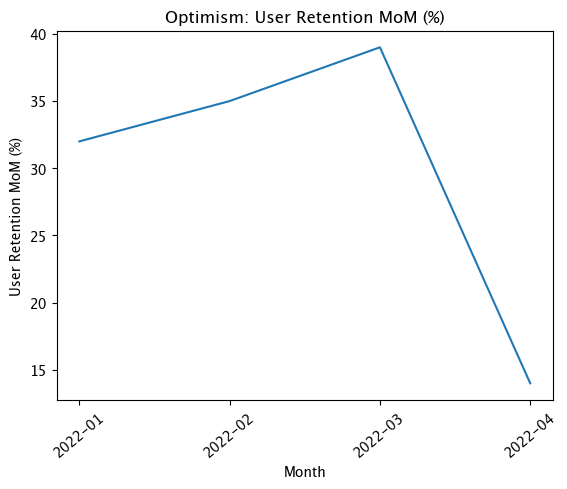

In [83]:
plot_userretention(userretention_op,title='Optimism')

# Uniswap

## Optimism

In [29]:
#contracts
path = 'Chains Data/optimism/uniswap'
uniswap_op = pd.read_csv(path+'uniswap_op.csv')
uniswap_op['block_time'] = uniswap_op['block_time'].map(lambda x: datetime.datetime.strptime(x, '%Y-%m-%d'))
'''filenames = glob.glob(path + "/*.csv")

dfs = []
for filename in filenames:
    dfs.append(pd.read_csv(filename))

# Concatenate all data into one DataFrame
uniswap_op = pd.concat(dfs, ignore_index=True)

uniswap_op['block_time'] = uniswap_op['block_time'].map(lambda x: datetime.datetime.strptime(x.split()[0], '%Y-%m-%d'))

#sort by date and time
uniswap_op = uniswap_op.sort_values(by=['block_time'])

#remove duplicate transactions
uniswap_op = uniswap_op.drop_duplicates(subset=['tx_hash'], keep='first')

#uniswap_op.to_csv(path+'uniswap_op.csv',index=False)'''

'filenames = glob.glob(path + "/*.csv")\n\ndfs = []\nfor filename in filenames:\n    dfs.append(pd.read_csv(filename))\n\n# Concatenate all data into one DataFrame\nuniswap_op = pd.concat(dfs, ignore_index=True)\n\nuniswap_op[\'block_time\'] = uniswap_op[\'block_time\'].map(lambda x: datetime.datetime.strptime(x.split()[0], \'%Y-%m-%d\'))\n\n#sort by date and time\nuniswap_op = uniswap_op.sort_values(by=[\'block_time\'])\n\n#remove duplicate transactions\nuniswap_op = uniswap_op.drop_duplicates(subset=[\'tx_hash\'], keep=\'first\')\n\n#uniswap_op.to_csv(path+\'uniswap_op.csv\',index=False)'

In [30]:
uniswap_op

,block_time,namespace,contract_name,contract_address,tx_hash,event_name,from,to
0,2021-12-15,uniswap_v3,Pair,0xadb35413ec50e0afe41039eac8b930d313e94fa4,0x0dbd3d1fdc937101752757d9254fff50cced28769127...,Swap,0xb35e71b6a5aebb07dfc3aa705968411ebdbc003f,0x11111112542d85b3ef69ae05771c2dccff4faa26
1,2021-12-15,uniswap_v3,Pair,0xf3f3433c3a97f70349c138ada81da4d3554982db,0xc3652f616490a4c36b0492905ce65f162b67c590e288...,Swap,0xbdc357a38867b05a3355c1345aba9bd3eb5cb935,0xe592427a0aece92de3edee1f18e0157c05861564
2,2021-12-15,uniswap_v3,Pair,0xc858a329bf053be78d6239c4a4343b8fbd21472b,0xbc367577957c29beb74914e6ad9b50eee25f65a3c2ed...,Swap,0x00dee1f836998bcc736022f314df906588d44808,0xe592427a0aece92de3edee1f18e0157c05861564
3,2021-12-15,uniswap_v3,Pair,0x85149247691df622eaf1a8bd0cafd40bc45154a9,0x8dd4025ec70c44d911eff1b9349f66900a349f929a3f...,Swap,0x1f123ca0d5af9372450bec7809d7c5ac48a981f4,0xe592427a0aece92de3edee1f18e0157c05861564
4,2021-12-15,uniswap_v3,Pair,0xc858a329bf053be78d6239c4a4343b8fbd21472b,0xae5aebd2d3ec2cf117a35ac7cc43150b1629c172109f...,Swap,0x99d9cc5240b11c986037f5d010a405ac65e140c9,0xe592427a0aece92de3edee1f18e0157c05861564
...,...,...,...,...,...,...,...,...
14104381,2022-12-31,uniswap_v3,Pair,0xbf16ef186e715668aa29cef57e2fd7f9d48adfe6,0x051a27a032b6e8775491dbe84164efbe60406e8a522d...,Swap,0x709d00ba248df4cc4b528fe4262f93b2fba50eeb,0x68b3465833fb72a70ecdf485e0e4c7bd8665fc45
14104382,2022-12-31,uniswap_v3,Pair,0x36b18618c4131d8564a714fb6b4d2b1edadc0042,0x03183f45700ce28f6af7fd6afd09dcceceeb42db6621...,Swap,0x145ef50ba3c5b50204b8cb63faecb585f1701a9e,0x82ac2ce43e33683c58be4cdc40975e73aa50f459
14104383,2022-12-31,uniswap_v3,Pair,0x7a5d3da4658e9315e7d385b8a25d92cece6e6fab,0x6e77770a91b4887ad08561044011cee8f0aa3a78716c...,Burn,0x8e8ec794a0166448a110269630fffec54bab848a,0x82ac2ce43e33683c58be4cdc40975e73aa50f459
14104384,2022-12-31,uniswap_v3,Pair,0xe4a1645dde99c20d126c24b8dd1d1a4bc4a88e4c,0x271a67e86f43af39addbb1ab382b0a15e47e604b236d...,Collect,0x8e8ec794a0166448a110269630fffec54bab848a,0x82ac2ce43e33683c58be4cdc40975e73aa50f459


In [23]:
uniswap_op['block_time'] = pd.to_datetime(uniswap_op['block_time'])

In [24]:
uniswap_op

,block_time,namespace,contract_name,contract_address,tx_hash,event_name,from,to
0,2021-12-15,uniswap_v3,Pair,0xadb35413ec50e0afe41039eac8b930d313e94fa4,0x0dbd3d1fdc937101752757d9254fff50cced28769127...,Swap,0xb35e71b6a5aebb07dfc3aa705968411ebdbc003f,0x11111112542d85b3ef69ae05771c2dccff4faa26
1,2021-12-15,uniswap_v3,Pair,0xf3f3433c3a97f70349c138ada81da4d3554982db,0xc3652f616490a4c36b0492905ce65f162b67c590e288...,Swap,0xbdc357a38867b05a3355c1345aba9bd3eb5cb935,0xe592427a0aece92de3edee1f18e0157c05861564
2,2021-12-15,uniswap_v3,Pair,0xc858a329bf053be78d6239c4a4343b8fbd21472b,0xbc367577957c29beb74914e6ad9b50eee25f65a3c2ed...,Swap,0x00dee1f836998bcc736022f314df906588d44808,0xe592427a0aece92de3edee1f18e0157c05861564
3,2021-12-15,uniswap_v3,Pair,0x85149247691df622eaf1a8bd0cafd40bc45154a9,0x8dd4025ec70c44d911eff1b9349f66900a349f929a3f...,Swap,0x1f123ca0d5af9372450bec7809d7c5ac48a981f4,0xe592427a0aece92de3edee1f18e0157c05861564
4,2021-12-15,uniswap_v3,Pair,0xc858a329bf053be78d6239c4a4343b8fbd21472b,0xae5aebd2d3ec2cf117a35ac7cc43150b1629c172109f...,Swap,0x99d9cc5240b11c986037f5d010a405ac65e140c9,0xe592427a0aece92de3edee1f18e0157c05861564
...,...,...,...,...,...,...,...,...
14104381,2022-12-31,uniswap_v3,Pair,0xbf16ef186e715668aa29cef57e2fd7f9d48adfe6,0x051a27a032b6e8775491dbe84164efbe60406e8a522d...,Swap,0x709d00ba248df4cc4b528fe4262f93b2fba50eeb,0x68b3465833fb72a70ecdf485e0e4c7bd8665fc45
14104382,2022-12-31,uniswap_v3,Pair,0x36b18618c4131d8564a714fb6b4d2b1edadc0042,0x03183f45700ce28f6af7fd6afd09dcceceeb42db6621...,Swap,0x145ef50ba3c5b50204b8cb63faecb585f1701a9e,0x82ac2ce43e33683c58be4cdc40975e73aa50f459
14104383,2022-12-31,uniswap_v3,Pair,0x7a5d3da4658e9315e7d385b8a25d92cece6e6fab,0x6e77770a91b4887ad08561044011cee8f0aa3a78716c...,Burn,0x8e8ec794a0166448a110269630fffec54bab848a,0x82ac2ce43e33683c58be4cdc40975e73aa50f459
14104384,2022-12-31,uniswap_v3,Pair,0xe4a1645dde99c20d126c24b8dd1d1a4bc4a88e4c,0x271a67e86f43af39addbb1ab382b0a15e47e604b236d...,Collect,0x8e8ec794a0166448a110269630fffec54bab848a,0x82ac2ce43e33683c58be4cdc40975e73aa50f459


In [25]:
uniswap_op.iloc[0]['block_time']

Timestamp('2021-12-15 00:00:00')

### Activity

In [57]:
def protocol_txs(protocol_df):
    temp_txs = protocol_df.groupby(protocol_df['block_time']).agg({'count'})
    temp_txs = temp_txs.reset_index()
    return temp_txs
    
def plot_protocoltxs(txs_df,title,launch_date):
    plt.figure()
    plt.plot(txs_df['block_time'],txs_df[('namespace','count')])
    plt.axvline(launch_date,c='red')
    plt.title(f'{title} Txs/d')
    plt.xticks(rotation=40)

In [27]:
uniswap_op_txs = uniswap_op.groupby(uniswap_op['block_time']).agg({'count'})
uniswap_op_txs = uniswap_op_txs.reset_index()

In [28]:
uniswap_op_txs

,block_time,namespace,contract_name,contract_address,tx_hash,event_name,from,to
,,count,count,count,count,count,count,count
0,2021-12-15,4480,4480,4480,4480,4480,4480,4480
1,2021-12-16,3720,3720,3720,3720,3720,3720,3720
2,2021-12-17,3591,3591,3591,3591,3591,3591,3591
3,2021-12-18,3111,3111,3111,3111,3111,3111,3111
4,2021-12-19,5254,5254,5254,5254,5254,5254,5254
...,...,...,...,...,...,...,...,...
377,2022-12-27,59174,59174,59174,59174,59174,59174,59174
378,2022-12-28,75119,75119,75119,75119,75119,75119,75119
379,2022-12-29,71197,71197,71197,71197,71197,71197,71197


(array([18993., 19052., 19113., 19174., 19236., 19297., 19358.]),
 [Text(18993.0, 0, '2022-01'),
  Text(19052.0, 0, '2022-03'),
  Text(19113.0, 0, '2022-05'),
  Text(19174.0, 0, '2022-07'),
  Text(19236.0, 0, '2022-09'),
  Text(19297.0, 0, '2022-11'),
  Text(19358.0, 0, '2023-01')])

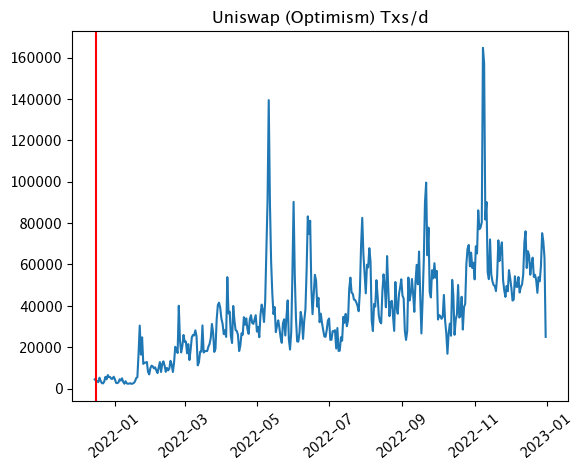

In [29]:
plt.figure()
plt.plot(uniswap_op_txs['block_time'],uniswap_op_txs[('namespace','count')])
plt.axvline(datetime.datetime(2021, 12, 16),c='red')
plt.title('Uniswap (Optimism) Txs/d')
plt.xticks(rotation=40)

### Most Used Contracts

In [30]:
type(list(uniswap_op['block_time'].unique())[0])

pandas._libs.tslibs.timestamps.Timestamp

In [31]:
'''dates = list(uniswap_op['block_time'].unique())
dates = [ts.to_pydatetime() for ts in dates]'''

"dates = list(uniswap_op['block_time'].unique())\ndates = [ts.to_pydatetime() for ts in dates]"

Text(0, 0.5, 'Contracts (by proportion)')

<Figure size 640x480 with 0 Axes>

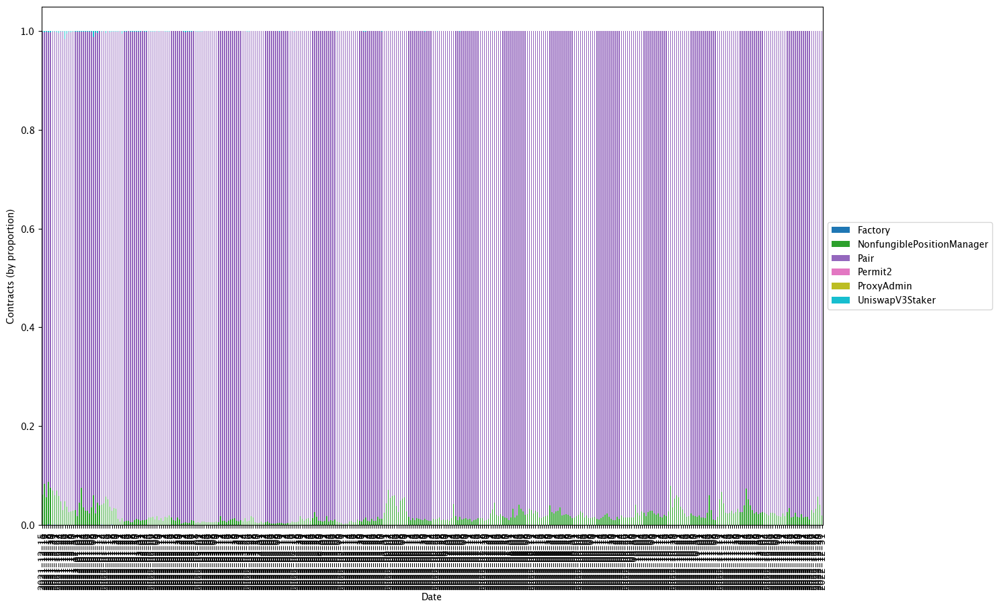

In [14]:
plt.figure()
cross_tab_prop = pd.crosstab(index=uniswap_op['block_time'],
                             columns=uniswap_op['contract_name'],
                             normalize="index")

cross_tab_prop.plot(kind='bar', 
                    stacked=True, 
                    colormap='tab10',
                    #legend=None,
                    figsize=(15, 10))

plt.legend(loc="center left", ncol=1,bbox_to_anchor=(1, 0.5))
plt.xlabel("Date")
plt.ylabel("Contracts (by proportion)")

In [15]:
def separate_contracts_df(protocol_df):
    
    cols = np.append(['Date'],protocol_df['contract_name'].unique())
    dates = protocol_df['block_time'].unique()
    contract_cts = {k: [] for k in cols[1:]}
    
    for dt in dates:
        temp_df = protocol_df[protocol_df['block_time']==dt]
        cts = temp_df['contract_name'].value_counts()
        for col in cols[1:]:
            if col in cts.keys():
                contract_cts[col].append(cts[col])
            else:
                contract_cts[col].append(0)
            
    df_copy = pd.DataFrame(contract_cts)
    df_copy['Date'] = dates
            
    return df_copy
    
    
#def separate_events_df(protocol_df):
    
    

In [16]:
sep_contract_op = separate_contracts_df(uniswap_op)

In [17]:
sep_contract_op

,Pair,NonfungiblePositionManager,UniswapV3Staker,Factory,ProxyAdmin,Permit2,Date
0,4201,276,3,0,0,0,2021-12-15
1,3403,309,8,0,0,0,2021-12-16
2,3389,197,5,0,0,0,2021-12-17
3,2836,266,6,3,0,0,2021-12-18
4,4848,393,13,0,0,0,2021-12-19
...,...,...,...,...,...,...,...
377,57762,1412,0,0,0,0,2022-12-27
378,72660,2458,0,1,0,0,2022-12-28
379,67099,4098,0,0,0,0,2022-12-29
380,60651,2586,0,0,0,0,2022-12-30


([<matplotlib.axis.XTick at 0x348785d50>,
 [Text(18976.0, 0, ''),
  Text(18977.0, 0, ''),
  Text(18978.0, 0, ''),
  Text(18979.0, 0, ''),
  Text(18980.0, 0, ''),
  Text(18981.0, 0, ''),
  Text(18982.0, 0, ''),
  Text(18983.0, 0, ''),
  Text(18984.0, 0, ''),
  Text(18985.0, 0, ''),
  Text(18986.0, 0, ''),
  Text(18987.0, 0, ''),
  Text(18988.0, 0, ''),
  Text(18989.0, 0, ''),
  Text(18990.0, 0, ''),
  Text(18991.0, 0, ''),
  Text(18992.0, 0, ''),
  Text(18993.0, 0, ''),
  Text(18994.0, 0, ''),
  Text(18995.0, 0, ''),
  Text(18996.0, 0, ''),
  Text(18997.0, 0, ''),
  Text(18998.0, 0, ''),
  Text(18999.0, 0, ''),
  Text(19000.0, 0, ''),
  Text(19001.0, 0, ''),
  Text(19002.0, 0, ''),
  Text(19003.0, 0, ''),
  Text(19004.0, 0, ''),
  Text(19005.0, 0, ''),
  Text(19006.0, 0, ''),
  Text(19007.0, 0, ''),
  Text(19008.0, 0, ''),
  Text(19009.0, 0, ''),
  Text(19010.0, 0, ''),
  Text(19011.0, 0, ''),
  Text(19012.0, 0, ''),
  Text(19013.0, 0, ''),
  Text(19014.0, 0, ''),
  Text(19015.0, 0, '')

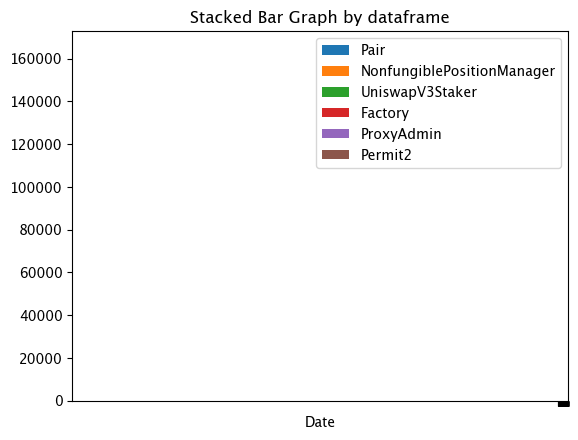

In [18]:
sep_contract_op.plot(x='Date', kind='bar', stacked=True,
        title='Stacked Bar Graph by dataframe')

plt.xticks(sep_contract_op['Date'],rotation=40)

In [58]:
def plot_contractsdistribution(protocol_df, protocol_name, chain_name):
    print(protocol_df['contract_name'].value_counts())
    print(protocol_df['event_name'].value_counts())
    
    #Contract name
    plt.figure(figsize=(50,30))
    cross_tab_prop = pd.crosstab(index=protocol_df['block_time'],
                                 columns=protocol_df['contract_name'],
                                 normalize="index")

    cross_tab_prop.plot(kind='bar', 
                        stacked=True, 
                        colormap='tab10',
                        #legend=None,
                        figsize=(15, 10))

    plt.legend(loc="center left", ncol=1,bbox_to_anchor=(1, 0.5))
    plt.xlabel("Date")
    year_month = protocol_df['block_time'].dt.to_period('M').unique().map(lambda x: datetime.datetime.strptime(str(x),'%Y-%m'))
    year_month = [ts.to_pydatetime().strftime('%Y-%m') for ts in year_month]
    dates = list(protocol_df['block_time'].unique())
    plt.xticks(np.linspace(0,len(dates),len(year_month)), year_month,rotation=40)
    plt.ylabel("Contracts (by proportion)")
    plt.title(f"{protocol_name} ({chain_name}): Distribution of Contracts Over Time")
    
    #Event name
    plt.figure(figsize=(50,30))
    cross_tab_prop = pd.crosstab(index=protocol_df['block_time'],
                                 columns=protocol_df['event_name'],
                                 normalize="index")

    cross_tab_prop.plot(kind='bar', 
                        stacked=True, 
                        colormap='tab10',
                        #legend=None,
                        figsize=(15, 10))

    plt.legend(loc="center left", ncol=1,bbox_to_anchor=(1, 0.5))
    plt.xlabel("Date")
    plt.xticks(np.linspace(0,len(dates),len(year_month)), year_month,rotation=40)
    plt.ylabel("Contracts (by proportion)")
    plt.ylabel("Events (by proportion)")
    plt.title(f"{protocol_name} ({chain_name}): Distribution of Events Over Time")

In [33]:
    year_month = uniswap_op['block_time'].dt.to_period('M').unique().map(lambda x: datetime.datetime.strptime(str(x),'%Y-%m'))
    year_month = [ts.to_pydatetime() for ts in year_month]

In [35]:
len(year_month)

13

In [42]:
len(uniswap_op)

14104386

contract_name
Pair                          13834451
NonfungiblePositionManager      269018
UniswapV3Staker                    769
Factory                            137
Permit2                             10
ProxyAdmin                           1
Name: count, dtype: int64
event_name
Swap                                  13264925
Mint                                    274324
Collect                                 194366
Burn                                    148063
IncreaseLiquidity                        90279
Transfer                                 78219
DecreaseLiquidity                        29111
Approval                                 14280
ApprovalForAll                            7317
Flash                                     2312
RewardClaimed                              226
TokenUnstaked                              201
TokenStaked                                173
DepositTransferred                         154
IncreaseObservationCardinalityNext         148
PoolCreate

<Figure size 5000x3000 with 0 Axes>

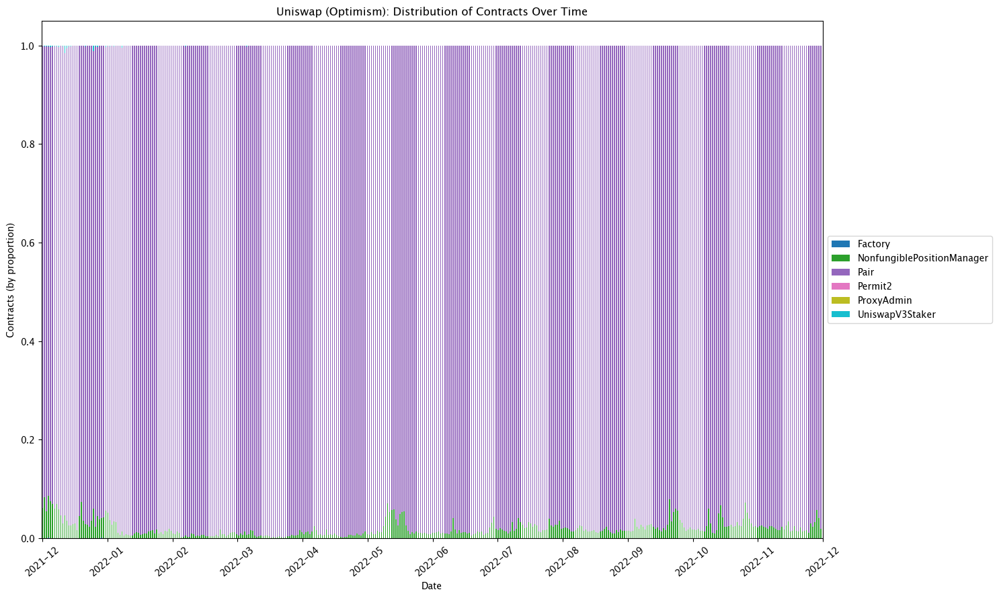

<Figure size 5000x3000 with 0 Axes>

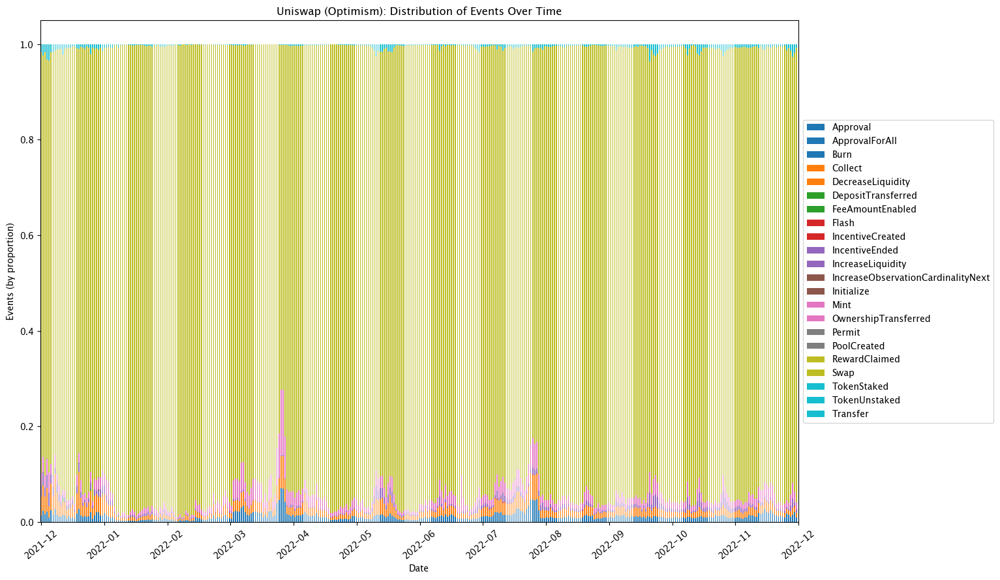

In [44]:
plot_contractsdistribution(uniswap_op,'Uniswap','Optimism')

### Uniswap Optimism unique addresses per day

In [35]:
uniswap_op[uniswap_op['block_time']==dates[0]]

,block_time,namespace,contract_name,contract_address,tx_hash,event_name,from,to
0,2021-12-15,uniswap_v3,Pair,0xadb35413ec50e0afe41039eac8b930d313e94fa4,0x0dbd3d1fdc937101752757d9254fff50cced28769127...,Swap,0xb35e71b6a5aebb07dfc3aa705968411ebdbc003f,0x11111112542d85b3ef69ae05771c2dccff4faa26
1,2021-12-15,uniswap_v3,Pair,0xf3f3433c3a97f70349c138ada81da4d3554982db,0xc3652f616490a4c36b0492905ce65f162b67c590e288...,Swap,0xbdc357a38867b05a3355c1345aba9bd3eb5cb935,0xe592427a0aece92de3edee1f18e0157c05861564
2,2021-12-15,uniswap_v3,Pair,0xc858a329bf053be78d6239c4a4343b8fbd21472b,0xbc367577957c29beb74914e6ad9b50eee25f65a3c2ed...,Swap,0x00dee1f836998bcc736022f314df906588d44808,0xe592427a0aece92de3edee1f18e0157c05861564
3,2021-12-15,uniswap_v3,Pair,0x85149247691df622eaf1a8bd0cafd40bc45154a9,0x8dd4025ec70c44d911eff1b9349f66900a349f929a3f...,Swap,0x1f123ca0d5af9372450bec7809d7c5ac48a981f4,0xe592427a0aece92de3edee1f18e0157c05861564
4,2021-12-15,uniswap_v3,Pair,0xc858a329bf053be78d6239c4a4343b8fbd21472b,0xae5aebd2d3ec2cf117a35ac7cc43150b1629c172109f...,Swap,0x99d9cc5240b11c986037f5d010a405ac65e140c9,0xe592427a0aece92de3edee1f18e0157c05861564
...,...,...,...,...,...,...,...,...
4475,2021-12-15,uniswap_v3,Pair,0x3202c46666e774b44ba463eafaa6da9a968a058f,0x5cd91ec850d3348e2a5fe87f40e9f5d4b6b904dcdca3...,Swap,0x6dd91bdab368282dc4ea4f4befc831b78a7c38c0,0xe592427a0aece92de3edee1f18e0157c05861564
4476,2021-12-15,uniswap_v3,Pair,0x3202c46666e774b44ba463eafaa6da9a968a058f,0x1ac08a3344d787f3a2f8af1d8a89c8de6f759b2d03f1...,Mint,0x6dd91bdab368282dc4ea4f4befc831b78a7c38c0,0xc36442b4a4522e871399cd717abdd847ab11fe88
4477,2021-12-15,uniswap_v3,Pair,0x03af20bdaaffb4cc0a521796a223f7d85e2aac31,0x35f82880c1a994007500c2aab539f17b1aec449c8ea8...,Swap,0x54c375c481f95ba43e2cecd6ef30631f55518f57,0xe592427a0aece92de3edee1f18e0157c05861564
4478,2021-12-15,uniswap_v3,Pair,0x19ea026886cbb7a900ecb2458636d72b5cae223b,0xe5cb7466f47d57ea8bf673683849a5a1bf79920598c4...,Swap,0x6dd91bdab368282dc4ea4f4befc831b78a7c38c0,0xe592427a0aece92de3edee1f18e0157c05861564


In [59]:
def protocol_uniqueaddresses(df):
    
    dates = list(df['block_time'].unique())
    nuniqueaddresses = pd.DataFrame(columns=['Date','Nuniqueaddresses'])
    nuniqueaddresses['Date'] = dates
    temp_nunique = []
    for date in dates:
        temp_nunique.append(df[df['block_time']==date]['from'].nunique())
    nuniqueaddresses['Nuniqueaddresses'] = temp_nunique
    return nuniqueaddresses

In [60]:
def plot_uniqueaddresses(unique_df,title_name):
    plt.figure()
    plt.plot(unique_df['Date'],unique_df['Nuniqueaddresses'])
    plt.xlabel('Date')
    plt.xticks(rotation=40)
    plt.ylabel('Number of Unique Addresses')
    plt.title(f"{title_name}: Number of Unique Addresses Per Day")

In [37]:
uniswap_op_uniqueaddresses = protocol_uniqueaddresses(uniswap_op)
uniswap_op_uniqueaddresses

,Date,Nuniqueaddresses
0,2021-12-15,1364
1,2021-12-16,1245
2,2021-12-17,990
3,2021-12-18,1007
4,2021-12-19,1678
...,...,...
377,2022-12-27,15300
378,2022-12-28,18301
379,2022-12-29,19605
380,2022-12-30,15769


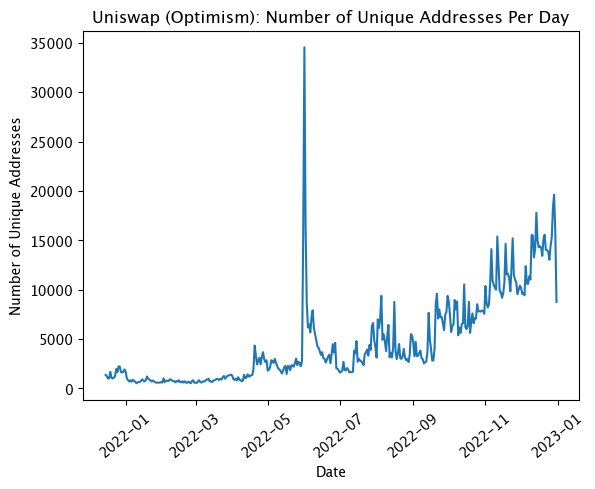

In [41]:
plot_uniqueaddresses(uniswap_op_uniqueaddresses,"Uniswap (Optimism)")

### User Retention

In [51]:
year_month = uniswap_op['block_time'].dt.to_period('M').unique().map(lambda x: datetime.datetime.strptime(str(x),'%Y-%m'))
year_month = [ts.to_pydatetime() for ts in year_month]

In [57]:
y = year_month[0].year
m = year_month[0].month

In [54]:
uniswap_op['block_time'].dt.year

0           2021
1           2021
2           2021
3           2021
4           2021
            ... 
14104381    2022
14104382    2022
14104383    2022
14104384    2022
14104385    2022
Name: block_time, Length: 14104386, dtype: int32

In [59]:
df_copy = uniswap_op.copy()

In [61]:
df_copy['Year'] = df_copy['block_time'].dt.year
df_copy['Month'] = df_copy['block_time'].dt.month
df_copy[(df_copy['Year']==y) & (df_copy['Month']==m)]

,block_time,namespace,contract_name,contract_address,tx_hash,event_name,from,to,Year,Month
0,2021-12-15,uniswap_v3,Pair,0xadb35413ec50e0afe41039eac8b930d313e94fa4,0x0dbd3d1fdc937101752757d9254fff50cced28769127...,Swap,0xb35e71b6a5aebb07dfc3aa705968411ebdbc003f,0x11111112542d85b3ef69ae05771c2dccff4faa26,2021,12
1,2021-12-15,uniswap_v3,Pair,0xf3f3433c3a97f70349c138ada81da4d3554982db,0xc3652f616490a4c36b0492905ce65f162b67c590e288...,Swap,0xbdc357a38867b05a3355c1345aba9bd3eb5cb935,0xe592427a0aece92de3edee1f18e0157c05861564,2021,12
2,2021-12-15,uniswap_v3,Pair,0xc858a329bf053be78d6239c4a4343b8fbd21472b,0xbc367577957c29beb74914e6ad9b50eee25f65a3c2ed...,Swap,0x00dee1f836998bcc736022f314df906588d44808,0xe592427a0aece92de3edee1f18e0157c05861564,2021,12
3,2021-12-15,uniswap_v3,Pair,0x85149247691df622eaf1a8bd0cafd40bc45154a9,0x8dd4025ec70c44d911eff1b9349f66900a349f929a3f...,Swap,0x1f123ca0d5af9372450bec7809d7c5ac48a981f4,0xe592427a0aece92de3edee1f18e0157c05861564,2021,12
4,2021-12-15,uniswap_v3,Pair,0xc858a329bf053be78d6239c4a4343b8fbd21472b,0xae5aebd2d3ec2cf117a35ac7cc43150b1629c172109f...,Swap,0x99d9cc5240b11c986037f5d010a405ac65e140c9,0xe592427a0aece92de3edee1f18e0157c05861564,2021,12
...,...,...,...,...,...,...,...,...,...,...
75222,2021-12-31,uniswap_v3,Pair,0x36b18618c4131d8564a714fb6b4d2b1edadc0042,0xb7a15f66e5136dac0daa4a9cbfaed247918d4e14b338...,Swap,0x9c1e0c67aa30c063f341885b12cb81cc94613fc7,0x82ac2ce43e33683c58be4cdc40975e73aa50f459,2021,12
75223,2021-12-31,uniswap_v3,NonfungiblePositionManager,0xc36442b4a4522e871399cd717abdd847ab11fe88,0xc1b4d8c68abdeb3bed776e6368b2318775d2a029641d...,IncreaseLiquidity,0x3f0ba97c5898e2df7888f6d0cd5a0620ebf49d07,0xc36442b4a4522e871399cd717abdd847ab11fe88,2021,12
75224,2021-12-31,uniswap_v3,Pair,0xc64f9436f8ca50cdcc096105c62dad52faeb1f2e,0xc51974fca598a8b1fa845c9ae02e75a2b08eac36ef24...,Swap,0x4677249fb07317eca047ac88a68029962c3190a8,0x82ac2ce43e33683c58be4cdc40975e73aa50f459,2021,12
75225,2021-12-31,uniswap_v3,Pair,0xc64f9436f8ca50cdcc096105c62dad52faeb1f2e,0xee2cc01d500bdab0f733dc556399435abf107a2f406a...,Swap,0x6541e4d0f50a82544401b1e0721626415a37de99,0x82ac2ce43e33683c58be4cdc40975e73aa50f459,2021,12


In [65]:
type(df_copy[(df_copy['Year']==y) & (df_copy['Month']==m)]['from'].unique())

numpy.ndarray

In [176]:
    year_month = uniswap_arb['block_time'].dt.to_period('M').unique().map(lambda x: datetime.datetime.strptime(str(x),'%Y-%m'))
    year_month = [ts.to_pydatetime() for ts in year_month]

In [177]:
year_month

[datetime.datetime(2021, 8, 1, 0, 0),
 datetime.datetime(2021, 9, 1, 0, 0),
 datetime.datetime(2021, 10, 1, 0, 0),
 datetime.datetime(2021, 11, 1, 0, 0),
 datetime.datetime(2021, 12, 1, 0, 0),
 datetime.datetime(2022, 1, 1, 0, 0),
 datetime.datetime(2022, 2, 1, 0, 0),
 datetime.datetime(2022, 3, 1, 0, 0),
 datetime.datetime(2022, 4, 1, 0, 0),
 datetime.datetime(2022, 5, 1, 0, 0),
 datetime.datetime(2022, 6, 1, 0, 0),
 datetime.datetime(2022, 7, 1, 0, 0),
 datetime.datetime(2022, 8, 1, 0, 0),
 datetime.datetime(2022, 9, 1, 0, 0)]

In [50]:
def userretention_mom(protocol_df):
    '''
    Func: For an interval of every month, calculate the percentage of users that returned
    '''
    userretention_df = pd.DataFrame(columns=['Month','User Retention (%)'])
    year_month = protocol_df['block_time'].dt.to_period('M').unique().map(lambda x: datetime.datetime.strptime(str(x),'%Y-%m'))
    year_month = [ts.to_pydatetime() for ts in year_month]
    df_copy = protocol_df.copy()
    df_copy['Year'] = df_copy['block_time'].dt.year
    df_copy['Month'] = df_copy['block_time'].dt.month
    
    add = {} #addresses
    
    for ym in year_month:
        add[ym] = list(df_copy[(df_copy['Year']==ym.year) & (df_copy['Month']==ym.month)]['from'].unique())
        
    pct = {}
    dts = list(add.keys())
    vals = list(add.values())
        
    for i in range(1,len(add)):
        pct[dts[i].strftime('%Y-%m')] = round((len(set(vals[i-1]) & set(vals[i]))/len(vals[i-1]))*100,0)
        
    userretention_df['Month'] = list(pct.keys())
    userretention_df['User Retention (%)'] = list(pct.values())
    
    return userretention_df

def plot_userretention(ur_df,title,calendar_dts=True):
    
    plt.figure()
    if calendar_dts:
        plt.bar(ur_df['Month'],ur_df['User Retention (%)'])
        plt.xticks(rotation=40)
    else:
        ur_df_copy = ur_df.copy()
        ur_df_copy['Month'] = [str(i) for i in range(1,len(ur_df_copy)+1)]
        plt.bar(ur_df_copy['Month'],ur_df['User Retention (%)'])
    plt.xlabel('Month')
    plt.ylabel('User Retention MoM (%)')
    plt.title(f'{title}: User Retention MoM (%)')
    
    plt.figure()
    if calendar_dts:
        plt.plot(ur_df['Month'],ur_df['User Retention (%)'])
        plt.xticks(rotation=40)
    else:
        ur_df_copy = ur_df.copy()
        ur_df_copy['Month'] = [str(i) for i in range(1,len(ur_df_copy)+1)]
        plt.plot(ur_df_copy['Month'],ur_df_copy['User Retention (%)'])
    plt.xlabel('Month')
    plt.ylabel('User Retention MoM (%)')
    plt.title(f'{title}: User Retention MoM (%)')
    

In [51]:
userretention_pct = userretention_mom(uniswap_op)

In [52]:
userretention_pct

,Month,User Retention (%)
0,2022-01,18.0
1,2022-02,21.0
2,2022-03,27.0
3,2022-04,29.0
4,2022-05,35.0
5,2022-06,48.0
6,2022-07,24.0
7,2022-08,50.0
8,2022-09,43.0
9,2022-10,48.0


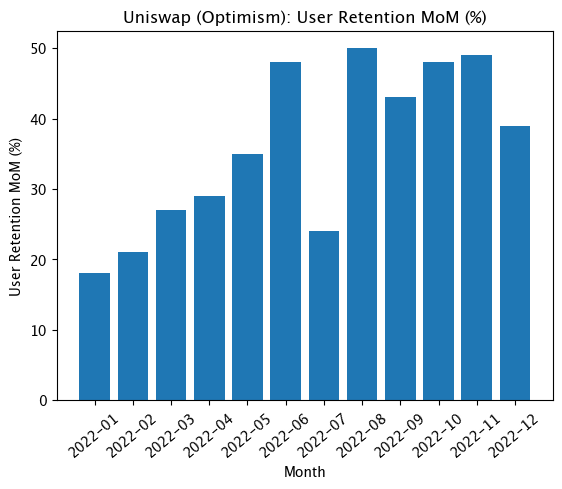

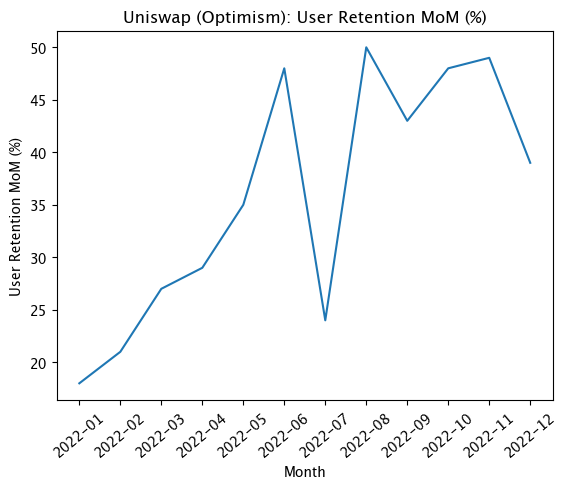

In [53]:
plot_userretention(userretention_pct,'Uniswap (Optimism)',calendar_dts=True)

In [159]:
def protocol_popularity_t10(protocol_df):
    vc = protocol_df['from'].value_counts(ascending=True)
    temp = {}
    for i in range(1,11):
        temp[i] = len(vc[vc==i])
    
    temp_df = pd.DataFrame({'N Time User':temp.keys(), 'Count':temp.values()})
    return temp_df

def protocol_popularity(protocol_df,topn):
    vc = protocol_df['from'].value_counts(ascending=True)
    temp = {}
    for i in range(1,topn+1):
        temp[i] = len(vc[vc==i])
    
    temp_df = pd.DataFrame({'N Time User':temp.keys(), 'Count':temp.values()})
    return temp_df

def plot_protocolpopularity(pop_df,title):
    plt.figure(figsize=(50,30))
    pop_df.plot.bar(x='N Time User',y='Count',rot=360,title=title+': Number of one-time, two-time,... users')
    plt.xlabel(f'N-time Users (1-{len(pop_df)})')
    plt.ylabel('Count')

In [156]:
protpopt10_op = protocol_popularity_t10(uniswap_op)

protpop_op = protocol_popularity(uniswap_op,100)


In [157]:
protpopt10_op

,N Time User,Count
0,1,94537
1,2,68823
2,3,32724
3,4,57488
4,5,39391
5,6,52551
6,7,31595
7,8,25914
8,9,14263
9,10,12782


In [158]:
protpop_op

,N Time User,Count
0,1,94537
1,2,68823
2,3,32724
3,4,57488
4,5,39391
...,...,...
95,96,47
96,97,48
97,98,46
98,99,39


<Figure size 5000x3000 with 0 Axes>

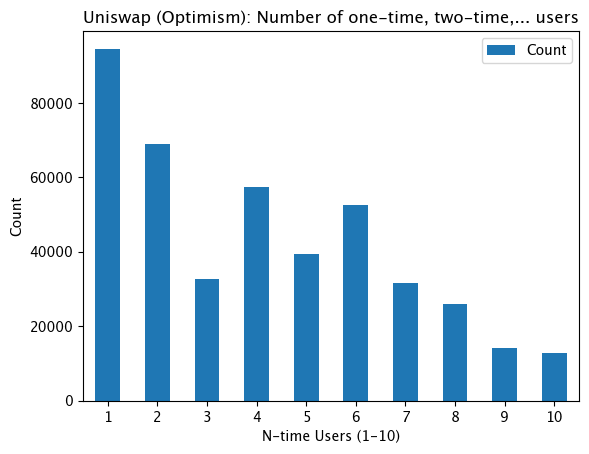

In [160]:
plot_protocolpopularity(protpopt10_op,'Uniswap (Optimism)')

<Figure size 5000x3000 with 0 Axes>

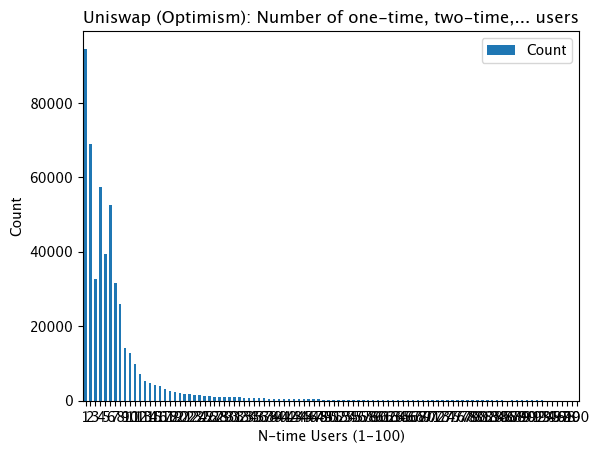

In [161]:
plot_protocolpopularity(protpop_op,'Uniswap (Optimism)')

## Arbitrum

In [54]:
#contracts
path = 'Chains Data/arbitrum txs/uniswap'
uniswap_arb = pd.read_csv(path+'uniswap_arb.csv')
uniswap_arb['block_time'] = uniswap_arb['block_time'].map(lambda x: datetime.datetime.strptime(x, '%Y-%m-%d'))
'''filenames = glob.glob(path + "/*.csv")

dfs = []
for filename in filenames:
    dfs.append(pd.read_csv(filename))

# Concatenate all data into one DataFrame
uniswap_arb = pd.concat(dfs, ignore_index=True)

uniswap_arb['block_time'] = uniswap_arb['block_time'].map(lambda x: datetime.datetime.strptime(x.split()[0], '%Y-%m-%d'))

#sort by date and time
uniswap_arb = uniswap_arb.sort_values(by=['block_time'])

#remove duplicate transactions
uniswap_arb = uniswap_arb.drop_duplicates(subset=['tx_hash'], keep='first')

#uniswap_arb.to_csv(path+'uniswap_op.csv',index=False)'''

'filenames = glob.glob(path + "/*.csv")\n\ndfs = []\nfor filename in filenames:\n    dfs.append(pd.read_csv(filename))\n\n# Concatenate all data into one DataFrame\nuniswap_arb = pd.concat(dfs, ignore_index=True)\n\nuniswap_arb[\'block_time\'] = uniswap_arb[\'block_time\'].map(lambda x: datetime.datetime.strptime(x.split()[0], \'%Y-%m-%d\'))\n\n#sort by date and time\nuniswap_arb = uniswap_arb.sort_values(by=[\'block_time\'])\n\n#remove duplicate transactions\nuniswap_arb = uniswap_arb.drop_duplicates(subset=[\'tx_hash\'], keep=\'first\')\n\n#uniswap_arb.to_csv(path+\'uniswap_op.csv\',index=False)'

In [55]:
uniswap_arb

,block_time,namespace,contract_name,contract_address,tx_hash,event_name,from,to
0,2021-08-30,uniswap_v3,Pair,0x17c14d2c404d167802b16c450d3c99f88f2c4f4d,0x1eec8f4f9dc7929669744d2cb02b3d0761ce72de5cc6...,Swap,0x6a19891e91a3d4d690cc8f9627290d25bfd34df6,0xe592427a0aece92de3edee1f18e0157c05861564
1,2021-08-31,uniswap_v3,NonfungiblePositionManager,0xc36442b4a4522e871399cd717abdd847ab11fe88,0xe89e6a3752c9f2a8cdbfac2885ff0a149856e10a093b...,Transfer,0x4a01562e3c37270359918530801af93570adfa9d,0xc36442b4a4522e871399cd717abdd847ab11fe88
2,2021-08-31,uniswap_v3,Pair,0xc24f7d8e51a64dc1238880bd00bb961d54cbeb29,0x4b32bae2c2719e708ef0a56f1cdf3b988a7426616d01...,Mint,0x21beb7f087252a4d027d8c099901e836610dc69d,0xc36442b4a4522e871399cd717abdd847ab11fe88
3,2021-08-31,uniswap_v3,Pair,0xc31e54c7a869b9fcbecc14363cf510d1c41fa443,0xec7bb8fb00200a26644d16ec8c48630f357c5df6de25...,Swap,0x862c6f0373ac129fc66a324b234943139ca10c92,0xe592427a0aece92de3edee1f18e0157c05861564
4,2021-08-31,uniswap_v3,Pair,0x17c14d2c404d167802b16c450d3c99f88f2c4f4d,0xe0678ac86e860722867df787143987f5417ec4090f80...,Swap,0x103fe2ff1b3c83ca4ad94d4981d8f93dbb41b558,0xe592427a0aece92de3edee1f18e0157c05861564
...,...,...,...,...,...,...,...,...
2728260,2022-09-06,uniswap_v3,Pair,0x02c79a7e3d8a9cb773cd5f69be00a64f48308508,0x3360dd93ef08b7bcd0676bf471fd44e3121692944653...,Swap,0x2e787b28179c9403a2ebc3b2ff09ff5c31c6a70a,0x68b3465833fb72a70ecdf485e0e4c7bd8665fc45
2728261,2022-09-06,uniswap_v3,Pair,0xc31e54c7a869b9fcbecc14363cf510d1c41fa443,0x2e5abd4370e585cbe80055c06cdffd8bc4faf3106964...,Swap,0x85db3df30fdd6b6d22bbcc424803874509920c13,0xf638eb3faec6e64632da4de108cff05c694f2d50
2728262,2022-09-06,uniswap_v3,NonfungiblePositionManager,0xc36442b4a4522e871399cd717abdd847ab11fe88,0x62ffaac3d5aee3f998e6cc678bd49daf3008986f36c7...,Transfer,0xf11a3703226a02825f23a02c1b3663be8fc46060,0x468e7d989c7b15b6d798ef1af133e06920d5bef1
2728263,2022-09-06,uniswap_v3,Pair,0xc31e54c7a869b9fcbecc14363cf510d1c41fa443,0x14714c589d6f19fa3ad2d60a92a4ab8e218cc5309019...,Swap,0x69d87bc770540735071a922b7d2faddc6056ab80,0x68b3465833fb72a70ecdf485e0e4c7bd8665fc45


In [56]:
uniswap_arb['block_time'].iloc[0]

Timestamp('2021-08-30 00:00:00')

### Activity

In [136]:
uniswap_txs_arb = protocol_txs(uniswap_arb)

In [138]:
uniswap_txs_arb = uniswap_txs_arb.iloc[:-1]
uniswap_txs_arb

,block_time,namespace,contract_name,contract_address,tx_hash,event_name,from,to
,,count,count,count,count,count,count,count
0,2021-08-30,1,1,1,1,1,1,1
1,2021-08-31,86,86,86,86,86,86,86
2,2021-09-01,792,792,792,792,792,792,792
3,2021-09-02,656,656,656,656,656,656,656
4,2021-09-03,862,862,862,862,862,862,862
...,...,...,...,...,...,...,...,...
367,2022-09-01,34938,34938,34938,34938,34938,34938,34926
368,2022-09-02,30755,30755,30755,30755,30755,30755,30729
369,2022-09-03,30005,30005,30005,30005,30005,30005,29989


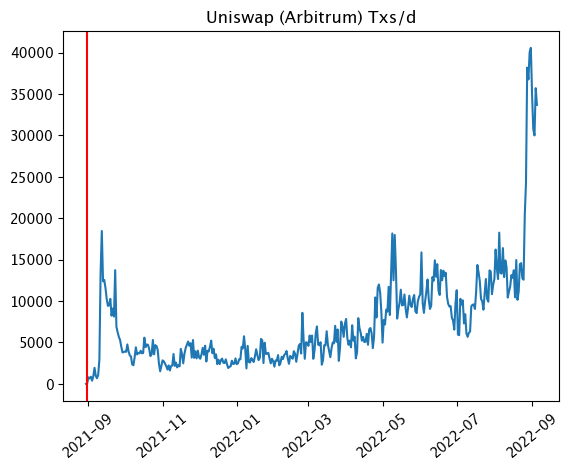

In [139]:
plot_protocoltxs(uniswap_txs_arb,'Uniswap (Arbitrum)',datetime.datetime(2021,8,31))

### Most Used Contracts

contract_name
Pair                          2607348
NonfungiblePositionManager     120722
Factory                           106
UniswapV3Factory                   89
Name: count, dtype: int64
event_name
Swap                                  2498595
Mint                                    52703
Collect                                 48540
IncreaseLiquidity                       41003
Transfer                                35977
Burn                                    28290
DecreaseLiquidity                       15126
ApprovalForAll                           3565
Approval                                 3191
Flash                                     929
PoolCreated                               195
Initialize                                102
IncreaseObservationCardinalityNext         49
Name: count, dtype: int64


<Figure size 5000x3000 with 0 Axes>

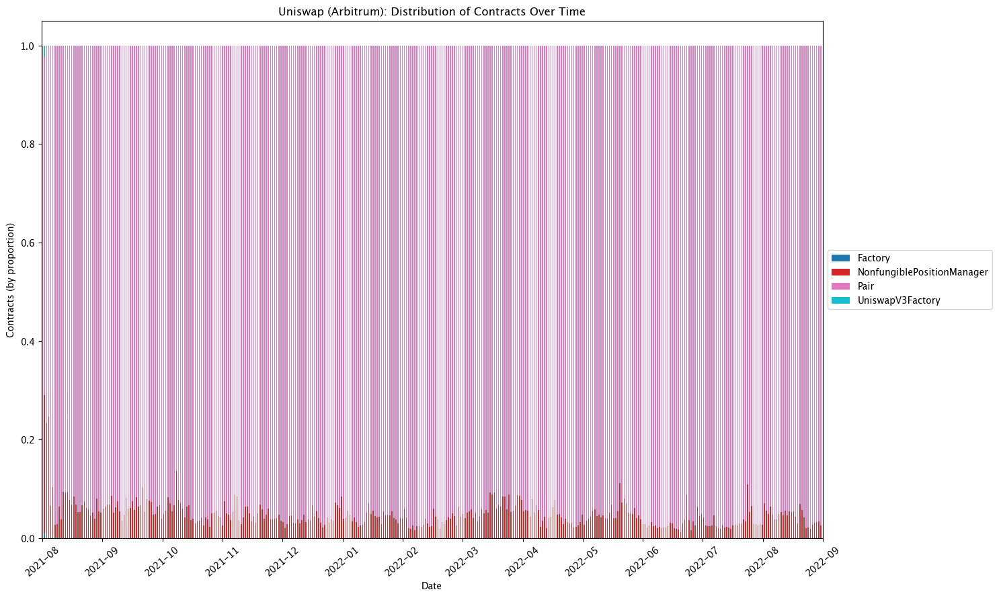

<Figure size 5000x3000 with 0 Axes>

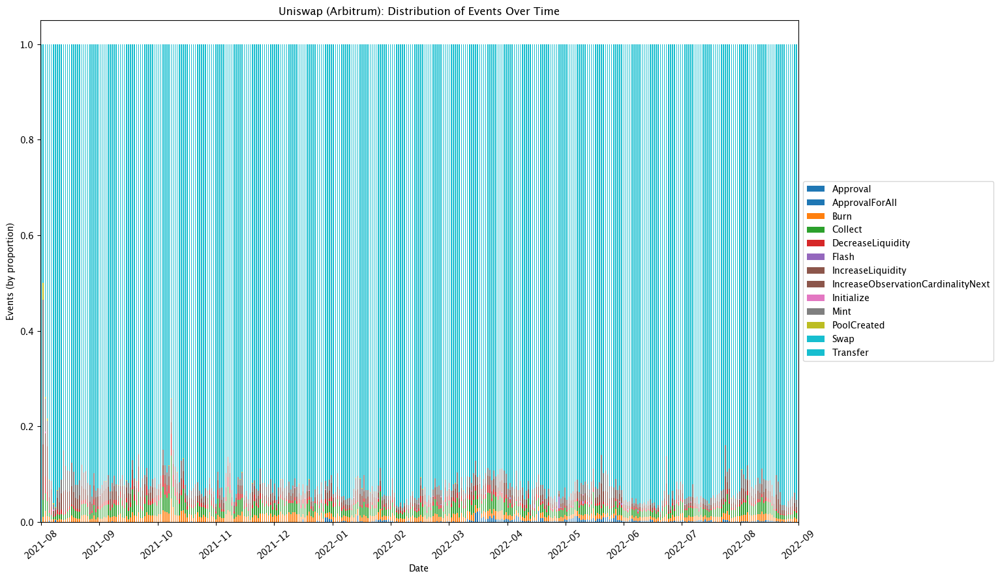

In [48]:
plot_contractsdistribution(uniswap_arb,'Uniswap','Arbitrum')

### Unique addresses

In [181]:
uniswap_unique_arb = protocol_uniqueaddresses(uniswap_arb)

In [142]:
uniswap_unique_arb

,Date,Nuniqueaddresses
0,2021-08-30,1
1,2021-08-31,23
2,2021-09-01,339
3,2021-09-02,233
4,2021-09-03,324
...,...,...
368,2022-09-02,7300
369,2022-09-03,8072
370,2022-09-04,9041
371,2022-09-05,9641


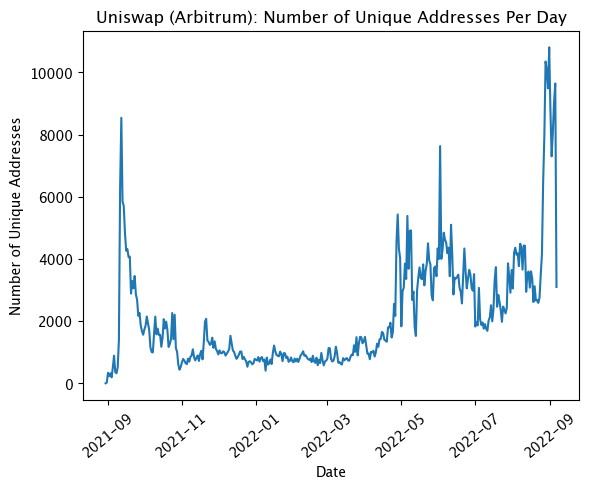

In [143]:
plot_uniqueaddresses(uniswap_unique_arb,'Uniswap (Arbitrum)')

### User retention

In [58]:
userretention_pct = userretention_mom(uniswap_arb)

#userretention_pct = userretention_pct.iloc[:-1]

userretention_pct

,Month,User Retention (%)
0,2021-09,78.0
1,2021-10,8.0
2,2021-11,10.0
3,2021-12,16.0
4,2022-01,15.0
5,2022-02,24.0
6,2022-03,25.0
7,2022-04,24.0
8,2022-05,38.0
9,2022-06,27.0


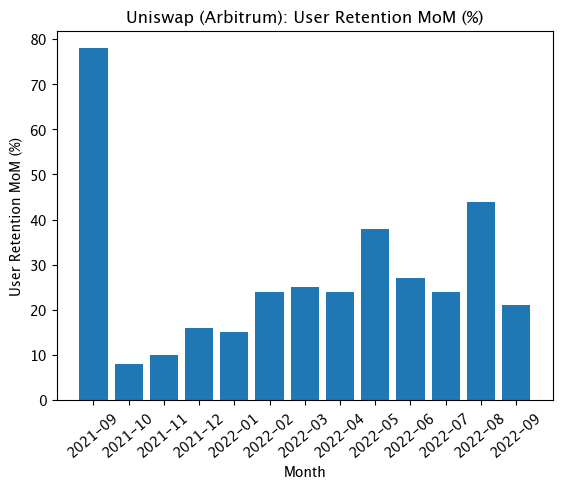

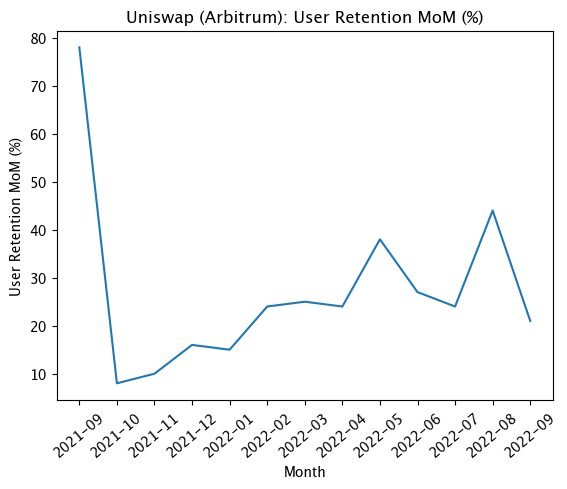

In [59]:
plot_userretention(userretention_pct,'Uniswap (Arbitrum)',calendar_dts=True)


### Protocol Popularity

In [162]:
protpopt10_arb = protocol_popularity_t10(uniswap_arb)

In [163]:
protpop_arb = protocol_popularity(uniswap_arb,100)

In [164]:
protpopt10_arb

,N Time User,Count
0,1,99206
1,2,80243
2,3,28280
3,4,27649
4,5,15748
5,6,12876
6,7,9557
7,8,8354
8,9,7423
9,10,6741


In [165]:
protpop_arb

,N Time User,Count
0,1,99206
1,2,80243
2,3,28280
3,4,27649
4,5,15748
...,...,...
95,96,7
96,97,12
97,98,6
98,99,9


<Figure size 5000x3000 with 0 Axes>

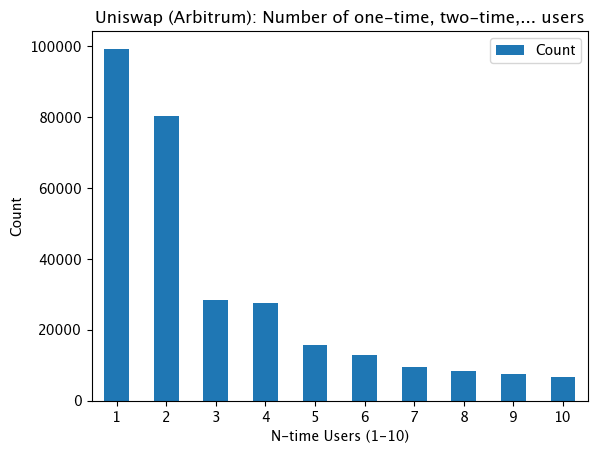

In [166]:
plot_protocolpopularity(protpopt10_arb,'Uniswap (Arbitrum)')

<Figure size 5000x3000 with 0 Axes>

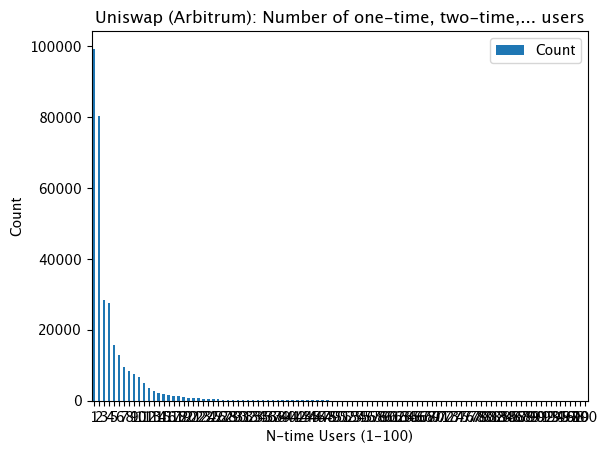

In [168]:
plot_protocolpopularity(protpop_arb,'Uniswap (Arbitrum)')

# Level Finance (on BNB)

In [67]:
path = 'Chains Data/level_finance'

In [68]:
level = agg_dfs(path)

In [70]:
level = clean_raw_dune(level)

In [72]:
level['block_time'].iloc[0]

Timestamp('2022-12-09 00:00:00')

## Transactions

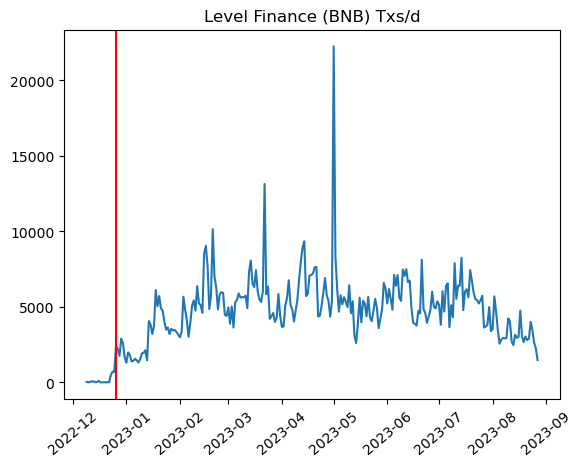

In [74]:
level_txs = protocol_txs(level)
plot_protocoltxs(level_txs,'Level Finance (BNB)', datetime.datetime(2022,12,26))

## Most Used Contracts

contract_name
LevelToken                    549047
LevelOracle                   254161
LevelGovernance               109960
OrderManager                   92292
LPToken                        37153
Pool                           35535
BridgeController               24295
LyLevel                        21268
BridgeProxy                    16956
LevelStake                     15478
LvlStaking                     15293
LevelReferralControllerV2       8647
LgoStaking                      7853
LPToken_mzeLLP                  6374
TradingContest                  5428
LPToken_jnrLLP                  4860
LevelMaster                     3625
LlpRewardDistributor            3030
LevelReferralController         2563
LevelReferralControllerV3       1981
LevelReferralRegistry           1069
LvlOmniStaking                  1009
LockDrop                         482
LgoOmniStaking                   111
TradingIncentiveController        47
GovernanceRedemptionPoolV2        26
LGOBridgeController     

<Figure size 5000x3000 with 0 Axes>

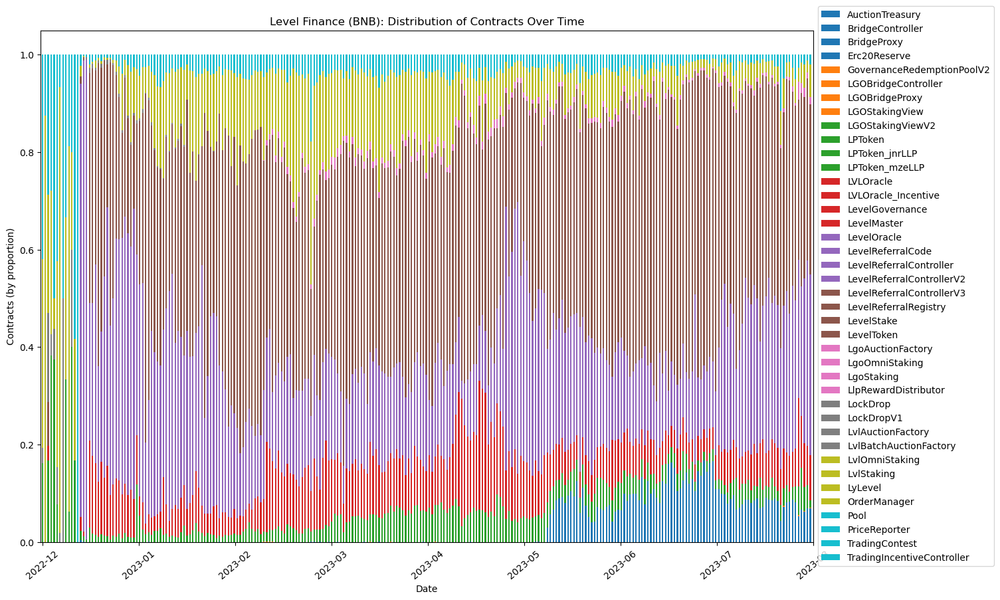

<Figure size 5000x3000 with 0 Axes>

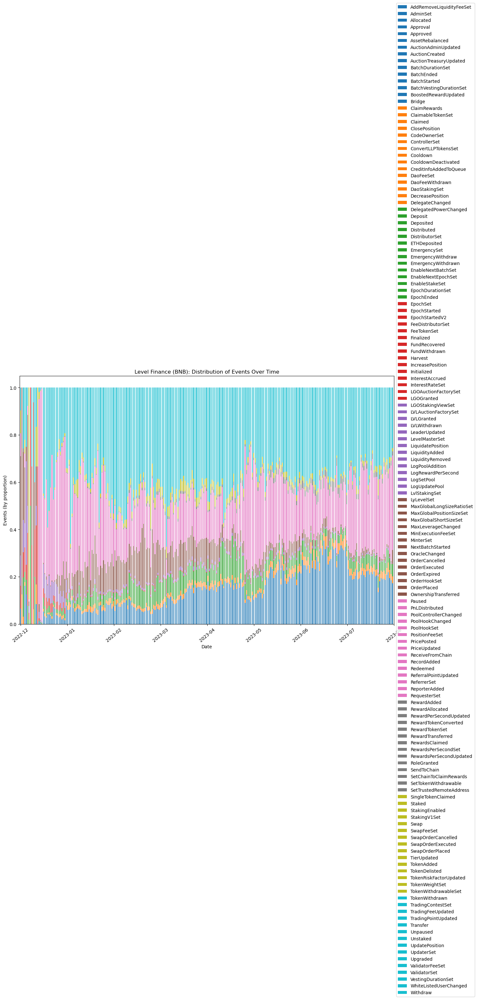

In [75]:
plot_contractsdistribution(level,'Level Finance','BNB')

## Number of Unique Addresses per day

In [76]:
level_unique = protocol_uniqueaddresses(level)

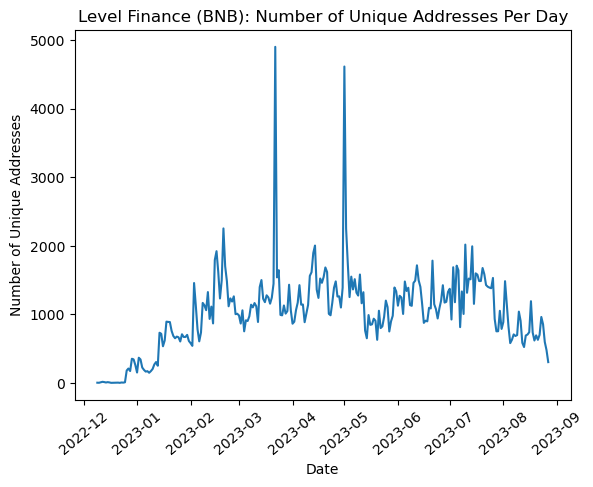

In [77]:
plot_uniqueaddresses(level_unique,'Level Finance (BNB)')

# GMX (on Arbitrum)

In [35]:
path = 'Chains Data/gmx'

In [43]:
gmx = pd.read_csv(path+'/gmx.csv')

/var/folders/g7/mcmk35wn7ls9x6nxdg8_xhlh0000gn/T/ipykernel_53247/3251605672.py:1: DtypeWarning:

Columns (11) have mixed types. Specify dtype option on import or set low_memory=False.



In [49]:
gmx = gmx.drop(['value','gas_limit','effective_gas_price'],axis=1)

In [50]:
gmx

,block_time,namespace,contract_name,contract_address,tx_hash,event_name,from,to,gas_price,gas_used,gas_used_for_l1
0,2021-09-01,gmx,Vault,0x489ee077994b6658eafa855c308275ead8097c4a,0xe662291d0b834db6489c2d6592dd323c653c77cfbc75...,Swap,0x1dc662d3d7de14a57cd369e3a9e774f8f80d4214,0x3b6067d4caa8a14c63fdbe6318f27a0bbc9f9237,2.300455e+09,1707385.0,1614600.0
1,2021-09-01,gmx,Vault,0x489ee077994b6658eafa855c308275ead8097c4a,0xccb09172472a9d63b5882705eb704b4cb8f9a4593c26...,CollectSwapFees,0x1dc662d3d7de14a57cd369e3a9e774f8f80d4214,0x3b6067d4caa8a14c63fdbe6318f27a0bbc9f9237,2.300455e+09,1282048.0,1233260.0
2,2021-09-01,gmx,Vault,0x489ee077994b6658eafa855c308275ead8097c4a,0x89a204f45b65294f4155443544364ebaef0068558e3b...,IncreaseUsdgAmount,0x1dc662d3d7de14a57cd369e3a9e774f8f80d4214,0x3b6067d4caa8a14c63fdbe6318f27a0bbc9f9237,2.300455e+09,1284914.0,1234180.0
3,2021-09-01,gmx,Vault,0x489ee077994b6658eafa855c308275ead8097c4a,0x27dd9b0af166f33b8319a649cb7a5d9a34cba0644ee6...,IncreasePoolAmount,0x1dc662d3d7de14a57cd369e3a9e774f8f80d4214,0x3b6067d4caa8a14c63fdbe6318f27a0bbc9f9237,2.251834e+09,1936557.0,1616900.0
4,2021-09-01,gmx,esGMX,0xf42ae1d54fd613c9bb14810b0588faaa09a426ca,0x90e3083756462c2860c7ec6e8fe326191aec663b1b18...,Transfer,0x5f799f365fa8a2b60ac0429c48b153ca5a6f0cf8,0xc73d553473dc65ce56db96c58e6a091c20980fba,2.251834e+09,672822.0,651820.0
...,...,...,...,...,...,...,...,...,...,...,...
2126630,2022-09-02,gmx,OrderBook,0x09f77e8a13de9a35a7231028187e9fd5db8a2acb,0x8ee6ba2b1e53d09903d4038bdb819523e8d98dd60846...,UpdateDecreaseOrder,0xf20878614c5f352b57ad7b16785140e73e69d602,0x09f77e8a13de9a35a7231028187e9fd5db8a2acb,1.000000e+08,269988.0,221232.0
2126631,2022-09-02,gmx,Vault,0x489ee077994b6658eafa855c308275ead8097c4a,0x6d7dbecce2f8b23e00dd9f14f5dff38c30f14f4cd01d...,ClosePosition,0x7af4ba11ee55091f487d06977c1f4c3805e3ef48,0x8960d1b45a2d15d063b84b34dfb2fb2ca7535527,2.500000e+11,951252.0,235254.0
2126632,2022-09-02,gmx,GMX,0xfc5a1a6eb076a2c7ad06ed22c90d7e710e35ad0a,0x40bd207a948f96ce13916106594c485c5cec1d006024...,Transfer,0x884a947e80d7c53aa5af12f279e08d3ce8cb1512,0xc36442b4a4522e871399cd717abdd847ab11fe88,1.000000e+08,498483.0,296015.0
2126633,2022-09-02,gmx,PositionRouter,0x3d6ba331e3d9702c5e8a8d254e5d8a285f223aba,0xfe8444dab168085d26ef3d0d39eec6cad305c4ba3813...,CreateIncreasePosition,0x1c72bdc0f2c9bc581a71ca629412fea85457c45a,0x3d6ba331e3d9702c5e8a8d254e5d8a285f223aba,1.900000e+09,654394.0,286667.0


In [53]:
gmx['block_time'] = gmx['block_time'].map(lambda x: datetime.datetime.strptime(x, '%Y-%m-%d'))

In [55]:
gmx['block_time'].iloc[0]

Timestamp('2021-09-01 00:00:00')

## Transactions

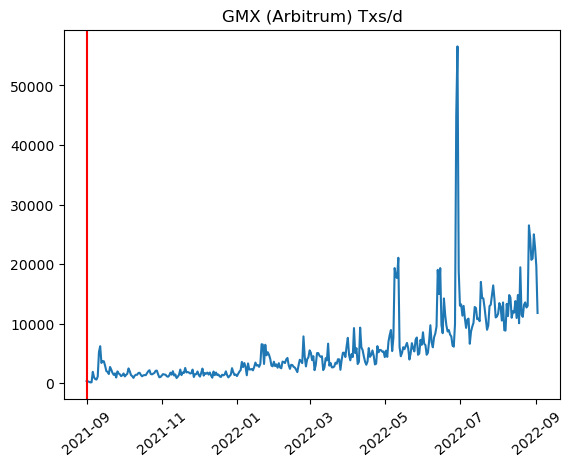

In [62]:
gmx_txs = protocol_txs(gmx)

plot_protocoltxs(gmx_txs,'GMX (Arbitrum)',datetime.datetime(2021,9,1))

## Most Used Contracts

contract_name
Vault                                 555219
FastPriceEvents                       399244
PositionRouter                        392349
GMX                                   283277
OrderBook                             143023
esGMX                                  41294
sbGMX                                  32865
sGMX                                   32435
Router                                 30417
RewardTracker                          29805
bnGMX                                  25922
RewardRouterV2                         21925
fGLP                                   18097
GLP                                    13659
fsGLP                                  12999
Vester                                 12639
vGLP                                   12176
FastPriceFeed                          10279
GmxWethArbitrumRewardsDistributor      10193
GmxEsgmxArbitrumRewardsDistributor      9671
GlpWethArbitrumRewardsDistributor       9386
GmxBngmxArbitrumRewardsDistributor      9

<Figure size 5000x3000 with 0 Axes>

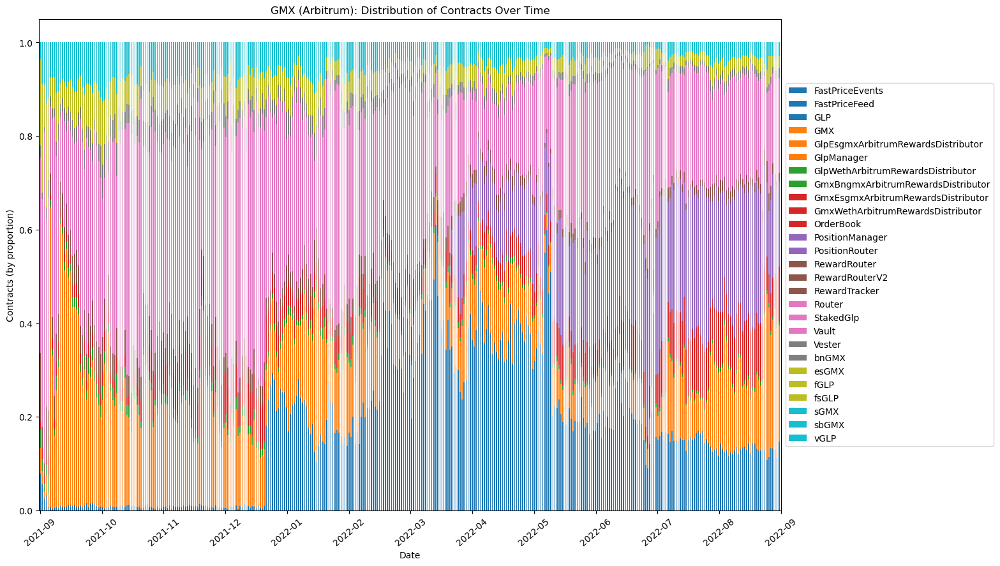

<Figure size 5000x3000 with 0 Axes>

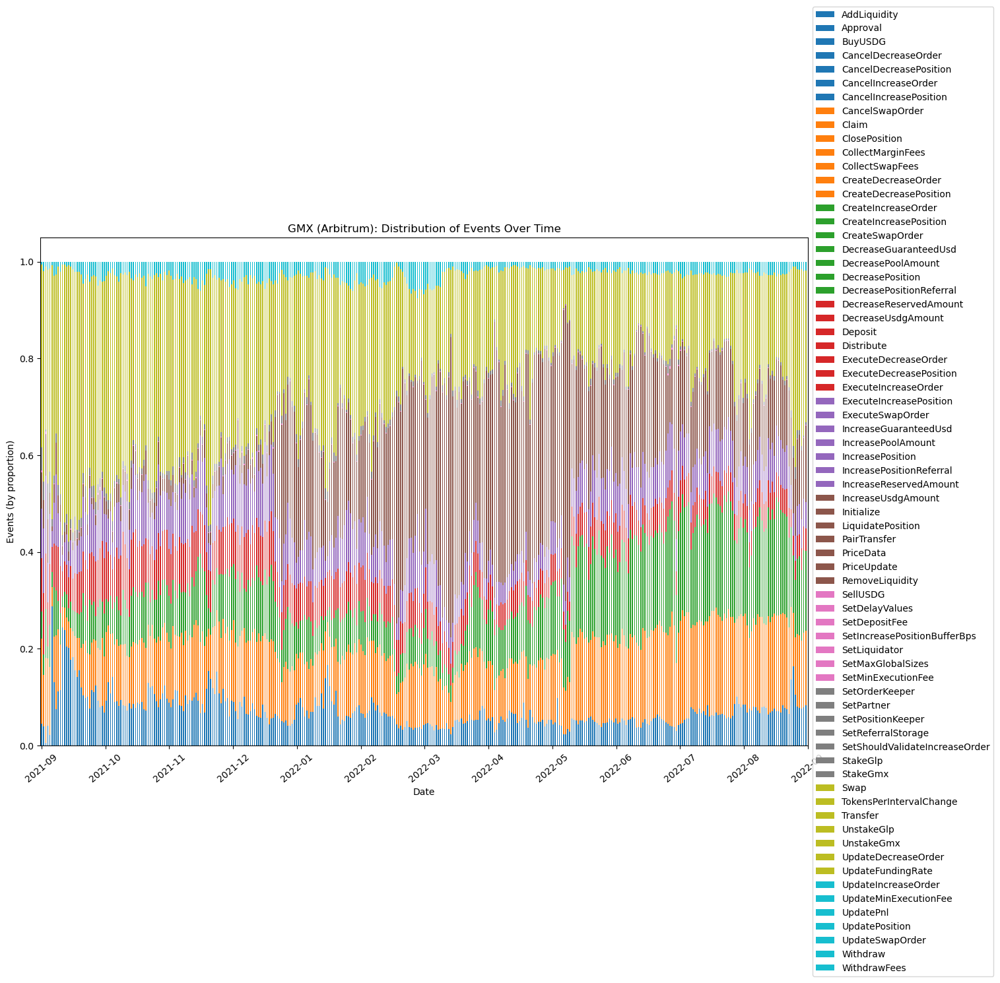

In [63]:
plot_contractsdistribution(gmx,'GMX','Arbitrum')

## Number of Unique Addresses per day

In [64]:
gmx_unique = protocol_uniqueaddresses(gmx)

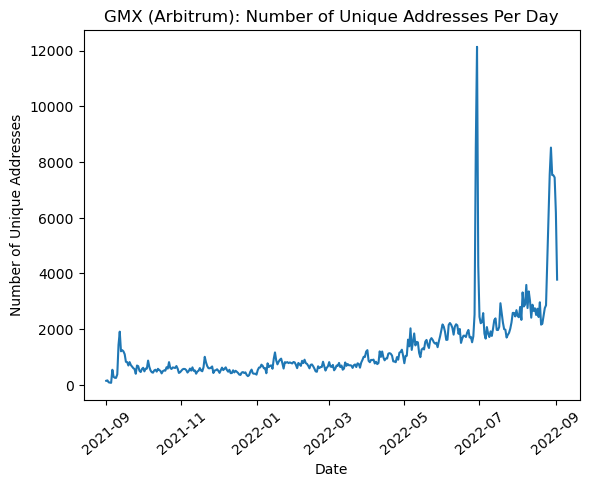

In [66]:
plot_uniqueaddresses(gmx_unique,'GMX (Arbitrum)')

# Txs per day

In [96]:
zksync_txs = all_zksync.groupby(all_zksync['block_time']).agg({'count'})
#zksync_txs.index = zksync_txs.index.map(lambda x: datetime.datetime.strptime(x,'%Y-%m-%d'))
zksync_txs = zksync_txs[zksync_txs.index<datetime.datetime(2023,7,3)]

In [97]:
zksync_txs

,block_number,value,gas_limit,gas_price,gas_used,max_fee_per_gas,max_priority_fee_per_gas,priority_fee_per_gas,nonce,index,success,from,to,block_hash,data,hash,type,access_list
,count,count,count,count,count,count,count,count,count,count,count,count,count,count,count,count,count,count
block_time,,,,,,,,,,,,,,,,,,
2023-03-23,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,0
2023-03-24,15754,15754,15754,15754,15754,15422,15422,15422,15754,15754,15754,15754,15754,15754,15754,15754,15754,0
2023-03-25,44853,44853,44853,44853,44853,44203,44203,44203,44853,44853,44853,44853,44853,44853,44853,44853,44853,0
2023-03-26,44400,44400,44400,44400,44400,43624,43624,43624,44400,44400,44400,44400,44400,44400,44400,44400,44400,0
2023-03-27,32706,32706,32706,32706,32706,32286,32286,32286,32706,32706,32706,32706,32706,32706,32706,32706,32706,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-06-28,3616,3616,3616,3616,3616,3341,3341,3341,3616,3616,3616,3616,3616,3616,3616,3616,3616,0
2023-06-29,6492,6492,6492,6492,6492,6172,6172,6172,6492,6492,6492,6492,6492,6492,6492,6492,6492,0


In [192]:
txs_op = all_op.groupby(all_op['block_time']).agg({'count'})

In [194]:
txs_op.columns

MultiIndex([(            'block_number', 'count'),
            (                   'value', 'count'),
            (               'gas_limit', 'count'),
            (               'gas_price', 'count'),
            (                'gas_used', 'count'),
            (         'max_fee_per_gas', 'count'),
            ('max_priority_fee_per_gas', 'count'),
            (    'priority_fee_per_gas', 'count'),
            (                   'nonce', 'count'),
            (                   'index', 'count'),
            (                 'success', 'count'),
            (                    'from', 'count'),
            (                      'to', 'count'),
            (              'block_hash', 'count'),
            (                    'data', 'count'),
            (                    'hash', 'count'),
            (                    'type', 'count'),
            (             'access_list', 'count'),
            (             'l1_gas_used', 'count'),
            (            'l1_ga

Text(0.5, 1.0, 'Arbitrum Txs/d first 100d')

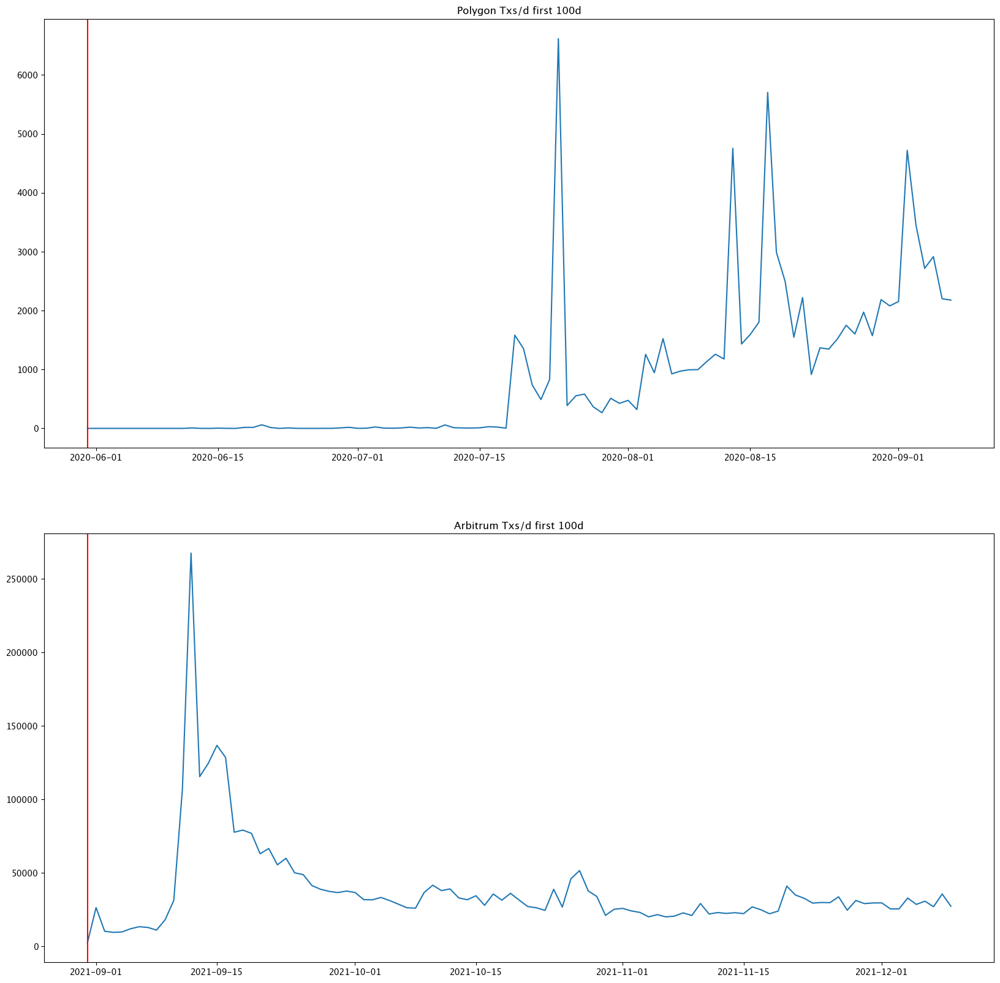

In [98]:
fig,ax = plt.subplots(2,2,figsize=(20,20))
ax1 = ax[0][0]
ax1.plot(poly_txs100['Date(UTC)'],poly_txs100['Value'])
ax1.axvline(datetime.datetime(2020, 5, 31),c='red')
ax1.set_title('Polygon Txs/d first 100d')

#Arbitrum
ax2 = ax[0][1]
ax2.plot(arb_final['Date(UTC)'],arb_final['Value'])
ax2.axvline(datetime.datetime(2021, 8, 31),c='red')
#ax2.axvline(datetime.datetime(2021, 10, 26),c='red')
ax2.set_title('Arbitrum Txs/d first 100d')

(array([18414., 18428., 18444., 18458., 18475., 18489., 18506.]),
 [Text(18414.0, 0, '2020-06-01'),
  Text(18428.0, 0, '2020-06-15'),
  Text(18444.0, 0, '2020-07-01'),
  Text(18458.0, 0, '2020-07-15'),
  Text(18475.0, 0, '2020-08-01'),
  Text(18489.0, 0, '2020-08-15'),
  Text(18506.0, 0, '2020-09-01')])

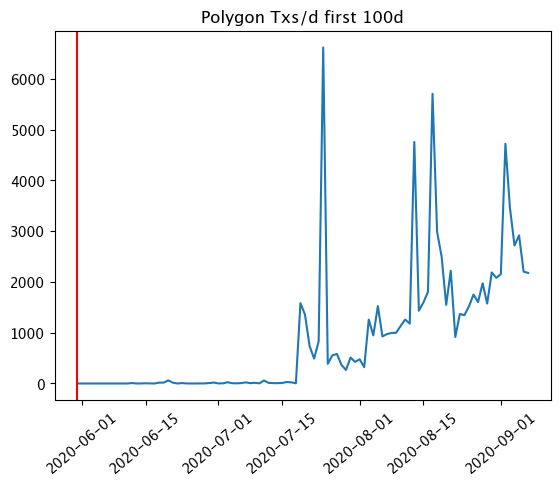

In [92]:
plt.plot(poly_txs100['Date(UTC)'],poly_txs100['Value'])
plt.axvline(datetime.datetime(2020, 5, 31),c='red')
plt.title('Polygon Txs/d first 100d')
plt.xticks(rotation=40)

(array([18871., 18885., 18901., 18915., 18932., 18946., 18962.]),
 [Text(18871.0, 0, '2021-09-01'),
  Text(18885.0, 0, '2021-09-15'),
  Text(18901.0, 0, '2021-10-01'),
  Text(18915.0, 0, '2021-10-15'),
  Text(18932.0, 0, '2021-11-01'),
  Text(18946.0, 0, '2021-11-15'),
  Text(18962.0, 0, '2021-12-01')])

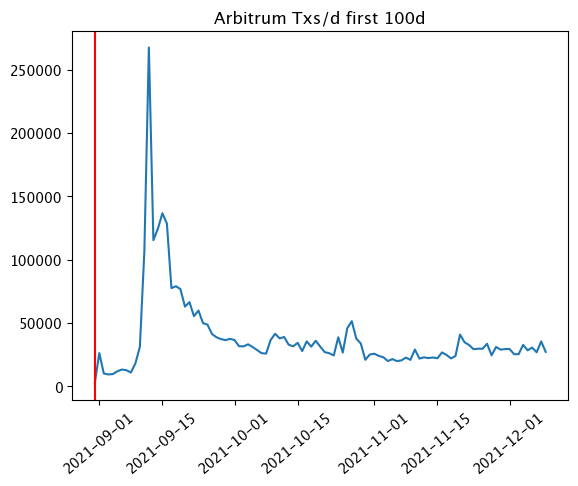

In [195]:
plt.figure()
plt.plot(arb_final['Date(UTC)'],arb_final['Value'])
plt.axvline(datetime.datetime(2021, 8, 31),c='red')
#ax2.axvline(datetime.datetime(2021, 10, 26),c='red')
plt.title('Arbitrum Txs/d first 100d')
plt.xticks(rotation=40)

In [196]:
zksync_txs.index[0]

Timestamp('2023-03-23 00:00:00')

(array([19448., 19462., 19478., 19492., 19509., 19523., 19539.]),
 [Text(19448.0, 0, '2023-04-01'),
  Text(19462.0, 0, '2023-04-15'),
  Text(19478.0, 0, '2023-05-01'),
  Text(19492.0, 0, '2023-05-15'),
  Text(19509.0, 0, '2023-06-01'),
  Text(19523.0, 0, '2023-06-15'),
  Text(19539.0, 0, '2023-07-01')])

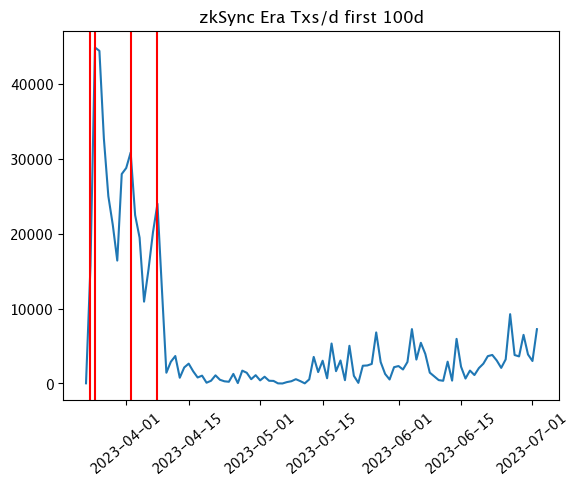

In [222]:
zksync_txs = zksync_txs.reset_index()
plt.figure()
plt.plot(zksync_txs['block_time'],zksync_txs[('success','count')])
plt.axvline(datetime.datetime(2023, 3, 24),c='red')
plt.axvline(datetime.datetime(2023, 3, 25),c='red')
plt.axvline(datetime.datetime(2023, 4, 2),c='red')
plt.axvline(datetime.datetime(2023, 4, 8),c='red')
plt.title('zkSync Era Txs/d first 100d')
plt.xticks(rotation=40)

In [264]:
zksync_txs.head(15)

,block_time,block_number,value,gas_limit,gas_price,gas_used,max_fee_per_gas,max_priority_fee_per_gas,priority_fee_per_gas,nonce,index,success,from,to,block_hash,data,hash,type,access_list
,,count,count,count,count,count,count,count,count,count,count,count,count,count,count,count,count,count,count
0,2023-03-23,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,0
1,2023-03-24,15754,15754,15754,15754,15754,15422,15422,15422,15754,15754,15754,15754,15754,15754,15754,15754,15754,0
2,2023-03-25,44853,44853,44853,44853,44853,44203,44203,44203,44853,44853,44853,44853,44853,44853,44853,44853,44853,0
3,2023-03-26,44400,44400,44400,44400,44400,43624,43624,43624,44400,44400,44400,44400,44400,44400,44400,44400,44400,0
4,2023-03-27,32706,32706,32706,32706,32706,32286,32286,32286,32706,32706,32706,32706,32706,32706,32706,32706,32706,0
5,2023-03-28,25008,25008,25008,25008,25008,24663,24663,24663,25008,25008,25008,25008,25008,25008,25008,25008,25008,0
6,2023-03-29,21155,21155,21155,21155,21155,20355,20355,20355,21155,21155,21155,21155,21155,21155,21155,21155,21155,0
7,2023-03-30,16408,16408,16408,16408,16408,16131,16131,16131,16408,16408,16408,16408,16408,16408,16408,16408,16408,0
8,2023-03-31,27960,27960,27960,27960,27960,27366,27366,27366,27960,27960,27960,27960,27960,27960,27960,27960,27960,0


In [204]:
txs_op.index = txs_op.index.map(lambda x: datetime.datetime.strptime(x,'%Y-%m-%d'))

(array([18976., 18993., 19007., 19024., 19038., 19052., 19066., 19083.]),
 [Text(18976.0, 0, '2021-12-15'),
  Text(18993.0, 0, '2022-01-01'),
  Text(19007.0, 0, '2022-01-15'),
  Text(19024.0, 0, '2022-02-01'),
  Text(19038.0, 0, '2022-02-15'),
  Text(19052.0, 0, '2022-03-01'),
  Text(19066.0, 0, '2022-03-15'),
  Text(19083.0, 0, '2022-04-01')])

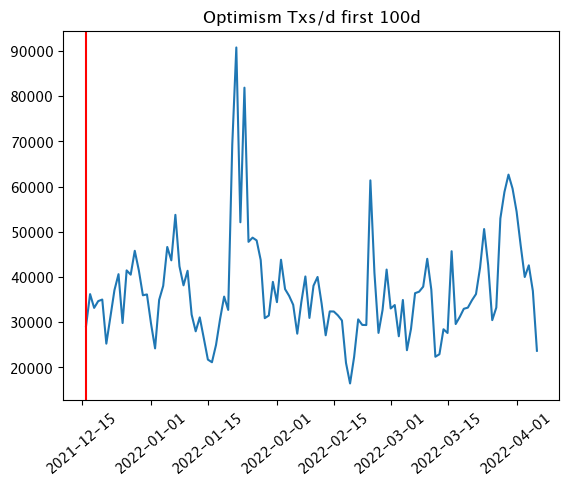

In [226]:
txs_op = txs_op.reset_index()
plt.figure()
plt.plot(txs_op['block_time'],txs_op[('success','count')])
plt.axvline(datetime.datetime(2021, 12, 16),c='red')
plt.title('Optimism Txs/d first 100d')
plt.xticks(rotation=40)

In [237]:
txs100_poly = poly_txs100[(poly_txs100['Date(UTC)'] >= datetime.datetime(2020,5,31)) & (poly_txs100['Date(UTC)'] <= (datetime.datetime(2020,5,31)+datetime.timedelta(days=100)))]
txs100_arb = arb_final[(arb_final['Date(UTC)'] >= datetime.datetime(2021,8,31)) & (arb_final['Date(UTC)'] < (datetime.datetime(2021,8,31)+datetime.timedelta(days=100)))]
txs100_zksync = zksync_txs[(zksync_txs['block_time'] >= datetime.datetime(2023,3,24)) & (zksync_txs['block_time'] <= datetime.datetime(2023,3,24)+datetime.timedelta(days=100))]
txs100_op = txs_op[(txs_op['block_time'] >= datetime.datetime(2021,12,16)) & (txs_op['block_time'] < datetime.datetime(2021,12,16)+datetime.timedelta(days=100))]


In [238]:
txs100_poly

,Date(UTC),UnixTimeStamp,Value
0,2020-05-31,1590883200,0
1,2020-06-01,1590969600,0
2,2020-06-02,1591056000,0
3,2020-06-03,1591142400,0
4,2020-06-04,1591228800,0
...,...,...,...
95,2020-09-03,1599091200,3454
96,2020-09-04,1599177600,2717
97,2020-09-05,1599264000,2916
98,2020-09-06,1599350400,2201


In [239]:
txs100_arb

,Date(UTC),UnixTimeStamp,Value
94,2021-08-31,1630368000,2309
95,2021-09-01,1630454400,26326
96,2021-09-02,1630540800,10205
97,2021-09-03,1630627200,9445
98,2021-09-04,1630713600,9721
...,...,...,...
189,2021-12-04,1638576000,32808
190,2021-12-05,1638662400,28492
191,2021-12-06,1638748800,30668
192,2021-12-07,1638835200,26940


In [240]:
txs100_zksync

,block_time,block_number,value,gas_limit,gas_price,gas_used,max_fee_per_gas,max_priority_fee_per_gas,priority_fee_per_gas,nonce,index,success,from,to,block_hash,data,hash,type,access_list
,,count,count,count,count,count,count,count,count,count,count,count,count,count,count,count,count,count,count
1,2023-03-24,15754,15754,15754,15754,15754,15422,15422,15422,15754,15754,15754,15754,15754,15754,15754,15754,15754,0
2,2023-03-25,44853,44853,44853,44853,44853,44203,44203,44203,44853,44853,44853,44853,44853,44853,44853,44853,44853,0
3,2023-03-26,44400,44400,44400,44400,44400,43624,43624,43624,44400,44400,44400,44400,44400,44400,44400,44400,44400,0
4,2023-03-27,32706,32706,32706,32706,32706,32286,32286,32286,32706,32706,32706,32706,32706,32706,32706,32706,32706,0
5,2023-03-28,25008,25008,25008,25008,25008,24663,24663,24663,25008,25008,25008,25008,25008,25008,25008,25008,25008,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96,2023-06-28,3616,3616,3616,3616,3616,3341,3341,3341,3616,3616,3616,3616,3616,3616,3616,3616,3616,0
97,2023-06-29,6492,6492,6492,6492,6492,6172,6172,6172,6492,6492,6492,6492,6492,6492,6492,6492,6492,0
98,2023-06-30,3877,3877,3877,3877,3877,3633,3633,3633,3877,3877,3877,3877,3877,3877,3877,3877,3877,0


In [241]:
txs100_op

,block_time,block_number,value,gas_limit,gas_price,gas_used,max_fee_per_gas,max_priority_fee_per_gas,priority_fee_per_gas,nonce,...,hash,type,access_list,l1_gas_used,l1_gas_price,l1_fee,l1_fee_scalar,l1_block_number,l1_timestamp,l1_tx_origin
,,count,count,count,count,count,count,count,count,count,...,count,count,count,count,count,count,count,count,count,count
0,2021-12-16,29135,29135,29135,29135,29135,0,0,0,29135,...,29135,29135,0,29135,29135,29135,29135,29135,29135,356
1,2021-12-17,36228,36228,36228,36228,36228,0,0,0,36228,...,36228,36228,0,36228,36228,36228,36228,36228,36228,382
2,2021-12-18,33179,33179,33179,33179,33179,0,0,0,33179,...,33179,33179,0,33179,33179,33179,33179,33179,33179,495
3,2021-12-19,34678,34678,34678,34678,34678,0,0,0,34678,...,34678,34678,0,34678,34678,34678,34678,34678,34678,652
4,2021-12-20,35025,35025,35025,35025,35025,0,0,0,35025,...,35025,35025,0,35025,35025,35025,35025,35025,35025,375
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,2022-03-21,34863,34863,34863,34863,34863,0,0,0,34863,...,34863,34863,0,34863,34863,34863,34863,34863,34863,315
96,2022-03-22,36235,36235,36235,36235,36235,0,0,0,36235,...,36235,36235,0,36235,36235,36235,36235,36235,36235,288
97,2022-03-23,42073,42073,42073,42073,42073,0,0,0,42073,...,42073,42073,0,42073,42073,42073,42073,42073,42073,511


In [257]:
compare_txs = pd.DataFrame(columns=['Day','Polygon_txs','Arbitrum_txs','zkSync_txs','Optimism_txs'])
compare_txs['Day'] = list(range(0,100))
compare_txs['Polygon_txs'] = txs100_poly['Value'].to_list()
compare_txs['Arbitrum_txs'] = txs100_arb['Value'].to_list()
compare_txs['zkSync_txs'] = txs100_zksync[('success','count')]to_list()
compare_txs['Optimism_txs'] = txs100_op[('success','count')]to_list()


SyntaxError: invalid syntax (2113999633.py, line 5)

Text(0.5, 1.0, 'Txs first 100 days: Polygon vs. Arbitrum vs. zkSync vs. Optimism')

<Figure size 640x480 with 0 Axes>

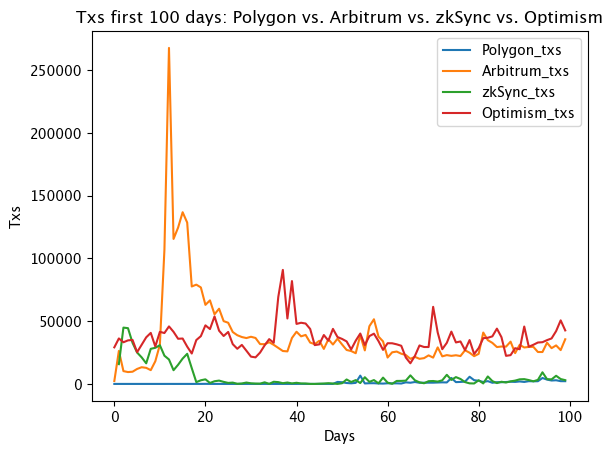

In [258]:
plt.figure()
compare_txs.plot(x='Day',y=['Polygon_txs','Arbitrum_txs','zkSync_txs','Optimism_txs'],kind='line')
plt.xlabel('Days')
plt.ylabel('Txs')
plt.title('Txs first 100 days: Polygon vs. Arbitrum vs. zkSync vs. Optimism')
plt.yscale('log')


In [259]:
def normalize(x):
    return (x-np.min(x))/(np.max(x)-np.min(x))

compare_txs_norm = pd.DataFrame(columns=['Day','Polygon_txs','Arbitrum_txs','zkSync_txs','Optimism_txs'])
compare_txs_norm['Day'] = list(range(0,100))
compare_txs_norm['Polygon_txs'] = normalize(txs100_poly['Value'].to_list())
compare_txs_norm['Arbitrum_txs'] = normalize(txs100_arb['Value'].to_list())
compare_txs_norm['zkSync_txs'] = normalize(txs100_zksync[('success','count')].to_list())
compare_txs_norm['Optimism_txs'] = normalize(txs100_op[('success','count')].to_list())


Text(0.5, 1.0, 'Txs first 100 days: Polygon vs. Arbitrum vs. zkSync vs. Optimism (normalized)')

<Figure size 640x480 with 0 Axes>

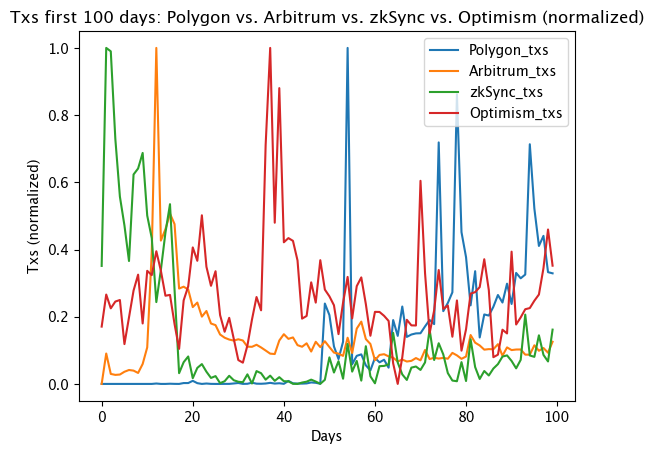

In [260]:
plt.figure()
compare_txs_norm.plot(x='Day',y=['Polygon_txs','Arbitrum_txs','zkSync_txs','Optimism_txs'],kind='line')
plt.xlabel('Days')
plt.ylabel('Txs (normalized)')
plt.title('Txs first 100 days: Polygon vs. Arbitrum vs. zkSync vs. Optimism (normalized)')


## Analyze transactions

In [261]:
#Analyze zkSync Era
zksync_txs.sort_values(by=[('success','count')],ascending=False).iloc[:10]

,block_time,block_number,value,gas_limit,gas_price,gas_used,max_fee_per_gas,max_priority_fee_per_gas,priority_fee_per_gas,nonce,index,success,from,to,block_hash,data,hash,type,access_list
,,count,count,count,count,count,count,count,count,count,count,count,count,count,count,count,count,count,count
2,2023-03-25,44853,44853,44853,44853,44853,44203,44203,44203,44853,44853,44853,44853,44853,44853,44853,44853,44853,0
3,2023-03-26,44400,44400,44400,44400,44400,43624,43624,43624,44400,44400,44400,44400,44400,44400,44400,44400,44400,0
4,2023-03-27,32706,32706,32706,32706,32706,32286,32286,32286,32706,32706,32706,32706,32706,32706,32706,32706,32706,0
10,2023-04-02,30838,30838,30838,30838,30838,30272,30272,30272,30838,30838,30838,30838,30838,30838,30838,30838,30838,0
9,2023-04-01,28760,28760,28760,28760,28760,28369,28369,28369,28760,28760,28760,28760,28760,28760,28760,28760,28760,0
8,2023-03-31,27960,27960,27960,27960,27960,27366,27366,27366,27960,27960,27960,27960,27960,27960,27960,27960,27960,0
5,2023-03-28,25008,25008,25008,25008,25008,24663,24663,24663,25008,25008,25008,25008,25008,25008,25008,25008,25008,0
16,2023-04-08,23995,23995,23995,23995,23995,23273,23273,23273,23995,23995,23995,23995,23995,23995,23995,23995,23995,0
11,2023-04-03,22476,22476,22476,22476,22476,22157,22157,22157,22476,22476,22476,22476,22476,22476,22476,22476,22476,0


In [ ]:
#Analyze polygon txs
poly_txs100.sort_values(by=['Value'],ascending=False).iloc[:10]

In [28]:
txs[txs.index < '2020-7-23'].sort_values(by=txs.columns[0],ascending=False)

,transaction_hash,block_number,base_fee_per_gas,max_priority_fee_per_gas,max_fee_per_gas,gas_limit,gas_used,gas_price,transaction_fee,fees_burned,...,position,type,from_address,to_address,value,contract_address,internal_transaction_count,log_count,__confirmed,date
,count,count,count,count,count,count,count,count,count,count,...,count,count,count,count,count,count,count,count,count,count
timestamp,,,,,,,,,,,,,,,,,,,,,
2020-07-19,1582,1582,1582,1582,1582,1582,1582,1582,1582,1582,...,1582,1582,1577,1574,1582,3,1582,1582,1582,1582
2020-07-20,1356,1356,1356,1356,1356,1356,1356,1356,1356,1356,...,1356,1356,1352,1349,1356,3,1356,1356,1356,1356
2020-07-21,738,738,738,738,738,738,738,738,738,738,...,738,738,736,736,738,0,738,738,738,738
2020-07-22,490,490,490,490,490,490,490,490,490,490,...,490,490,487,483,490,4,490,490,490,490
2020-06-20,61,61,61,61,61,61,61,61,61,61,...,61,61,44,44,61,0,61,61,61,61
2020-07-11,59,59,59,59,59,59,59,59,59,59,...,59,59,50,48,59,2,59,59,59,59
2020-07-16,29,29,29,29,29,29,29,29,29,29,...,29,29,25,14,29,11,29,29,29,29
2020-07-03,24,24,24,24,24,24,24,24,24,24,...,24,24,20,15,24,5,24,24,24,24


In [29]:
arb_final.sort_values(by=['Value'],ascending=False).iloc[:10]

,Date(UTC),UnixTimeStamp,Value
106,2021-09-12,1631404800,267608
109,2021-09-15,1631664000,136745
110,2021-09-16,1631750400,128495
108,2021-09-14,1631577600,124495
107,2021-09-13,1631491200,115475
105,2021-09-11,1631318400,106839
112,2021-09-18,1631923200,79071
111,2021-09-17,1631836800,77614
113,2021-09-19,1632009600,76844
115,2021-09-21,1632182400,66540


# The number of smart contracts created

In [30]:
# Arbitrum's most popular smart contracts
all_arb['contract_address'].isna().sum()/len(all_arb) #99.8% of txs are not smart contract creations

0.9983829306239631

In [31]:
all_arb[~all_arb['contract_address'].isna()]

,block_number,timestamp,transaction_hash,gas_limit,gas_used,gas_price,transaction_fee,nonce,position,type,from_address,to_address,value,contract_address,input,output,internal_transaction_count,log_count,__confirmed
68,221114,2021-08-20,0x86819fce2e20f8f20aad031d3bef3dc34b3ea8ebf8dd...,120967558,109951059,417120098,45862796505283782,456,0,120,0x904b5993fC92979eeEdC19cCC58bED6B7216667c,NaN,0,0xB1bfC2f6CF568bE05677607DA9ffb99b54E994d2,NaN,NaN,0,0,True
90,221136,2021-08-20,0x65d0934bd9fb69177328738429d961e3fff74925b436...,82891189,75336042,417120098,31424177221972116,1,0,120,0x10942b355B83649Efc7c0085d4ad1FCfA98Abde1,NaN,0,0xE85B0b53720bC61534D45D31353e5FD226cB9ddA,NaN,NaN,0,1,True
336,221314,2021-08-20,0x60d3019a9d140d35adf0bff5e5c2fb2bf18a75017962...,31113580,28265308,428243699,12104440051294292,7,0,120,0xd00ED528791F37892cdE39B7a7F0c3A3faf84C3f,NaN,0,0x60E717d2ba1C72fDF776B693694b5875A0bc7562,NaN,NaN,0,1,True
341,221319,2021-08-20,0xf1f8a79afeeedb22e2d7fd3e53e68e18f465c663fcfc...,226692336,206066216,428243699,88246558578772984,8,0,120,0xd00ED528791F37892cdE39B7a7F0c3A3faf84C3f,NaN,0,0x56981F255E878d1152B3B2218150cc89D8a48161,NaN,NaN,0,1,True
388,221369,2021-08-21,0x43d451bbe6462028cbf8430d6636e9a6d5078a7a9929...,60227114,54732260,410005441,22440524398226660,457,0,120,0x904b5993fC92979eeEdC19cCC58bED6B7216667c,NaN,0,0xBC99E1a36e6b841fB8F56543B4783e9546F31eaE,NaN,NaN,0,0,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3716550,3682299,2021-12-08,0xd2516a8e9c20dd07aeb4393e7cc0ebb9b2392e9ce4dc...,200000000,148332341,801072136,118824905242750376,7,0,120,0xE878d69526e611D0E547bCfd64f5A28D15ae20FD,NaN,0,0x4d67341A55E2d90e030168a8092Ec5D485626994,NaN,NaN,0,0,True
3716554,3682305,2021-12-08,0xcae93d6febd400b39bc1418480c51dec9ea6b2c053d8...,200000000,12317777,801072136,9867427932161672,8,0,120,0xE878d69526e611D0E547bCfd64f5A28D15ae20FD,NaN,0,0x98b441cc64F31AF2b23b4b1C1b86F466Aea06fa7,NaN,NaN,0,3,True
3716582,3682325,2021-12-08,0x27c1ccfc2ffbde80e13703f9342a0f75e6dad8738279...,200000000,35598321,801072136,28516823041483656,17,0,120,0xE878d69526e611D0E547bCfd64f5A28D15ae20FD,NaN,0,0xD38bE3D17844f497FF95950da0EF6014c96D91B0,NaN,NaN,0,0,True
3716603,3682331,2021-12-08,0x908f9d924b0f5b21c0ccb1fc46ead47e4d81e196072f...,200000000,5866981,801072136,4699875001541416,18,0,120,0xE878d69526e611D0E547bCfd64f5A28D15ae20FD,NaN,0,0x3E0D45bf5B2A6DA9e9Eee197B6d52f0bBb87664D,NaN,NaN,0,1,True


In [32]:
#!!!next: find frequencies of each unique smart contracts ->dist. graph
deploycontracts_arb = all_arb.copy()
deploycontractscount_arb = deploycontracts_arb.groupby(deploycontracts_arb['timestamp']).agg({'count'})
deploycontractscount_arb = deploycontractscount_arb.reset_index()

In [33]:
deploycontractscount_arb['deployed_contracts_count'] = deploycontractscount_arb[('contract_address','count')]

In [34]:
deploycontractscount_arb['timestamp'] = pd.to_datetime(deploycontractscount_arb['timestamp'], format="%Y-%m-%d")

In [35]:
avgdeploycontractscount_arb = deploycontractscount_arb['deployed_contracts_count'].sum()/len(deploycontractscount_arb['deployed_contracts_count'])
stddeploycontractscount_arb = round(deploycontractscount_arb['deployed_contracts_count'].std())

Text(2021-09-26 00:00:00, 250, 'Avg. # of contracts created: 54+/-57 per day')

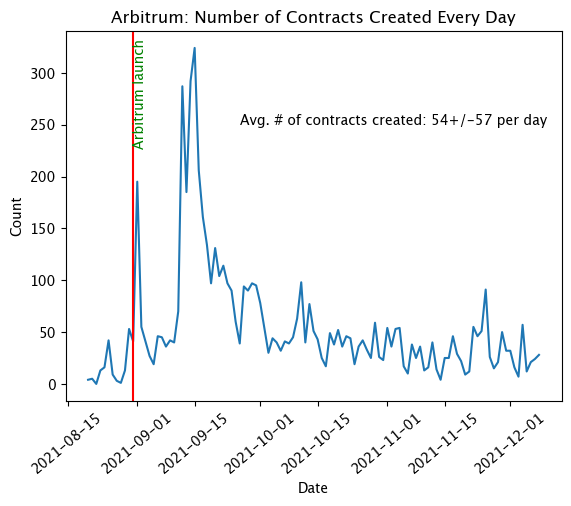

In [36]:
plt.figure(1)
plt.plot(deploycontractscount_arb['timestamp'],deploycontractscount_arb['deployed_contracts_count'])
plt.axvline(datetime.datetime(2021, 8, 31),c='red')
plt.title('Arbitrum: Number of Contracts Created Every Day')
plt.xlabel('Date')
plt.ylabel('Count')
plt.xticks(rotation=40)
plt.text(datetime.datetime(2021,8,31),230,'Arbitrum launch',rotation=90,c='green')
plt.text(datetime.datetime(2021,9,26),250,f"Avg. # of contracts created: {round(avgdeploycontractscount_arb)}+/-{stddeploycontractscount_arb} per day")


In [37]:
#Polygon
deploycontracts_poly = poly.copy()
deploycontractscount_poly = deploycontracts_poly.groupby(deploycontracts_poly['timestamp']).agg({'count'})
deploycontractscount_poly = deploycontractscount_poly.reset_index()
deploycontractscount_poly['timestamp'] = pd.to_datetime(deploycontractscount_poly['timestamp'], format="%Y-%m-%d")
deploycontractscount_poly['deployed_contracts_count'] = deploycontractscount_poly[('contract_address','count')]

In [38]:
avgdeploycontractscount_poly = deploycontractscount_poly['deployed_contracts_count'].sum()/len(deploycontractscount_poly['deployed_contracts_count'])
stddeploycontractscount_poly = round(deploycontractscount_poly['deployed_contracts_count'].std())

Text(2020-06-04 00:00:00, 200, 'Avg. # of contracts created: 10+/-30 per day')

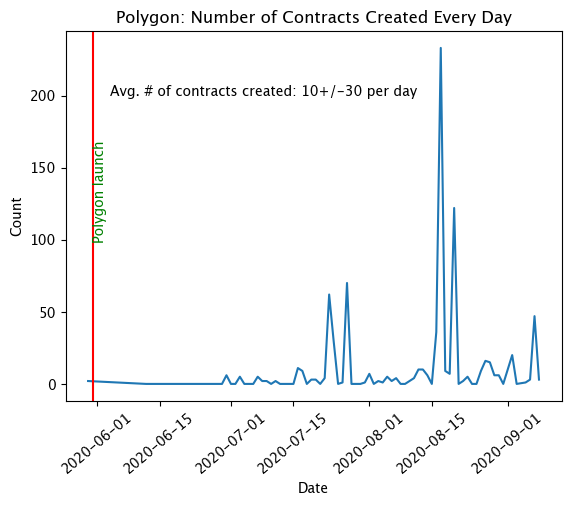

In [39]:
plt.figure(2)
plt.plot(deploycontractscount_poly['timestamp'],deploycontractscount_poly['deployed_contracts_count'])
plt.axvline(datetime.datetime(2020, 5, 31),c='red')
plt.title('Polygon: Number of Contracts Created Every Day')
plt.xlabel('Date')
plt.ylabel('Count')
plt.xticks(rotation=40)
plt.text(datetime.datetime(2020,5,31),100,'Polygon launch',rotation=90,c='green')
plt.text(datetime.datetime(2020,6,4),200,f"Avg. # of contracts created: {round(avgdeploycontractscount_poly)}+/-{stddeploycontractscount_poly} per day")

## Below is the failed attempt. 

It only captures the prominent smart contract address calls. Per Peter's rec, I will instead look for the freq. of unique smart contract addresses in the settlement layer instead of the protocols layer (as many protocols don't register on the protocol layer).

In [40]:
#Polygon Protocols
poly_protocols = pd.read_csv('Chains Data/polygon txs/protocols.csv')

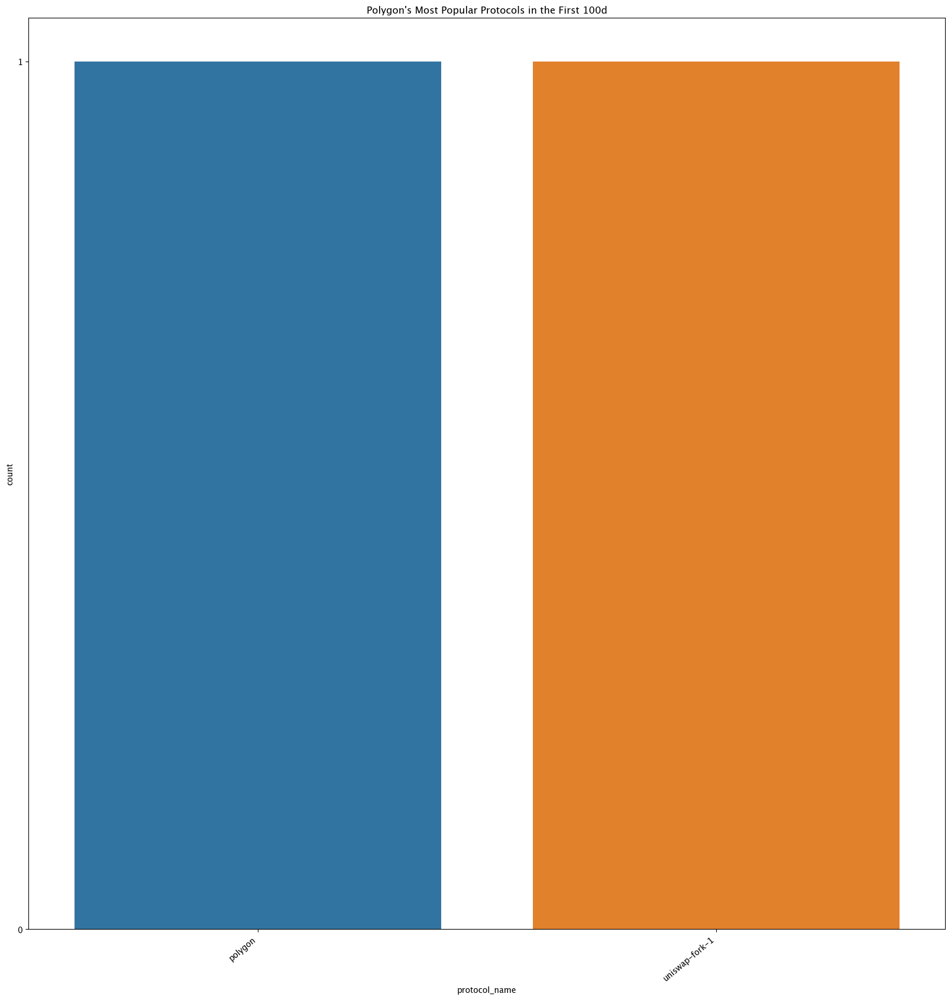

In [41]:
plt.figure(1,figsize=(20,20))
sns.countplot(x='protocol_name',data=poly_protocols)
plt.title('Polygon\'s Most Popular Protocols in the First 100d')
plt.xticks(rotation=40, ha="right")
plt.yticks([0,1])
plt.show()

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26]),
 [Text(0, 0, 'uniswap-fork-2'),
  Text(1, 0, 'balancer'),
  Text(2, 0, 'dodoswap'),
  Text(3, 0, 'dodo'),
  Text(4, 0, 'gmx'),
  Text(5, 0, 'hop'),
  Text(6, 0, 'swapr'),
  Text(7, 0, 'uniswap-fork-3'),
  Text(8, 0, 'uniswap-fork-13'),
  Text(9, 0, 'curve'),
  Text(10, 0, 'synapse'),
  Text(11, 0, 'smolpuddle'),
  Text(12, 0, 'uniswap-fork-4'),
  Text(13, 0, 'uniswap-fork-5'),
  Text(14, 0, 'uniswap-fork-6'),
  Text(15, 0, 'uniswap-fork-7'),
  Text(16, 0, 'uniswap-fork-8'),
  Text(17, 0, 'uniswap-fork-9'),
  Text(18, 0, 'uniswap-fork-11'),
  Text(19, 0, 'uniswap-fork-10'),
  Text(20, 0, 'slingshot'),
  Text(21, 0, 'uniswap-fork-12'),
  Text(22, 0, 'elkswap'),
  Text(23, 0, 'summaswap'),
  Text(24, 0, '1inch'),
  Text(25, 0, 'tofu'),
  Text(26, 0, 'open-ocean')])

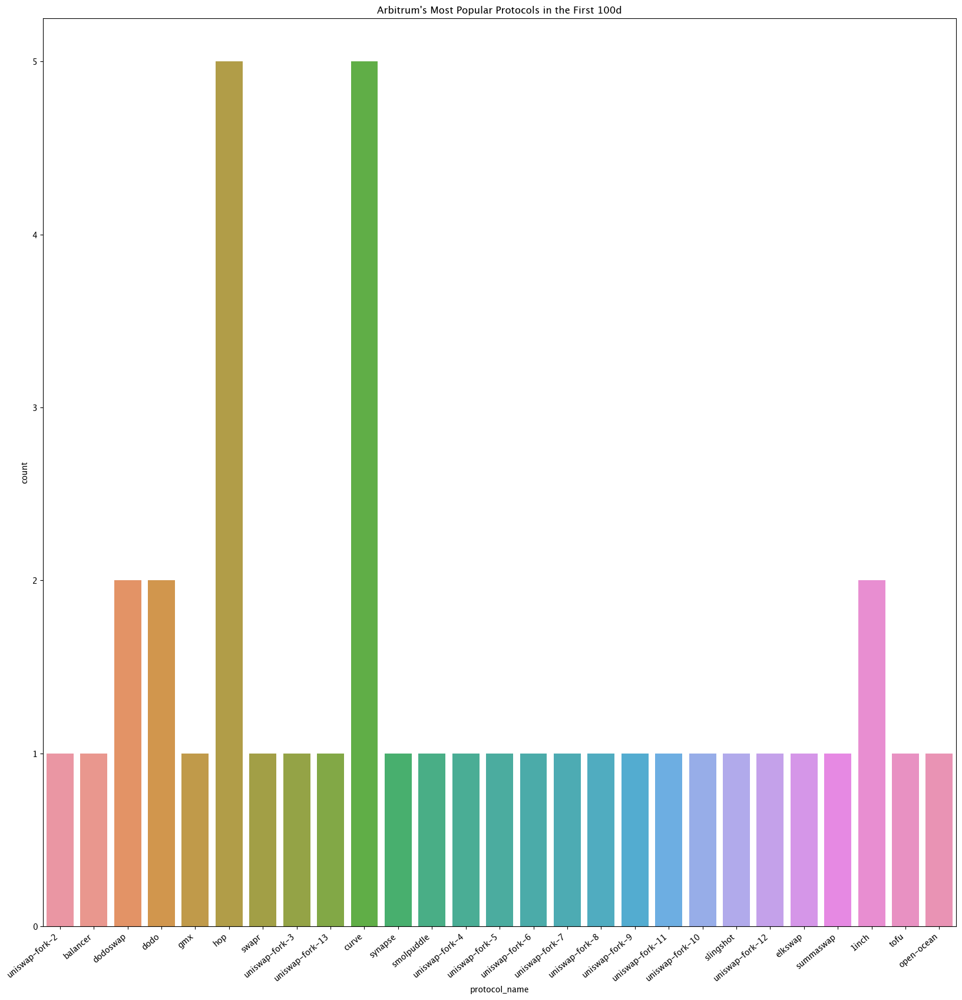

In [42]:
#Arbitrum Protocols
plt.figure(2,figsize=(20,20))
sns.countplot(x='protocol_name',data=arb_protocol)
plt.title('Arbitrum\'s Most Popular Protocols in the First 100d')
plt.xticks(rotation=40, ha="right")

## Unique addresses and their activity (unsure if this is correct)

In [22]:
arb_protocols = arb_protocol.copy()

In [23]:
arb_protocols.columns

Index(['block_time', 'hash', 'to', 'namespace', 'from', 'name'], dtype='object')

In [67]:
arb_protocols['from_address'].unique()

array(['0x2c1F8F72ed9bd1F59b140C5E6BCEAcC8A4753695',
       '0x697A71353A4BC1eb1356763018a229c27a3fbA0C',
       '0x7081685Ff3ff16FB6c0dF08AC93bdB7299EEEfc9',
       '0x5F799f365Fa8A2B60ac0429C48B153cA5a6f0Cf8',
       '0x924AC9910C09A0215b06458653b30471A152022F',
       '0xbf7454c656BDB7C439E8d759c18Ac240398FdE35',
       '0x74665b21461F8D9b23bAB7d599bfd7566a95fD70',
       '0x4274A49FBeB724D75b8ba7bfC55FC8495A15AD1E',
       '0x7EeAC6CDdbd1D0B8aF061742D41877D7F707289a',
       '0x0AF91FA049A7e1894F480bFE5bBa20142C6c29a9',
       '0xbabe61887f1de2713c6f97e567623453d3C79f67',
       '0xd046B3C521c0F5513C8A47eB3C2011684eA80B27',
       '0x0b07aF2FdC80b9f87c37E83cDB1d6dE7Dffc5F3F',
       '0x9CaE934d0d989328A305Ed5B89d77c7BFeB20a44',
       '0x7593847410F88a8Bc364ff2Cbd4b3F8C6019d349',
       '0xD29489551f7D5Cf8b3C13190D4Ed226f178Af2a9',
       '0x4ab35AD52E73fE8D121a6dC6e8f738Ec53B187AB',
       '0x8602EE2f8AaEb671E409b26d48E36DD8Cc3B7ED7',
       '0x44045fD5D3840FeC51b76fB6a87cBCDA735A

In [68]:
arb_protocols['from_address'].value_counts()

from_address
0x924AC9910C09A0215b06458653b30471A152022F    5
0x7081685Ff3ff16FB6c0dF08AC93bdB7299EEEfc9    4
0xD29489551f7D5Cf8b3C13190D4Ed226f178Af2a9    3
0x7EeAC6CDdbd1D0B8aF061742D41877D7F707289a    3
0xbabe61887f1de2713c6f97e567623453d3C79f67    2
0x2c1F8F72ed9bd1F59b140C5E6BCEAcC8A4753695    1
0x9986EE0C3Eea15DCf8642b56179652F9589B95dB    1
0x079a889eB69013d451EcF45377258948116e2b3e    1
0xAe00455eAc003408a2F10E895FBc6C6445535D56    1
0x890207534E6c35c6359E94B1e848db1a41b931b8    1
0x84B93d7e20Bd0F2FD683e26a9826266D461d0537    1
0xe3C601b1FC6564ebf5603fCaD7956697761E39Db    1
0x44045fD5D3840FeC51b76fB6a87cBCDA735A8629    1
0x8602EE2f8AaEb671E409b26d48E36DD8Cc3B7ED7    1
0x4ab35AD52E73fE8D121a6dC6e8f738Ec53B187AB    1
0x9CaE934d0d989328A305Ed5B89d77c7BFeB20a44    1
0x7593847410F88a8Bc364ff2Cbd4b3F8C6019d349    1
0x697A71353A4BC1eb1356763018a229c27a3fbA0C    1
0x0b07aF2FdC80b9f87c37E83cDB1d6dE7Dffc5F3F    1
0xd046B3C521c0F5513C8A47eB3C2011684eA80B27    1
0x0AF91FA049A7e1894F480bFE5

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25]),
 [Text(0, 0, '0x2c1F8F72ed9bd1F59b140C5E6BCEAcC8A4753695'),
  Text(1, 0, '0x697A71353A4BC1eb1356763018a229c27a3fbA0C'),
  Text(2, 0, '0x7081685Ff3ff16FB6c0dF08AC93bdB7299EEEfc9'),
  Text(3, 0, '0x5F799f365Fa8A2B60ac0429C48B153cA5a6f0Cf8'),
  Text(4, 0, '0x924AC9910C09A0215b06458653b30471A152022F'),
  Text(5, 0, '0xbf7454c656BDB7C439E8d759c18Ac240398FdE35'),
  Text(6, 0, '0x74665b21461F8D9b23bAB7d599bfd7566a95fD70'),
  Text(7, 0, '0x4274A49FBeB724D75b8ba7bfC55FC8495A15AD1E'),
  Text(8, 0, '0x7EeAC6CDdbd1D0B8aF061742D41877D7F707289a'),
  Text(9, 0, '0x0AF91FA049A7e1894F480bFE5bBa20142C6c29a9'),
  Text(10, 0, '0xbabe61887f1de2713c6f97e567623453d3C79f67'),
  Text(11, 0, '0xd046B3C521c0F5513C8A47eB3C2011684eA80B27'),
  Text(12, 0, '0x0b07aF2FdC80b9f87c37E83cDB1d6dE7Dffc5F3F'),
  Text(13, 0, '0x9CaE934d0d989328A305Ed5B89d77c7BFeB20a44'),
  Text(14, 0, '0x7593847410F88a8Bc

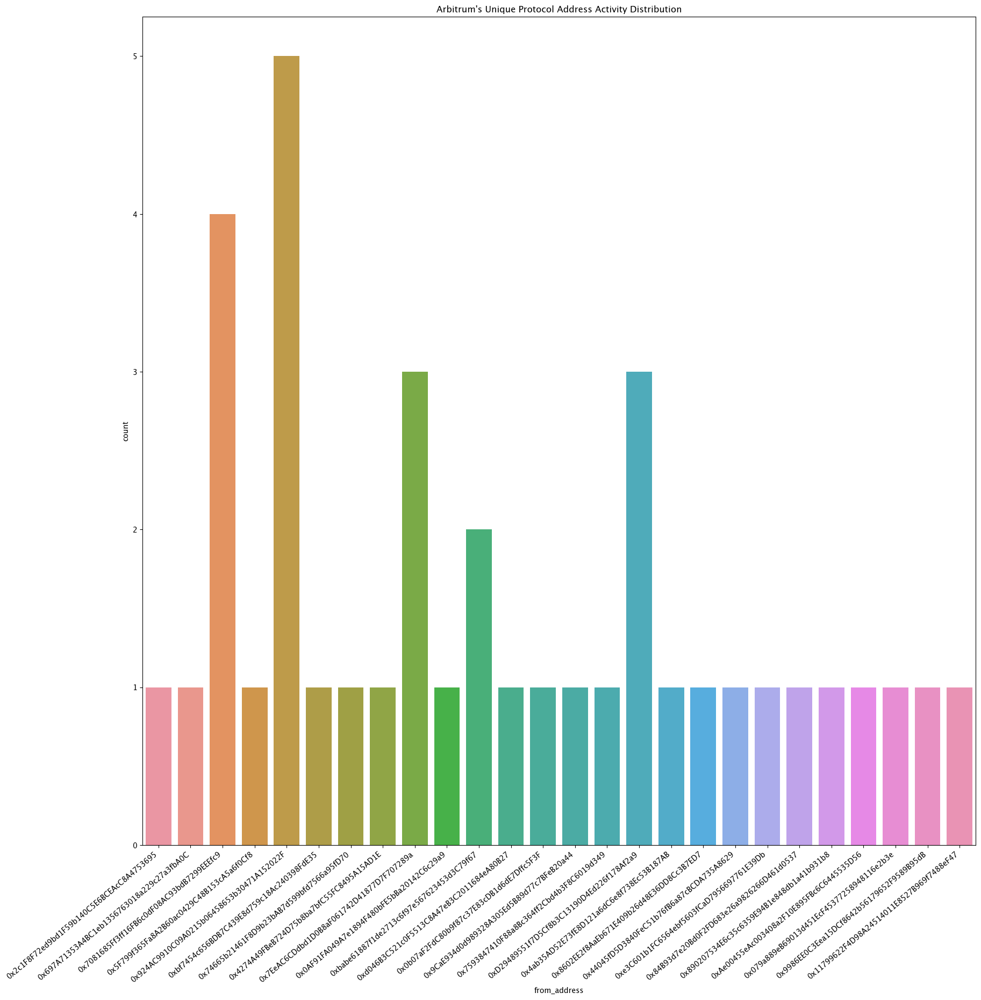

In [47]:
#Arbitrum Protocols address distribution
plt.figure(3,figsize=(20,20))
sns.countplot(x='from_address',data=arb_protocols)
plt.title('Arbitrum\'s Unique Protocol Address Activity Distribution')
plt.xticks(rotation=40, ha="right")

## Total gas used per day (Gwei)

In [48]:
poly_gas = poly.groupby(poly['timestamp']).agg({'sum'})
poly_gasprice = poly.groupby(poly['timestamp']).mean()

/var/folders/g7/mcmk35wn7ls9x6nxdg8_xhlh0000gn/T/ipykernel_90124/2540087984.py:2: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



In [49]:
poly_gas[('gas_used_gwei', 'sum')] = poly_gas[('gas_used', 'sum')]*poly_gasprice['gas_price']/1e9 #gas used convert to gas used in units to gas used in gwei

In [50]:
arb_gas = all_arb[['timestamp','gas_price','gas_used']]

In [51]:
#Not using group by function for the entire DataFrame because it takes too long to run
#Find average gas price per day
arb_avggasprice = arb_gas.groupby(arb_gas['timestamp']).mean()

#Find sum of gas used per day
arb_gasused = arb_gas.groupby(arb_gas['timestamp']).agg({'sum'})

In [52]:
arb_avggasprice

,gas_price,gas_used
timestamp,,
2021-08-20,3.344276e+08,2.121261e+06
2021-08-21,3.826471e+08,2.159034e+06
2021-08-22,3.600977e+08,1.261750e+06
2021-08-23,4.057217e+08,3.815590e+06
2021-08-24,5.525785e+08,3.332411e+06
...,...,...
2021-12-04,1.132970e+09,1.163610e+06
2021-12-05,9.770934e+08,1.093538e+06
2021-12-06,9.752700e+08,1.171111e+06


In [53]:
arb_gasused

,gas_price,gas_used
,sum,sum
timestamp,,
2021-08-20,118052946276,748805199
2021-08-21,103697351698,585098330
2021-08-22,96146079087,336887278
2021-08-23,97778932087,919557259
2021-08-24,408908109097,2465983806
...,...,...
2021-12-04,34328982632071,35257392760
2021-12-05,26878863466132,30082140088


In [54]:
arb_gasused[('gas_used_gwei', 'sum')] = arb_gasused[('gas_used', 'sum')]*arb_avggasprice['gas_price']/1e9 #gas used convert to gas used in units to gas used in gwei

In [55]:
arb_gasused.index = pd.to_datetime(arb_gasused.index)

In [56]:
arb_gasused

,gas_price,gas_used,gas_used_gwei
,sum,sum,sum
timestamp,,,
2021-08-20,118052946276,748805199,2.504211e+08
2021-08-21,103697351698,585098330,2.238862e+08
2021-08-22,96146079087,336887278,1.213123e+08
2021-08-23,97778932087,919557259,3.730843e+08
2021-08-24,408908109097,2465983806,1.362650e+09
...,...,...,...
2021-12-04,34328982632071,35257392760,3.994556e+10
2021-12-05,26878863466132,30082140088,2.939306e+10


In [57]:
polygasused_min_max_scaled = poly_gas.copy()
column=('gas_used_gwei','sum')
polygasused_min_max_scaled[column] = (polygasused_min_max_scaled[column] - polygasused_min_max_scaled[column].min()) / (polygasused_min_max_scaled[column].max() - polygasused_min_max_scaled[column].min())

In [58]:
arbgasused_min_max_scaled = arb_gasused.copy()
column=('gas_used_gwei','sum')
arbgasused_min_max_scaled[column] = (arbgasused_min_max_scaled[column] - arbgasused_min_max_scaled[column].min()) / (arbgasused_min_max_scaled[column].max() - arbgasused_min_max_scaled[column].min())

In [59]:
arbgasused_min_max_scaled

,gas_price,gas_used,gas_used_gwei
,sum,sum,sum
timestamp,,,
2021-08-20,118052946276,748805199,0.000086
2021-08-21,103697351698,585098330,0.000068
2021-08-22,96146079087,336887278,0.000000
2021-08-23,97778932087,919557259,0.000168
2021-08-24,408908109097,2465983806,0.000827
...,...,...,...
2021-12-04,34328982632071,35257392760,0.026546
2021-12-05,26878863466132,30082140088,0.019512


In [60]:
arbgasused_min_max_scaled = arbgasused_min_max_scaled.reset_index(drop=True)

In [61]:
polygasused_min_max_scaled = polygasused_min_max_scaled.reset_index(drop=True)

In [62]:
polygasused_min_max_scaled[column]

0     0.001505
1     0.000005
2     0.000042
3     0.000002
4     0.000405
        ...   
78    0.041530
79    0.101886
80    0.055825
81    0.084593
82    0.266280
Name: (gas_used_gwei, sum), Length: 83, dtype: float64

Text(12, 0.2, 'Arbitrum launch')

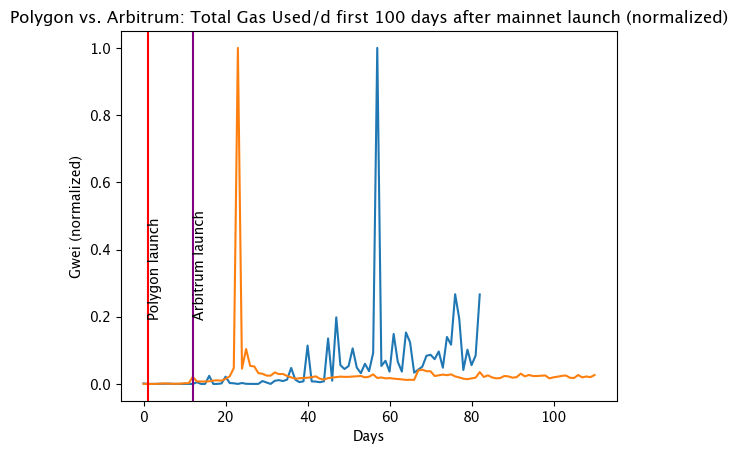

In [63]:
#Plot total gas used (Arbitrum vs. Polygon) (normalized)
#Arbitrum launched: 8/31/2021 
#Polygon launched: 5/31/2020 
plt.figure(4)
plt.plot(polygasused_min_max_scaled[('gas_used_gwei','sum')])
plt.plot(arbgasused_min_max_scaled[('gas_used_gwei','sum')])
plt.xlabel('Days')
plt.ylabel('Gwei (normalized)')
plt.title('Polygon vs. Arbitrum: Total Gas Used/d first 100 days after mainnet launch (normalized)') 
plt.axvline(1,c='red') 
plt.axvline(12,c='purple') 
plt.text(1,0.2,'Polygon launch',rotation=90) 
plt.text(12,0.2,'Arbitrum launch',rotation=90)

(array([18414., 18428., 18444., 18458., 18475., 18489., 18506.]),
 [Text(18414.0, 0, '2020-06-01'),
  Text(18428.0, 0, '2020-06-15'),
  Text(18444.0, 0, '2020-07-01'),
  Text(18458.0, 0, '2020-07-15'),
  Text(18475.0, 0, '2020-08-01'),
  Text(18489.0, 0, '2020-08-15'),
  Text(18506.0, 0, '2020-09-01')])

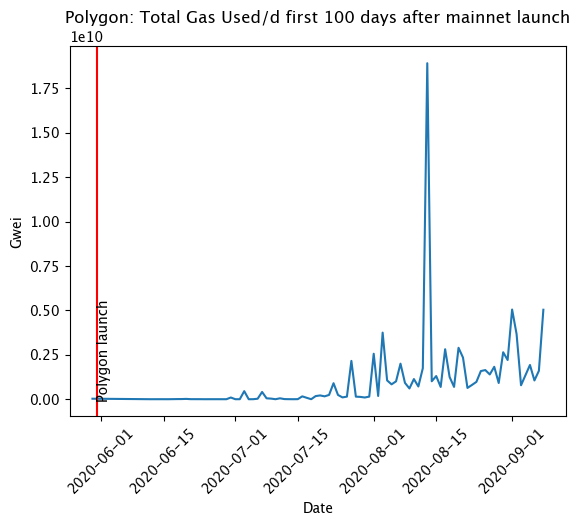

In [64]:
plt.figure(5)
plt.title('Polygon: Total Gas Used/d first 100 days after mainnet launch') 
plt.plot(poly_gas.index,poly_gas[('gas_used_gwei', 'sum')])
plt.axvline(datetime.datetime(2020, 5, 31),c='red')
plt.text(datetime.datetime(2020, 5, 31),0,'Polygon launch',rotation=90)
plt.xlabel('Date')
plt.ylabel('Gwei')
plt.xticks(rotation=45)

(array([18854., 18871., 18885., 18901., 18915., 18932., 18946., 18962.]),
 [Text(18854.0, 0, '2021-08-15'),
  Text(18871.0, 0, '2021-09-01'),
  Text(18885.0, 0, '2021-09-15'),
  Text(18901.0, 0, '2021-10-01'),
  Text(18915.0, 0, '2021-10-15'),
  Text(18932.0, 0, '2021-11-01'),
  Text(18946.0, 0, '2021-11-15'),
  Text(18962.0, 0, '2021-12-01')])

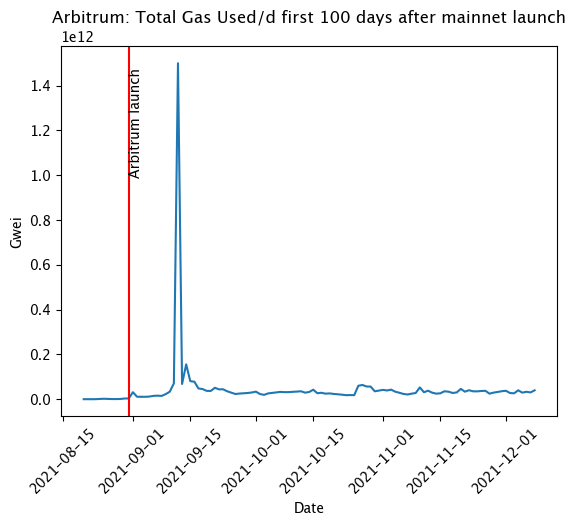

In [65]:
plt.figure(6)
plt.title('Arbitrum: Total Gas Used/d first 100 days after mainnet launch') 
plt.plot(arb_gasused.index,arb_gasused[('gas_used_gwei', 'sum')])
plt.axvline(datetime.datetime(2021, 8, 31),c='red')
plt.text(datetime.datetime(2021, 8, 31),1e12,'Arbitrum launch',rotation=90)
plt.xlabel('Date')
plt.ylabel('Gwei')
plt.xticks(rotation=45)

## Gas price every day (Gwei)

In [84]:
def create_gasprice_df(chain):
    try:
        temp_gasprice = chain.groupby(chain['timestamp']).mean()
    except:
        temp_gasprice = chain.groupby(chain['block_time']).mean()
    temp_gasprice['gas_price_gwei'] = temp_gasprice['gas_price'].map(lambda x: x/1e9) #convert wei to gwei per gas unit
    temp_gasprice = temp_gasprice.reset_index()
    #temp_gasprice['block_time'] = temp_gasprice['block_time'].map(clean_timestamp_dune)
    return temp_gasprice
    
def plot_gasprice(gasprice_df,chain_name,launch_date):
    plt.figure()
    plt.plot(gasprice_df['block_time'],gasprice_df['gas_price_gwei'])
    plt.title(f"{chain_name}: Gas Price first 100 days after mainnet launch")
    plt.axvline(launch_date,c='red')
    plt.ylabel('Gwei')
    plt.xlabel('Date')
    plt.xticks(rotation=40)
    
    
    

In [66]:
#Average gas price per day
poly_gasprice = poly.groupby(poly['timestamp']).mean()
poly_gasprice['gas_price_gwei'] = poly_gasprice['gas_price'].map(lambda x: x/1e9) #convert wei to gwei per gas unit

/var/folders/g7/mcmk35wn7ls9x6nxdg8_xhlh0000gn/T/ipykernel_90124/1279863427.py:2: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



In [67]:
max(poly_gasprice['gas_price_gwei'])

45.0

Text(0, 0.5, 'Gwei')

<Figure size 640x480 with 0 Axes>

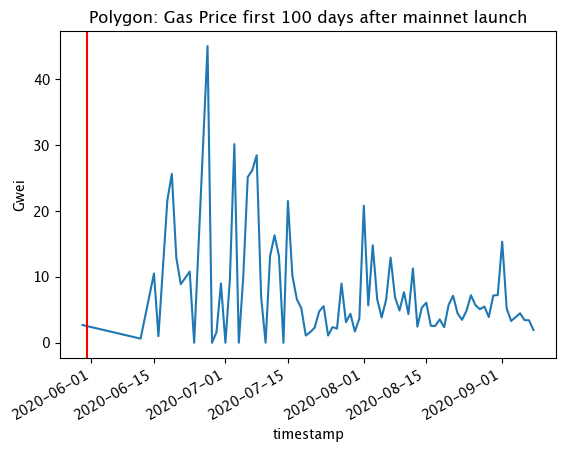

In [68]:
plt.figure(7)
poly_gasprice.plot(y=('gas_price_gwei'),legend=None)
plt.title('Polygon: Gas Price first 100 days after mainnet launch')
plt.axvline(datetime.datetime(2020, 5, 31),c='red')
plt.ylabel('Gwei')

In [69]:
#Average gas price per day
arb_gasprice = all_arb[['gas_limit','gas_used','gas_price']].groupby(all_arb['timestamp']).mean()
arb_gasprice['gas_price_gwei'] = arb_gasprice['gas_price'].map(lambda x: x/1e9) #convert wei to gwei per gas unit

In [70]:
max(arb_gasprice['gas_price_gwei'])

7.295112152469643

In [71]:
arb_gasprice = arb_gasprice.reset_index()
arb_gasprice

,timestamp,gas_limit,gas_used,gas_price,gas_price_gwei
0,2021-08-20,8.987710e+06,2.121261e+06,3.344276e+08,0.334428
1,2021-08-21,5.053819e+06,2.159034e+06,3.826471e+08,0.382647
2,2021-08-22,4.130532e+06,1.261750e+06,3.600977e+08,0.360098
3,2021-08-23,7.043517e+06,3.815590e+06,4.057217e+08,0.405722
4,2021-08-24,8.030825e+06,3.332411e+06,5.525785e+08,0.552579
...,...,...,...,...,...
106,2021-12-04,2.661707e+06,1.163610e+06,1.132970e+09,1.132970
107,2021-12-05,2.390121e+06,1.093538e+06,9.770934e+08,0.977093
108,2021-12-06,2.508133e+06,1.171111e+06,9.752700e+08,0.975270
109,2021-12-07,2.486712e+06,1.244659e+06,9.261067e+08,0.926107


In [72]:
arb_gasprice['timestamp'] = pd.to_datetime(arb_gasprice['timestamp'], format="%Y-%m-%d")

(array([18854., 18871., 18885., 18901., 18915., 18932., 18946., 18962.]),
 [Text(18854.0, 0, '2021-08-15'),
  Text(18871.0, 0, '2021-09-01'),
  Text(18885.0, 0, '2021-09-15'),
  Text(18901.0, 0, '2021-10-01'),
  Text(18915.0, 0, '2021-10-15'),
  Text(18932.0, 0, '2021-11-01'),
  Text(18946.0, 0, '2021-11-15'),
  Text(18962.0, 0, '2021-12-01')])

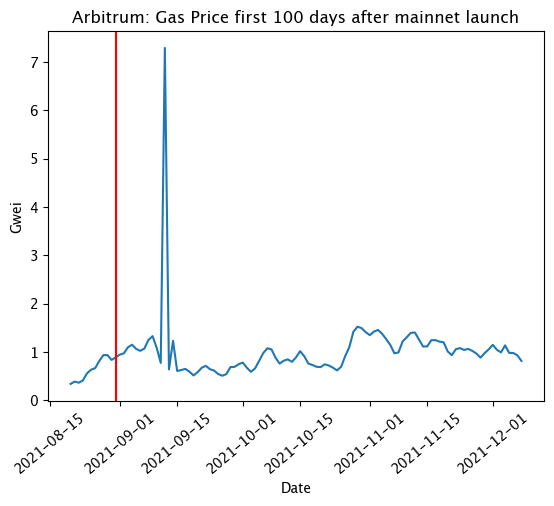

In [73]:
plt.figure(8)
plt.plot(arb_gasprice['timestamp'],arb_gasprice['gas_price_gwei'])
plt.title('Arbitrum: Gas Price first 100 days after mainnet launch')
plt.axvline(datetime.datetime(2021, 8, 31),c='red')
plt.xlabel('Date')
plt.ylabel('Gwei')
plt.xticks(rotation=40)

In [81]:
'''zksync_gasprice = all_zksync.groupby(all_zksync['block_time']).mean()
#zksync_gasprice.index = zksync_gasprice.index.map(lambda x: datetime.datetime.strptime(x,'%Y-%m-%d'))
zksync_gasprice = zksync_gasprice[zksync_gasprice.index<datetime.datetime(2023,7,3)]
zksync_gasprice['gas_price_gwei'] = zksync_gasprice['gas_price'].map(lambda x: x/1e9)'''

"zksync_gasprice = all_zksync.groupby(all_zksync['block_time']).mean()\n#zksync_gasprice.index = zksync_gasprice.index.map(lambda x: datetime.datetime.strptime(x,'%Y-%m-%d'))\nzksync_gasprice = zksync_gasprice[zksync_gasprice.index<datetime.datetime(2023,7,3)]\nzksync_gasprice['gas_price_gwei'] = zksync_gasprice['gas_price'].map(lambda x: x/1e9)"

In [82]:
'''plt.figure()
plt.plot(zksync_gasprice.index,zksync_gasprice['gas_price_gwei'])
plt.title('zkSync Era: Gas Price first 100 days after mainnet launch')
plt.axvline(datetime.datetime(2023, 3, 24),c='red')
plt.ylabel('Gwei')
plt.xticks(rotation=40)'''

"plt.figure()\nplt.plot(zksync_gasprice.index,zksync_gasprice['gas_price_gwei'])\nplt.title('zkSync Era: Gas Price first 100 days after mainnet launch')\nplt.axvline(datetime.datetime(2023, 3, 24),c='red')\nplt.ylabel('Gwei')\nplt.xticks(rotation=40)"

In [85]:
zksync_gasprice = create_gasprice_df(all_zksync)

/var/folders/g7/mcmk35wn7ls9x6nxdg8_xhlh0000gn/T/ipykernel_90124/1980038428.py:5: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



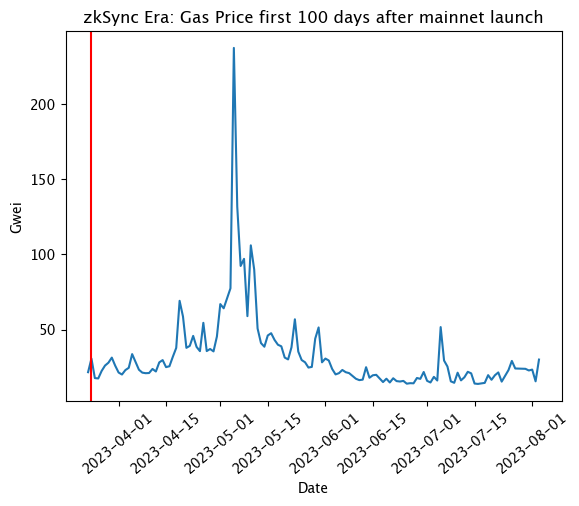

In [87]:
plot_gasprice(zksync_gasprice,'zkSync Era',datetime.datetime(2023,3,24))

In [273]:
gasprice_op = create_gasprice_df(all_op)
gasprice_op

/var/folders/g7/mcmk35wn7ls9x6nxdg8_xhlh0000gn/T/ipykernel_90124/1980038428.py:5: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



,block_time,block_number,gas_limit,gas_price,gas_used,max_fee_per_gas,max_priority_fee_per_gas,priority_fee_per_gas,nonce,index,success,access_list,l1_gas_used,l1_gas_price,l1_fee,l1_fee_scalar,l1_block_number,l1_timestamp,gas_price_gwei
0,2021-12-16,1.246995e+06,8.207996e+05,7.597126e+07,303009.587609,NaN,NaN,NaN,170516.545701,0.0,0.940587,NaN,5548.018054,9.760098e+10,7.988938e+14,1.5000,1.381619e+07,1.639658e+09,0.075971
1,2021-12-17,1.279677e+06,7.011338e+05,4.684280e+07,283306.164928,NaN,NaN,NaN,200208.833389,0.0,0.950121,NaN,5494.858673,8.723978e+10,7.047118e+14,1.5000,1.382295e+07,1.639748e+09,0.046843
2,2021-12-18,1.314381e+06,6.341661e+05,3.846164e+07,234373.010880,NaN,NaN,NaN,194732.084511,0.0,0.944573,NaN,5665.720908,6.326166e+10,5.285393e+14,1.5000,1.382849e+07,1.639822e+09,0.038462
3,2021-12-19,1.348310e+06,6.255525e+05,4.781058e+07,271213.142367,NaN,NaN,NaN,164469.228127,0.0,0.950862,NaN,5873.541496,5.002677e+10,4.405205e+14,1.5000,1.383534e+07,1.639914e+09,0.047811
4,2021-12-20,1.383161e+06,7.763841e+05,3.586184e+07,282269.505696,NaN,NaN,NaN,198856.699186,0.0,0.952919,NaN,5726.191977,6.049885e+10,5.194258e+14,1.5000,1.384175e+07,1.639999e+09,0.035862
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
107,2022-04-02,5.234597e+06,6.506735e+06,2.021678e+07,596337.939134,NaN,NaN,NaN,22745.220998,0.0,0.976768,NaN,6141.814105,5.306920e+10,4.031804e+14,1.2400,1.450663e+07,1.648902e+09,0.020217
108,2022-04-03,5.278105e+06,6.826041e+06,1.185352e+07,578048.319387,NaN,NaN,NaN,23859.790483,0.0,0.983105,NaN,6243.224013,4.791952e+10,3.696656e+14,1.2400,1.451289e+07,1.648986e+09,0.011854
109,2022-04-04,5.319408e+06,7.009547e+06,6.669830e+06,621051.574387,NaN,NaN,NaN,23333.972438,0.0,0.983308,NaN,6211.819791,6.272002e+10,4.790061e+14,1.2400,1.451942e+07,1.649075e+09,0.006670
110,2022-04-05,5.359162e+06,7.469948e+06,8.998002e+06,640169.054180,NaN,NaN,NaN,25974.616352,0.0,0.985073,NaN,6277.776345,1.102868e+11,7.547595e+14,1.1817,1.452601e+07,1.649163e+09,0.008998


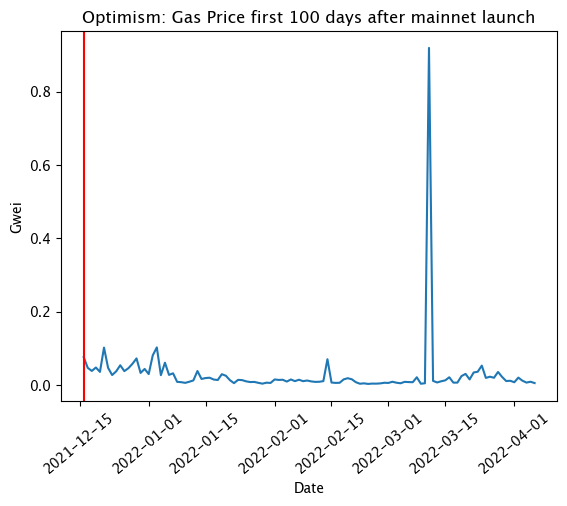

In [274]:
plot_gasprice(gasprice_op,'Optimism',datetime.datetime(2021,12,16))

In [285]:
gasprice_op.sort_values(by='gas_price_gwei',ascending=False)

,block_time,block_number,gas_limit,gas_price,gas_used,max_fee_per_gas,max_priority_fee_per_gas,priority_fee_per_gas,nonce,index,success,access_list,l1_gas_used,l1_gas_price,l1_fee,l1_fee_scalar,l1_block_number,l1_timestamp,gas_price_gwei
85,2022-03-11,4359793.5,7.300914e+06,9.196081e+08,6.591678e+05,NaN,NaN,NaN,23771.102246,0.0,0.987048,NaN,6253.932499,2.678465e+10,2.070815e+14,1.24,1.436513e+07,1.646997e+09,0.919608
18,2022-01-03,1877520.5,7.919141e+05,1.026894e+08,2.830609e+05,NaN,NaN,NaN,235894.592902,0.0,0.953406,NaN,5424.523297,1.035747e+11,8.369213e+14,1.50,1.393275e+07,1.641216e+09,0.102689
5,2021-12-21,1413306.5,7.328198e+05,1.021606e+08,2.827690e+05,NaN,NaN,NaN,182451.540806,0.0,0.935961,NaN,5518.814692,6.167422e+10,5.066208e+14,1.50,1.384827e+07,1.640086e+09,0.102161
17,2022-01-02,1847943.0,8.600668e+05,8.095244e+07,3.099444e+05,NaN,NaN,NaN,198586.875986,0.0,0.938757,NaN,5513.398885,9.896918e+10,8.029012e+14,1.50,1.392610e+07,1.641127e+09,0.080952
0,2021-12-16,1246995.0,8.207996e+05,7.597126e+07,3.030096e+05,NaN,NaN,NaN,170516.545701,0.0,0.940587,NaN,5548.018054,9.760098e+10,7.988938e+14,1.50,1.381619e+07,1.639658e+09,0.075971
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
72,2022-02-26,3916831.5,7.565772e+06,3.789842e+06,1.955673e+06,NaN,NaN,NaN,18940.619122,0.0,0.974316,NaN,6156.786427,4.249642e+10,3.244944e+14,1.24,1.428133e+07,1.645874e+09,0.003790
44,2022-01-29,2981249.5,3.318475e+06,3.776555e+06,9.878729e+05,NaN,NaN,NaN,205199.152589,0.0,0.956731,NaN,5060.614628,1.089175e+11,6.829476e+14,1.24,1.410076e+07,1.643461e+09,0.003777
68,2022-02-22,3756590.5,8.248356e+06,3.554756e+06,2.259448e+06,NaN,NaN,NaN,22070.153043,0.0,0.984903,NaN,6245.292350,7.911787e+10,6.147507e+14,1.24,1.425554e+07,1.645529e+09,0.003555
83,2022-03-09,4278208.0,6.456095e+06,3.550699e+06,6.766538e+05,NaN,NaN,NaN,21771.781413,0.0,0.985901,NaN,6110.227221,3.455761e+10,2.635047e+14,1.24,1.435231e+07,1.646826e+09,0.003551


## Unique Addresses per day

In [76]:
'''path = 'Chains Data/arbitrum txs/arb_txs_full'
filenames = glob.glob(path + "/*.csv")

dfs = []
for filename in filenames:
    dfs.append(pd.read_csv(filename))

# Concatenate all data into one DataFrame
all_arb = pd.concat(dfs, ignore_index=True)

#sort by date and time
all_arb = all_arb.sort_values(by=['timestamp'])

#remove duplicate transactions
all_arb = all_arb.drop_duplicates(subset=['transaction_hash'], keep='first')

all_arb.iloc[0]['timestamp'].split('T')[0]

def create_date_column(t):
    return t.split('T')[0]

all_arb['date'] = all_arb['timestamp'].map(create_date_column)'''

'path = \'Chains Data/arbitrum txs/arb_txs_full\'\nfilenames = glob.glob(path + "/*.csv")\n\ndfs = []\nfor filename in filenames:\n    dfs.append(pd.read_csv(filename))\n\n# Concatenate all data into one DataFrame\nall_arb = pd.concat(dfs, ignore_index=True)\n\n#sort by date and time\nall_arb = all_arb.sort_values(by=[\'timestamp\'])\n\n#remove duplicate transactions\nall_arb = all_arb.drop_duplicates(subset=[\'transaction_hash\'], keep=\'first\')\n\nall_arb.iloc[0][\'timestamp\'].split(\'T\')[0]\n\ndef create_date_column(t):\n    return t.split(\'T\')[0]\n\nall_arb[\'date\'] = all_arb[\'timestamp\'].map(create_date_column)'

In [77]:
#Count number of transactions per unique from_address
dates = np.unique([d for d in all_arb['timestamp']])

In [78]:
'''unique_addresses = {}

for d in dates:
    temp = all_arb[all_arb['timestamp']==d]
    n_unique = temp['from_address'].nunique()
    unique_addresses[d] = n_unique
    
df_temp = pd.DataFrame.from_dict({'dates':unique_addresses.keys(),
                                 'counts':unique_addresses.values()})

df_temp.to_csv('Chains Data/arbitrum txs/unique_addresses.csv')'''
uniqueaddresses_arb = pd.read_csv('Chains Data/arbitrum txs/unique_addresses.csv').drop('Unnamed: 0',axis=1)

In [79]:
dates = list(map(lambda x: datetime.datetime.strptime(x,"%Y-%m-%d"),uniqueaddresses_arb['dates']))

In [136]:
#Plot
plt.figure(6,figsize=(20,10))
# data  where the index is the date
fig = px.line(uniqueaddresses_arb, x=uniqueaddresses_arb['dates'], y=uniqueaddresses_arb['counts'],
             labels={
                 'dates': 'Date',
                 'counts': 'Number of unique addresses each day'
             }, title='Arbitrum - Unique Addresses/d')

# Show plot 
fig.update_layout(xaxis_rangeslider_visible=True)
fig.add_vline(x=datetime.datetime(2021, 8, 31),line_width=3, line_dash="solid", line_color="red")
fig.show()

'''ax.plot(dates, list(unique_addresses.values()))
plt.axvline(datetime.datetime(2021, 8, 31),c='red')
ax.xaxis.set_major_locator(mdates.MonthLocator(bymonth=range(1,12)))
plt.setp(ax.get_xticklabels(), rotation=0)'''

"ax.plot(dates, list(unique_addresses.values()))\nplt.axvline(datetime.datetime(2021, 8, 31),c='red')\nax.xaxis.set_major_locator(mdates.MonthLocator(bymonth=range(1,12)))\nplt.setp(ax.get_xticklabels(), rotation=0)"

<Figure size 2000x1000 with 0 Axes>

Now to do the same for Polygon data:

In [137]:
def year_month_day(t):
    return f"{t.year}-{t.month}-{t.day}"

poly['date'] = poly['timestamp'].map(year_month_day)

In [138]:
#Count number of transactions per unique from_address
dates = np.unique([d for d in poly['timestamp']])

In [139]:
poly_uniqueaddresses = {}

for d in dates:
    temp = poly[poly['timestamp']==d]
    n_unique = temp['from_address'].nunique()
    poly_uniqueaddresses[d] = n_unique

In [140]:
poly_uniqueaddresses

{Timestamp('2020-05-30 00:00:00'): 2,
 Timestamp('2020-06-12 00:00:00'): 2,
 Timestamp('2020-06-15 00:00:00'): 2,
 Timestamp('2020-06-16 00:00:00'): 1,
 Timestamp('2020-06-18 00:00:00'): 3,
 Timestamp('2020-06-19 00:00:00'): 4,
 Timestamp('2020-06-20 00:00:00'): 10,
 Timestamp('2020-06-21 00:00:00'): 4,
 Timestamp('2020-06-23 00:00:00'): 2,
 Timestamp('2020-06-24 00:00:00'): 0,
 Timestamp('2020-06-27 00:00:00'): 1,
 Timestamp('2020-06-28 00:00:00'): 0,
 Timestamp('2020-06-29 00:00:00'): 1,
 Timestamp('2020-06-30 00:00:00'): 3,
 Timestamp('2020-07-01 00:00:00'): 0,
 Timestamp('2020-07-02 00:00:00'): 2,
 Timestamp('2020-07-03 00:00:00'): 5,
 Timestamp('2020-07-04 00:00:00'): 0,
 Timestamp('2020-07-05 00:00:00'): 1,
 Timestamp('2020-07-06 00:00:00'): 2,
 Timestamp('2020-07-07 00:00:00'): 4,
 Timestamp('2020-07-08 00:00:00'): 3,
 Timestamp('2020-07-09 00:00:00'): 4,
 Timestamp('2020-07-10 00:00:00'): 0,
 Timestamp('2020-07-11 00:00:00'): 9,
 Timestamp('2020-07-12 00:00:00'): 6,
 Timestamp(

In [141]:
#Plot
plt.figure(7,figsize=(20,10))
# data  where the index is the date
uniqueaddresses_poly = pd.DataFrame.from_dict({'dates':poly_uniqueaddresses.keys(),
                                 'counts':poly_uniqueaddresses.values()})

<Figure size 2000x1000 with 0 Axes>

In [142]:
fig = px.line(uniqueaddresses_poly, x=uniqueaddresses_poly['dates'], y=uniqueaddresses_poly['counts'],
             labels={
                 'dates': 'Date',
                 'counts': 'Number of unique addresses each day'
             }, title='Polygon - Unique Addresses/d')

# Show plot 
fig.update_layout(xaxis_rangeslider_visible=True)
fig.add_vline(x=datetime.datetime(2020, 5, 31),line_width=3, line_dash="solid", line_color="red")
fig.show()

In [153]:
zksync_uniqueaddresses = {}
dates = list(map(lambda x: datetime.datetime.strptime(x,"%Y-%m-%d"),all_zksync['block_time']))
dates = sorted(list(set(dates)))

In [154]:
dates

[datetime.datetime(2023, 3, 23, 0, 0),
 datetime.datetime(2023, 3, 24, 0, 0),
 datetime.datetime(2023, 3, 25, 0, 0),
 datetime.datetime(2023, 3, 26, 0, 0),
 datetime.datetime(2023, 3, 27, 0, 0),
 datetime.datetime(2023, 3, 28, 0, 0),
 datetime.datetime(2023, 3, 29, 0, 0),
 datetime.datetime(2023, 3, 30, 0, 0),
 datetime.datetime(2023, 3, 31, 0, 0),
 datetime.datetime(2023, 4, 1, 0, 0),
 datetime.datetime(2023, 4, 2, 0, 0),
 datetime.datetime(2023, 4, 3, 0, 0),
 datetime.datetime(2023, 4, 4, 0, 0),
 datetime.datetime(2023, 4, 5, 0, 0),
 datetime.datetime(2023, 4, 6, 0, 0),
 datetime.datetime(2023, 4, 7, 0, 0),
 datetime.datetime(2023, 4, 8, 0, 0),
 datetime.datetime(2023, 4, 9, 0, 0),
 datetime.datetime(2023, 4, 10, 0, 0),
 datetime.datetime(2023, 4, 11, 0, 0),
 datetime.datetime(2023, 4, 12, 0, 0),
 datetime.datetime(2023, 4, 13, 0, 0),
 datetime.datetime(2023, 4, 14, 0, 0),
 datetime.datetime(2023, 4, 15, 0, 0),
 datetime.datetime(2023, 4, 16, 0, 0),
 datetime.datetime(2023, 4, 17, 0,

In [173]:
for d in dates:
    temp = all_zksync[all_zksync['block_time']==d]
    n_unique = temp['from'].nunique()
    zksync_uniqueaddresses[d] = n_unique

In [174]:
all_zksync[all_zksync['block_time']==datetime.datetime(2023, 4, 1, 0, 0)]

,block_time,block_number,value,gas_limit,gas_price,gas_used,max_fee_per_gas,max_priority_fee_per_gas,priority_fee_per_gas,nonce,index,success,from,to,block_hash,data,hash,type,access_list
228268,2023-04-01,16950603.0,10472184988276224,125068.0,2.346581e+10,118722,3.028698e+10,1.500000e+09,1.500000e+09,3,109,True,0x4b6bb16e0ab4d154f3c9383fadfbdfe7e3bef4bc,0x32400084c286cf3e17e7b677ea9583e60a000324,0xe8ab44dccc80ce1c836cbab03f33243c75085e031e25...,0xeb6724190000000000000000000000004b6bb16e0ab4...,0xb8adffca9a73c8ebff8d91153ef6a5645f1ef897050d...,DynamicFee,NaN
228269,2023-04-01,16950603.0,271472184988276224,137601.0,2.243748e+10,118746,3.952833e+10,4.716680e+08,4.716680e+08,129,222,True,0x61cb99a82529f738169aed7171c5c67ccccd0366,0x32400084c286cf3e17e7b677ea9583e60a000324,0xe8ab44dccc80ce1c836cbab03f33243c75085e031e25...,0xeb67241900000000000000000000000061cb99a82529...,0x86933ea5b5b351f55fbe78cff3fb5dd1ed342f501090...,DynamicFee,NaN
228270,2023-04-01,16950607.0,24857965185339744,125079.0,2.306544e+10,118722,5.503178e+10,1.500000e+09,1.500000e+09,2,122,True,0x08c212da50e5758c2551a71cdacd2d99f528a070,0x32400084c286cf3e17e7b677ea9583e60a000324,0x4d3c834264d0bd534ed21e72179f2b200351a905eedb...,0xeb67241900000000000000000000000008c212da50e5...,0x05ecc46f1b6cec62bed471f841bcba152c404c09753e...,DynamicFee,NaN
228271,2023-04-01,16950607.0,30480066129486112,125068.0,2.166544e+10,118722,2.646325e+10,1.000000e+08,1.000000e+08,22,182,True,0x3ca1a1e02d3b8f44d2df99ccd6eca8d748959119,0x32400084c286cf3e17e7b677ea9583e60a000324,0x4d3c834264d0bd534ed21e72179f2b200351a905eedb...,0xeb6724190000000000000000000000003ca1a1e02d3b...,0x00bb7acaa7aa165f62a740d2a63f3eea1c9ab59c95f3...,DynamicFee,NaN
228272,2023-04-01,16950607.0,37569503482692288,125091.0,2.306544e+10,118734,3.652921e+10,1.500000e+09,1.500000e+09,9,110,True,0x69b602607252a519c2f72cbc2c261fe7f25113c2,0x32400084c286cf3e17e7b677ea9583e60a000324,0x4d3c834264d0bd534ed21e72179f2b200351a905eedb...,0xeb67241900000000000000000000000069b602607252...,0x21771b6148495a39e8382228cfb0801f5cb47b4b8069...,DynamicFee,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
257023,2023-04-01,16957715.0,16907617030229858,125080.0,1.836151e+10,118734,2.424074e+10,1.500000e+09,1.500000e+09,5,49,True,0xa4fb57ea0d39b37f72c1df3db7326637ede58e10,0x32400084c286cf3e17e7b677ea9583e60a000324,0xbd1c725c90305ee970a28c85294385d09f87603c6cfb...,0xeb672419000000000000000000000000a4fb57ea0d39...,0x192e46848ea74b0dcbdf2f277f642e4d583a7e8c3583...,DynamicFee,NaN
257024,2023-04-01,16957715.0,103691097624259136,125092.0,1.696151e+10,118746,1.700000e+10,1.000000e+08,1.000000e+08,10,124,True,0xe87f2f9493d61591b2c6085bd33361b69a3471d3,0x32400084c286cf3e17e7b677ea9583e60a000324,0xbd1c725c90305ee970a28c85294385d09f87603c6cfb...,0xeb672419000000000000000000000000e87f2f9493d6...,0x48a03f44318a6df0d71e3e10dbd63f7e47b4c0f0dbc5...,DynamicFee,NaN
257025,2023-04-01,16957715.0,10376892096877984,125068.0,1.836151e+10,118722,2.417469e+10,1.500000e+09,1.500000e+09,73,46,True,0xa5ad9a385ed3d0361fc2c156b5b59519ee0dd7db,0x32400084c286cf3e17e7b677ea9583e60a000324,0xbd1c725c90305ee970a28c85294385d09f87603c6cfb...,0xeb672419000000000000000000000000a5ad9a385ed3...,0xb112ecd3a10fd39759f6f0e7ef18f08f35f140ca652c...,DynamicFee,NaN
257026,2023-04-01,16957716.0,2177921861799072,125056.0,1.780550e+10,118710,1.800000e+10,1.500000e+09,1.500000e+09,30,78,True,0x5abcfb0f8ba3a46c19c83e3c1741be003a0c147a,0x32400084c286cf3e17e7b677ea9583e60a000324,0x69bcd1f7aee27aa9e10b05c7df5c711fef3333c602cc...,0xeb6724190000000000000000000000005abcfb0f8ba3...,0xc2509d366dff2ec7731b15a2d14745da41c87a0f07a8...,DynamicFee,NaN


In [175]:
zksync_uniqueaddresses

{datetime.datetime(2023, 3, 23, 0, 0): 13,
 datetime.datetime(2023, 3, 24, 0, 0): 14502,
 datetime.datetime(2023, 3, 25, 0, 0): 40933,
 datetime.datetime(2023, 3, 26, 0, 0): 41004,
 datetime.datetime(2023, 3, 27, 0, 0): 30584,
 datetime.datetime(2023, 3, 28, 0, 0): 23508,
 datetime.datetime(2023, 3, 29, 0, 0): 19871,
 datetime.datetime(2023, 3, 30, 0, 0): 15577,
 datetime.datetime(2023, 3, 31, 0, 0): 26643,
 datetime.datetime(2023, 4, 1, 0, 0): 27400,
 datetime.datetime(2023, 4, 2, 0, 0): 29472,
 datetime.datetime(2023, 4, 3, 0, 0): 21457,
 datetime.datetime(2023, 4, 4, 0, 0): 18603,
 datetime.datetime(2023, 4, 5, 0, 0): 10295,
 datetime.datetime(2023, 4, 6, 0, 0): 14501,
 datetime.datetime(2023, 4, 7, 0, 0): 19307,
 datetime.datetime(2023, 4, 8, 0, 0): 23138,
 datetime.datetime(2023, 4, 9, 0, 0): 12162,
 datetime.datetime(2023, 4, 10, 0, 0): 1419,
 datetime.datetime(2023, 4, 11, 0, 0): 2809,
 datetime.datetime(2023, 4, 12, 0, 0): 3611,
 datetime.datetime(2023, 4, 13, 0, 0): 755,
 date

In [176]:
uniqueaddresses_zksync = pd.DataFrame.from_dict({'dates':zksync_uniqueaddresses.keys(),
                                 'counts':zksync_uniqueaddresses.values()})

In [178]:
fig = px.line(uniqueaddresses_zksync, x=uniqueaddresses_zksync['dates'], y=uniqueaddresses_zksync['counts'],
             labels={
                 'dates': 'Date',
                 'counts': 'Number of unique addresses each day'
             }, title='zkSync Era - Unique Addresses/d')

# Show plot 
fig.update_layout(xaxis_rangeslider_visible=True)
fig.add_vline(x=datetime.datetime(2023, 3, 24),line_width=3, line_dash="solid", line_color="red")
fig.show()

## Address Activity Distribution

# Is there a correlation between gas price and transactions per day, ...?

In [88]:
zksync_txs

,block_number,value,gas_limit,gas_price,gas_used,max_fee_per_gas,max_priority_fee_per_gas,priority_fee_per_gas,nonce,index,success,from,to,block_hash,data,hash,type,access_list
,count,count,count,count,count,count,count,count,count,count,count,count,count,count,count,count,count,count
block_time,,,,,,,,,,,,,,,,,,
2023-03-23,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,0
2023-03-24,15754,15754,15754,15754,15754,15422,15422,15422,15754,15754,15754,15754,15754,15754,15754,15754,15754,0
2023-03-25,44853,44853,44853,44853,44853,44203,44203,44203,44853,44853,44853,44853,44853,44853,44853,44853,44853,0
2023-03-26,44400,44400,44400,44400,44400,43624,43624,43624,44400,44400,44400,44400,44400,44400,44400,44400,44400,0
2023-03-27,32706,32706,32706,32706,32706,32286,32286,32286,32706,32706,32706,32706,32706,32706,32706,32706,32706,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-07-30,25,25,25,25,25,25,25,25,25,25,25,25,25,25,25,25,25,0
2023-07-31,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,0


In [147]:
def create_corr_df(chain):
    temp_corr = pd.DataFrame(columns=['block_time','txs','gas_price','unique_addresses','contracts_deployed'])
    dates = np.unique([d for d in chain['block_time']])
    temp_corr['block_time'] = dates
    
    
    #txs
    temp_txs = chain.copy()
    temp_txs = temp_txs.groupby(temp_txs['block_time']).agg({'count'})
    temp_txs = temp_txs.reset_index()
    temp_corr['txs'] = temp_txs[('success','count')].to_list()
    
    #gas_price
    temp_corr['gas_price'] = create_gasprice_df(chain)['gas_price_gwei'].to_list()
    
    #unique addresses
    temp_uniqueaddresses = {}

    for d in dates:
        temp = chain[chain['block_time']==d]
        n_unique = temp['from'].nunique()
        temp_uniqueaddresses[d] = n_unique
        
    uniqueaddresses_temp = pd.DataFrame.from_dict({'block_time':temp_uniqueaddresses.keys(),
                                 'counts':temp_uniqueaddresses.values()})
    
    temp_corr['unique_addresses'] = uniqueaddresses_temp['counts'].to_list()
    
    #!!!number of contracts deployed - zkSync doesn't have chain data on Scroll officially
    
    return temp_corr
    
    

In [148]:
corr_zksync = create_corr_df(all_zksync)

/var/folders/g7/mcmk35wn7ls9x6nxdg8_xhlh0000gn/T/ipykernel_90124/1980038428.py:5: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



In [149]:
corr_zksync

,block_time,txs,gas_price,unique_addresses,contracts_deployed
0,2023-03-23,24,21.593253,13,NaN
1,2023-03-24,15754,30.666763,14502,NaN
2,2023-03-25,44853,17.655239,40933,NaN
3,2023-03-26,44400,17.426288,41004,NaN
4,2023-03-27,32706,22.413545,30584,NaN
...,...,...,...,...,...
96,2023-06-28,3616,17.726025,3533,NaN
97,2023-06-29,6492,17.163459,6341,NaN
98,2023-06-30,3877,21.721084,3792,NaN
99,2023-07-01,3001,15.827610,2927,NaN


In [281]:
def plot_txs_gasprice_corr(corr_df,chain_name):
    #Corr. between txs and gas price
    plt.figure()
    sns.lmplot(x='txs',y='gas_price',data=corr_df,scatter_kws={'color':'blue'},line_kws={'color': 'red'})
    plt.title(f"{chain_name}: Transactions vs. Gas Price (Gwei)")
    plt.xlabel('Transactions per day')
    plt.ylabel('Gas price (gwei)')
    corrcoef_temp = stats.pearsonr(corr_df['txs'], corr_df['gas_price'])
    plt.text(corr_df['txs'].iloc[corr_df['txs'].idxmax()], corr_df['gas_price'].iloc[corr_df['gas_price'].idxmax()], f"r={round(corrcoef_temp[0],2)}",ha='right', va='top')
    


<Figure size 640x480 with 0 Axes>

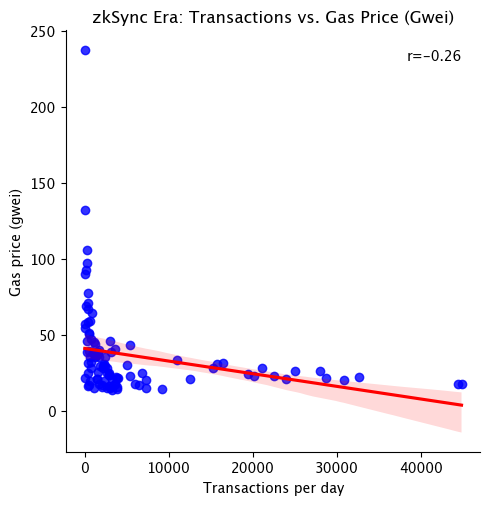

In [279]:
plot_txs_gasprice_corr(corr_zksync,'zkSync Era')

In [275]:
corr_op = create_corr_df(all_op)

/var/folders/g7/mcmk35wn7ls9x6nxdg8_xhlh0000gn/T/ipykernel_90124/1980038428.py:5: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



In [286]:
corr_op.sort_values(by='gas_price',ascending=False)

,block_time,txs,gas_price,unique_addresses,contracts_deployed
85,2022-03-11,37214,0.919608,2611,NaN
18,2022-01-03,34940,0.102689,1997,NaN
5,2021-12-21,25266,0.102161,2231,NaN
17,2022-01-02,24215,0.080952,1869,NaN
0,2021-12-16,29135,0.075971,2648,NaN
...,...,...,...,...,...
72,2022-02-26,27644,0.003790,1648,NaN
44,2022-01-29,30900,0.003777,1572,NaN
68,2022-02-22,29410,0.003555,1602,NaN
83,2022-03-09,37875,0.003551,2441,NaN


In [287]:
corr_op_woanom = corr_op[corr_op['block_time'] != datetime.datetime(2022,3,11)]

<Figure size 640x480 with 0 Axes>

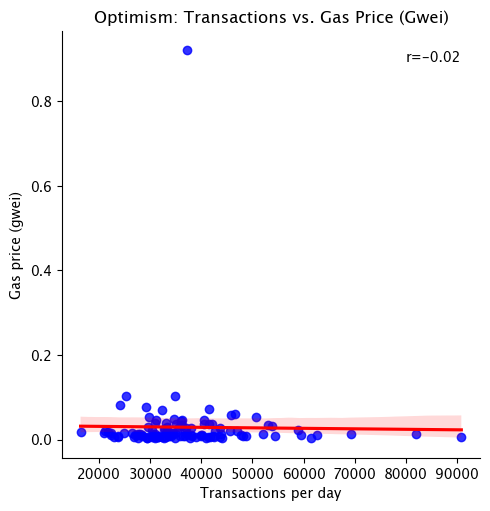

In [282]:
plot_txs_gasprice_corr(corr_op,'Optimism')

<Figure size 640x480 with 0 Axes>

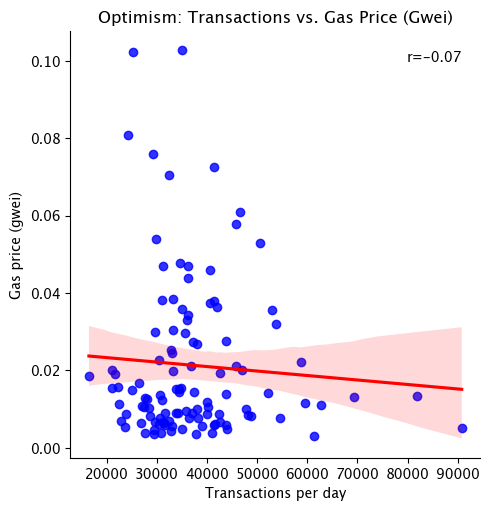

In [288]:
plot_txs_gasprice_corr(corr_op_woanom,'Optimism')

In [77]:
poly_gasprice = poly_gasprice.reset_index() #in Gwei

In [78]:
#Polygon
corr_poly = pd.DataFrame(columns=['timestamp','txs','gas_price','unique_addresses','contracts_deployed','total_gas_used'])
corr_poly['timestamp'] = poly_gasprice['timestamp']
corr_poly['timestamp'] = pd.to_datetime(corr_poly['timestamp'],format='%Y-%m-%d')
corr_poly = corr_poly.iloc[1:]

#txs
txs_poly = poly_txs.copy()
txs_poly = txs_poly.rename(columns={'Date(UTC)':'timestamp'})
corr_poly['txs'] = corr_poly.merge(txs_poly, how='inner', on='timestamp')['Value'].to_list()

#gas price
corr_poly['gas_price'] = poly_gasprice['gas_price_gwei']

#unique addresses
uniqueaddresses_poly = uniqueaddresses_poly.rename(columns={'dates':'timestamp'})
corr_poly['unique_addresses'] = corr_poly.merge(uniqueaddresses_poly, how='inner', on='timestamp')['counts'].to_list()

#number of contracts deployed
deploycontractscount_poly_copy = deploycontractscount_poly[['timestamp','deployed_contracts_count']]
deploycontractscount_poly_copy.columns = deploycontractscount_poly_copy.columns.droplevel(1)
corr_poly['contracts_deployed'] = corr_poly.merge(deploycontractscount_poly_copy, how='inner', on='timestamp')['deployed_contracts_count'].to_list()

#gas used
poly_gasused_copy = poly_gas.copy()
poly_gasused_copy = poly_gasused_copy.reset_index()
poly_gasused_copy['timestamp'] = pd.to_datetime(poly_gasused_copy['timestamp'],format='%Y-%m-%d')
poly_gasused_copy.columns = poly_gasused_copy.columns.droplevel(1)
corr_poly['total_gas_used'] = corr_poly.merge(poly_gasused_copy, how='inner', on='timestamp')['gas_used_gwei'].to_list()

In [79]:
corr_poly

,timestamp,txs,gas_price,unique_addresses,contracts_deployed,total_gas_used
1,2020-06-12,8,0.625000,2,0,1.028381e+05
2,2020-06-15,4,10.500000,2,0,7.958160e+05
3,2020-06-16,1,1.000000,1,0,3.102700e+04
4,2020-06-18,17,21.647059,3,0,7.662409e+06
5,2020-06-19,17,25.605883,4,0,8.749325e+06
...,...,...,...,...,...,...
78,2020-09-03,3454,3.298805,44,0,7.854987e+08
79,2020-09-05,2916,4.467425,236,1,1.927078e+09
80,2020-09-06,2201,3.436131,210,3,1.055874e+09
81,2020-09-07,2178,3.407363,224,47,1.599991e+09


Text(5000, 30, 'r=-0.31')

<Figure size 640x480 with 0 Axes>

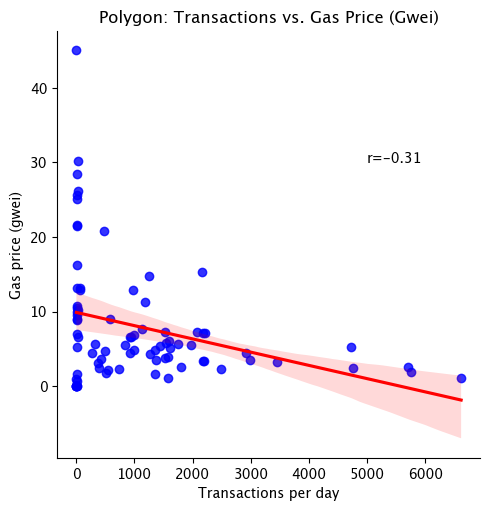

In [80]:
#Corr. between txs and gas price
plt.figure(8)
sns.lmplot(x='txs',y='gas_price',data=corr_poly,scatter_kws={'color':'blue'},line_kws={'color': 'red'})
plt.title('Polygon: Transactions vs. Gas Price (Gwei)')
plt.xlabel('Transactions per day')
plt.ylabel('Gas price (gwei)')
corrcoef_poly = stats.pearsonr(corr_poly['txs'], corr_poly['gas_price'])
plt.text(5000,30,f"r={round(corrcoef_poly[0],2)}")

Text(1000, 15000000000.0, 'r=0.55')

<Figure size 640x480 with 0 Axes>

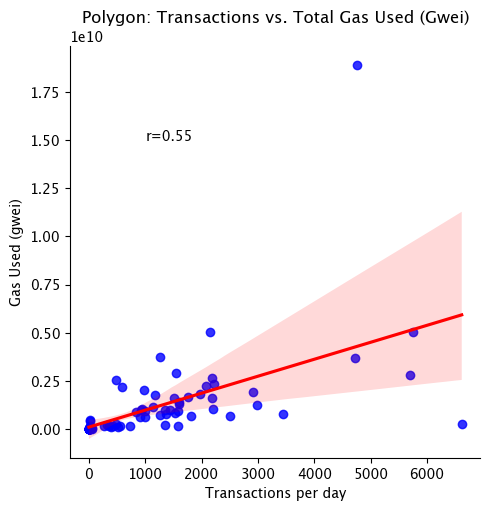

In [81]:
#Corr. between txs and gas price
plt.figure()
sns.lmplot(x='txs',y='total_gas_used',data=corr_poly,scatter_kws={'color':'blue'},line_kws={'color': 'red'})
plt.title('Polygon: Transactions vs. Total Gas Used (Gwei)')
plt.xlabel('Transactions per day')
plt.ylabel('Gas Used (gwei)')
corrcoef_poly = stats.pearsonr(corr_poly['txs'], corr_poly['total_gas_used'])
plt.text(1000,1.5e10,f"r={round(corrcoef_poly[0],2)}")

Text(1000, 15000000000.0, 'r=0.55')

<Figure size 640x480 with 0 Axes>

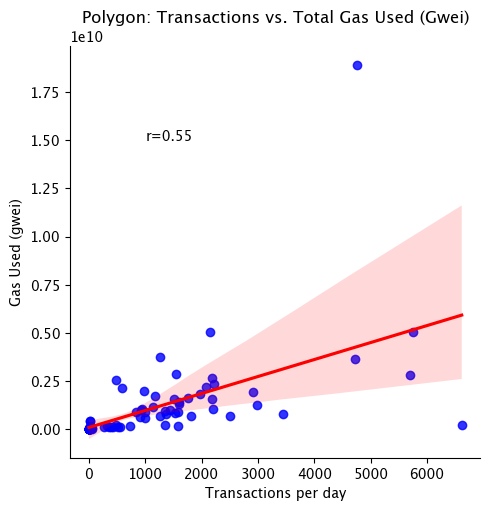

In [82]:
#Corr. between txs and gas price
plt.figure()
sns.lmplot(x='txs',y='total_gas_used',data=corr_poly,scatter_kws={'color':'blue'},line_kws={'color': 'red'})
plt.title('Polygon: Transactions vs. Total Gas Used (Gwei)')
plt.xlabel('Transactions per day')
plt.ylabel('Gas Used (gwei)')
corrcoef_poly = stats.pearsonr(corr_poly['txs'], corr_poly['total_gas_used'])
plt.text(1000,1.5e10,f"r={round(corrcoef_poly[0],2)}")

In [83]:
corr_poly['txs']-corr_poly['contracts_deployed']

1        8
2        4
3        1
4       17
5       17
      ... 
78    3454
79    2915
80    2198
81    2131
82    5756
Length: 82, dtype: int64

In [84]:
corr_poly['txs']

1        8
2        4
3        1
4       17
5       17
      ... 
78    3454
79    2916
80    2201
81    2178
82    5759
Name: txs, Length: 82, dtype: int64

# What percent of transactions are contract deployments?

Text(2020-08-15 00:00:00, 0.35, 'Mean: 0.031')

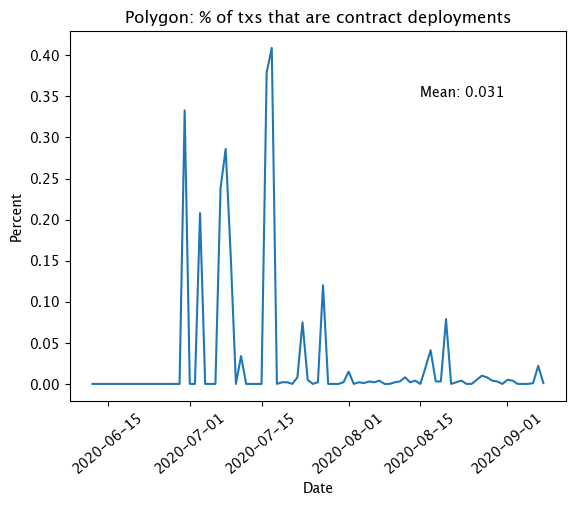

In [85]:
#What percent of transactions are contract deployments?
plt.figure()
plt.plot(corr_poly['timestamp'],round(corr_poly['contracts_deployed']/corr_poly['txs'],3))
plt.title('Polygon: % of txs that are contract deployments')
plt.xlabel('Date')
plt.ylabel('Percent')
plt.xticks(rotation=40)
avg_percenttxscontracts_poly = round((corr_poly['contracts_deployed']/corr_poly['txs']).mean(),3)
plt.text(datetime.datetime(2020,8,15),0.35,f"Mean: {avg_percenttxscontracts_poly}")

/var/folders/g7/mcmk35wn7ls9x6nxdg8_xhlh0000gn/T/ipykernel_68320/1170698215.py:2: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



Text(0.5, 1.0, 'Polygon: Correlation Heatmap')

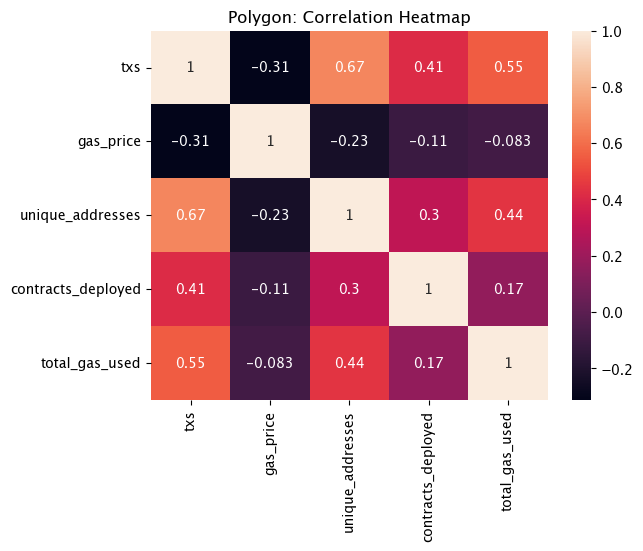

In [86]:
plt.figure()
cormat_poly = corr_poly.corr()
round(cormat_poly,2)
sns.heatmap(cormat_poly,annot=True)
plt.title('Polygon: Correlation Heatmap')

In [87]:
cormat_poly

,txs,gas_price,unique_addresses,contracts_deployed,total_gas_used
txs,1.000000,-0.312896,0.670008,0.410926,0.549817
gas_price,-0.312896,1.000000,-0.232875,-0.108249,-0.082705
unique_addresses,0.670008,-0.232875,1.000000,0.304667,0.441006
contracts_deployed,0.410926,-0.108249,0.304667,1.000000,0.168275
total_gas_used,0.549817,-0.082705,0.441006,0.168275,1.000000


In [88]:
#Arbitrum
corr_arb = pd.DataFrame(columns=['timestamp','txs','gas_price','unique_addresses','contracts_deployed', 'total_gas_used'])
corr_arb['timestamp'] = arb_gasprice['timestamp']
corr_arb['timestamp'] = pd.to_datetime(corr_arb['timestamp'],format='%Y-%m-%d')

txs_arb = arb.copy()
txs_arb = txs_arb.rename(columns={'Date(UTC)':'timestamp'})
corr_arb['txs'] = corr_arb.merge(txs_arb, how='inner', on='timestamp')['Value'].to_list()

corr_arb['gas_price'] = arb_gasprice['gas_price_gwei']

uniqueaddresses_arb = uniqueaddresses_arb.rename(columns={'dates':'timestamp'})
uniqueaddresses_arb['timestamp'] = pd.to_datetime(uniqueaddresses_arb['timestamp'],format='%Y-%m-%d')
corr_arb['unique_addresses'] = corr_arb.merge(uniqueaddresses_arb, how='inner', on='timestamp')['counts'].to_list()

deploycontractscount_arb_copy = deploycontractscount_arb[['timestamp','deployed_contracts_count']]
deploycontractscount_arb_copy.columns = deploycontractscount_arb_copy.columns.droplevel(1)
corr_arb['contracts_deployed'] = corr_arb.merge(deploycontractscount_arb_copy, how='inner', on='timestamp')['deployed_contracts_count'].to_list()

#gas used
arb_gasused_copy = arb_gasused.copy()
arb_gasused_copy = arb_gasused_copy.reset_index()
arb_gasused_copy['timestamp'] = pd.to_datetime(arb_gasused_copy['timestamp'],format='%Y-%m-%d')
arb_gasused_copy.columns = arb_gasused_copy.columns.droplevel(1)
corr_arb['total_gas_used'] = corr_arb.merge(arb_gasused_copy, how='inner', on='timestamp')['gas_used_gwei'].to_list()


In [89]:
corr_arb[corr_arb['total_gas_used']==corr_arb['total_gas_used'].max()]

,timestamp,txs,gas_price,unique_addresses,contracts_deployed,total_gas_used
23,2021-09-12,267608,7.295112,27462,287,1.500300e+12


Text(25000, 6, 'r=0.54')

<Figure size 640x480 with 0 Axes>

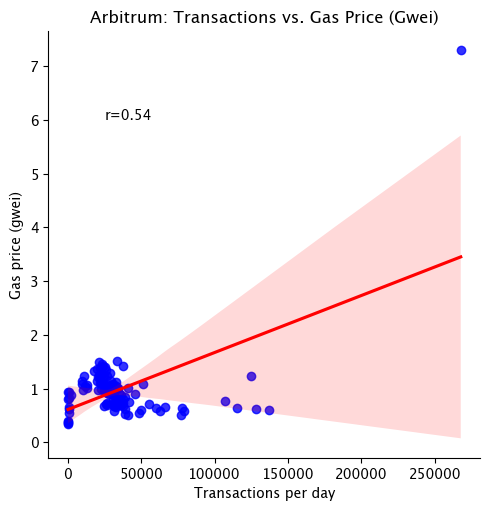

In [90]:
#Corr. between txs and gas price
plt.figure(9)
sns.lmplot(x='txs',y='gas_price',data=corr_arb,scatter_kws={'color':'blue'},line_kws={'color': 'red'})
plt.title('Arbitrum: Transactions vs. Gas Price (Gwei)')
plt.xlabel('Transactions per day')
plt.ylabel('Gas price (gwei)')
corrcoef_arb = stats.pearsonr(corr_arb['txs'], corr_arb['gas_price'])
plt.text(25000,6,f"r={round(corrcoef_arb[0],2)}")

In [91]:
#What is that anomaly?
print(max(corr_arb['gas_price']))
print(corr_arb[corr_arb['gas_price']==7.295112152469643])

7.295112152469643
    timestamp     txs  gas_price  unique_addresses  contracts_deployed  \
23 2021-09-12  267608   7.295112             27462                 287   

    total_gas_used  
23    1.500300e+12  


Text(25000, 1000000000000.0, 'r=0.74')

<Figure size 640x480 with 0 Axes>

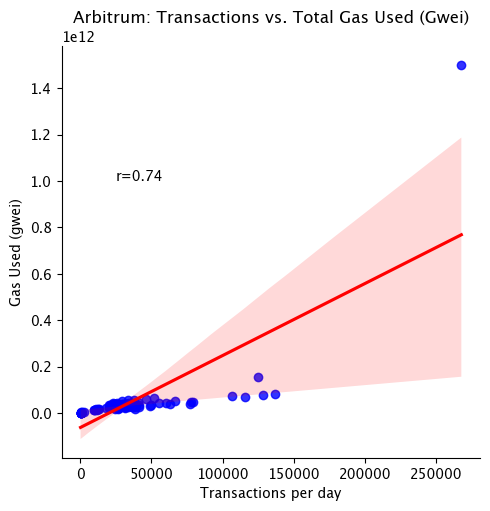

In [92]:
#Corr. between txs and gas price
plt.figure()
sns.lmplot(x='txs',y='total_gas_used',data=corr_arb,scatter_kws={'color':'blue'},line_kws={'color': 'red'})
plt.title('Arbitrum: Transactions vs. Total Gas Used (Gwei)')
plt.xlabel('Transactions per day')
plt.ylabel('Gas Used (gwei)')
corrcoef_arb = stats.pearsonr(corr_arb['txs'], corr_arb['total_gas_used'])
plt.text(25000,1e12,f"r={round(corrcoef_arb[0],2)}")

In [93]:
corr_arb_withoutanomaly = corr_arb.loc[corr_arb['total_gas_used']!=corr_arb['total_gas_used'].max()]

Text(25000, 140000000000.0, 'r=0.83')

<Figure size 640x480 with 0 Axes>

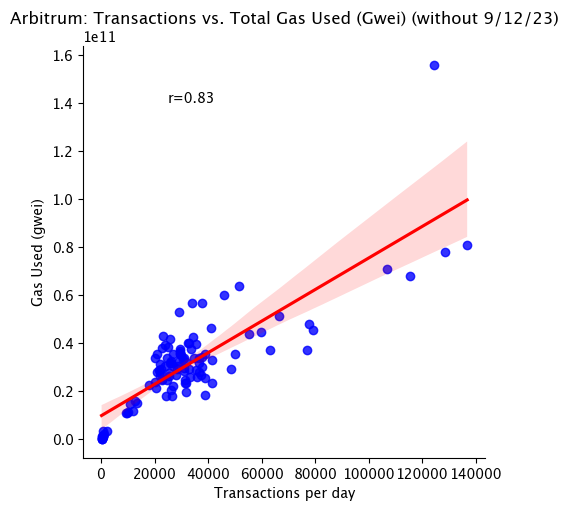

In [94]:
#Corr. between txs and gas price (removing the 9/12/23)
plt.figure()
sns.lmplot(x='txs',y='total_gas_used',data=corr_arb_withoutanomaly,scatter_kws={'color':'blue'},line_kws={'color': 'red'})
plt.title('Arbitrum: Transactions vs. Total Gas Used (Gwei) (without 9/12/23)')
plt.xlabel('Transactions per day')
plt.ylabel('Gas Used (gwei)')
corrcoef_arb_woanomaly = stats.pearsonr(corr_arb_withoutanomaly['txs'], corr_arb_withoutanomaly['total_gas_used'])
plt.text(25000,1.4e11,f"r={round(corrcoef_arb_woanomaly[0],2)}")

Text(2021-10-01 00:00:00, 0.06, 'Mean: 0.004')

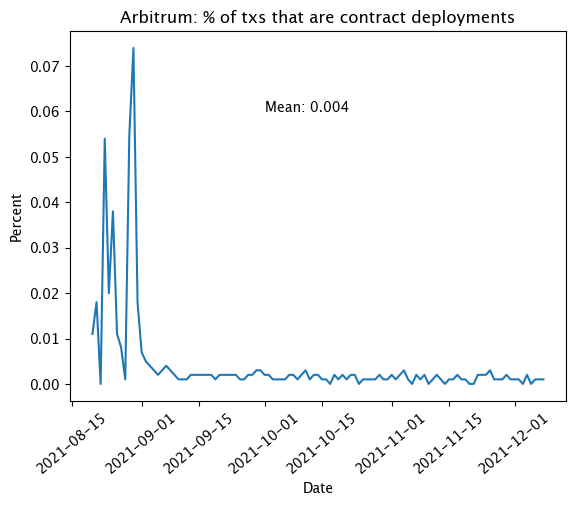

In [95]:
#What percent of transactions are contract deployments?
plt.figure()
plt.plot(corr_arb['timestamp'],round(corr_arb['contracts_deployed']/corr_arb['txs'],3))
plt.title('Arbitrum: % of txs that are contract deployments')
plt.xlabel('Date')
plt.ylabel('Percent')
plt.xticks(rotation=40)
avg_percenttxscontracts_arb = round((corr_arb['contracts_deployed']/corr_arb['txs']).mean(),3)
plt.text(datetime.datetime(2021,10,1),0.06,f"Mean: {avg_percenttxscontracts_arb}")

/var/folders/g7/mcmk35wn7ls9x6nxdg8_xhlh0000gn/T/ipykernel_68320/489426319.py:2: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



Text(0.5, 1.0, 'Arbitrum: Correlation Heatmap')

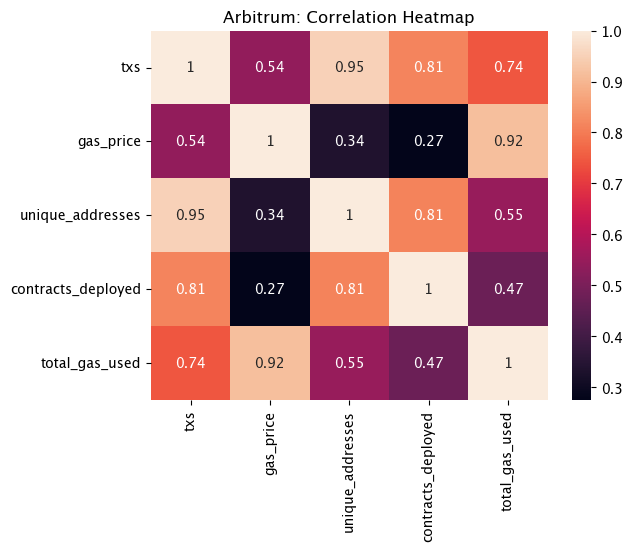

In [96]:
plt.figure()
cormat_arb = corr_arb.corr()
round(cormat_arb,2)
sns.heatmap(cormat_arb,annot=True)
plt.title('Arbitrum: Correlation Heatmap')

In [97]:
cormat_arb

,txs,gas_price,unique_addresses,contracts_deployed,total_gas_used
txs,1.000000,0.538743,0.949851,0.813801,0.743434
gas_price,0.538743,1.000000,0.335882,0.274910,0.915193
unique_addresses,0.949851,0.335882,1.000000,0.810240,0.548748
contracts_deployed,0.813801,0.274910,0.810240,1.000000,0.474829
total_gas_used,0.743434,0.915193,0.548748,0.474829,1.000000


In [179]:
zksync_gasprice

,block_number,gas_limit,gas_price,gas_used,max_fee_per_gas,max_priority_fee_per_gas,priority_fee_per_gas,nonce,index,success,access_list,gas_price_gwei
block_time,,,,,,,,,,,,
2023-03-23,1.689073e+07,422766.583333,2.159325e+10,243077.000000,2.652732e+10,1.135656e+10,8.422108e+08,230.000000,73.166667,1.0,NaN,21.593253
2023-03-24,1.689894e+07,130565.741336,3.066676e+10,118737.366764,4.440345e+10,1.579326e+09,1.367884e+09,313.436588,75.723626,1.0,NaN,30.666763
2023-03-25,1.690401e+07,128492.250173,1.765524e+10,118729.051702,2.518634e+10,1.439130e+09,1.314356e+09,154.897799,65.317682,1.0,NaN,17.655239
2023-03-26,1.691120e+07,127165.071869,1.742629e+10,118737.247838,2.706704e+10,1.423793e+09,1.301500e+09,112.239122,64.252252,1.0,NaN,17.426288
2023-03-27,1.691783e+07,126935.947105,2.241355e+10,118730.880817,3.212163e+10,1.447731e+09,1.310579e+09,111.695560,71.072953,1.0,NaN,22.413545
...,...,...,...,...,...,...,...,...,...,...,...,...
2023-06-28,1.757748e+07,151934.069137,1.772603e+10,118076.918695,2.462877e+10,1.326999e+09,1.080766e+09,37.106471,89.198009,1.0,NaN,17.726025
2023-06-29,1.758362e+07,148764.681916,1.716346e+10,118074.990450,2.298430e+10,1.119097e+09,9.757126e+08,17.341651,87.953481,1.0,NaN,17.163459
2023-06-30,1.759096e+07,149341.049007,2.172108e+10,118076.561775,2.941184e+10,1.083675e+09,9.824479e+08,12.994841,97.888832,1.0,NaN,21.721084


In [181]:
zksync_txs

,Unnamed: 0,block_number,value,gas_limit,gas_price,gas_used,max_fee_per_gas,max_priority_fee_per_gas,priority_fee_per_gas,nonce,index,success,from,to,block_hash,data,hash,type,access_list
,count,count,count,count,count,count,count,count,count,count,count,count,count,count,count,count,count,count,count
block_time,,,,,,,,,,,,,,,,,,,
2023-03-23,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,0
2023-03-24,15754,15754,15754,15754,15754,15754,15422,15422,15422,15754,15754,15754,15754,15754,15754,15754,15754,15754,0
2023-03-25,44853,44853,44853,44853,44853,44853,44203,44203,44203,44853,44853,44853,44853,44853,44853,44853,44853,44853,0
2023-03-26,44400,44400,44400,44400,44400,44400,43624,43624,43624,44400,44400,44400,44400,44400,44400,44400,44400,44400,0
2023-03-27,32706,32706,32706,32706,32706,32706,32286,32286,32286,32706,32706,32706,32706,32706,32706,32706,32706,32706,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-06-28,3616,3616,3616,3616,3616,3616,3341,3341,3341,3616,3616,3616,3616,3616,3616,3616,3616,3616,0
2023-06-29,6492,6492,6492,6492,6492,6492,6172,6172,6172,6492,6492,6492,6492,6492,6492,6492,6492,6492,0


In [121]:
#zkSync
deploycontracts_zksync = contracts_zksync.copy()
deploycontracts_zksync = deploycontracts_zksync.groupby(deploycontracts_zksync['block_time']).agg({'count'})
deploycontracts_zksync = deploycontracts_zksync.reset_index()
#deploycontracts_zksync['block_time'] = pd.to_datetime(deploycontractscount_poly['timestamp'], format="%Y-%m-%d")
deploycontracts_zksync['deployed_contracts_count'] = deploycontracts_zksync[('contract_address','count')]

avgdeploycontractscount_zksync = deploycontracts_zksync['deployed_contracts_count'].sum()/len(deploycontracts_zksync['deployed_contracts_count'])
stddeploycontractscount_zksync = round(deploycontracts_zksync['deployed_contracts_count'].std())
'''

'#deploycontracts_zksync[\'block_time\'] = pd.to_datetime(deploycontractscount_poly[\'timestamp\'], format="%Y-%m-%d")\ndeploycontracts_zksync[\'deployed_contracts_count\'] = deploycontracts_zksync[(\'contract_address\',\'count\')]\n\navgdeploycontractscount_zksync = deploycontracts_zksync[\'deployed_contracts_count\'].sum()/len(deploycontracts_zksync[\'deployed_contracts_count\'])\nstddeploycontractscount_zksync = round(deploycontracts_zksync[\'deployed_contracts_count\'].std())\n'

In [122]:
deploycontracts_zksync

,block_time,block_number,namespace,contract_name,contract_address,tx_hash,index,signature,event_name,block_time.1,...,nonce,index.1,success,from,to,block_hash,data,hash,type,access_list
,,count,count,count,count,count,count,count,count,count,...,count,count,count,count,count,count,count,count,count,count
0,2023-03-23,17,17,17,17,17,17,17,17,17,...,17,17,17,17,17,17,17,17,17,0
1,2023-03-25,3852,3852,3852,3852,3852,3852,3852,3852,3852,...,3852,3852,3852,3852,3852,3852,3852,3852,3852,0
2,2023-03-29,2903,2903,2903,2903,2903,2903,2903,2903,2903,...,2903,2903,2903,2903,2903,2903,2903,2903,2903,0
3,2023-03-30,5383,5383,5383,5383,5383,5383,5383,5383,5383,...,5383,5383,5383,5383,5383,5383,5383,5383,5383,0
4,2023-04-01,2107,2107,2107,2107,2107,2107,2107,2107,2107,...,2107,2107,2107,2107,2107,2107,2107,2107,2107,0
5,2023-04-03,4800,4800,4800,4800,4800,4800,4800,4800,4800,...,4800,4800,4800,4800,4800,4800,4800,4800,4800,0
6,2023-04-05,392,392,392,392,392,392,392,392,392,...,392,392,392,392,392,392,392,392,392,0
7,2023-04-06,1512,1512,1512,1512,1512,1512,1512,1512,1512,...,1512,1512,1512,1512,1512,1512,1512,1512,1512,0
8,2023-04-07,3720,3720,3720,3720,3720,3720,3720,3720,3720,...,3720,3720,3720,3720,3720,3720,3720,3720,3720,0


In [123]:
deploycontracts_zksync['block_time'].iloc[0]

Timestamp('2023-03-23 00:00:00')

In [131]:
contracts_zksync

,block_time,block_number,namespace,contract_name,contract_address,tx_hash,index,signature,event_name,block_time.1,...,nonce,index.1,success,from,to,block_hash,data,hash,type,access_list
713,2023-03-23,16892516.0,zksync,MailboxFacet,0x32400084c286cf3e17e7b677ea9583e60a000324,0xfee977b97ded99c4009e10b54d72fc06235a1b6d24bc...,66,0x4531cd5795773d7101c17bdeb9f5ab7f47d705601750...,NewPriorityRequest,2023-03-23 20:08:47.000 UTC,...,24,66,True,0x043da37f21c4c83b97b546724c75600c2d0c9e16,0x32400084c286cf3e17e7b677ea9583e60a000324,0xe3b6295c23ce5f3e80ea08ca485a7cd3fa672bb33fa1...,0xeb672419000000000000000000000000043da37f21c4...,0xfee977b97ded99c4009e10b54d72fc06235a1b6d24bc...,DynamicFee,NaN
738,2023-03-23,16890636.0,zksync,MailboxFacet,0x32400084c286cf3e17e7b677ea9583e60a000324,0x24a413f9760690fb91103695b173050c380c2a03f95e...,131,0x4531cd5795773d7101c17bdeb9f5ab7f47d705601750...,NewPriorityRequest,2023-03-23 13:48:59.000 UTC,...,1396,131,True,0xfa9da51631268a30ec3ddd1ccbf46c65fad99251,0x32400084c286cf3e17e7b677ea9583e60a000324,0xce9fb2c3e237cc0560d937cb81d402ffa81a051bf399...,0xeb672419000000000000000000000000fa9da5163126...,0x24a413f9760690fb91103695b173050c380c2a03f95e...,DynamicFee,NaN
731,2023-03-23,16889181.0,zksync,MailboxFacet,0x32400084c286cf3e17e7b677ea9583e60a000324,0x538014c05ce4a012569fc1d4dccb1e31b887af92b7c5...,49,0x4531cd5795773d7101c17bdeb9f5ab7f47d705601750...,NewPriorityRequest,2023-03-23 08:53:47.000 UTC,...,1394,49,True,0xfa9da51631268a30ec3ddd1ccbf46c65fad99251,0x32400084c286cf3e17e7b677ea9583e60a000324,0xbf354468cfed97fb662f4d96cbd22ef59a453247ef74...,0xeb672419000000000000000000000000fa9da5163126...,0x538014c05ce4a012569fc1d4dccb1e31b887af92b7c5...,DynamicFee,NaN
727,2023-03-23,16892968.0,zksync,MailboxFacet,0x32400084c286cf3e17e7b677ea9583e60a000324,0x867f025e557ea5306eda4fba4e792287bc21a3d2c633...,33,0x4531cd5795773d7101c17bdeb9f5ab7f47d705601750...,NewPriorityRequest,2023-03-23 21:40:23.000 UTC,...,2,33,True,0xcca8009f5e09f8c5db63cb0031052f9cb635af62,0x32400084c286cf3e17e7b677ea9583e60a000324,0xd8256c7c55abdc1a952f6090c6d9155c3f35fa5f8208...,0xeb672419000000000000000000000000cca8009f5e09...,0x867f025e557ea5306eda4fba4e792287bc21a3d2c633...,DynamicFee,NaN
725,2023-03-23,16892966.0,zksync,MailboxFacet,0x32400084c286cf3e17e7b677ea9583e60a000324,0xb413e8e9867dcd97ed23162e4bfc66bcaf7cfe01f541...,49,0x4531cd5795773d7101c17bdeb9f5ab7f47d705601750...,NewPriorityRequest,2023-03-23 21:39:59.000 UTC,...,675,49,True,0xc13b65f7c53cd6db2ea205a4b574b4a0858720a6,0x32400084c286cf3e17e7b677ea9583e60a000324,0xef376082d87a5f06e8945a951d9add102cd3c633ccba...,0xeb672419000000000000000000000000c13b65f7c53c...,0xb413e8e9867dcd97ed23162e4bfc66bcaf7cfe01f541...,DynamicFee,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
94831,2023-07-01,17601879.0,zksync,MailboxFacet,0x32400084c286cf3e17e7b677ea9583e60a000324,0x123b9c88f944e9669636a0cc1634b6b09428140bde04...,25,0x4531cd5795773d7101c17bdeb9f5ab7f47d705601750...,NewPriorityRequest,2023-07-01 21:29:59.000 UTC,...,0,25,True,0x1dce56ab1009b3814735dbf79486be2213014ab8,0x32400084c286cf3e17e7b677ea9583e60a000324,0x7dadf737b5be2a556bb188e13b7db8af14f98d2dbaf7...,0xeb6724190000000000000000000000001dce56ab1009...,0x123b9c88f944e9669636a0cc1634b6b09428140bde04...,DynamicFee,NaN
94829,2023-07-01,17601877.0,zksync,MailboxFacet,0x32400084c286cf3e17e7b677ea9583e60a000324,0xf63626204a419c84974300794c063a703515523283ad...,125,0x4531cd5795773d7101c17bdeb9f5ab7f47d705601750...,NewPriorityRequest,2023-07-01 21:29:35.000 UTC,...,0,125,True,0xff913536a45b1ef2ffb9523d820a2a634396b420,0x32400084c286cf3e17e7b677ea9583e60a000324,0xf997821807e51b1dee1414118c1918c59af35fcde7c2...,0xeb672419000000000000000000000000ff913536a45b...,0xf63626204a419c84974300794c063a703515523283ad...,DynamicFee,NaN
94827,2023-07-01,17601877.0,zksync,MailboxFacet,0x32400084c286cf3e17e7b677ea9583e60a000324,0xe6bf71b260adeb969cc29543a04f3c416b207089f290...,116,0x4531cd5795773d7101c17bdeb9f5ab7f47

# Protocol Activity

In [311]:
def plot_protocoldistribution(contracts_df, chain_name):
    print(contracts_df['namespace'].value_counts())
    
    plt.figure(figsize=(50,30))
    cross_tab_prop = pd.crosstab(index=contracts_df['block_time'],
                                 columns=contracts_df['namespace'],
                                 normalize="index")

    cross_tab_prop.plot(kind='bar', 
                        stacked=True, 
                        colormap='tab20',
                        #legend=None,
                        figsize=(15, 10))

    plt.legend(loc="center left", ncol=2,bbox_to_anchor=(1, 0.5))
    plt.xlabel("Date")
    plt.xticks(rotation=90)
    plt.ylabel("Protocols (by proportion)")
    plt.title(f"{chain_name}: Distribution of Protocols")

In [327]:
def plot_topn_protocoldistribution(contracts_df, chain_name, topn):
    topprotocols = list(contracts_df['namespace'].value_counts().keys()[:topn])
    temp_contracts_df = contracts_df[contracts_df['namespace'].isin(topprotocols)]
    print(temp_contracts_df['namespace'].value_counts())
    print(f"Top protocols account for {len(temp_contracts_df)/len(contracts_df)} of activity")
    
    plt.figure(figsize=(50,30))
    cross_tab_prop = pd.crosstab(index=temp_contracts_df['block_time'],
                                 columns=temp_contracts_df['namespace'],
                                 normalize="index")

    cross_tab_prop.plot(kind='bar', 
                        stacked=True, 
                        colormap='tab20',
                        #legend=None,
                        figsize=(15, 10))

    plt.legend(loc="center left", ncol=2,bbox_to_anchor=(1, 0.5))
    plt.xlabel("Date")
    plt.xticks(rotation=90)
    plt.ylabel(f"Top {topn} Protocols (by proportion)")
    plt.title(f"{chain_name}: Distribution of Top {topn} Protocols")

In [329]:
def plot_protocolmarketshare(contracts_df, chain_name, topn):
    norm = [float(i)/sum(contracts_df['namespace'].value_counts()[:topn]) for i in contracts_df['namespace'].value_counts()[:topn]]
    norm = list(map(lambda x: round(x*100,1),norm))
    norm_dict = {k: v for k,v in list(zip(contracts_df['namespace'].value_counts()[:topn].index,norm))}

    plt.figure()
    plt.bar(norm_dict.keys(),norm_dict.values(),label=norm_dict.values())
    plt.title(f'{chain_name}: Protocols Transaction Share')
    plt.xticks(rotation=90)
    plt.xlabel('Protocol')
    plt.ylabel('Txs Share (%)')
    plt.bar_label(plt.bar(norm_dict.keys(),norm_dict.values(),label=norm_dict.values()));
    

In [87]:
def plot_protocolactivity(contracts_df, chain_name, topn,yscale="linear"):
    plt.figure(figsize=(30, 20))
    for p in contracts_df['namespace'].value_counts()[:topn].index:
        temp = contracts_df[contracts_df['namespace']==p]
        temp_count = temp.groupby('block_time').agg({'count'})
        plt.plot(temp_count.index,temp_count[('tx_hash','count')],label=p)
        plt.yscale(yscale)
    plt.legend(loc="center left", ncol=1,bbox_to_anchor=(1, 0.5),fontsize=20)
    plt.title(f'{chain_name}: Top {topn} Protocols Activity Over Time',fontsize=30)
    plt.xticks(rotation=90)
    plt.xlabel('Days',fontsize=20)
    plt.ylabel('Txs',fontsize=20);

In [320]:
contracts_op[contracts_op['namespace'].isin(list(contracts_op['namespace'].value_counts().keys()[:20]))]

,block_time,block_number,namespace,contract_name,contract_address,tx_hash,index,signature,event_name
15932451,2021-12-15,1193744.0,synthetix,sUSD,0x8c6f28f2f1a3c87f0f938b96d27520d9751ec8d9,0x3351d57be425f1d8bb04f9cf0d6cb018ec6ebec67213...,4,0xddf252ad1be2c89b69c2b068fc378daa952ba7f163c4...,Transfer
15975559,2021-12-15,1209688.0,erc20,NaN,0x68f180fcce6836688e9084f035309e29bf0a2095,0x46008c84c92cae49e4c97854563be2dd216ddc99df75...,0,0xddf252ad1be2c89b69c2b068fc378daa952ba7f163c4...,Transfer
15975558,2021-12-15,1209655.0,erc20,NaN,0x94b008aa00579c1307b0ef2c499ad98a8ce58e58,0xc4a3ac15c16291cc82c3ac5f83372a40205868d5863d...,3,0x8c5be1e5ebec7d5bd14f71427d1e84f3dd0314c0f7b2...,Approval
15975556,2021-12-15,1209656.0,erc20,NaN,0x7f5c764cbc14f9669b88837ca1490cca17c31607,0x66a9e69e95497be59843853a5bf8e3256969d4d77ac4...,8,0xddf252ad1be2c89b69c2b068fc378daa952ba7f163c4...,Transfer
15975551,2021-12-15,1209643.0,erc20,NaN,0x4200000000000000000000000000000000000006,0x809cc0db2632096c2e4edf6a9722be3ee807daeb22ff...,0,0xddf252ad1be2c89b69c2b068fc378daa952ba7f163c4...,Transfer
...,...,...,...,...,...,...,...,...,...
18556213,2022-04-03,5268164.0,perp_v2,Exchange,0xbd7a3b7dbeb096f0b832cf467b94b091f30c34ec,0xafc424c12d54645372c62709b7d846fadad9f3e87d7e...,0,0x54e4482fe1d38392effe5d53f0e9e72f60221a75a10c...,FundingUpdated
18556168,2022-04-03,5268163.0,perp_v2,ClearingHouse,0x82ac2ce43e33683c58be4cdc40975e73aa50f459,0x4bee587e6599dbbdb6a1a950d5f8eb875dbc734b25c7...,6,0x968bc4f738eae0486dc6736c4b427dbafa4acfdf6eaf...,PositionChanged
18556162,2022-04-03,5268155.0,connext,TransactionManager,0x31efc4aeaa7c39e54a33fdc3c46ee2bd70ae0a09,0x75be7410ac016a5fb8550020e9339ab92357b8dc9288...,0,0x88fbf1dbc326c404155bad4643bd0ddadd23f0636929...,TransactionPrepared
18556160,2022-04-03,5268160.0,erc20,NaN,0x8c6f28f2f1a3c87f0f938b96d27520d9751ec8d9,0x8afc557976c3541fa67a0711af9d03d08b26b1f241d2...,0,0x8c5be1e5ebec7d5bd14f71427d1e84f3dd0314c0f7b2...,Approval


In [321]:
contracts_op

,block_time,block_number,namespace,contract_name,contract_address,tx_hash,index,signature,event_name
15932451,2021-12-15,1193744.0,synthetix,sUSD,0x8c6f28f2f1a3c87f0f938b96d27520d9751ec8d9,0x3351d57be425f1d8bb04f9cf0d6cb018ec6ebec67213...,4,0xddf252ad1be2c89b69c2b068fc378daa952ba7f163c4...,Transfer
15975559,2021-12-15,1209688.0,erc20,NaN,0x68f180fcce6836688e9084f035309e29bf0a2095,0x46008c84c92cae49e4c97854563be2dd216ddc99df75...,0,0xddf252ad1be2c89b69c2b068fc378daa952ba7f163c4...,Transfer
15975558,2021-12-15,1209655.0,erc20,NaN,0x94b008aa00579c1307b0ef2c499ad98a8ce58e58,0xc4a3ac15c16291cc82c3ac5f83372a40205868d5863d...,3,0x8c5be1e5ebec7d5bd14f71427d1e84f3dd0314c0f7b2...,Approval
15975556,2021-12-15,1209656.0,erc20,NaN,0x7f5c764cbc14f9669b88837ca1490cca17c31607,0x66a9e69e95497be59843853a5bf8e3256969d4d77ac4...,8,0xddf252ad1be2c89b69c2b068fc378daa952ba7f163c4...,Transfer
15975551,2021-12-15,1209643.0,erc20,NaN,0x4200000000000000000000000000000000000006,0x809cc0db2632096c2e4edf6a9722be3ee807daeb22ff...,0,0xddf252ad1be2c89b69c2b068fc378daa952ba7f163c4...,Transfer
...,...,...,...,...,...,...,...,...,...
18556213,2022-04-03,5268164.0,perp_v2,Exchange,0xbd7a3b7dbeb096f0b832cf467b94b091f30c34ec,0xafc424c12d54645372c62709b7d846fadad9f3e87d7e...,0,0x54e4482fe1d38392effe5d53f0e9e72f60221a75a10c...,FundingUpdated
18556168,2022-04-03,5268163.0,perp_v2,ClearingHouse,0x82ac2ce43e33683c58be4cdc40975e73aa50f459,0x4bee587e6599dbbdb6a1a950d5f8eb875dbc734b25c7...,6,0x968bc4f738eae0486dc6736c4b427dbafa4acfdf6eaf...,PositionChanged
18556162,2022-04-03,5268155.0,connext,TransactionManager,0x31efc4aeaa7c39e54a33fdc3c46ee2bd70ae0a09,0x75be7410ac016a5fb8550020e9339ab92357b8dc9288...,0,0x88fbf1dbc326c404155bad4643bd0ddadd23f0636929...,TransactionPrepared
18556160,2022-04-03,5268160.0,erc20,NaN,0x8c6f28f2f1a3c87f0f938b96d27520d9751ec8d9,0x8afc557976c3541fa67a0711af9d03d08b26b1f241d2...,0,0x8c5be1e5ebec7d5bd14f71427d1e84f3dd0314c0f7b2...,Approval


ClearingHouse                         429898
AccountBalance                        269133
Pair                                  233881
AccessControlledOffchainAggregator    174665
OVM_GasPriceOracle                    163391
                                       ...  
InstaFlashAggregatorProxy                  1
CancelUtil                                 1
Collector                                  1
RewardsController                          1
ExchangeRegistry                           1
Name: contract_name, Length: 253, dtype: int64


<Figure size 5000x3000 with 0 Axes>

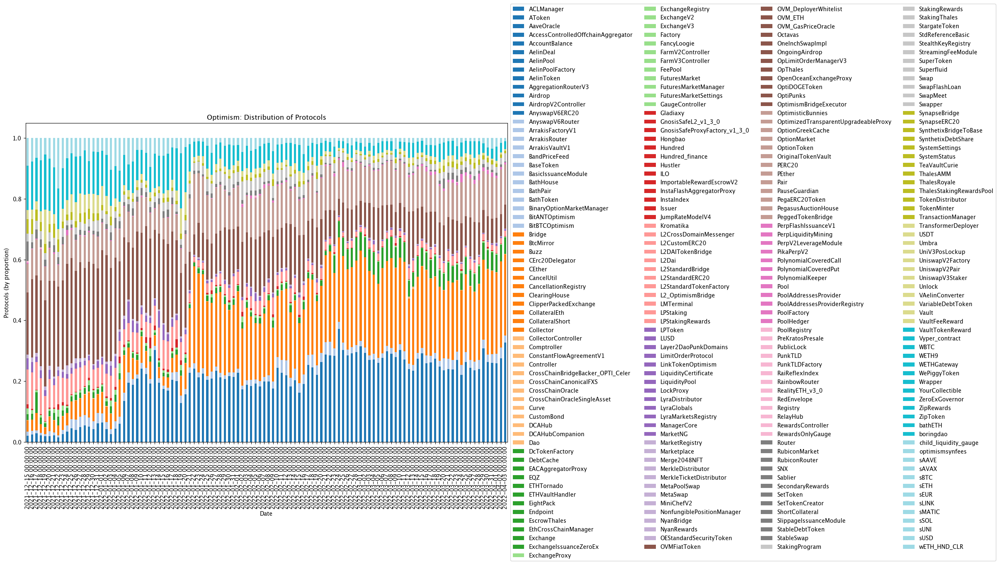

In [303]:
plot_protocoldistribution(contracts_op,'Optimism')

perp_v2          801975
erc20            542774
uniswap_v3       240125
ovm              186007
chainlink        177499
weth             105959
circle            97917
synthetix         89648
hop_protocol      27963
maker             26937
band_protocol     26040
lyra_v1           25062
usdt              24994
erc721            19033
connext           17413
rubicon           13708
vsand              9517
pika_perp_v2       8397
lyra               8328
zipswap            8258
Name: namespace, dtype: int64
Top protocols account for 0.9667363462063464 of activity


<Figure size 5000x3000 with 0 Axes>

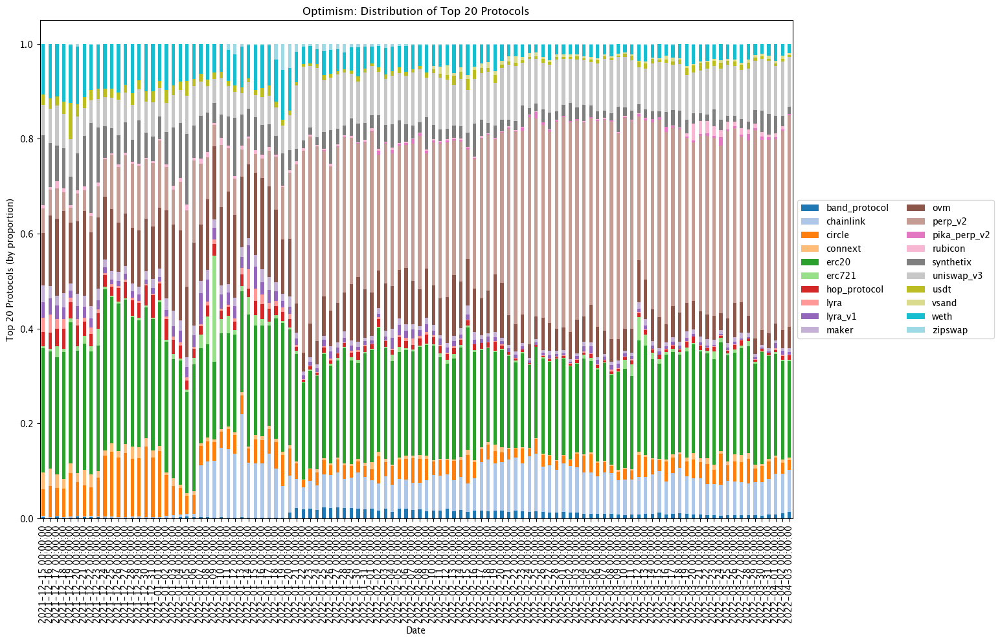

In [328]:
plot_topn_protocoldistribution(contracts_op,'Optimism',20)

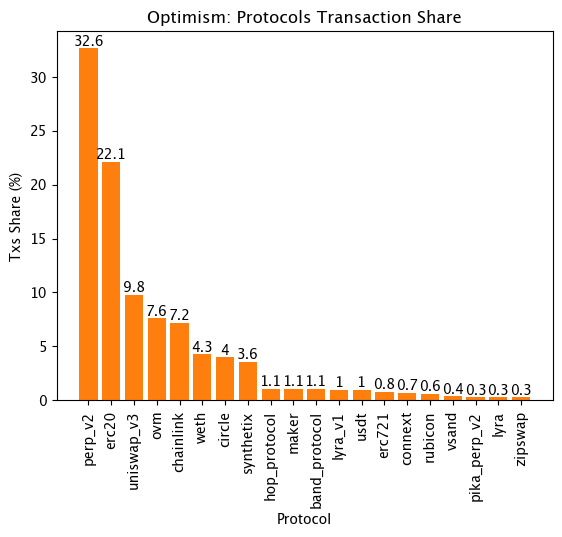

In [330]:
plot_protocolmarketshare(contracts_op,'Optimism',20)

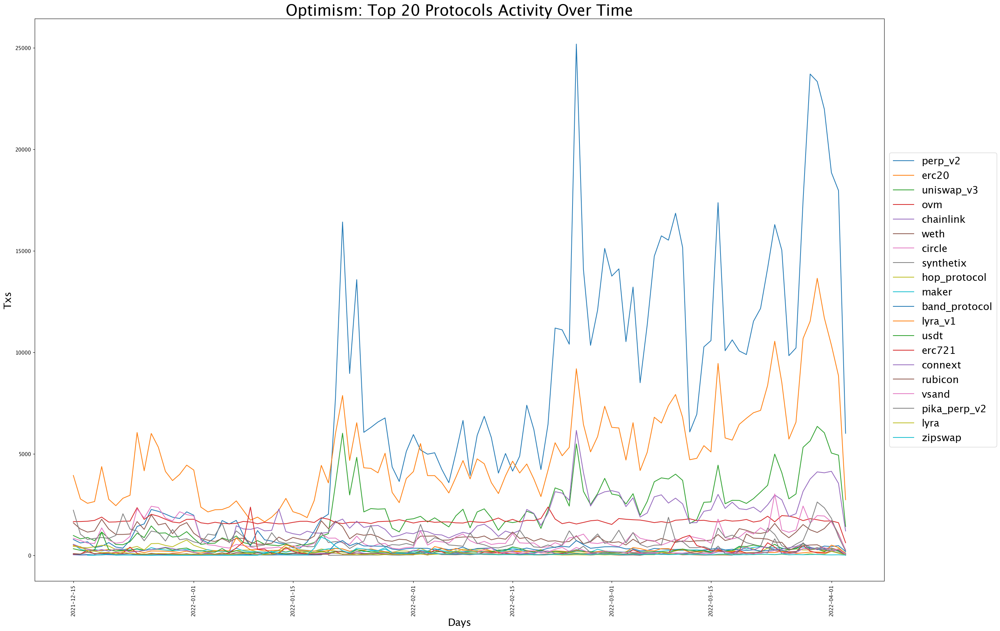

In [332]:
plot_protocolactivity(contracts_op,'Optimism',20)

zksync    150115
Name: namespace, dtype: int64


<Figure size 5000x3000 with 0 Axes>

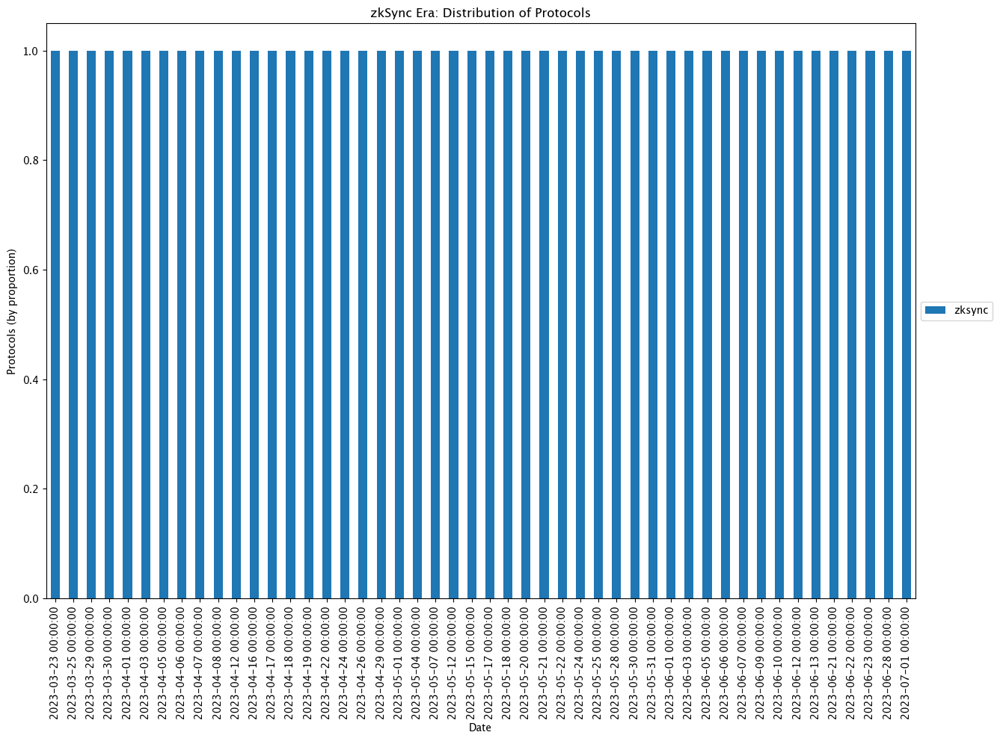

In [312]:
plot_protocoldistribution(contracts_zksync,"zkSync Era")

In [98]:
#Polygon
#!!!need to drop duplicates, order by time, etc.
#path = "/Users/cyrusleung/Desktop/Scroll/Chains Data/polygon txs/protocols"
#all_files = glob.glob(os.path.join(path, "*.csv"))
poly_protocols = pd.read_csv('/Users/cyrusleung/Desktop/Scroll/Chains Data/polygon txs/protocols/protocols_5-30_9-9.csv')

In [99]:
poly_protocols['block_time'] = poly_protocols['block_time'].map(lambda x: x.split()[0])
poly_protocols['block_time'] = pd.to_datetime(poly_protocols['block_time'],format='%Y-%m-%d')

In [100]:
poly_protocols

,block_time,hash,to,namespace
0,2020-07-21,0x5f9abda73a07a3fe66807eb3c78b6ff4a2c742982c19...,0xadb7f7aba82b9e49f1a08bd7194a6373a3e5d31d,NaN
1,2020-07-09,0x23ffdc8dbdc7b66cef8260eed844d453ad68eaa23e29...,0x7b07f01602b6411bdaee69251f0ce27484cc4d41,NaN
2,2020-07-09,0xc33180ccde95151316e26eb178bb802313c7145a532d...,0x7b07f01602b6411bdaee69251f0ce27484cc4d41,NaN
3,2020-07-09,0xa723f5dbd470d677cf3d81522541cc872191632da41b...,0x7b07f01602b6411bdaee69251f0ce27484cc4d41,NaN
4,2020-06-19,0xf5c0e5fa8b099d9b1ddc4feecb2401afe06fe1f5a3f2...,0x8cc8538d60901d19692f5ba22684732bc28f54a3,NaN
...,...,...,...,...
94058,2020-07-22,0x47a92fff0019b0c68dfbb06b39a3cb8bbc9bafa9a5cf...,0x66d575db1bba30b6364c04a484e14bc8dfee2bbb,NaN
94059,2020-07-22,0x4a6ccf629af2070ab1bcf7b51c81f9592a801661bfd3...,0x66d575db1bba30b6364c04a484e14bc8dfee2bbb,NaN
94060,2020-07-22,0xf6663044bedbd8027757879cff4f1e71331cbb4d1b99...,0x66d575db1bba30b6364c04a484e14bc8dfee2bbb,NaN
94061,2020-07-22,0x3f8b32d441511c2c7ae44fb4f8a39c073dc4d1208f5a...,0x66d575db1bba30b6364c04a484e14bc8dfee2bbb,NaN


In [101]:
poly_protocols.sort_values(by='block_time',ascending=True,inplace=True)
poly_protocols = poly_protocols.drop_duplicates(subset=['hash'], keep='first')

In [102]:
poly_protocols

,block_time,hash,to,namespace
152,2020-05-30,0xa3831bd8d15084d41c963dfa4c0887023a76f1828a3a...,0xd9c7c4ed4b66858301d0cb28cc88bf655fe34861,polygon
83687,2020-05-30,0xf6c3feac09aa84558510f74af0c9bf7fd51ff15f902f...,0xc3f60bc338e0af8f46f52650c813fbd3c071e165,NaN
11469,2020-05-30,0x122cf2b942c14c6e5ba029d5da0e7dd4b912e7593345...,NaN,NaN
11468,2020-05-30,0x88e3ab569326b52e9dd8a5f72545d89d8426bbf536f3...,NaN,NaN
33987,2020-05-30,0xef029df186fe80862876987b237d848734d534c1c857...,0x0000000000000000000000000000000000000000,NaN
...,...,...,...,...
73931,2020-09-08,0x26748e5eac558ee9859f2e09b04f06fef2af7c6fb93c...,0xf556faf23fc2feefa33ee6db2d1ee4c70e534513,NaN
73930,2020-09-08,0x8807223bb8823742145123bf664c81eab43321b40b29...,0xf556faf23fc2feefa33ee6db2d1ee4c70e534513,NaN
73929,2020-09-08,0xe723d74667728d7b549365f5525bf0c279e0bba81022...,0xf556faf23fc2feefa33ee6db2d1ee4c70e534513,NaN
73927,2020-09-08,0x7c2a5943cdb58d22f5f687bd282b9cd30c006fc571f3...,0xf556faf23fc2feefa33ee6db2d1ee4c70e534513,NaN


In [103]:
poly_protocols['namespace'].value_counts()

opengsn_v1               87
mahadao                  22
polygon                  14
polymarket                1
compound                  1
wbtc                      1
wowandthefabricantdcl     1
tether                    1
gianganhb                 1
Name: namespace, dtype: int64

In [104]:
cross_tab_prop = pd.crosstab(index=poly_protocols['block_time'],
                             columns=poly_protocols['namespace'],
                             normalize="index")

Text(0.5, 1.0, 'Polygon: Distribution of Protocols')

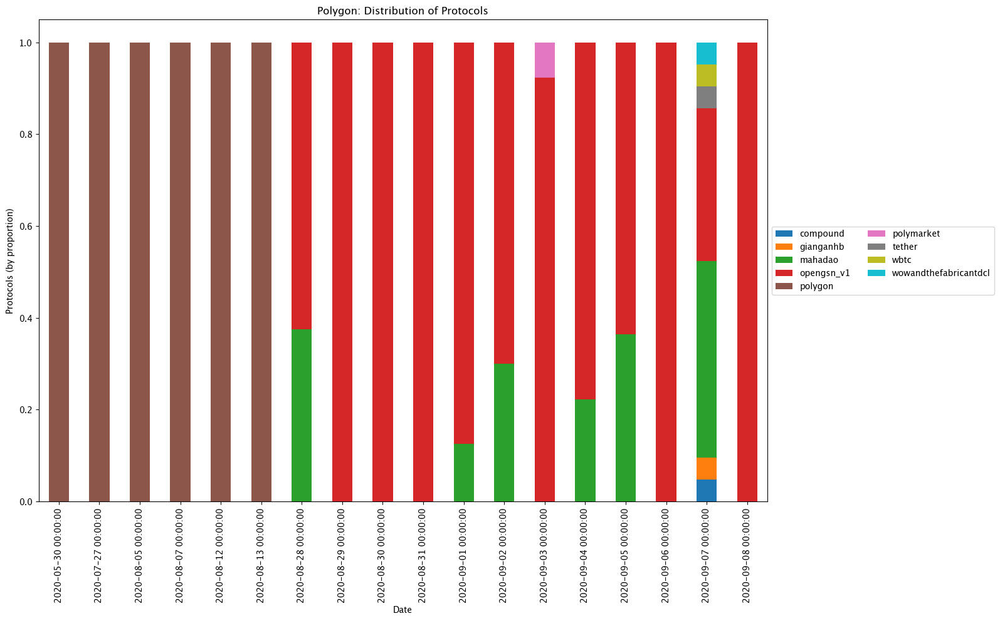

In [105]:
cross_tab_prop.plot(kind='bar', 
                    stacked=True, 
                    colormap='tab10', 
                    figsize=(15, 10))

plt.legend(loc="center left", ncol=2,bbox_to_anchor=(1, 0.5))
plt.xlabel("Date")
plt.ylabel("Protocols (by proportion)")
plt.title('Polygon: Distribution of Protocols')

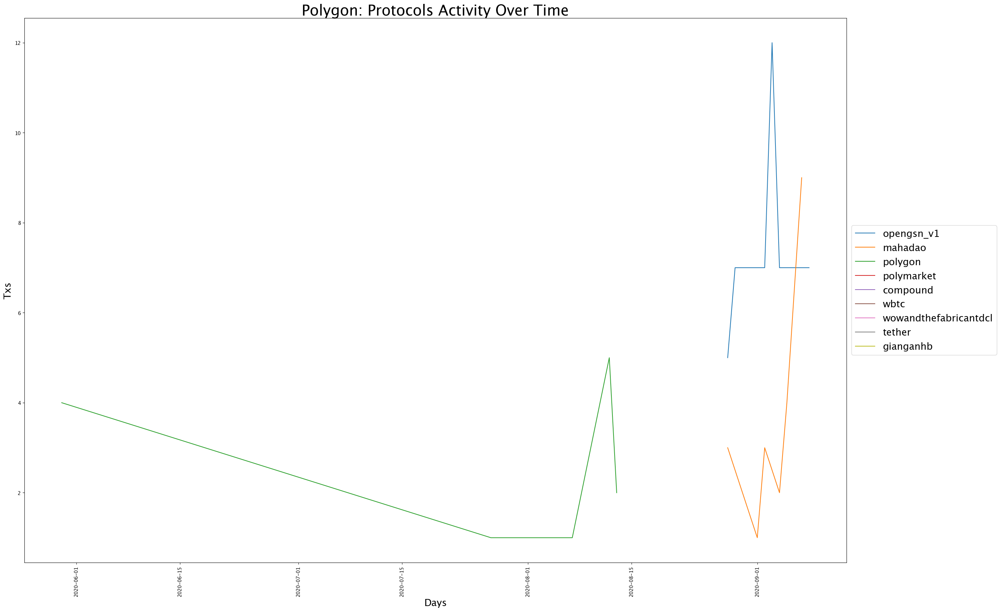

In [106]:
plt.figure(figsize=(30, 20))
for p in poly_protocols['namespace'].value_counts().index:
    temp = poly_protocols[poly_protocols['namespace']==p]
    temp_count = temp.groupby('block_time').agg({'count'})
    plt.plot(temp_count.index,temp_count[('hash','count')],label=p)
plt.legend(loc="center left", ncol=1,bbox_to_anchor=(1, 0.5),fontsize=20)
plt.title('Polygon: Protocols Activity Over Time',fontsize=30)
plt.xticks(rotation=90)
plt.xlabel('Days',fontsize=20)
plt.ylabel('Txs',fontsize=20);

In [107]:
#Arbitrum
'''path = "/Users/cyrusleung/Desktop/Scroll/Chains Data/arbitrum txs/protocols"
all_files = glob.glob(os.path.join(path, "*.csv"))
arb_protocols = pd.concat((pd.read_csv(f) for f in all_files), ignore_index=True)
arb_protocols['block_time'] = arb_protocols['block_time'].map(lambda x: x.split()[0])
arb_protocols['block_time'] = pd.to_datetime(arb_protocols['block_time'],format='%Y-%m-%d')

arb_protocols.sort_values(by='block_time',ascending=True,inplace=True)
arb_protocols = arb_protocols.drop_duplicates(subset=['hash'], keep='first')

arb_protocols.to_csv('/Users/cyrusleung/Desktop/Scroll/Chains Data/arbitrum txs/protocols/all_protocols.csv',index=False)'''

'path = "/Users/cyrusleung/Desktop/Scroll/Chains Data/arbitrum txs/protocols"\nall_files = glob.glob(os.path.join(path, "*.csv"))\narb_protocols = pd.concat((pd.read_csv(f) for f in all_files), ignore_index=True)\narb_protocols[\'block_time\'] = arb_protocols[\'block_time\'].map(lambda x: x.split()[0])\narb_protocols[\'block_time\'] = pd.to_datetime(arb_protocols[\'block_time\'],format=\'%Y-%m-%d\')\n\narb_protocols.sort_values(by=\'block_time\',ascending=True,inplace=True)\narb_protocols = arb_protocols.drop_duplicates(subset=[\'hash\'], keep=\'first\')\n\narb_protocols.to_csv(\'/Users/cyrusleung/Desktop/Scroll/Chains Data/arbitrum txs/protocols/all_protocols.csv\',index=False)'

In [108]:
arb_protocols = pd.read_csv('/Users/cyrusleung/Desktop/Scroll/Chains Data/arbitrum txs/protocols/all_protocols.csv')

/var/folders/g7/mcmk35wn7ls9x6nxdg8_xhlh0000gn/T/ipykernel_68320/660020163.py:1: DtypeWarning:

Columns (4,5) have mixed types. Specify dtype option on import or set low_memory=False.



In [109]:
arb_protocols

,block_time,hash,to,namespace,from,name
0,2021-08-30,0xcb3797a9102e94221389427ff13984b97d25e79ada26...,0xf1e578bb8c28fc118689ad01c63db6e50c4598c1,NaN,NaN,NaN
1,2021-08-30,0xb1bb82eb636d806a5ce72eb66e3fe931b92cae6c85fe...,0x3c6abda21358c15601a3175d8dd66d0c572cc904,NaN,NaN,NaN
2,2021-08-30,0x54d1506106d01d6b87e7959c4a78a993d1679a2905c3...,0x3c6abda21358c15601a3175d8dd66d0c572cc904,NaN,NaN,NaN
3,2021-08-30,0x8173db9f0bf93d4e83af8df3d7928b9924e83a31b363...,0x9b8ddcf800a7bfcdebad6d65514de59160a2c9cc,NaN,NaN,NaN
4,2021-08-30,0x37276f4c47292c9acc0d4a83bd5d914b0389a29e1434...,0x660e7af290f540205a84dccc1f40d0269fc936f5,NaN,NaN,NaN
...,...,...,...,...,...,...
3698600,2021-12-08,0x5f2d1206c9d83f6f929d58ac4460c9e86a918d9e0821...,0xc6d714170fe766691670f12c2b45c1f34405aab6,NaN,NaN,NaN
3698601,2021-12-08,0xe7cfd6c3ada906a829155248ccec3b95ce216f10eeae...,0xc6d714170fe766691670f12c2b45c1f34405aab6,NaN,NaN,NaN
3698602,2021-12-08,0xe345d90b5db60c874ff0be2a9cb49c3622f718c35520...,0xc6d714170fe766691670f12c2b45c1f34405aab6,NaN,NaN,NaN
3698603,2021-12-08,0x1c74952f0c0730395e3254f66ef5d1859728319cdd31...,0x6c2c06790b3e3e3c38e12ee22f8183b37a13ee55,dopex_protocol,NaN,NaN


In [6]:
arb_protocols['namespace'].value_counts()[:20].index

KeyError: 'namespace'

In [111]:
cross_tab_prop = pd.crosstab(index=arb_protocols['block_time'],
                             columns=arb_protocols['namespace'],
                             normalize="index")

Text(0.5, 1.0, 'Arbitrum: Distribution of Protocols')

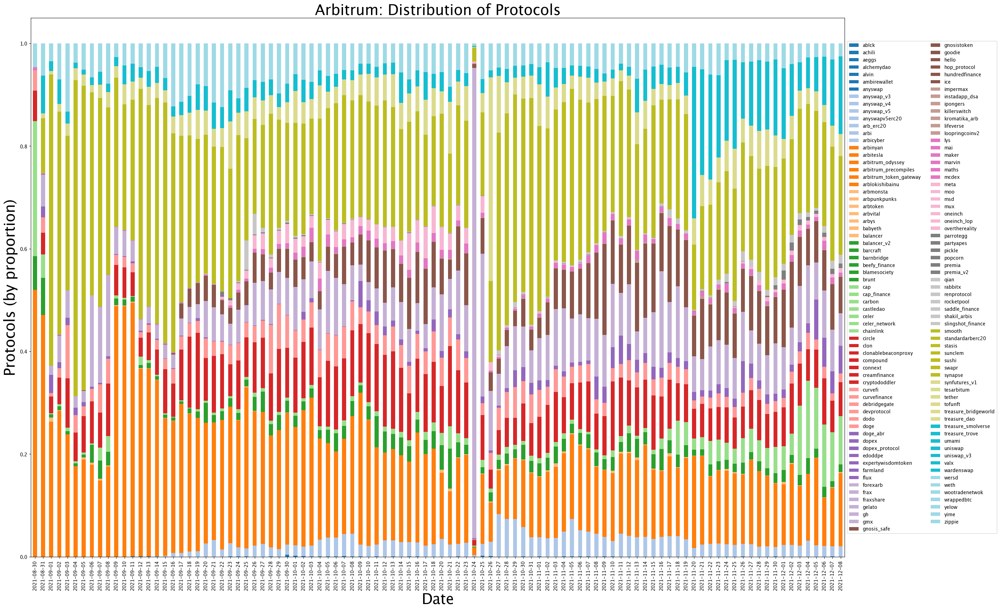

In [112]:
cross_tab_prop.plot(kind='bar', 
                    stacked=True, 
                    colormap='tab20', 
                    figsize=(30, 20))

plt.legend(loc="center left", ncol=2,bbox_to_anchor=(1, 0.5))
plt.xlabel("Date",fontsize=30)
plt.ylabel("Protocols (by proportion)",fontsize=30)
plt.title('Arbitrum: Distribution of Protocols',fontsize=30)

In [113]:
arb_protocols_top20 = arb_protocols[arb_protocols['namespace'].isin(arb_protocols['namespace'].value_counts()[:20].index)]

In [114]:
cross_tab_prop = pd.crosstab(index=arb_protocols_top20['block_time'],
                             columns=arb_protocols_top20['namespace'],
                             normalize="index")

Text(0.5, 1.0, 'Arbitrum: Distribution of Top 20 Protocols')

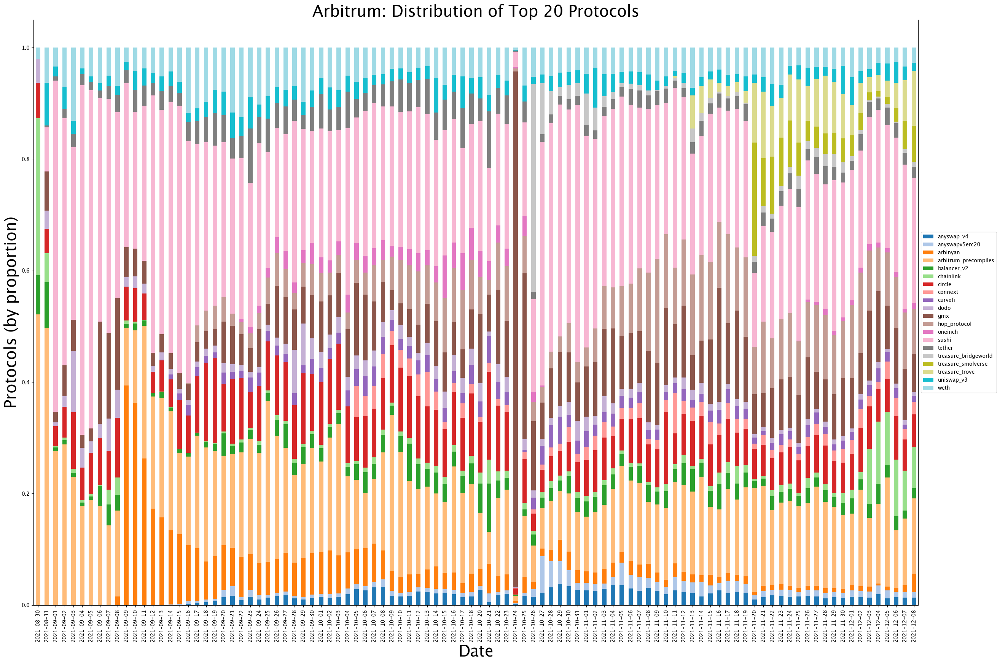

In [115]:
cross_tab_prop.plot(kind='bar', 
                    stacked=True, 
                    colormap='tab20', 
                    figsize=(30, 20))

plt.legend(loc="center left", ncol=1,bbox_to_anchor=(1, 0.5))
plt.xlabel("Date",fontsize=30)
plt.ylabel("Protocols (by proportion)",fontsize=30)
plt.title('Arbitrum: Distribution of Top 20 Protocols',fontsize=30)

In [116]:
sum(arb_protocols['namespace'].value_counts()[:20])/sum(arb_protocols['namespace'].value_counts())

0.923025875437043

In [117]:
arb_protocols['namespace'].value_counts()[:20]

sushi                   547812
arbitrum_precompiles    301767
circle                  135225
arbinyan                134384
gmx                     123814
weth                    103291
hop_protocol             87725
tether                   60029
uniswap_v3               46542
balancer_v2              33821
dodo                     28752
curvefi                  26727
treasure_trove           23778
anyswap_v4               20897
connext                  18325
treasure_bridgeworld     17785
chainlink                17427
treasure_smolverse       17126
oneinch                  16175
anyswapv5erc20           14773
Name: namespace, dtype: int64

In [118]:
norm = [float(i)/sum(arb_protocols['namespace'].value_counts()[:20]) for i in arb_protocols['namespace'].value_counts()[:20]]

In [119]:
norm = list(map(lambda x: round(x*100,1),norm))

In [120]:
norm

[30.8,
 17.0,
 7.6,
 7.6,
 7.0,
 5.8,
 4.9,
 3.4,
 2.6,
 1.9,
 1.6,
 1.5,
 1.3,
 1.2,
 1.0,
 1.0,
 1.0,
 1.0,
 0.9,
 0.8]

In [121]:
norm_dict = {k: v for k,v in list(zip(arb_protocols['namespace'].value_counts()[:20].index,norm))}

In [122]:
norm_dict.values()

dict_values([30.8, 17.0, 7.6, 7.6, 7.0, 5.8, 4.9, 3.4, 2.6, 1.9, 1.6, 1.5, 1.3, 1.2, 1.0, 1.0, 1.0, 1.0, 0.9, 0.8])

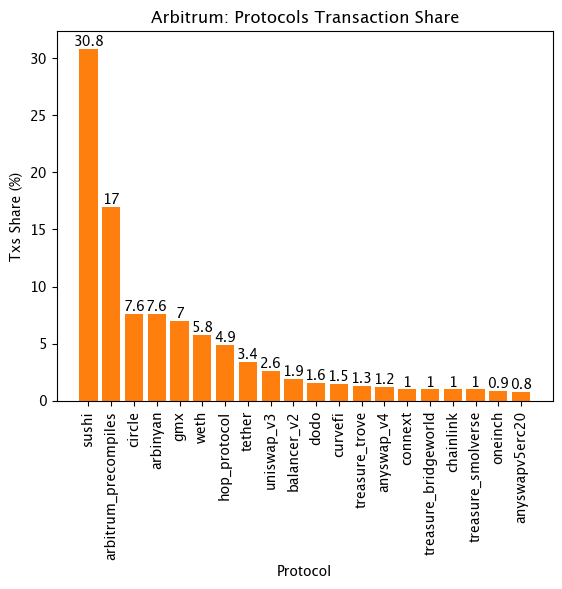

In [135]:
plt.figure()
plt.bar(norm_dict.keys(),norm_dict.values(),label=norm_dict.values())
plt.title('Arbitrum: Protocols Transaction Share')
plt.xticks(rotation=90)
plt.xlabel('Protocol')
plt.ylabel('Txs Share (%)')
plt.bar_label(plt.bar(norm_dict.keys(),norm_dict.values(),label=norm_dict.values()));

In [124]:
arb_protocols['namespace'].value_counts()[:20].index

Index(['sushi', 'arbitrum_precompiles', 'circle', 'arbinyan', 'gmx', 'weth',
       'hop_protocol', 'tether', 'uniswap_v3', 'balancer_v2', 'dodo',
       'curvefi', 'treasure_trove', 'anyswap_v4', 'connext',
       'treasure_bridgeworld', 'chainlink', 'treasure_smolverse', 'oneinch',
       'anyswapv5erc20'],
      dtype='object')

In [125]:
len(arb_protocols['namespace'].value_counts())

133

In [126]:
sum(arb_protocols['namespace'].value_counts()[:10])/sum(arb_protocols['namespace'].value_counts())

0.8181745427938322

In [127]:
#Plot the transaction counts of each of the top 20 protocols over time
sushi = arb_protocols[arb_protocols['namespace']=='sushi']

In [128]:
sushi_count = sushi.groupby('block_time').agg({'count'})

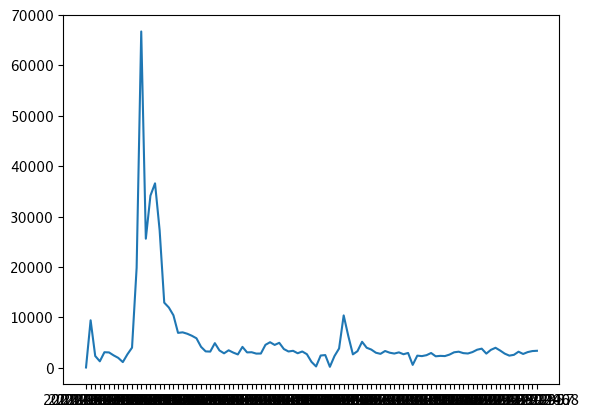

In [129]:
plt.plot(sushi_count.index,sushi_count[('hash','count')],label='sushi')

In [70]:
arb_protocols

,block_number,timestamp,transaction_hash,gas_limit,gas_used,gas_price,transaction_fee,nonce,position,type,...,output,internal_transaction_count,log_count,__confirmed,__indexer_id,__block_number,protocol_name,contract_version,contract_type,tables
0,222103,2021-08-23T19:25:47Z,0x8f1fe8096e7047053e5c4760af92744e8d2977ec07d9...,25469781,23127117,449329055,10391685626484435,4,0,120,...,NaN,0,0,True,dex-protocols,222444,uniswap-fork-2,v2,factory,"[""dex_pools"",""dex_swaps"",""dex_liquidity""]"
1,222832,2021-08-24T21:41:48Z,0xe2c3826bd7b15ef8d338038769fe6140a44f1957a36b...,226692416,206064925,617484654,127241928915160950,4,0,120,...,NaN,0,1,True,dex-protocols,224949,balancer,v2,factory,"[""dex_pools"",""dex_swaps"",""dex_liquidity""]"
2,226578,2021-08-30T08:21:10Z,0xc5a911490ffd92c5de453e70665f1749404695a9846f...,42185260,38329130,877663149,33640064934230370,141,0,120,...,NaN,0,0,True,dex-protocols,227454,dodoswap,v2,factory,"[""dex_pools"",""dex_swaps"",""dex_liquidity""]"
3,226610,2021-08-30T09:03:54Z,0xeb37eb3fa509a53165835daeb13b6228a76ddd167bc0...,171199799,155616909,877663149,136579226390586441,158,0,120,...,NaN,0,0,True,aggregator-protocols,72183402,dodo,v1,aggregator,"[""dex_swaps""]"
4,226623,2021-08-30T09:32:39Z,0xbb5fee1a3e4e9772c01671eedb0cbbda05d2f48e0bbc...,58946737,53568276,868038491,46499325464511516,162,0,120,...,NaN,0,0,True,aggregator-protocols,72183402,dodo,v2,aggregator,"[""dex_swaps""]"
5,226652,2021-08-30T10:15:45Z,0xc405650df61a354f432387a7ecba1e52120624d23bab...,35667425,32403802,868038491,28127747390742782,166,0,120,...,NaN,0,1,True,dex-protocols,226953,dodoswap,v1,factory,"[""dex_pools"",""dex_swaps"",""dex_liquidity""]"
6,227091,2021-08-31T07:35:06Z,0xde0ad28ec2da4556ac71a70a489fd98ec69773f46535...,212685844,193333482,1044858912,202006211655691584,557,0,120,...,NaN,0,0,True,dex-protocols,227454,gmx,vault,dex,"[""dex_swaps""]"
7,260586,2021-09-03T01:16:52Z,0x29e4d8c215f3d6c0ee00f1136275d7a821577c2b8e17...,155008494,140890135,1176348627,165735916865094645,3,0,120,...,NaN,0,0,True,dex-protocols,261021,hop,v1,dex-pool,"[""dex_pools"",""dex_swaps"",""dex_liquidity""]"
8,277186,2021-09-04T21:47:55Z,0xc01c1e64371f21b8eb1e6a789c5e08a08972a8b6c4c3...,25509388,23163123,1207388630,27966891345491490,0,0,120,...,NaN,0,0,True,dex-protocols,369237,swapr,v1,factory,"[""dex_pools"",""dex_swaps"",""dex_liquidity""]"
9,294140,2021-09-06T09:59:58Z,0x5a8e7f4e5830665b24a283aef3ecc0fdce86d85a9e8a...,101521641,92274263,1096827724,101208969870067412,7,0,120,...,NaN,0,0,True,dex-protocols,294588,uniswap-fork-3,v2,factory,"[""dex_pools"",""dex_swaps"",""dex_liquidity""]"


In [84]:
arb_protocols['timestamp'] = arb_protocols['timestamp'].map(clean_timestamp_transpose)

In [16]:
arb_protocols['protocol_name'].value_counts()[:20]

protocol_name
hop                5
curve              5
dodoswap           2
dodo               2
1inch              2
uniswap-fork-2     1
uniswap-fork-8     1
tofu               1
summaswap          1
elkswap            1
uniswap-fork-12    1
slingshot          1
uniswap-fork-10    1
uniswap-fork-11    1
uniswap-fork-9     1
uniswap-fork-5     1
uniswap-fork-7     1
uniswap-fork-6     1
balancer           1
uniswap-fork-4     1
Name: count, dtype: int64

"plt.xlabel('Days',fontsize=20)\nplt.ylabel('Txs',fontsize=20);"

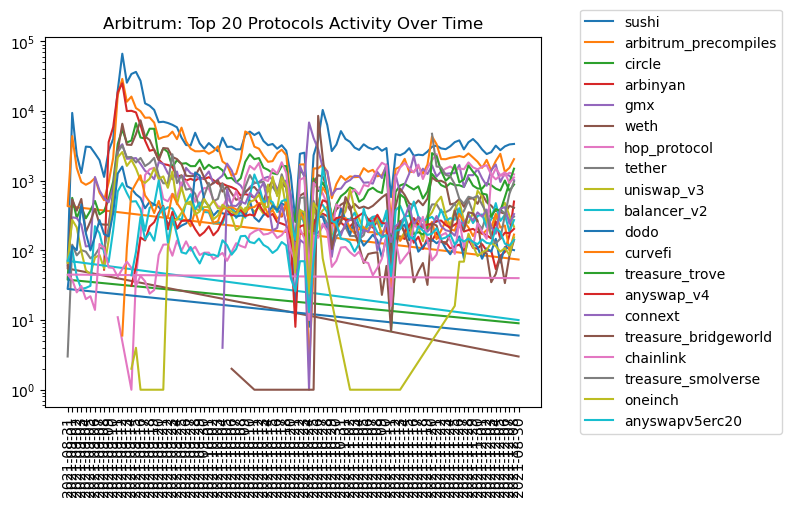

In [26]:
plt.figure()
for p in arb_protocols['namespace'].value_counts()[:20].index:
    temp = arb_protocols[arb_protocols['namespace']==p]
    temp_count = temp.groupby('block_time').agg({'count'})
    plt.plot(temp_count.index,temp_count[('hash','count')],label=p)
plt.legend(loc="center right", ncol=1, bbox_to_anchor=(1.5, 0.5))
plt.title('Arbitrum: Top 20 Protocols Activity Over Time')
plt.xticks(rotation=90)
plt.yscale("log")
'''plt.xlabel('Days',fontsize=20)
plt.ylabel('Txs',fontsize=20);'''

In [ ]:
#What is the correlation between each protocol and 